# Funcs

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scipy
import scipy.stats as sp
from scipy.stats import norm
import seaborn as sns
from sklearn.preprocessing import PolynomialFeatures
import statsmodels.api as sm
import mne
import os
import sys

sys.path.append(os.path.abspath("../src"))

# Quadratic function ax^2 + bx + c
def quadratic(x, a, b, c):
    return a*x**2 + b*x + c

# Below is function for formatting
def p_val_string(pvalue):
    if (pvalue <.001) :
        star = 'p<.001'

    elif np.round(pvalue,2) == 1:
        star = 'p=1'
    elif ((pvalue<.05) and (np.round(pvalue,2)>=.05)) or ((np.round(pvalue,2)==0)):
        star = 'p=' + '{:.3f}'.format(pvalue)[1:]
    else:
        star = 'p=' + '{:.2f}'.format(pvalue)[1:]
    return star

# Function to calculate SDT theoretical measures
def sdt(df, correct_counts):
    # counts:
    n_hit = ((df['stimulus']==1)&(df['response']==1)).sum()
    n_miss = ((df['stimulus']==1)&(df['response']==0)).sum()
    n_fa = ((df['stimulus']==0)&(df['response']==1)).sum()
    n_cr = ((df['stimulus']==0)&(df['response']==0)).sum()

    # correct counts?
    if correct_counts:
        n_hit += .5
        n_miss += .5
        n_fa += .5
        n_cr += .5

    # rates:
    hit_rate = n_hit / (n_hit + n_miss)
    fa_rate = n_fa / (n_fa + n_cr)

    # z-score:
    hit_rate_z = norm.isf(1-hit_rate)
    fa_rate_z = norm.isf(1-fa_rate)

    # measures:
    d = hit_rate_z - fa_rate_z
    c = -(hit_rate_z + fa_rate_z) / 2

    return pd.DataFrame({'d':[d], 'c':[c], 'hr':[hit_rate], 'far':[fa_rate]})

###########################################################

def run_model_pupilbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['bl_pupil_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]


def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

def run_model_alphabin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['alpha_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

def run_model_bin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

correct_counts = True

# Imports

In [3]:
project_directory = os.path.dirname(os.path.dirname(os.path.abspath("binning_analysis")))

df = pd.read_csv(os.path.join(project_directory, r"data", r"behavior.csv"))

prestim_ref_mat = scipy.io.loadmat(os.path.join(project_directory, r"data", r"FowRev_long_192to255_tau5.mat"))['ref_mats']
poststim_ref_mat = scipy.io.loadmat(os.path.join(project_directory, r"data", r"FowRev_long_256to319_tau5.mat"))['ref_mats']
df['prestim_ref_mat'] = [prestim_ref_mat[i] for i in range(prestim_ref_mat.shape[0])]
df['prestim_irrev'] = df['prestim_ref_mat'].apply(lambda arr: np.mean(arr))
df['poststim_ref_mat'] = [poststim_ref_mat[i] for i in range(poststim_ref_mat.shape[0])]
df['poststim_irrev'] = df['poststim_ref_mat'].apply(lambda arr: np.mean(arr))

df['stim_diff'] = (df['poststim_irrev'] - df['prestim_irrev'])

df['log_prestim'] = np.log(df['prestim_irrev'])
df['log_poststim'] = np.log(df['poststim_irrev'])

prestim_channel_alpha = np.load(os.path.join(project_directory, r"data", r"prestim_channel_alphapower.npy"))
prestim_mean_alpha = np.mean(prestim_channel_alpha, axis=1)
df['prestim_mean_alpha'] = prestim_mean_alpha
poststim_channel_alpha = np.load(os.path.join(project_directory, r"data", r"poststim_channel_alphapower.npy"))
poststim_mean_alpha = np.mean(poststim_channel_alpha, axis=1)
df['poststim_mean_alpha'] = poststim_mean_alpha

df['trial'] = df.index

pre_sampEn_bychannel_array = np.load(os.path.join(project_directory, r"data", r"prestim_sampEn_bychannel.npy"))
list1 = [pre_sampEn_bychannel_array[i] for i in range(pre_sampEn_bychannel_array.shape[0])]
df['prestim_sampen_bychannel'] = list1
df['prestim_sampen_mean'] = df['prestim_sampen_bychannel'].apply(lambda x: np.mean(x))

post_sampEn_bychannel_array = np.load(os.path.join(project_directory, r"data", r"poststim_sampEn_bychannel.npy"))
list1 = [post_sampEn_bychannel_array[i] for i in range(post_sampEn_bychannel_array.shape[0])]
df['poststim_sampen_bychannel'] = list1
df['poststim_sampen_mean'] = df['poststim_sampen_bychannel'].apply(lambda x: np.mean(x))



df['prestim_heirarchy'] = [np.std(matrix) for matrix in df['prestim_ref_mat']]
# post -- 
df['poststim_heirarchy'] = [np.std(matrix) for matrix in df['poststim_ref_mat']]

df.head()

,Unnamed: 0,subject,drug,session,block,miniblock,trial_nr,cue,location,cue_val,...,log_poststim,prestim_mean_alpha,poststim_mean_alpha,trial,prestim_sampen_bychannel,prestim_sampen_mean,poststim_sampen_bychannel,poststim_sampen_mean,prestim_heirarchy,poststim_heirarchy
0,0,1,DNP,0,1,0,316,1,1,1,...,-5.433428,9.353471e-06,1.746007e-06,0,"[2.247578463481834, 2.3939348715822737, 2.2335...",2.250741,"[2.2289732756508, 2.3055657211321834, 2.276151...",2.213131,0.007696,0.013968
1,1,1,DNP,0,1,0,318,1,1,1,...,-4.928833,2.174312e-06,1.099906e-06,1,"[2.20619324731898, 2.1795250002368185, 2.21524...",2.234575,"[2.252284354519247, 2.0481889981757315, 2.2713...",2.196622,0.007838,0.018351
2,2,1,DNP,0,1,0,319,0,1,0,...,-4.889197,9.601332e-07,7.846986e-07,2,"[2.3256669004532706, 2.2761518359258903, 2.192...",2.247247,"[2.040526125430162, 2.2289732756508, 2.1324070...",2.176180,0.005415,0.019428
3,3,1,DNP,0,1,0,320,1,1,1,...,-5.629171,4.683720e-06,1.026390e-06,3,"[2.119932903034573, 2.192770226986839, 2.24289...",2.233114,"[2.257012495715193, 2.341012470127931, 2.22897...",2.212193,0.010957,0.008627
4,4,1,DNP,0,1,0,321,1,1,1,...,-5.079207,7.171046e-07,8.087391e-07,4,"[2.1839206117098566, 2.3006029317900545, 2.300...",2.226729,"[2.2289732756508, 2.3006029317900545, 2.095441...",2.212225,0.011295,0.013555


optional for cue analysis

In [ ]:
precue_ref_mat = scipy.io.loadmat(r'C:\Users\jaket\COGS280\DataDeco\FowRev_long_26to89_tau5.mat')['ref_mats']
postcue_ref_mat = scipy.io.loadmat(r'C:\Users\jaket\COGS280\DataDeco\FowRev_long_90to153_tau5.mat')['ref_mats']
df['precue_ref_mat'] = [precue_ref_mat[i] for i in range(precue_ref_mat.shape[0])]
df['precue_irrev'] = df['precue_ref_mat'].apply(lambda arr: np.mean(arr))
df['postcue_ref_mat'] = [postcue_ref_mat[i] for i in range(postcue_ref_mat.shape[0])]
df['postcue_irrev'] = df['postcue_ref_mat'].apply(lambda arr: np.mean(arr))

df['cue_diff'] = df['postcue_irrev'] - df['precue_irrev']
df['cue_prestim_diff'] = (df['prestim_irrev'] - df['postcue_irrev'])
df['log_precue'] = np.log(df['precue_irrev'])
df['log_postcue'] = np.log(df['postcue_irrev'])

# Pupil bin

## D'

### all drug

bl_pupil_bin
0    3306.142539
1    3485.883558
2    3588.134960
3    3691.694810
4    3877.785733
Name: bl_pupil, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2173767366.py:24: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(1),('d')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2173767366.py:26: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(2),('d')), 0)


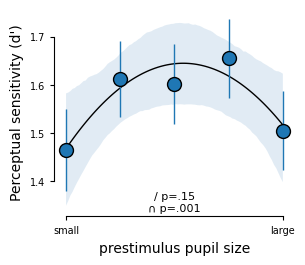

In [4]:
# ALL DRUGS

# Loading behavioral data
behavior = df

cfg = {'n_bins': 5}  # Number of pupil bins
behavior['bl_pupil_bin'] = behavior.groupby(['subject', 'drug', 'block'])['bl_pupil'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['bl_pupil'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin']).mean()
df_subject.reset_index(inplace=True)

print(behavior.groupby('bl_pupil_bin').mean()['bl_pupil'])

betas_first = dict()
_, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(1),('d')), 0)
betas_second = dict()
_, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(2),('d')), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('bl_pupil_bin').mean()['d']
yerr = df_sdt.groupby('bl_pupil_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first['d']
p_val_quadratic = betas_second['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['d']),
                                        p_val_string(betas_second['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('prestimulus pupil size')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

bl_pupil_bin
0    0.000002
1    0.000004
2    0.000006
3    0.000008
4    0.000015
Name: prestim_mean_alpha, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1674107368.py:24: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(1),('d')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1674107368.py:26: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(2),('d')), 0)


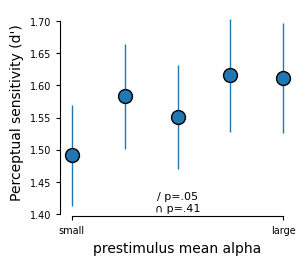

In [5]:
# ALL DRUGS

# Loading behavioral data
behavior = df

cfg = {'n_bins': 5}  # Number of pupil bins
behavior['bl_pupil_bin'] = behavior.groupby(['subject', 'drug', 'block'])['prestim_mean_alpha'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['prestim_mean_alpha'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin']).mean()
df_subject.reset_index(inplace=True)

print(behavior.groupby('bl_pupil_bin').mean()['prestim_mean_alpha'])

betas_first = dict()
_, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(1),('d')), 0)
betas_second = dict()
_, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(2),('d')), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('bl_pupil_bin').mean()['d']
yerr = df_sdt.groupby('bl_pupil_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first['d']
p_val_quadratic = betas_second['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['d']),
                                        p_val_string(betas_second['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('prestimulus mean alpha')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

bl_pupil_bin
0    3231.400687
1    3382.254268
2    3456.884167
3    3514.785591
4    3564.159376
5    3612.402469
6    3664.682721
7    3718.543885
8    3795.579428
9    3958.398964
Name: bl_pupil, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1842606666.py:21: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(1),('d')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1842606666.py:23: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(2),('d')), 0)


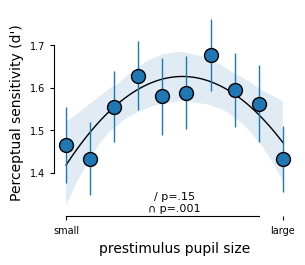

In [6]:

behavior = df

cfg = {'n_bins': 10}  # Number of pupil bins
behavior['bl_pupil_bin'] = behavior.groupby(['subject', 'drug', 'block'])['bl_pupil'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['bl_pupil'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin']).mean()
df_subject.reset_index(inplace=True)

print(behavior.groupby('bl_pupil_bin').mean()['bl_pupil'])

betas_first = dict()
_, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(1),('d')), 0)
betas_second = dict()
_, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(2),('d')), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('bl_pupil_bin').mean()['d']
yerr = df_sdt.groupby('bl_pupil_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first['d']
p_val_quadratic = betas_second['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['d']),
                                        p_val_string(betas_second['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('prestimulus pupil size')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

### PLC

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\435000726.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['bl_pupil_bin'] = behavior.groupby(['subject', 'drug', 'block'])['bl_pupil'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


bl_pupil_bin
0    3246.247271
1    3421.298886
2    3520.195006
3    3621.374967
4    3807.405521
Name: bl_pupil, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\435000726.py:24: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(1),('d')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\435000726.py:26: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(2),('d')), 0)


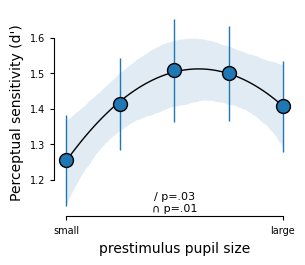

In [7]:
#pupil size x d' -- PLC

behavior = df
behavior = behavior[behavior['drug'] == 'PLC']

cfg = {'n_bins': 5}  # Number of pupil bins
behavior['bl_pupil_bin'] = behavior.groupby(['subject', 'drug', 'block'])['bl_pupil'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['bl_pupil'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin']).mean()
df_subject.reset_index(inplace=True)

print(behavior.groupby('bl_pupil_bin').mean()['bl_pupil'])

betas_first = dict()
_, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(1),('d')), 0)
betas_second = dict()
_, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(2),('d')), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('bl_pupil_bin').mean()['d']
yerr = df_sdt.groupby('bl_pupil_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first['d']
p_val_quadratic = betas_second['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['d']),
                                        p_val_string(betas_second['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('prestimulus pupil size')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()



### DNP

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1489797760.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['bl_pupil_bin'] = behavior.groupby(['subject', 'drug', 'block'])['bl_pupil'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


bl_pupil_bin
0    3147.138715
1    3293.438003
2    3364.572012
3    3418.569360
4    3464.701371
5    3514.652793
6    3559.125712
7    3613.531319
8    3681.525076
9    3834.098551
Name: bl_pupil, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1489797760.py:22: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(1),('d')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1489797760.py:24: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(2),('d')), 0)


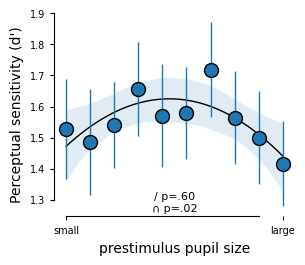

In [8]:

behavior = df
behavior = behavior[behavior['drug'] == 'DNP']

cfg = {'n_bins': 10}  # Number of pupil bins
behavior['bl_pupil_bin'] = behavior.groupby(['subject', 'drug', 'block'])['bl_pupil'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['bl_pupil'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin']).mean()
df_subject.reset_index(inplace=True)

print(behavior.groupby('bl_pupil_bin').mean()['bl_pupil'])

betas_first = dict()
_, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(1),('d')), 0)
betas_second = dict()
_, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(2),('d')), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('bl_pupil_bin').mean()['d']
yerr = df_sdt.groupby('bl_pupil_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first['d']
p_val_quadratic = betas_second['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['d']),
                                        p_val_string(betas_second['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('prestimulus pupil size')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

### ATX

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1814853922.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['bl_pupil_bin'] = behavior.groupby(['subject', 'drug', 'block'])['bl_pupil'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


bl_pupil_bin
0    3449.409712
1    3641.324911
2    3751.355072
3    3863.530534
4    4063.979878
Name: bl_pupil, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1814853922.py:22: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(1),('d')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1814853922.py:24: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(2),('d')), 0)


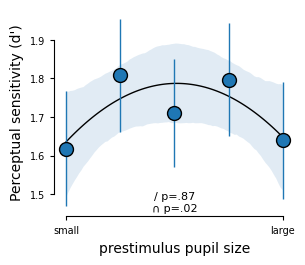

In [9]:

behavior = df
behavior = behavior[behavior['drug'] == 'ATX']

cfg = {'n_bins': 5}  # Number of pupil bins
behavior['bl_pupil_bin'] = behavior.groupby(['subject', 'drug', 'block'])['bl_pupil'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['bl_pupil'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin']).mean()
df_subject.reset_index(inplace=True)

print(behavior.groupby('bl_pupil_bin').mean()['bl_pupil'])

betas_first = dict()
_, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(1),('d')), 0)
betas_second = dict()
_, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(2),('d')), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('bl_pupil_bin').mean()['d']
yerr = df_sdt.groupby('bl_pupil_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first['d']
p_val_quadratic = betas_second['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['d']),
                                        p_val_string(betas_second['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('prestimulus pupil size')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

## RT

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2902423637.py:25: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['RT'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(1),('RT')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2902423637.py:27: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['RT'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(2),('RT')), 0)


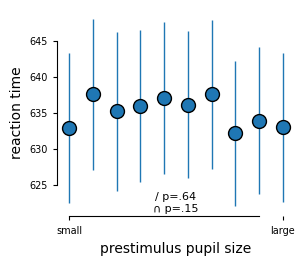

In [10]:
#Pupil bin X Reaction time (for correct trials)
behavior = df
#behavior = behavior[behavior['correct'] == 1]
#behavior = behavior[behavior['drug'] == '']

cfg = {'n_bins': 10}  # Number of pupil bins

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['bl_pupil'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'], labels = range(cfg['n_bins']))))))


correct_counts = True
df_sdt = df_group.groupby(['subject','drug','bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))
df_sdt['RT'] = df_group.groupby(['subject','drug','bl_pupil_bin']).mean()['RT']

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin']).mean()
df_subject.reset_index(inplace=True)

#print(df_group.groupby('bl_pupil_bin').mean()['bl_pupil'])

betas_first = dict()
_, betas_first['RT'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(1),('RT')), 0)
betas_second = dict()
_, betas_second['RT'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(2),('RT')), 0)

# Plotting results for RT'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('bl_pupil_bin').mean()['RT']
yerr = df_sdt.groupby('bl_pupil_bin').sem()['RT']
ax.errorbar(range(cfg['n_bins']), ym, yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first['RT']
p_val_quadratic = betas_second['RT']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="RT", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="RT", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['RT']),
                                        p_val_string(betas_second['RT'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('reaction time')
ax.set_xlabel('prestimulus pupil size')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

## Irreversibility

raw

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\550303599.py:22: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(1),('irreversibility')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\550303599.py:24: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(2),('irreversibility')), 0)


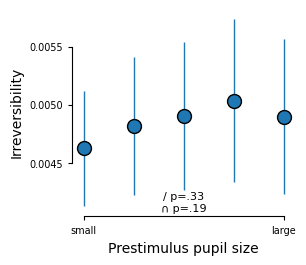

In [11]:
behavior = df
behavior['irreversibility'] = df['prestim_irrev']

cfg = {'n_bins': 5}  # Number of pupil bins

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['bl_pupil'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'], labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))
df_sdt['irreversibility'] = df_group.groupby(['subject','drug','bl_pupil_bin']).mean()['irreversibility']

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin']).mean()
df_subject.reset_index(inplace=True)

df_irrev = df_subject

betas_first = dict()
_, betas_first['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(1),('irreversibility')), 0)
betas_second = dict()
_, betas_second['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(2),('irreversibility')), 0)

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_irrev.groupby('bl_pupil_bin').mean()['irreversibility']
yerr = df_irrev.groupby('bl_pupil_bin').sem()['irreversibility']

ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first['irreversibility'] < .05:
    sns.regplot(ax=ax, data=df_irrev, x="bl_pupil_bin", y="irreversibility", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second['irreversibility'] < .05:
    sns.regplot(ax=ax, data=df_irrev, x="bl_pupil_bin", y="irreversibility", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['irreversibility']),
                                        p_val_string(betas_second['irreversibility'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Irreversibility')
ax.set_xlabel('Prestimulus pupil size')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

logged

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3896974451.py:25: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['log_irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(1),('log_irreversibility')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3896974451.py:27: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['log_irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(2),('log_irreversibility')), 0)


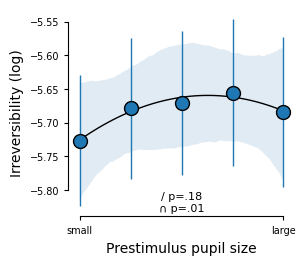

In [12]:


# Loading behavioral data
behavior = df

behavior['log_irreversibility'] = df['log_prestim']

cfg = {'n_bins': 5}  # Number of pupil bins
behavior['bl_pupil_bin'] = behavior.groupby(['subject', 'drug'])['bl_pupil'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['bl_pupil'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'], labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))
df_sdt['log_irreversibility'] = df_group.groupby(['subject','drug','bl_pupil_bin']).mean()['log_irreversibility']

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin']).mean()
df_subject.reset_index(inplace=True)

df_irrev = df_subject

betas_first = dict()
_, betas_first['log_irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(1),('log_irreversibility')), 0)
betas_second = dict()
_, betas_second['log_irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(2),('log_irreversibility')), 0)

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_irrev.groupby('bl_pupil_bin').mean()['log_irreversibility']
yerr = df_irrev.groupby('bl_pupil_bin').sem()['log_irreversibility']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first['log_irreversibility'] < .05:
    sns.regplot(ax=ax, data=df_irrev, x="bl_pupil_bin", y="log_irreversibility", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second['log_irreversibility'] < .05:
    sns.regplot(ax=ax, data=df_irrev, x="bl_pupil_bin", y="log_irreversibility", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['log_irreversibility']),
                                        p_val_string(betas_second['log_irreversibility'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Irreversibility (log)')
ax.set_xlabel('Prestimulus pupil size')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

### by drug

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1406537724.py:23: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(1),('irreversibility')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1406537724.py:25: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(2),('irreversibility')), 0)


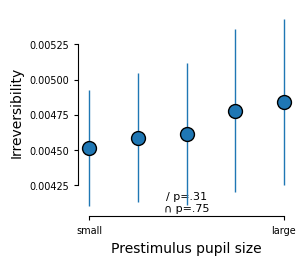

In [13]:
behavior = df
behavior['irreversibility'] = df['prestim_irrev']
behavior = behavior[behavior['drug'] == 'PLC']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
cfg = {'n_bins': 5}  # Number of pupil bins

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['bl_pupil'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'], labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))
df_sdt['irreversibility'] = df_group.groupby(['subject','drug','bl_pupil_bin']).mean()['irreversibility']

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin']).mean()
df_subject.reset_index(inplace=True)

df_irrev = df_subject

betas_first = dict()
_, betas_first['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(1),('irreversibility')), 0)
betas_second = dict()
_, betas_second['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(2),('irreversibility')), 0)

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_irrev.groupby('bl_pupil_bin').mean()['irreversibility']
yerr = df_irrev.groupby('bl_pupil_bin').sem()['irreversibility']

ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first['irreversibility'] < .05:
    sns.regplot(ax=ax, data=df_irrev, x="bl_pupil_bin", y="irreversibility", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second['irreversibility'] < .05:
    sns.regplot(ax=ax, data=df_irrev, x="bl_pupil_bin", y="irreversibility", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['irreversibility']),
                                        p_val_string(betas_second['irreversibility'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Irreversibility')
ax.set_xlabel('Prestimulus pupil size')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

DNP

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\579625462.py:22: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(1),('irreversibility')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\579625462.py:24: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(2),('irreversibility')), 0)


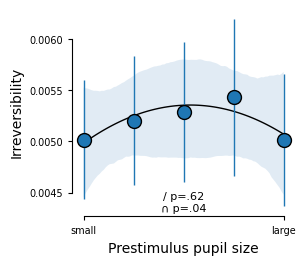

In [14]:
behavior = df
behavior['irreversibility'] = df['prestim_irrev']
behavior = behavior[behavior['drug'] == 'DNP']
cfg = {'n_bins': 5}  # Number of pupil bins

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['bl_pupil'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'], labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))
df_sdt['irreversibility'] = df_group.groupby(['subject','drug','bl_pupil_bin']).mean()['irreversibility']

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin']).mean()
df_subject.reset_index(inplace=True)

df_irrev = df_subject

betas_first = dict()
_, betas_first['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(1),('irreversibility')), 0)
betas_second = dict()
_, betas_second['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(2),('irreversibility')), 0)

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_irrev.groupby('bl_pupil_bin').mean()['irreversibility']
yerr = df_irrev.groupby('bl_pupil_bin').sem()['irreversibility']

ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first['irreversibility'] < .05:
    sns.regplot(ax=ax, data=df_irrev, x="bl_pupil_bin", y="irreversibility", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second['irreversibility'] < .05:
    sns.regplot(ax=ax, data=df_irrev, x="bl_pupil_bin", y="irreversibility", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['irreversibility']),
                                        p_val_string(betas_second['irreversibility'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Irreversibility')
ax.set_xlabel('Prestimulus pupil size')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

ATX

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2979415516.py:22: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(1),('irreversibility')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2979415516.py:24: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(2),('irreversibility')), 0)


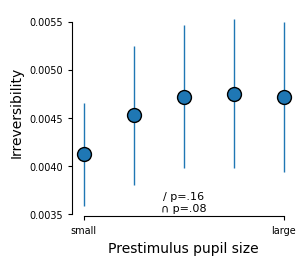

In [15]:
behavior = df
behavior['irreversibility'] = df['prestim_irrev']
behavior = behavior[behavior['drug'] == 'ATX']
cfg = {'n_bins': 5}  # Number of pupil bins

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['bl_pupil'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'], labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))
df_sdt['irreversibility'] = df_group.groupby(['subject','drug','bl_pupil_bin']).mean()['irreversibility']

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin']).mean()
df_subject.reset_index(inplace=True)

df_irrev = df_subject

betas_first = dict()
_, betas_first['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(1),('irreversibility')), 0)
betas_second = dict()
_, betas_second['irreversibility'] = sp.stats.ttest_1samp(df_irrev.groupby(['subject']).apply(run_model_pupilbin,(2),('irreversibility')), 0)

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_irrev.groupby('bl_pupil_bin').mean()['irreversibility']
yerr = df_irrev.groupby('bl_pupil_bin').sem()['irreversibility']

ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first['irreversibility'] < .05:
    sns.regplot(ax=ax, data=df_irrev, x="bl_pupil_bin", y="irreversibility", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second['irreversibility'] < .05:
    sns.regplot(ax=ax, data=df_irrev, x="bl_pupil_bin", y="irreversibility", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['irreversibility']),
                                        p_val_string(betas_second['irreversibility'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Irreversibility')
ax.set_xlabel('Prestimulus pupil size')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

# Prestim

## D'

### old method

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\267726202.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


The amount of empty cells is : 0
irreversibility_bin
0    0.001861
1    0.002885
2    0.003938
3    0.005416
4    0.009774
Name: irreversibility, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\267726202.py:25: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\267726202.py:28: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


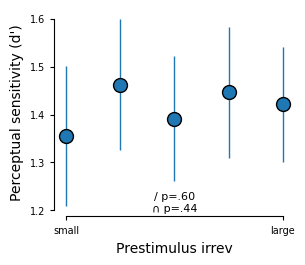

In [17]:

behavior = df
behavior['irreversibility'] = df['prestim_irrev']
behavior = behavior[behavior['drug']=='PLC']
cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Prestimulus irrev')
ax.set_xticks([0,4])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

The amount of empty cells is : 0
irreversibility_bin
0    0.001583
1    0.002258
2    0.002746
3    0.003217
4    0.003719
5    0.004280
6    0.004957
7    0.005825
8    0.007149
9    0.011794
Name: irreversibility, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\589516443.py:27: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\589516443.py:30: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


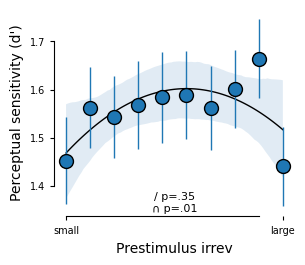

In [18]:
#more bins!
behavior = df
behavior['irreversibility'] = df['prestim_irrev']


cfg = dict()
cfg['n_bins'] = 10 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Prestimulus irrev')
ax.set_xticks([0,(cfg['n_bins']-1)])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

### new method

irreversibility_bin
0    0.001959
1    0.003008
2    0.004011
3    0.005387
4    0.009095
Name: irreversibility, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1756465346.py:27: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(1),('d')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1756465346.py:29: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(2),('d')), 0)


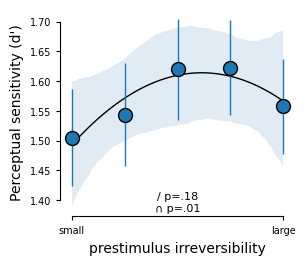

In [19]:
# ALL DRUGS

# Loading behavioral data
behavior = df
behavior['irreversibility'] = df['prestim_irrev']
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
#behavior = behavior[(behavior['drug'] == 'PLC')]

cfg = {'n_bins': 5}  # Number of pupil bins
#behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['irreversibility'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject = df_sdt.groupby(['subject', 'irreversibility_bin']).mean()
df_subject.reset_index(inplace=True)

print(df_group.groupby('irreversibility_bin').mean()['irreversibility'])

betas_first = dict()
_, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(1),('d')), 0)
betas_second = dict()
_, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(2),('d')), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first['d']
p_val_quadratic = betas_second['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['d']),
                                        p_val_string(betas_second['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('prestimulus irreversibility')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

placebo

irreversibility_bin
0    0.001644
1    0.002328
2    0.002849
3    0.003389
4    0.004040
5    0.004859
6    0.006009
7    0.008878
Name: irreversibility, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\429688501.py:27: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(1),('d')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\429688501.py:29: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(2),('d')), 0)


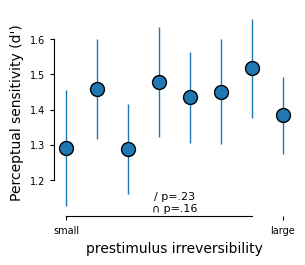

In [20]:
# ALL DRUGS

# Loading behavioral data
behavior = df
behavior = behavior[behavior['drug']=='PLC']
behavior = behavior[(behavior['poststim_irrev'] < 0.02) & (behavior['prestim_irrev'] < 0.02)]
behavior['irreversibility'] = df['prestim_irrev']

cfg = {'n_bins': 8}  # Number of pupil bins
behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug', 'block'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['irreversibility'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject = df_sdt.groupby(['subject', 'irreversibility_bin']).mean()
df_subject.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])

betas_first = dict()
_, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(1),('d')), 0)
betas_second = dict()
_, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(2),('d')), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first['d']
p_val_quadratic = betas_second['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['d']),
                                        p_val_string(betas_second['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('prestimulus irreversibility')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

logged


irreversibility_bin
0   -6.419544
1   -5.985734
2   -5.712759
3   -5.427792
4   -4.935170
Name: irreversibility, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\695972326.py:23: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(1),('d')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\695972326.py:25: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(2),('d')), 0)


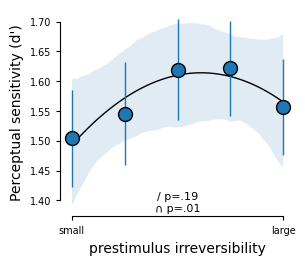

In [21]:
# Loading behavioral data
behavior = df
behavior['irreversibility'] = df['log_prestim']

cfg = {'n_bins': 5}  # Number of pupil bins
behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug', 'block'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['irreversibility'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject = df_sdt.groupby(['subject', 'irreversibility_bin']).mean()
df_subject.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])

betas_first = dict()
_, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(1),('d')), 0)
betas_second = dict()
_, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(2),('d')), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first['d']
p_val_quadratic = betas_second['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['d']),
                                        p_val_string(betas_second['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('prestimulus irreversibility')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

by drug

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\259975498.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug', 'block'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


irreversibility_bin
0   -6.456312
1   -6.044131
2   -5.795991
3   -5.564115
4   -5.306532
5   -4.834054
Name: irreversibility, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\259975498.py:24: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(1),('d')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\259975498.py:26: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(2),('d')), 0)


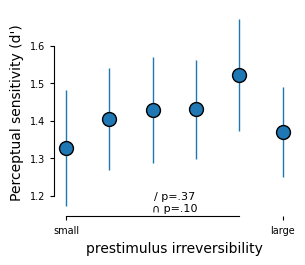

In [22]:
# Loading behavioral data
behavior = df
behavior['irreversibility'] = df['log_prestim']
behavior = behavior[behavior['drug'] == 'PLC']

cfg = {'n_bins': 6}  # Number of pupil bins
behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug', 'block'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['irreversibility'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject = df_sdt.groupby(['subject', 'irreversibility_bin']).mean()
df_subject.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])

betas_first = dict()
_, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(1),('d')), 0)
betas_second = dict()
_, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(2),('d')), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first['d']
p_val_quadratic = betas_second['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['d']),
                                        p_val_string(betas_second['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('prestimulus irreversibility')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

The amount of empty cells is : 0
irreversibility_bin
0    0.001583
1    0.002258
2    0.002746
3    0.003217
4    0.003719
5    0.004280
6    0.004957
7    0.005825
8    0.007149
9    0.011794
Name: irreversibility, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3311315327.py:33: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3311315327.py:36: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


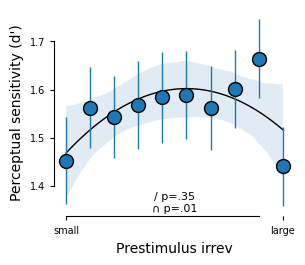

In [24]:
#more bins!

#drug = 'PLC'

behavior = df
behavior['trial'] = behavior.index
behavior['irreversibility'] = behavior['prestim_irrev']

#behavior = behavior[(behavior['drug'] == drug)]


cfg = dict()
cfg['n_bins'] = 10 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Prestimulus irrev')
ax.set_xticks([0,(cfg['n_bins']-1)])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

## RT (correct)

### old method

irreversibility_bin
0    0.001916
1    0.002958
2    0.003959
3    0.005317
4    0.009242
Name: irreversibility, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1211978810.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1211978810.py:21: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['RT'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'RT'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1211978810.py:24: DeprecationWarning: P

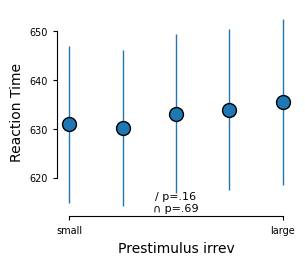

In [25]:
behavior = df
behavior['irreversibility'] = df['prestim_irrev']

behavior = behavior[behavior['correct'] == 1]

cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = behavior.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['RT'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'RT'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['RT'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'RT'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_subject_irreversibility.groupby('irreversibility_bin').mean()['RT']
yerr = df_subject_irreversibility.groupby('irreversibility_bin').sem()['RT']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first_irreversibility['RT'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="RT", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second_irreversibility['RT'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="RT", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['RT']),
                                        p_val_string(betas_second_irreversibility['RT'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Reaction Time')
ax.set_xlabel('Prestimulus irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

## topoplots per irrev bin! -- not interesting, except that the spatial layout of bin 4 (the outlier bin) looks normal :)


C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1742703076.py:10: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1742703076.py:17: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  print(behavior.groupby('irreversibility_bin').mean()['ir

irreversibility_bin
0    0.001919
1    0.002982
2    0.003999
3    0.005392
4    0.009482
Name: irreversibility, dtype: float64
Bin: 0
Max channel contribution: PO4: 0.005273806237753941
Max Pairwise Irreversibility: P6/O2: 0.00583382062711824


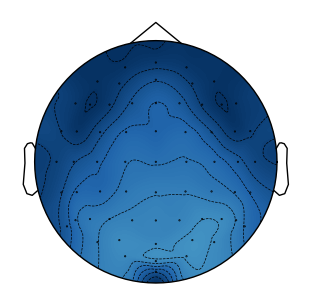

Bin: 1
Max channel contribution: PO4: 0.00893388677961596
Max Pairwise Irreversibility: P6/PO8: 0.01212345405896246


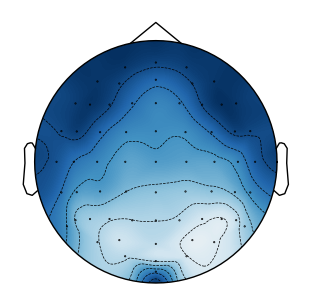

Bin: 2
Max channel contribution: PO4: 0.01228972088347848
Max Pairwise Irreversibility: PO8/P6: 0.016233906015166267


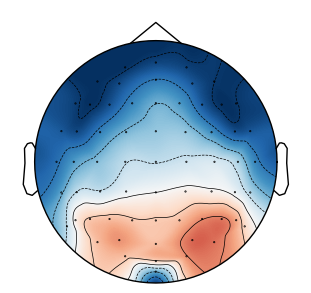

Bin: 3
Max channel contribution: PO8: 0.017142564411056025
Max Pairwise Irreversibility: O2/P6: 0.021624878779143812


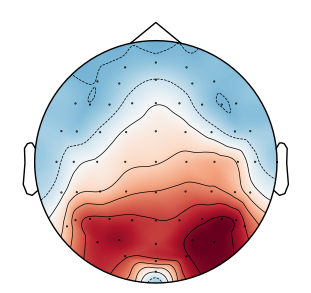

Bin: 4
Max channel contribution: PO8: 0.029353651543694
Max Pairwise Irreversibility: P6/P10: 0.033272425421152704


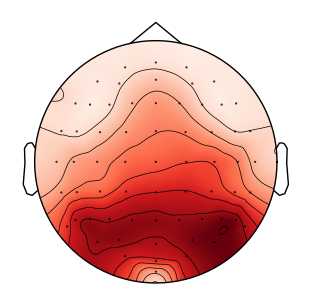

In [32]:
from scipy.stats import zscore
behavior = df
behavior['irreversibility'] = df['prestim_irrev']
behavior['pre_ref_matrices'] = df['prestim_ref_mat']

cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])

mean_ref_matrices_perbin = behavior.groupby('irreversibility_bin')['pre_ref_matrices'].mean()

# channels = ['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3',
#	'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1',
#	'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz',
#	'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4',
#	'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4',
#	'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8',
#	'P10', 'PO8', 'PO4', 'O2']
# Not important--
data1 = np.zeros((64, 128))  # Replace with your data
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
channel_locs = montage.get_positions()['ch_pos']
info = mne.create_info(channels, sfreq=128, ch_types='eeg')
info.set_montage(montage) # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)
info = mne.create_info(channels, sfreq=128, ch_types='eeg')  # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)
montage = mne.channels.make_standard_montage('biosemi64') # Set montage if known
raw.set_montage(montage)

total_ref_matrix = behavior['pre_ref_matrices'].mean()

row = np.mean(total_ref_matrix, axis=1)
col = np.mean(total_ref_matrix, axis=0)
tot_channel_contribution = row + col

global_mean = np.mean(tot_channel_contribution)
global_std = np.std(tot_channel_contribution)

for bin, ref_matrix in mean_ref_matrices_perbin.items():
    print("Bin: " + str(bin))
    row = np.mean(ref_matrix, axis=1)
    col = np.mean(ref_matrix, axis=0)
    pre_channel_contribution = row + col

    pre_zscore_matrix = (pre_channel_contribution - global_mean) / global_std
    max1 = np.max(pre_channel_contribution)
    print("Max channel contribution: " + str(channels[np.argmax(pre_channel_contribution)]) + ": " + str(max1))
    max2 = np.max(ref_matrix)
    print("Max Pairwise Irreversibility: " + str(channels[np.unravel_index(np.argmax(ref_matrix), ref_matrix.shape)[0]]) + "/" + 
         str(channels[np.unravel_index(np.argmax(ref_matrix), ref_matrix.shape)[1]])+  ": " + str(max2))

    mne.viz.plot_topomap(pre_zscore_matrix, raw.info, res = 400, size = 3)


# if you want to do this but not have the zscore be global--



Bin: 0
Max channel contribution: PO4: 0.005273806237753941
Max Pairwise Irreversibility: P6/O2: 0.00583382062711824


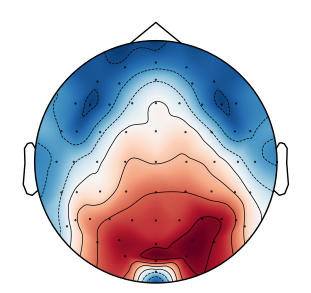

Bin: 1
Max channel contribution: PO4: 0.00893388677961596
Max Pairwise Irreversibility: P6/PO8: 0.01212345405896246


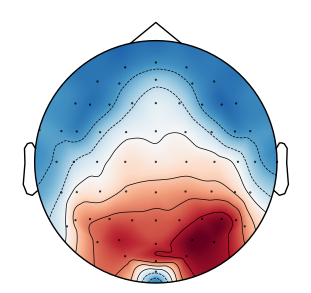

Bin: 2
Max channel contribution: PO4: 0.01228972088347848
Max Pairwise Irreversibility: PO8/P6: 0.016233906015166267


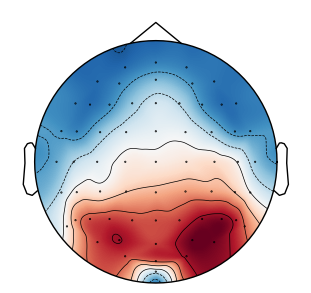

Bin: 3
Max channel contribution: PO8: 0.017142564411056025
Max Pairwise Irreversibility: O2/P6: 0.021624878779143812


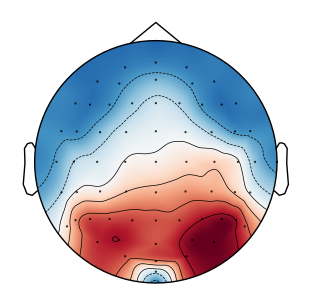

Bin: 4
Max channel contribution: PO8: 0.029353651543694
Max Pairwise Irreversibility: P6/P10: 0.033272425421152704


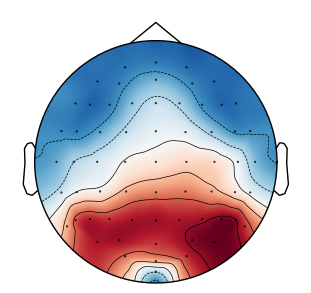

In [33]:
# if you want to do this but not have the zscore be global--
from scipy.stats import zscore

for bin, ref_matrix in mean_ref_matrices_perbin.items():
    print("Bin: " + str(bin))
    row = np.mean(ref_matrix, axis=1)
    col = np.mean(ref_matrix, axis=0)
    pre_channel_contribution = row + col
    
    pre_zscore_matrix = zscore(pre_channel_contribution)
    max1 = np.max(pre_channel_contribution)
    print("Max channel contribution: " + str(channels[np.argmax(pre_channel_contribution)]) + ": " + str(max1))
    max2 = np.max(ref_matrix)
    print("Max Pairwise Irreversibility: " + str(channels[np.unravel_index(np.argmax(ref_matrix), ref_matrix.shape)[0]]) + "/" + 
         str(channels[np.unravel_index(np.argmax(ref_matrix), ref_matrix.shape)[1]])+  ": " + str(max2))

    mne.viz.plot_topomap(pre_zscore_matrix, raw.info, res = 400, size = 3) 

## Testing Correctness -- correctly

### Standard

Statistic: 18340384.0, P-value: 0.005176070244506086
mean of correct: 0.004368781574151197
mean of incorrect: 0.004431145097094013


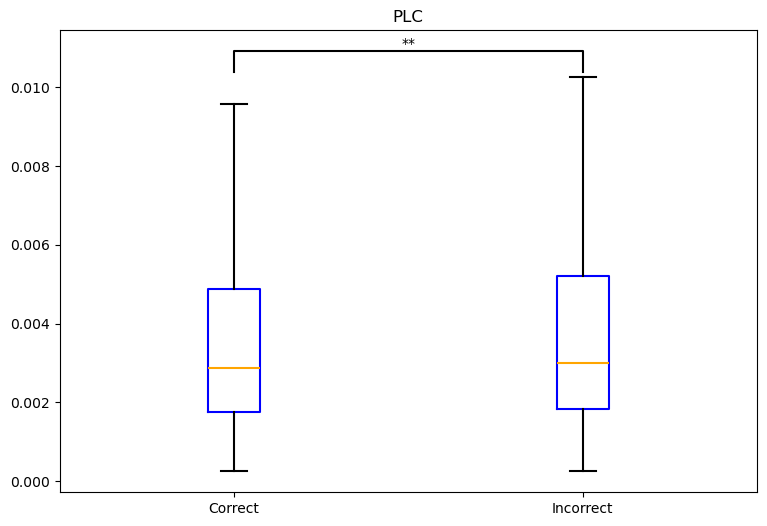

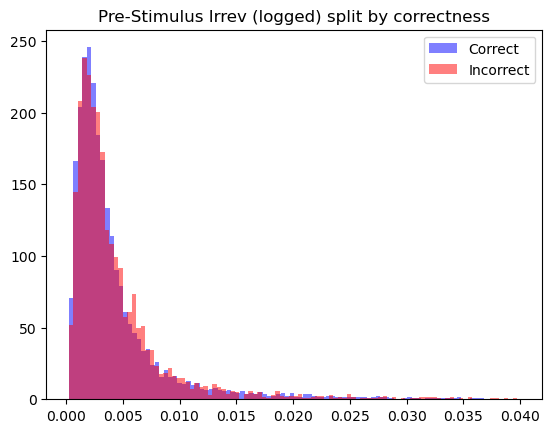

In [26]:
behavior = df

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


#behavior = behavior[behavior['drug'] == 'drug']
behavior = behavior[behavior['drug']=='ATX']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
correct_irrev = behavior[behavior['correct'] == 1]['prestim_irrev']
incorrect_irrev = behavior[behavior['correct'] == 0]['prestim_irrev']


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[correct_irrev, incorrect_irrev], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Correct', 'Incorrect'])
ax.set_title('PLC')


# Perform the Mann-Whitney U test
stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev, alternative = 'two-sided')
print(f'Statistic: {stat}, P-value: {p_value}')
print("mean of correct: " + str(np.mean(correct_irrev)))
print("mean of incorrect: " + str(np.mean(incorrect_irrev)))

# Significance annotation
Q3_group1 = np.percentile(correct_irrev, 75)
Q3_group2 = np.percentile(incorrect_irrev, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)


plt.show()

plt.hist(correct_irrev, bins=100, color='blue', alpha=0.5, label='Correct', density = True)
plt.hist(incorrect_irrev, bins=100, color='red', alpha=0.5, label='Incorrect', density = True)
plt.legend()
plt.title('Pre-Stimulus Irrev (logged) split by correctness')
plt.show()

### Per Irrev Bin

#### old method

irreversibility_bin
0    0.001583
1    0.002258
2    0.002746
3    0.003217
4    0.003719
5    0.004280
6    0.004957
7    0.005825
8    0.007149
9    0.011794
Name: irreversibility, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2332032809.py:24: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['correct'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'correct'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2332032809.py:27: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['correct'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'correct'), 0)


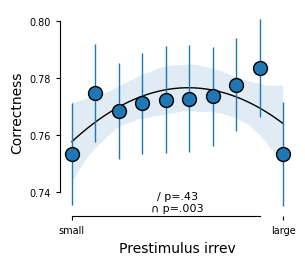

In [27]:
# Percent correct PER IRREV BIN
behavior = df
behavior['irreversibility'] = df['prestim_irrev']

#drug = 'PLC'
#drug = 'ATX'
#drug = 'DNP'
#behavior = behavior[(behavior['drug'] == drug)]

cfg = dict()
cfg['n_bins'] = 10 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = behavior.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['correct'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'correct'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['correct'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'correct'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_subject_irreversibility.groupby('irreversibility_bin').mean()['correct']
yerr = df_subject_irreversibility.groupby('irreversibility_bin').sem()['correct']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first_irreversibility['correct'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="correct", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second_irreversibility['correct'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="correct", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['correct']),
                                        p_val_string(betas_second_irreversibility['correct'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Correctness')
ax.set_xlabel('Prestimulus irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

#### new method

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1544448142.py:23: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['correct'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(1),('correct')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1544448142.py:25: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['correct'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(2),('correct')), 0)


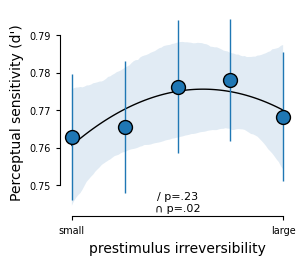

In [28]:
# ALL DRUGS

# Loading behavioral data
behavior = df
behavior['irreversibility'] = df['prestim_irrev']


cfg = {'n_bins': 5}  # Number of pupil bins
behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug', 'block'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['irreversibility'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True

df_subject = df_group.groupby(['subject', 'irreversibility_bin']).mean()
df_subject.reset_index(inplace=True)

betas_first = dict()
_, betas_first['correct'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(1),('correct')), 0)
betas_second = dict()
_, betas_second['correct'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_irrevbin,(2),('correct')), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_subject.groupby('irreversibility_bin').mean()['correct']
yerr = df_subject.groupby('irreversibility_bin').sem()['correct']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first['correct']
p_val_quadratic = betas_second['correct']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject, x="irreversibility_bin", y="correct", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject, x="irreversibility_bin", y="correct", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['correct']),
                                        p_val_string(betas_second['correct'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('prestimulus irreversibility')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

# Poststim

## Prestim vs. Poststim

Statistic: 55341829.0, P-value: 0.00018439633941778424
mean of prestim: 0.004435101188177535
mean of poststim: 0.003981965421043416
median of prestim: 0.002906241723179814
median of poststim: 0.003097480849643563


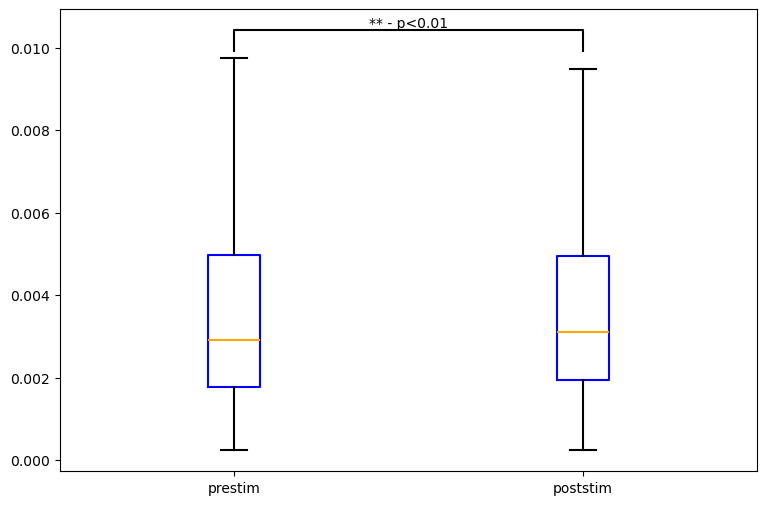

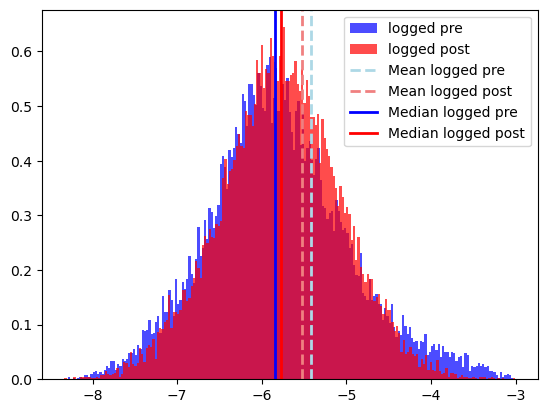

Statistic: -3.145397575179093, P-value: 0.0016618213967682718
Statistic: 110736900.0, P-value: 1.9017738701419008e-07


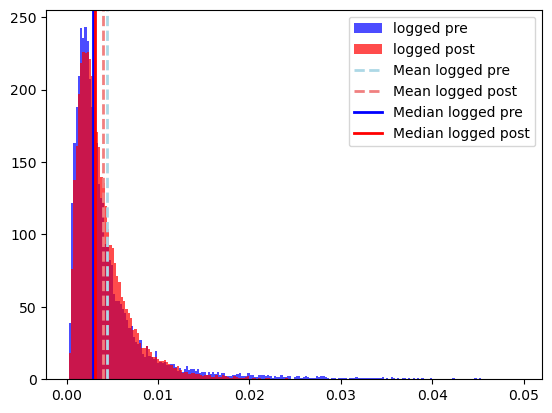

In [29]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


behavior = df
behavior = behavior[behavior['drug']=='ATX']
behavior = behavior[(behavior['poststim_irrev'] < 0.05) & (behavior['prestim_irrev'] < 0.05)]
pre = behavior['prestim_irrev']
post = behavior['poststim_irrev']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['prestim', 'poststim'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = stats.wilcoxon(pre, post, alternative = "two-sided")
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '** - p<0.01'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of prestim: " + str(np.mean(pre)))
print("mean of poststim: " + str(np.mean(post)))
print("median of prestim: " + str(np.median(pre)))
print("median of poststim: " + str(np.median(post)))

plt.show()



plt.hist(np.log(pre), bins=200, color='blue', alpha=0.7, label='logged pre', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.7, label='logged post', density = True)
plt.axvline(np.log(np.mean(pre)), color='lightblue', linestyle='dashed', linewidth=2, label='Mean logged pre')
plt.axvline(np.log(np.mean(post)), color='lightcoral', linestyle='dashed', linewidth=2, label='Mean logged post')

plt.axvline(np.log(np.median(pre)), color='blue', linestyle='solid', linewidth=2, label='Median logged pre')
plt.axvline(np.log(np.median(post)), color='red', linestyle='solid', linewidth=2, label='Median logged post')
plt.legend()
plt.show()

t_stat, p_value = stats.ttest_rel(np.log(pre), np.log(post))
print(f'Statistic: {t_stat}, P-value: {p_value}')

t_stat, p_value = mannwhitneyu(pre, post, alternative = "two-sided")
print(f'Statistic: {t_stat}, P-value: {p_value}')

plt.hist((pre), bins=200, color='blue', alpha=0.7, label='logged pre', density = True)
plt.hist((post), bins=200, color='red', alpha=0.7, label='logged post', density = True)
plt.axvline((np.mean(pre)), color='lightblue', linestyle='dashed', linewidth=2, label='Mean logged pre')
plt.axvline((np.mean(post)), color='lightcoral', linestyle='dashed', linewidth=2, label='Mean logged post')

plt.axvline((np.median(pre)), color='blue', linestyle='solid', linewidth=2, label='Median logged pre')
plt.axvline((np.median(post)), color='red', linestyle='solid', linewidth=2, label='Median logged post')
plt.legend()
plt.show()
#Well shit.

Statistic: 55493775.0, P-value: 0.0002925984136722273
mean of prestim: 0.004486812411679692
mean of poststim: 0.004008026464034103
median of prestim: 0.0029076360582561698
median of poststim: 0.0031007209105872804


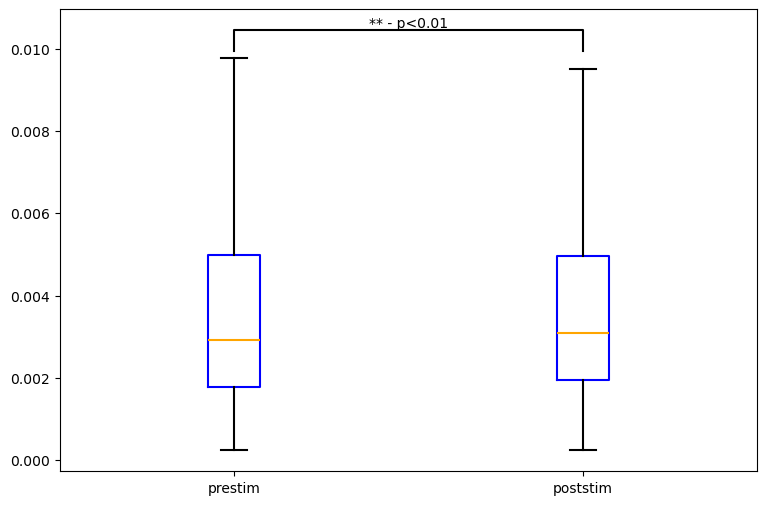

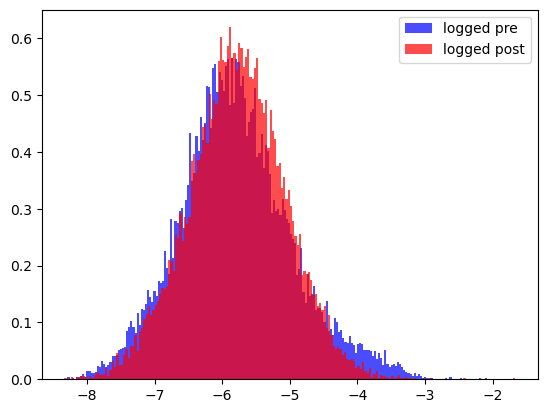

Statistic: -2.9472247025889815, P-value: 0.0032112857776141184
Statistic: 110934313.0, P-value: 2.1946473498622103e-07


In [30]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


behavior = df
behavior = behavior[behavior['drug']=='ATX']
pre = behavior['prestim_irrev']
post = behavior['poststim_irrev']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['prestim', 'poststim'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = stats.wilcoxon(pre, post, alternative = "two-sided")
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '** - p<0.01'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of prestim: " + str(np.mean(pre)))
print("mean of poststim: " + str(np.mean(post)))
print("median of prestim: " + str(np.median(pre)))
print("median of poststim: " + str(np.median(post)))

plt.show()

plt.hist(np.log(pre), bins=200, color='blue', alpha=0.7, label='logged pre', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.7, label='logged post', density = True)
plt.legend()
plt.show()

t_stat, p_value = stats.ttest_rel(np.log(pre), np.log(post))
print(f'Statistic: {t_stat}, P-value: {p_value}')

t_stat, p_value = mannwhitneyu(pre, post, alternative = "two-sided")
print(f'Statistic: {t_stat}, P-value: {p_value}')
#Well shit.

## Correctness

Statistic: 19570367.0, P-value: 0.11910962692940648
mean of correct: 0.004231356207098467
mean of incorrect: 0.004312528577686736
median of correct: 0.0034863678328664813
median of incorrect: 0.0035489140845771103


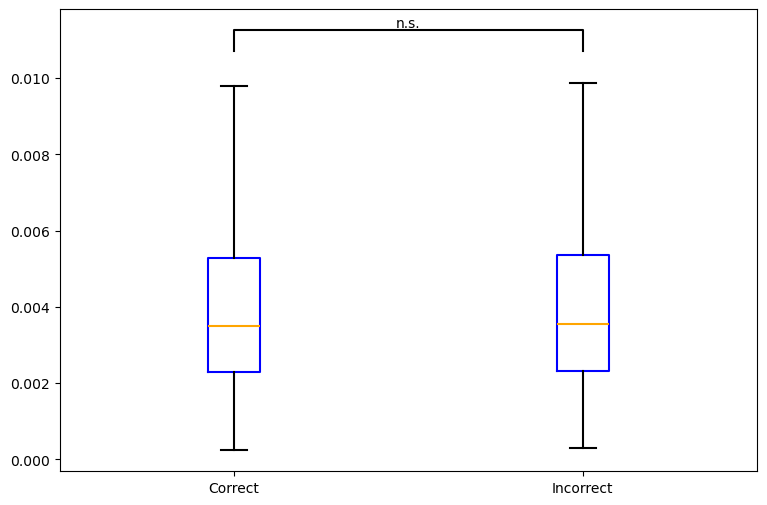

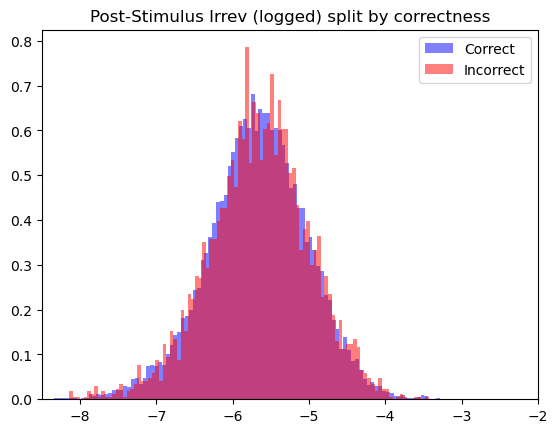

In [31]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu



behavior = df
#behavior = behavior[behavior['drug'] == drug]
behavior = behavior[behavior['drug']=='PLC']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]

correct_irrev = behavior[behavior['correct'] == 1]['poststim_irrev']
incorrect_irrev = behavior[behavior['correct'] == 0]['poststim_irrev']



# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[correct_irrev, incorrect_irrev], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Correct', 'Incorrect'])
#ax.set_title('ATX')


# Perform the Mann-Whitney U test
stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev, alternative = 'two-sided')
print(f'Statistic: {stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(correct_irrev, 75)
Q3_group2 = np.percentile(incorrect_irrev, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of correct: " + str(np.mean(correct_irrev)))
print("mean of incorrect: " + str(np.mean(incorrect_irrev)))
print("median of correct: " + str(np.median(correct_irrev)))
print("median of incorrect: " + str(np.median(incorrect_irrev)))

plt.show()

plt.hist(np.log(correct_irrev), bins=100, color='blue', alpha=0.5, label='Correct', density = True)
plt.hist(np.log(incorrect_irrev), bins=100, color='red', alpha=0.5, label='Incorrect', density = True)
plt.xlim(-8.5,-2)
plt.legend()
plt.title('Post-Stimulus Irrev (logged) split by correctness')
plt.show()

#Well shit.

### Diff pre to post irrev on correctness

Statistic: 182387983.0, P-value: 5.3511512128184996e-08
Mean correct: -0.0003559301973985623
Mean incorrect: -0.0005561340536430997
Median correct: 0.00012194776646563214
Median incorrect: 3.067060827853952e-05
-0.00040177290078156295


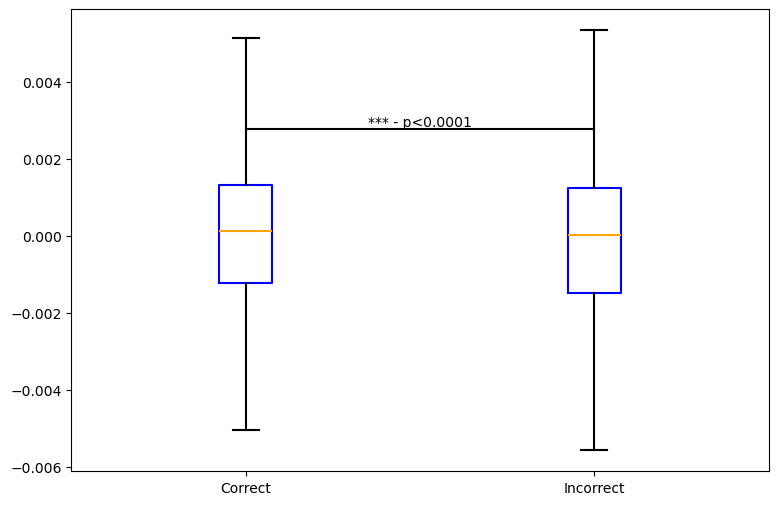

In [32]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

# Diff = (prestimulus_irrev_array - poststimulus_irrev_array)
#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
behavior = df
#behavior = behavior[behavior['drug']=='ATX']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]

correct_df = behavior[behavior['correct'] == 1]
incorrect_df = behavior[behavior['correct'] == 0]

correct_irrev = correct_df['stim_diff']
incorrect_irrev = incorrect_df['stim_diff']


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[correct_irrev, incorrect_irrev], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Correct', 'Incorrect'])
#ax.set_title('ATX')


# Perform the Mann-Whitney U test
stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev)
print(f'Statistic: {stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(correct_irrev, 75)
Q3_group2 = np.percentile(incorrect_irrev, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)


print("Mean correct: " + str(np.mean(behavior[behavior['correct']==1]['stim_diff'])))
print("Mean incorrect: " + str(np.mean(behavior[behavior['correct']==0]['stim_diff'])))
print("Median correct: " + str(np.median(behavior[behavior['correct']==1]['stim_diff'])))
print("Median incorrect: " + str(np.median(behavior[behavior['correct']==0]['stim_diff'])))
print(np.mean(behavior['stim_diff']))

plt.show()

#This is actually a good result

## Bins -- poststim

### old method

irreversibility_bin
0    0.002018
1    0.002948
2    0.003752
3    0.004799
4    0.008087
Name: poststim_irrev, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3777714390.py:30: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3777714390.py:33: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


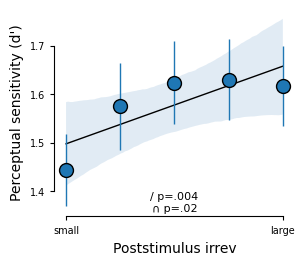

In [33]:
#drug = 'PLC'
behavior = df
#behavior = behavior[(behavior['drug'] == 'PLC')]
# ALL DRUGS

# Loading behavioral data
#behavior = pd.read_csv(r'C:\Users\jaket\COGS280\DataDeco\behavior.csv', index_col=0).reset_index(drop=True)


cfg = {'n_bins': 5}  # Number of pupil bins
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['poststim_irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','drug'])

        # make bins
df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','drug'])['poststim_irrev'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt_irreversibility = df_group.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)


print(behavior.groupby('irreversibility_bin').mean()['poststim_irrev'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first_irreversibility['d']
p_val_quadratic = betas_second_irreversibility['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststimulus irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()



### new method

irreversibility_bin
0    0.002058
1    0.002974
2    0.003762
3    0.004788
4    0.007618
Name: poststim_irrev, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2259245418.py:29: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2259245418.py:32: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


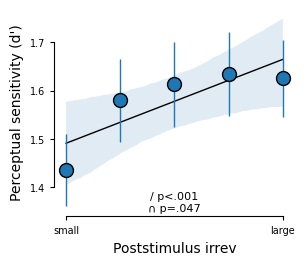

In [34]:
#drug = 'PLC'
behavior = df
#behavior = behavior[(behavior['drug'] == 'DNP')]

# Use the function
#behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.995)

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

cfg = {'n_bins': 5}  # Number of pupil bins

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['poststim_irrev'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt_irreversibility = df_group.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)


print(df_group.groupby('irreversibility_bin').mean()['poststim_irrev'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first_irreversibility['d']
p_val_quadratic = betas_second_irreversibility['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststimulus irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2093107622.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['poststim_irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


irreversibility_bin
0    0.001900
1    0.002771
2    0.003535
3    0.004532
4    0.007301
Name: poststim_irrev, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2093107622.py:26: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2093107622.py:29: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


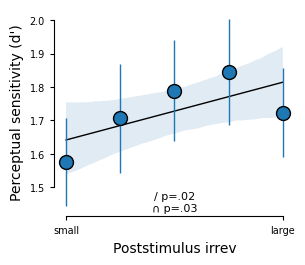

In [35]:
#drug = 'PLC'
behavior = df
behavior = behavior[(behavior['drug'] == 'ATX')]


cfg = {'n_bins': 5}  # Number of pupil bins
behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['poststim_irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['poststim_irrev'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt_irreversibility = df_group.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)


print(behavior.groupby('irreversibility_bin').mean()['poststim_irrev'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first_irreversibility['d']
p_val_quadratic = betas_second_irreversibility['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststimulus irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

### RT

irreversibility_bin
0    0.001703
1    0.002335
2    0.002756
3    0.003140
4    0.003538
5    0.003966
6    0.004471
7    0.005126
8    0.006138
9    0.010018
Name: poststimulus_irreversibility, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3093539802.py:24: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['RT'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'RT'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3093539802.py:27: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['RT'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'RT'), 0)


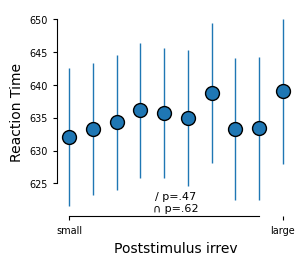

In [36]:
#drug = 'PLC'
behavior = df
behavior['poststimulus_irreversibility'] = df['poststim_irrev']
#behavior = behavior[(behavior['drug'] == drug)]


cfg = dict()
cfg['n_bins'] = 10 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['poststimulus_irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
correct_counts = True
df_sdt = behavior.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
df_sdt['RT'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['RT']
df_subject_irreversibility = df_sdt.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['poststimulus_irreversibility'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['RT'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'RT'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['RT'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'RT'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('irreversibility_bin').mean()['RT']
yerr = df_sdt.groupby('irreversibility_bin').sem()['RT']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first_irreversibility['RT']
p_val_quadratic = betas_second_irreversibility['RT']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="RT", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="RT", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['RT']),
                                        p_val_string(betas_second_irreversibility['RT'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Reaction Time')
ax.set_xlabel('Poststimulus irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

Plotted with both linear and quadratic

The amount of empty cells is : 0
irreversibility_bin
0    0.002018
1    0.002948
2    0.003752
3    0.004799
4    0.008087
Name: poststimulus_irreversibility, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\4271951831.py:24: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\4271951831.py:27: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


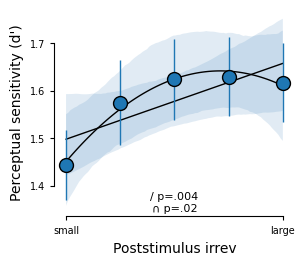

In [37]:
behavior = df
behavior['poststimulus_irreversibility'] = df['poststim_irrev']

cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['poststimulus_irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['poststimulus_irreversibility'])

betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststimulus irrev')
ax.set_xticks([0,4])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

### diff bins!

#### old method

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\325609397.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['diff_bin'] = behavior.groupby(['subject','drug'])['stim_diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


The amount of empty cells is : 0
diff_bin
0   -0.005188
1   -0.001538
2   -0.000153
3    0.001051
4    0.003954
Name: stim_diff, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\325609397.py:32: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\325609397.py:35: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 2, 'd'), 0)


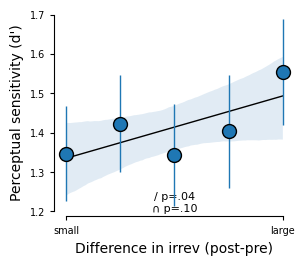

In [38]:
def run_model_diffbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['diff_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

behavior = df
#behavior = behavior[(behavior['poststim_irrev'] < 0.02) & (behavior['prestim_irrev'] < 0.02)]
behavior = behavior[behavior['drug'] == 'PLC']

cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['diff_bin'] = behavior.groupby(['subject','drug'])['stim_diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','diff_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'diff_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('diff_bin').mean()['stim_diff'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('diff_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('diff_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Difference in irrev (post-pre)')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

#### logged diff

The amount of empty cells is : 0
diff_bin
0   -0.778119
1   -0.267529
2    0.035975
3    0.333300
4    0.817019
Name: stim_diff, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1431411950.py:33: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1431411950.py:36: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 2, 'd'), 0)


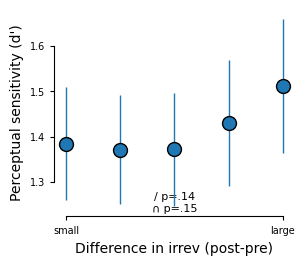

In [39]:
def run_model_diffbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['diff_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

behavior = df
behavior = behavior[behavior['drug'] == 'PLC']
behavior = behavior[(behavior['poststim_irrev'] < 0.02) & (behavior['prestim_irrev'] < 0.02)]
behavior['stim_diff'] = behavior['log_poststim'] - behavior['log_prestim']

cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['diff_bin'] = behavior.groupby(['subject','drug'])['stim_diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','diff_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'diff_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('diff_bin').mean()['stim_diff'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('diff_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('diff_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Difference in irrev (post-pre)')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

#### new method

diff_bin
0   -0.004697
1   -0.001490
2   -0.000229
3    0.000938
4    0.003412
Name: irreversibility, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1644437155.py:27: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_diffbin,(1),('d')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1644437155.py:29: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_diffbin,(2),('d')), 0)


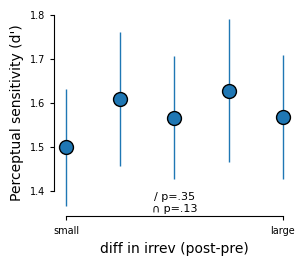

In [40]:
# ALL DRUGS

# Loading behavioral data
behavior = df
behavior = behavior[behavior['drug'] == 'DNP']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
behavior['irreversibility'] = df['stim_diff']

cfg = {'n_bins': 5}  # Number of pupil bins
behavior['diff_bin'] = behavior.groupby(['subject', 'drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['diff_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['irreversibility'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','diff_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject = df_sdt.groupby(['subject', 'diff_bin']).mean()
df_subject.reset_index(inplace=True)

print(behavior.groupby('diff_bin').mean()['irreversibility'])

betas_first = dict()
_, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_diffbin,(1),('d')), 0)
betas_second = dict()
_, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_diffbin,(2),('d')), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('diff_bin').mean()['d']
yerr = df_sdt.groupby('diff_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first['d']
p_val_quadratic = betas_second['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['d']),
                                        p_val_string(betas_second['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('diff in irrev (post-pre)')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\266897092.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irreversibility'] = df['log_poststim'] - df['log_prestim']
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\266897092.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['diff_bin'] = behavior.groupby(['subject', 'drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


diff_bin
0   -0.798906
1   -0.282086
2    0.022487
3    0.325355
4    0.815100
Name: irreversibility, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\266897092.py:27: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_diffbin,(1),('d')), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\266897092.py:29: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_diffbin,(2),('d')), 0)


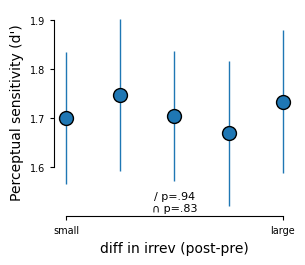

In [41]:


# ALL DRUGS

# Loading behavioral data
behavior = df
behavior = behavior[behavior['drug'] == 'ATX']

behavior['irreversibility'] = df['log_poststim'] - df['log_prestim']

cfg = {'n_bins': 5}  # Number of pupil bins
behavior['diff_bin'] = behavior.groupby(['subject', 'drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['diff_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['irreversibility'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','diff_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject = df_sdt.groupby(['subject', 'diff_bin']).mean()
df_subject.reset_index(inplace=True)

print(behavior.groupby('diff_bin').mean()['irreversibility'])

betas_first = dict()
_, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_diffbin,(1),('d')), 0)
betas_second = dict()
_, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_diffbin,(2),('d')), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('diff_bin').mean()['d']
yerr = df_sdt.groupby('diff_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first['d']
p_val_quadratic = betas_second['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['d']),
                                        p_val_string(betas_second['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('diff in irrev (post-pre)')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

#### Placebo diff bins

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1466968526.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['diff_bin'] = behavior.groupby(['subject','drug'])['stim_diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


The amount of empty cells is : 0
diff_bin
0   -0.005188
1   -0.001538
2   -0.000153
3    0.001051
4    0.003954
Name: stim_diff, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1466968526.py:31: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1466968526.py:34: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 2, 'd'), 0)


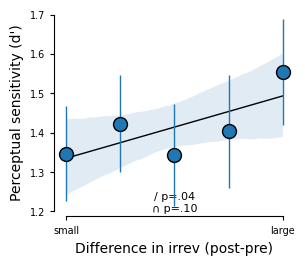

In [43]:
def run_model_diffbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['diff_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

behavior = df
behavior = behavior[behavior['drug']=='PLC']

cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['diff_bin'] = behavior.groupby(['subject','drug'])['stim_diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','diff_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'diff_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('diff_bin').mean()['stim_diff'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('diff_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('diff_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Difference in irrev (post-pre)')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

### logged irrev testing in these binned plots

old method

The amount of empty cells is : 0
log_bin
0   -6.364014
1   -5.952009
2   -5.698547
3   -5.441301
4   -4.989370
Name: log_poststim, dtype: float64
   subject  log_bin         d         c        hr       far
0        1        0  0.889748 -0.142903  0.716667  0.384003
1        1        1  0.955692 -0.147688  0.732506  0.375495
2        1        2  0.870016  0.025800  0.652500  0.325926
3        1        3  0.902991 -0.211283  0.742252  0.408991
4        1        4  0.812041 -0.356856  0.760542  0.478143


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3890576490.py:32: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_logbin, 1, 'd'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3890576490.py:35: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_logbin, 2, 'd'), 0)


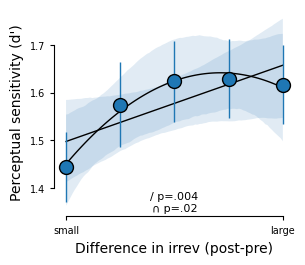

In [44]:
behavior = df

def run_model_logbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['log_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['log_bin'] = behavior.groupby(['subject','drug'])['log_poststim'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','log_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'log_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('log_bin').mean()['log_poststim'])

print(df_subject_irreversibility.head())


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_logbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_logbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('log_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('log_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="log_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="log_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Difference in irrev (post-pre)')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

This is pre and post stim irrev in the same plotting bins

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2473148076.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['poststimulus_irreversibility'] = df['prestim_irrev']
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2473148076.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['poststimulus_irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


irreversibility_bin
0    0.001531
1    0.002160
2    0.002586
3    0.003010
4    0.003429
5    0.003903
6    0.004486
7    0.005205
8    0.006283
9    0.009082
Name: poststimulus_irreversibility, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2473148076.py:24: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['poststim_irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'poststim_irrev'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2473148076.py:27: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['poststim_irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'poststim_irrev'), 0)


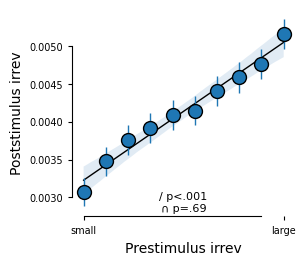

In [45]:
#drug = 'PLC'
behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.02) & (behavior['prestim_irrev'] < 0.02)]
behavior['poststimulus_irreversibility'] = df['prestim_irrev']
#behavior = behavior[(behavior['drug'] == drug)]

cfg = dict()
cfg['n_bins'] = 10 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['poststimulus_irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
correct_counts = True
df_sdt = behavior.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
df_sdt['poststim_irrev'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['poststim_irrev']
df_subject_irreversibility = df_sdt.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['poststimulus_irreversibility'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['poststim_irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'poststim_irrev'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['poststim_irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'poststim_irrev'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('irreversibility_bin').mean()['poststim_irrev']
yerr = df_sdt.groupby('irreversibility_bin').sem()['poststim_irrev']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first_irreversibility['poststim_irrev']
p_val_quadratic = betas_second_irreversibility['poststim_irrev']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="poststim_irrev", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="poststim_irrev", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['poststim_irrev']),
                                        p_val_string(betas_second_irreversibility['poststim_irrev'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Poststimulus irrev')
ax.set_xlabel('Prestimulus irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

## Stimulus processing

['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\4073451972.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['left_cue_irrev'] = left_cue_irrev # RIGHT HEMISPHERE
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\4073451972.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['poststim_contributions'] = contribution_arr
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\4073451972.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

left cue associated irrev during left cue (expect higher): 0.00932983113712338
other hemisphere irrev in same (expect lower): 0.009420908078902732


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\4073451972.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['poststim_ratio'] = behavior['poststim_contributions']/behavior['poststim_irrev']


left stimulus
right stimulus


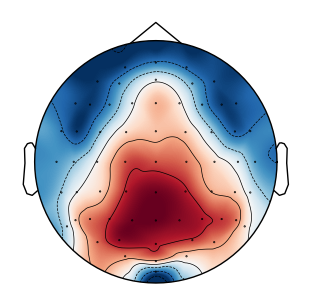

avg


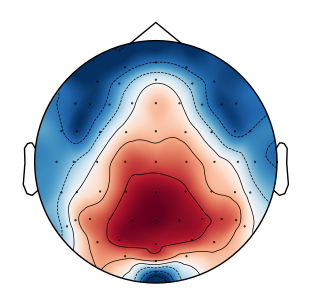

leftstim - avg: 


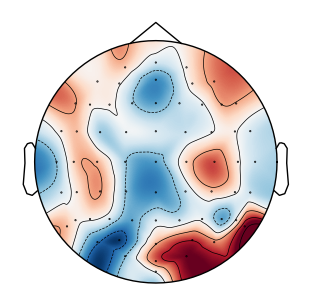

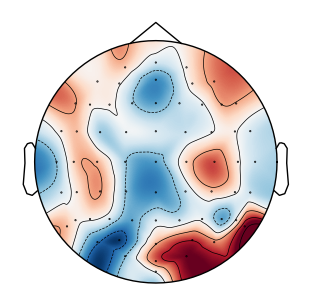

rightstim - avg: 


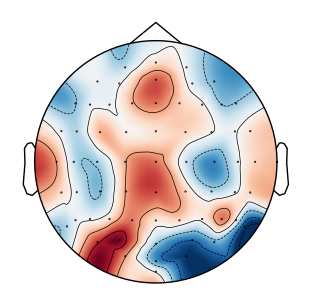

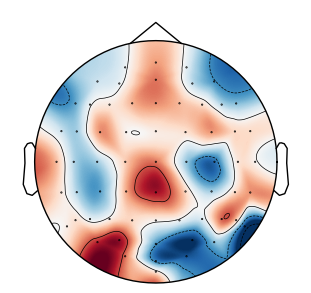

(<matplotlib.image.AxesImage at 0x25ae288f100>,
 <matplotlib.contour.QuadContourSet at 0x25ae286fdc0>)

In [46]:
from scipy.stats import zscore

left_cue_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left cue
right_cue_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right cue
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_cue_indices = [channels.index(elec) for elec in left_cue_ROI if elec in channels]
right_cue_indices = [channels.index(elec) for elec in right_cue_ROI if elec in channels]

contribution_arr = []
left_cue_irrev = []
for matrix in behavior['poststim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    contribution_arr.append(contribution)
    left_cue_trial = np.mean(contribution[left_cue_indices])
    left_cue_irrev.append(left_cue_trial)
behavior['left_cue_irrev'] = left_cue_irrev # RIGHT HEMISPHERE
behavior['poststim_contributions'] = contribution_arr

right_cue_irrev = []
for matrix in behavior['poststim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    right_cue_trial = np.mean(contribution[right_cue_indices])
    right_cue_irrev.append(right_cue_trial)
behavior['right_cue_irrev'] = right_cue_irrev  # LEFT HEMISPHERE

print("left cue associated irrev during left cue (expect higher): " + str(np.mean(behavior[behavior['location'] == 0]['left_cue_irrev'])))
print("other hemisphere irrev in same (expect lower): " + str(np.mean(behavior[behavior['location'] == 0]['right_cue_irrev'])))

data1 = np.zeros((64, 128)) # Replace with your data
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
channel_locs = montage.get_positions()['ch_pos']
info = mne.create_info(channels, sfreq=128, ch_types='eeg')
info.set_montage(montage) # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)

behavior['poststim_ratio'] = behavior['poststim_contributions']/behavior['poststim_irrev']

print("left stimulus")
leftcue_refmatrix = behavior[behavior['location'] == 0]['poststim_contributions'].mean()
zscore_matrix = zscore(leftcue_refmatrix, axis=None)

print("right stimulus")
rightcue_refmatrix = behavior[behavior['location'] == 1]['poststim_contributions'].mean()
zscore_matrix = zscore(rightcue_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)


print("avg")
zscore_matrix = zscore(behavior['poststim_contributions'].mean(), axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

print("leftstim - avg: ")
leftminusavg_refmatrix = leftcue_refmatrix - behavior['poststim_contributions'].mean()
zscore_matrix = zscore(leftminusavg_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

zscore_matrix1 = zscore((behavior[behavior['location'] == 0]['poststim_ratio'].mean() - behavior['poststim_ratio'].mean()), axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)


print("rightstim - avg: ")
rightminusavg_refmatrix =  rightcue_refmatrix - behavior['poststim_contributions'].mean()
zscore_matrix = zscore(rightminusavg_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

zscore_matrix1 = zscore((behavior[behavior['location'] == 1]['poststim_ratio'].mean() - behavior['poststim_ratio'].mean()), axis=None)
mne.viz.plot_topomap(zscore_matrix1, raw.info, res = 400, size = 3)

### Left cue...

['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3440794366.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['right_occip_irrev'] = left_cue_irrev # RIGHT HEMISPHERE
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3440794366.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['poststim_contributions'] = contribution_arr
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3440794366.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

left hemisphere occip during left cue left stimulus (expect lower): 0.009420908078902732
right hemisphere occip during left cue left stimulus (expect lower): 0.00932983113712338
left cue, left stimulus


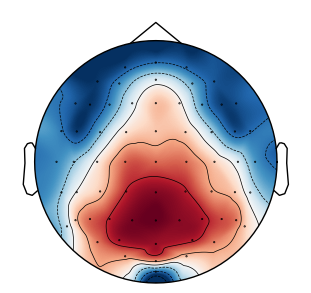

left cue, right stimulus


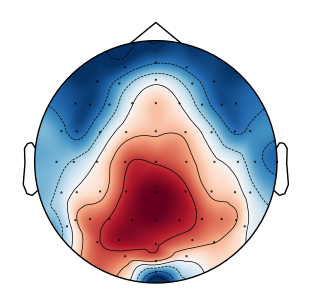

avg left cue


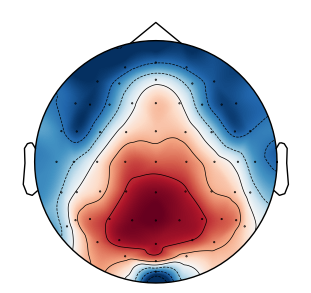

leftstimulus - avg left cue: 


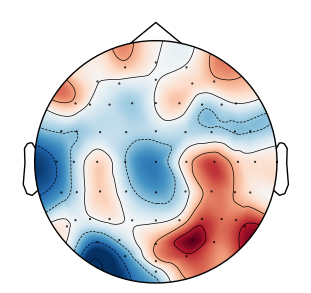

rightstimulus - avg left cue: 


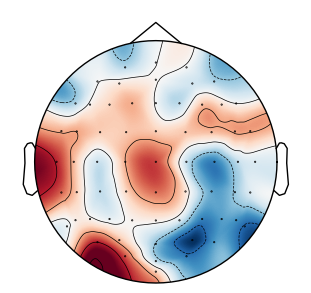

(<matplotlib.image.AxesImage at 0x25ae25213a0>,
 <matplotlib.contour.QuadContourSet at 0x25ae2521850>)

In [47]:
from scipy.stats import zscore

left_cue_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left cue
right_cue_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right cue
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_cue_indices = [channels.index(elec) for elec in left_cue_ROI if elec in channels]
right_cue_indices = [channels.index(elec) for elec in right_cue_ROI if elec in channels]

contribution_arr = []
left_cue_irrev = []
for matrix in behavior['poststim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    contribution_arr.append(contribution)
    left_cue_trial = np.mean(contribution[left_cue_indices])
    left_cue_irrev.append(left_cue_trial)
behavior['right_occip_irrev'] = left_cue_irrev # RIGHT HEMISPHERE
behavior['poststim_contributions'] = contribution_arr

right_cue_irrev = []
for matrix in behavior['poststim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    right_cue_trial = np.mean(contribution[right_cue_indices])
    right_cue_irrev.append(right_cue_trial)
behavior['left_occip_irrev'] = right_cue_irrev  # LEFT HEMISPHERE

print("left hemisphere occip during left cue left stimulus (expect lower): " + str(np.mean(behavior[behavior['location'] == 0]['left_occip_irrev'])))
print("right hemisphere occip during left cue left stimulus (expect lower): " + str(np.mean(behavior[behavior['location'] == 0]['right_occip_irrev'])))

data1 = np.zeros((64, 128)) # Replace with your data
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
channel_locs = montage.get_positions()['ch_pos']
info = mne.create_info(channels, sfreq=128, ch_types='eeg')
info.set_montage(montage) # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)

behavior['poststim_ratio'] = behavior['poststim_contributions']/behavior['poststim_irrev']

print("left cue, left stimulus")
leftcue_refmatrix = behavior[(behavior['cue'] == 0) & (behavior['location'] == 0)]['poststim_contributions'].mean()
zscore_matrix = zscore(leftcue_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

print("left cue, right stimulus")
rightcue_refmatrix = behavior[(behavior['cue'] == 0) & (behavior['location'] == 1)]['poststim_contributions'].mean()
zscore_matrix = zscore(rightcue_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)


print("avg left cue")
zscore_matrix = zscore(behavior[(behavior['cue'] == 0)]['poststim_contributions'].mean(), axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

print("leftstimulus - avg left cue: ")
leftminusavg_refmatrix = leftcue_refmatrix - behavior[(behavior['cue'] == 0)]['poststim_contributions'].mean()
zscore_matrix = zscore(leftminusavg_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

#zscore_matrix1 = zscore((behavior[behavior['location'] == 0]['poststim_ratio'].mean() - behavior['poststim_ratio'].mean()), axis=None)
#mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)


print("rightstimulus - avg left cue: ")
rightminusavg_refmatrix =  rightcue_refmatrix - behavior[(behavior['cue'] == 0)]['poststim_contributions'].mean()
zscore_matrix = zscore(rightminusavg_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

#zscore_matrix1 = zscore((behavior[behavior['location'] == 1]['poststim_ratio'].mean() - behavior['poststim_ratio'].mean()), axis=None)
#mne.viz.plot_topomap(zscore_matrix1, raw.info, res = 400, size = 3)

## Cue Validity

### Cue invalid should be higher than cue-valid? Attentional switching

Statistic: 89657747.0, P-value: 0.17195600385133047
Cue valid mean:0.004176318831076479
Cue invalid mean: 0.004235028869556353


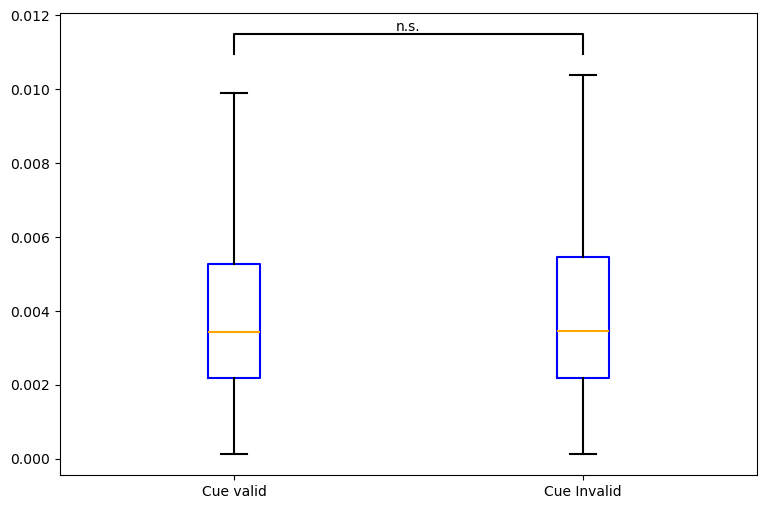

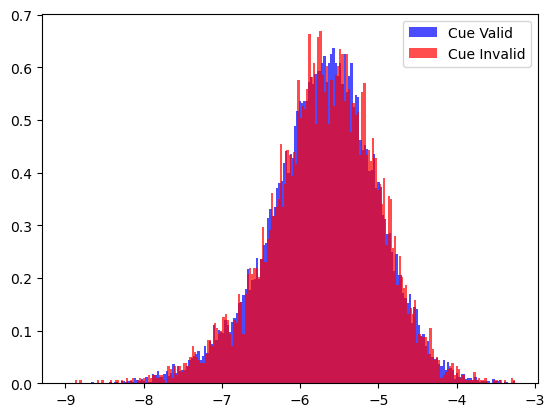

In [48]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
behavior = behavior[behavior['correct']==1]

#drug_df = behavior[behavior['drug'] == 'PLC']
drug_df = behavior
correct_df = drug_df[(drug_df['cue_val'] == 1)]
incorrect_df = drug_df[(drug_df['cue_val'] == 0)]

correct_irrev = correct_df['poststim_irrev']
incorrect_irrev = incorrect_df['poststim_irrev']


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[correct_irrev, incorrect_irrev], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Cue valid', 'Cue Invalid'])
#ax.set_title('ATX')


# Perform the Mann-Whitney U test
stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev)
print(f'Statistic: {stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(correct_irrev, 75)
Q3_group2 = np.percentile(incorrect_irrev, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)


print("Cue valid mean:" + str(np.mean(correct_irrev)))
print("Cue invalid mean: "+str(np.mean(incorrect_irrev)))

plt.show()

plt.hist(np.log(correct_irrev), bins=200, color='blue', alpha=0.7, label='Cue Valid', density = True)
plt.hist(np.log(incorrect_irrev), bins=200, color='red', alpha=0.7, label='Cue Invalid', density = True)
plt.legend()
plt.show()

#Nope...

Now in diff

Statistic: 89580412.0, P-value: 0.14070956619936412
Cue valid mean:-0.00036865567470791927
Cue invalid mean: -0.0003010579549413974


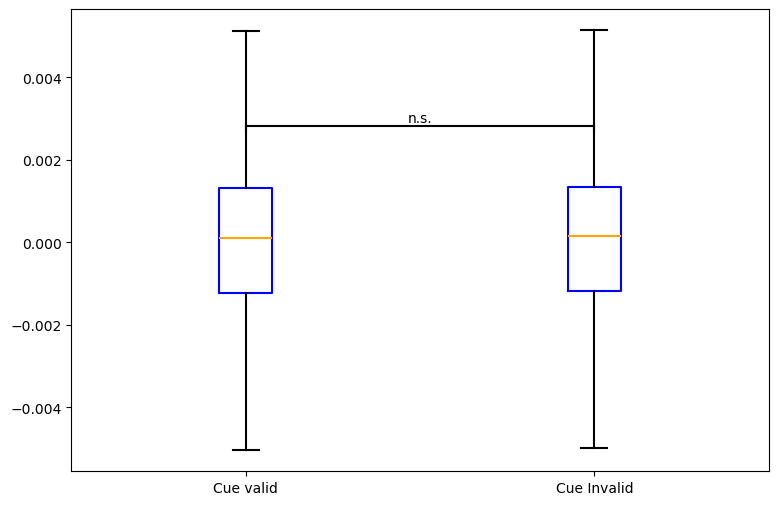

c:\Users\Jake\anaconda3\envs\recoveredenv\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


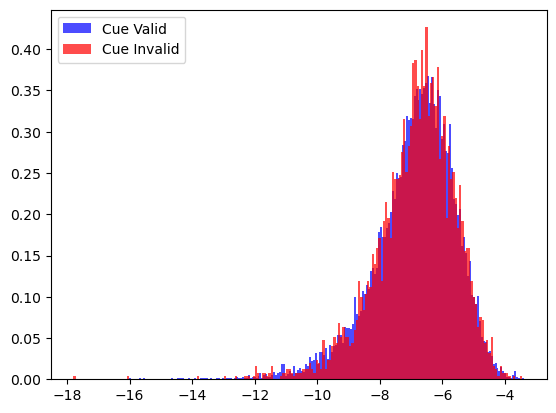

In [49]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
behavior = behavior[behavior['correct']==1]

#drug_df = behavior[behavior['drug'] == 'PLC']
drug_df = behavior
correct_df = drug_df[(drug_df['cue_val'] == 1)]
incorrect_df = drug_df[(drug_df['cue_val'] == 0)]

correct_irrev = correct_df['stim_diff']
incorrect_irrev = incorrect_df['stim_diff']


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[correct_irrev, incorrect_irrev], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Cue valid', 'Cue Invalid'])
#ax.set_title('ATX')


# Perform the Mann-Whitney U test
stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev)
print(f'Statistic: {stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(correct_irrev, 75)
Q3_group2 = np.percentile(incorrect_irrev, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)


print("Cue valid mean:" + str(np.mean(correct_irrev)))
print("Cue invalid mean: "+str(np.mean(incorrect_irrev)))

plt.show()

plt.hist(np.log(correct_irrev), bins=200, color='blue', alpha=0.7, label='Cue Valid', density = True)
plt.hist(np.log(incorrect_irrev), bins=200, color='red', alpha=0.7, label='Cue Invalid', density = True)
plt.legend()
plt.show()

#Nope...

['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']
left cue associated irrev during left cue (expect higher): 0.00973381319373169
other hemisphere irrev in same (expect lower): 0.010127995560034216
left cue


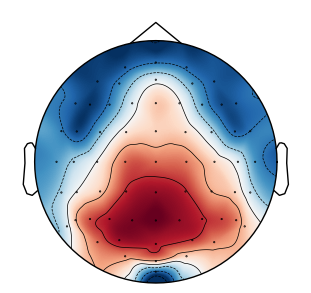

(<matplotlib.image.AxesImage at 0x25ae51839d0>,
 <matplotlib.contour.QuadContourSet at 0x25ae5183d30>)

In [50]:
from scipy.stats import zscore

behavior = df

left_cue_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left cue
right_cue_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right cue
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_cue_indices = [channels.index(elec) for elec in left_cue_ROI if elec in channels]
right_cue_indices = [channels.index(elec) for elec in right_cue_ROI if elec in channels]

left_cue_irrev = []
contribution_arr = []
for matrix in behavior['poststim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    contribution_arr.append(contribution)
    left_cue_trial = np.mean(contribution[left_cue_indices])
    left_cue_irrev.append(left_cue_trial)
behavior['left_cue_irrev'] = left_cue_irrev # RIGHT HEMISPHERE
behavior['contributions'] = contribution_arr

right_cue_irrev = []
for matrix in behavior['poststim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    right_cue_trial = np.mean(contribution[right_cue_indices])
    right_cue_irrev.append(right_cue_trial)
behavior['right_cue_irrev'] = right_cue_irrev  # LEFT HEMISPHERE

print("left cue associated irrev during left cue (expect higher): " + str(np.mean(behavior[behavior['cue'] == 0]['left_cue_irrev'])))
print("other hemisphere irrev in same (expect lower): " + str(np.mean(behavior[behavior['cue'] == 0]['right_cue_irrev'])))


data1 = np.zeros((64, 128)) # Replace with your data
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
channel_locs = montage.get_positions()['ch_pos']
info = mne.create_info(channels, sfreq=128, ch_types='eeg')
info.set_montage(montage) # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)

print("left cue")
leftcue_refmatrix = behavior[behavior['cue'] == 0]['contributions'].mean()
zscore_matrix = zscore(leftcue_refmatrix, axis=None)

mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

### Cue invalid / correct should be higher than cue-valid / correct

Statistic: 87635484.0, P-value: 3.391101649501273e-06
Cue valid/corr: 0.004700690592720309
Cue invalid/corr: 0.004394716072287158
Diff valid - invalid: 0.0003059745204331511


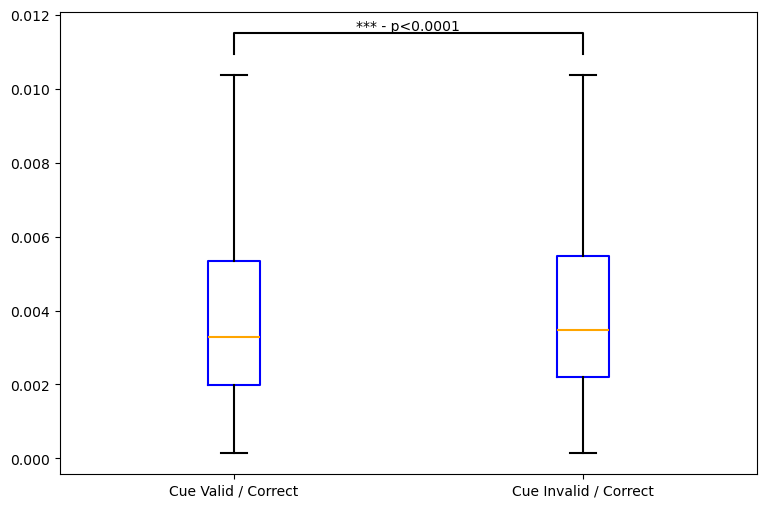

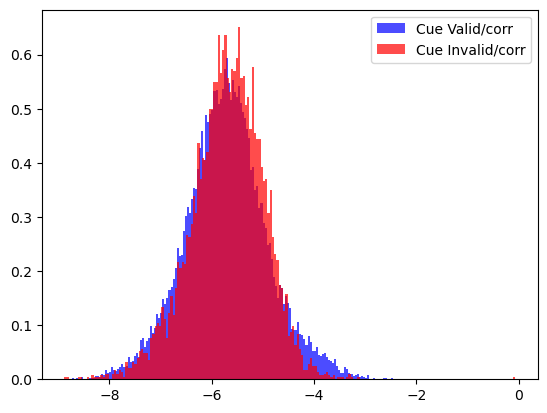

In [52]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

behavior = df

#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
drug_df = behavior
correct_df = drug_df[(drug_df['correct'] == 1) & (drug_df['cue_val'] == 1)]
incorrect_df = drug_df[(drug_df['correct'] == 1) & (drug_df['cue_val'] == 0)]

correct_irrev = correct_df['prestim_irrev']
incorrect_irrev = incorrect_df['poststim_irrev']


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[correct_irrev, incorrect_irrev], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Cue Valid / Correct', 'Cue Invalid / Correct'])
#ax.set_title('ATX')


# Perform the Mann-Whitney U test
stat, p_value = stats.mannwhitneyu(correct_irrev, incorrect_irrev, alternative='two-sided')
print(f'Statistic: {stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(correct_irrev, 75)
Q3_group2 = np.percentile(incorrect_irrev, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)


print("Cue valid/corr: "+str(np.mean(correct_irrev)))
print("Cue invalid/corr: "+str(np.mean(incorrect_irrev)))
print("Diff valid - invalid: " + str(np.mean(correct_irrev) -np.mean(incorrect_irrev)))

plt.show()

plt.hist(np.log(correct_irrev), bins=200, color='blue', alpha=0.7, label='Cue Valid/corr', density = True)
plt.hist(np.log(incorrect_irrev), bins=200, color='red', alpha=0.7, label='Cue Invalid/corr', density = True)
plt.legend()
plt.show()
#Nope...

#### Placebo

### Cue invalid / correct should be higher than cue invalid / incorrect

Statistic: 7677241.0, P-value: 0.19327706704388592
0.004447364748066324
0.004344094649315517
6482
2412


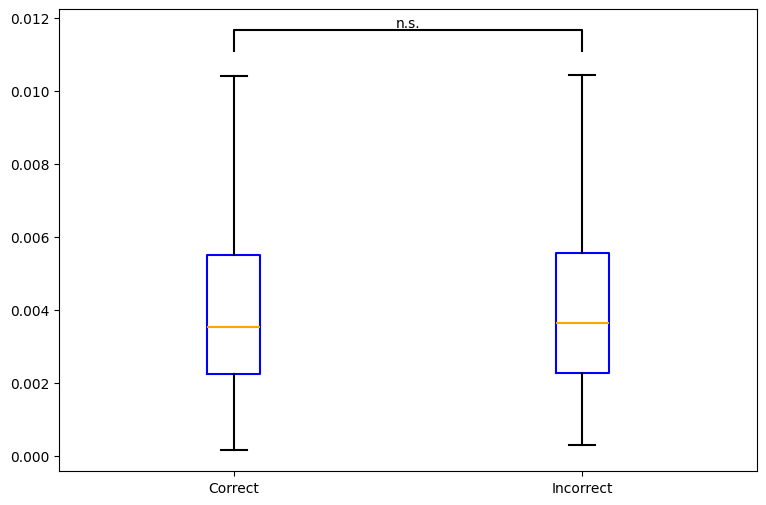

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
drug_df = behavior
correct_df = drug_df[(drug_df['correct'] == 1) & (drug_df['cue_val'] == 0)]
incorrect_df = drug_df[(drug_df['correct'] == 0) & (drug_df['cue_val'] == 0)]

correct_irrev = correct_df['poststimulus_irreversibility']
incorrect_irrev = incorrect_df['poststimulus_irreversibility']


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[correct_irrev, incorrect_irrev], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Correct', 'Incorrect'])
#ax.set_title('ATX')


# Perform the Mann-Whitney U test
stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev, alternative='two-sided')
print(f'Statistic: {stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(correct_irrev, 75)
Q3_group2 = np.percentile(incorrect_irrev, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)


print(np.mean(correct_irrev))
print(np.mean(incorrect_irrev))

print(len(correct_irrev))
print(len(incorrect_irrev))

plt.show()

#Nope...

# Histograms

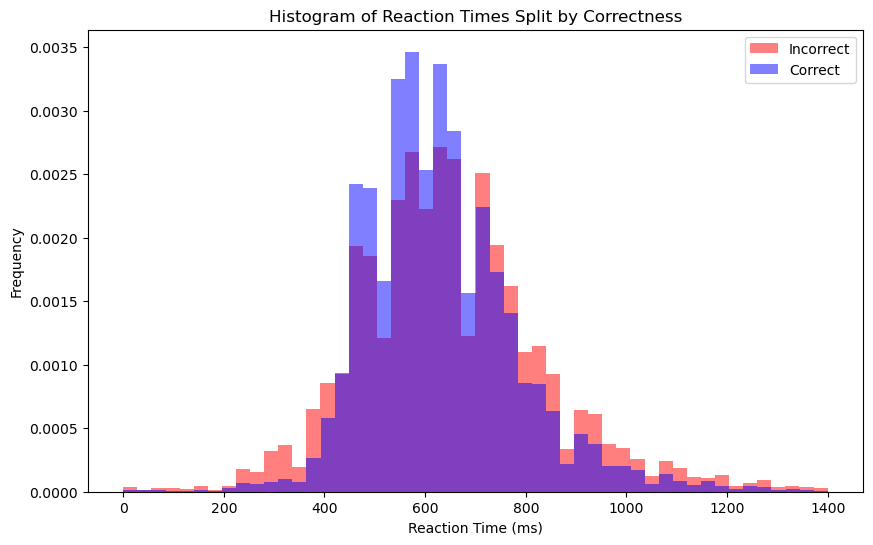

-10.69723105550715
1.1294622392837122e-26


In [54]:

behavior = df

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
rt_incorrect = behavior[behavior['correct'] == 0]['RT']
plt.hist(rt_incorrect, bins=50, alpha=0.5, label='Incorrect', color='red', density = True)

# Histogram for RT when correct is 1
rt_correct = behavior[behavior['correct'] == 1]['RT']
plt.hist(rt_correct, bins=50, alpha=0.5, label='Correct', color='blue', density = True)

# Adding labels and title
plt.xlabel('Reaction Time (ms)')
plt.ylabel('Frequency')
plt.title('Histogram of Reaction Times Split by Correctness')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.ttest_ind(rt_correct, rt_incorrect)

print(t_stat)
print(p_value)

## prestimulus

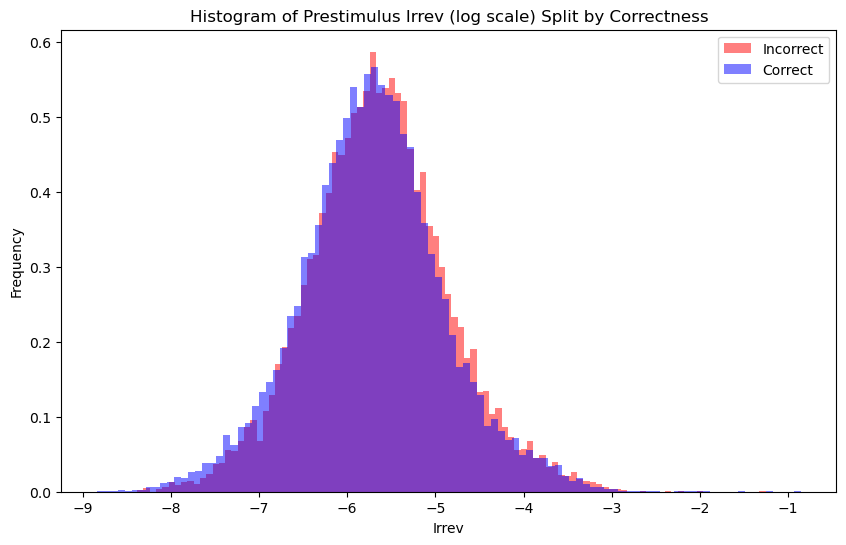

-5.000310028434428
5.745399743286887e-07


In [55]:

behavior = df

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
rt_incorrect = behavior[behavior['correct'] == 0]['prestim_irrev']
plt.hist(np.log(rt_incorrect), bins=100, alpha=0.5, label='Incorrect', color='red', density = True)

# Histogram for RT when correct is 1
rt_correct = behavior[behavior['correct'] == 1]['prestim_irrev']
plt.hist(np.log(rt_correct), bins=100, alpha=0.5, label='Correct', color='blue', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestimulus Irrev (log scale) Split by Correctness')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.ttest_ind(rt_correct, rt_incorrect)

print(t_stat)
print(p_value)

### by drug

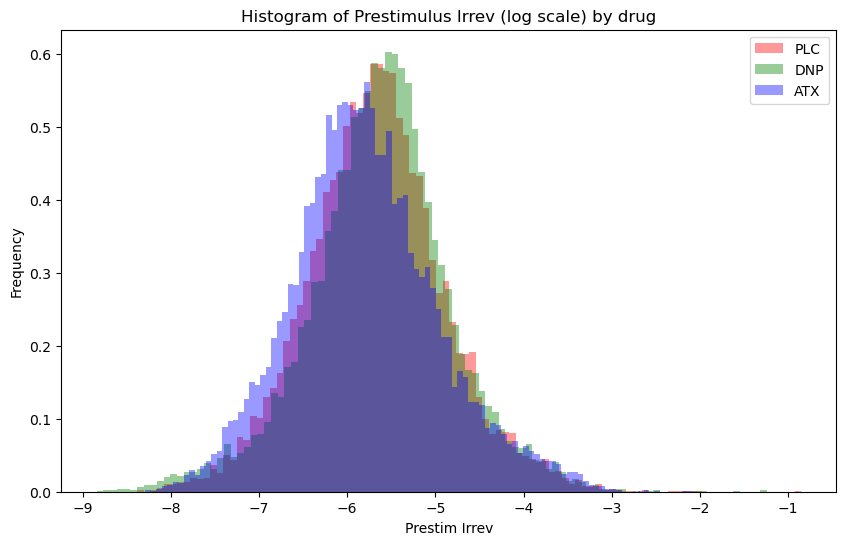

In [56]:
#prestimulus by drug
behavior = df

df_plc = behavior[behavior['drug'] == 'PLC']
df_dnp = behavior[behavior['drug'] == 'DNP']
df_atx = behavior[behavior['drug'] == 'ATX']

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

plt.hist(np.log(df_plc['prestim_irrev']), bins=100, alpha=0.4, label='PLC', color='red', density = True)
plt.hist(np.log(df_dnp['prestim_irrev']), bins=100, alpha=0.4, label='DNP', color='green', density = True)
plt.hist(np.log(df_atx['prestim_irrev']), bins=100, alpha=0.4, label='ATX', color='blue', density = True)

# Adding labels and title
plt.xlabel('Prestim Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestimulus Irrev (log scale) by drug')
plt.legend()

# Show the plot
plt.show()


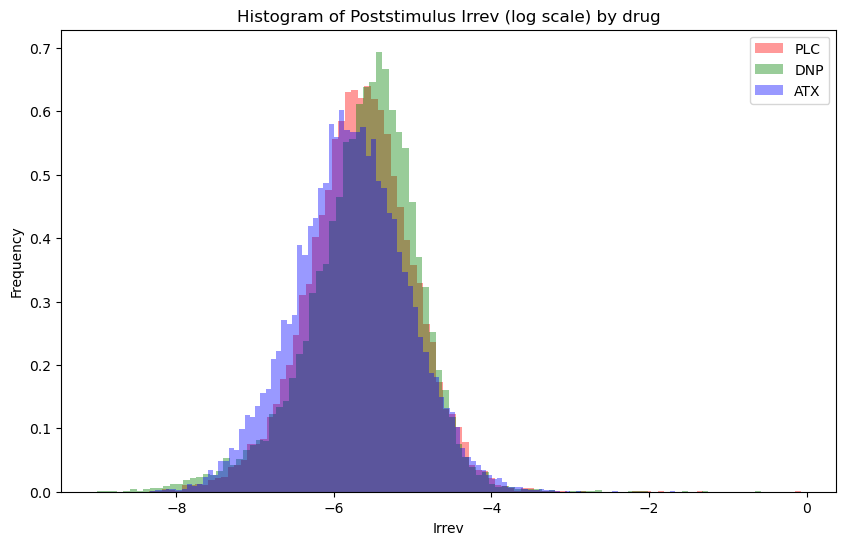

In [58]:
behavior = df

behavior.head()

df_plc = behavior[(behavior['drug'] == 'PLC')]
df_dnp = behavior[(behavior['drug'] == 'DNP')]
df_atx = behavior[(behavior['drug'] == 'ATX')]

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

plt.hist(np.log(df_plc['poststim_irrev']), bins=100, alpha=0.4, label='PLC', color='red', density = True)
plt.hist(np.log(df_dnp['poststim_irrev']), bins=100, alpha=0.4, label='DNP', color='green', density = True)
plt.hist(np.log(df_atx['poststim_irrev']), bins=100, alpha=0.4, label='ATX', color='blue', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Poststimulus Irrev (log scale) by drug')
plt.legend()

# Show the plot
plt.show()

### raw pupil histogram

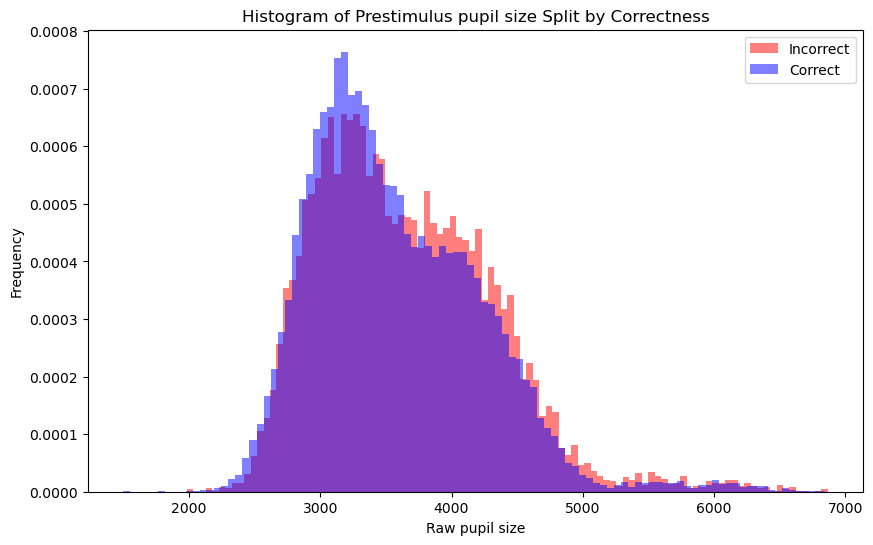

-10.863174464964764
1.8681590744934754e-27


In [59]:
#prestimulus

behavior = df

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
rt_incorrect = behavior[behavior['correct'] == 0]['bl_pupil']
plt.hist(rt_incorrect, bins=100, alpha=0.5, label='Incorrect', color='red', density = True)

# Histogram for RT when correct is 1
rt_correct = behavior[behavior['correct'] == 1]['bl_pupil']
plt.hist(rt_correct, bins=100, alpha=0.5, label='Correct', color='blue', density = True)

# Adding labels and title
plt.xlabel('Raw pupil size')
plt.ylabel('Frequency')
plt.title('Histogram of Prestimulus pupil size Split by Correctness')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.ttest_ind(rt_correct, rt_incorrect)

print(t_stat)
print(p_value)

## poststimulus

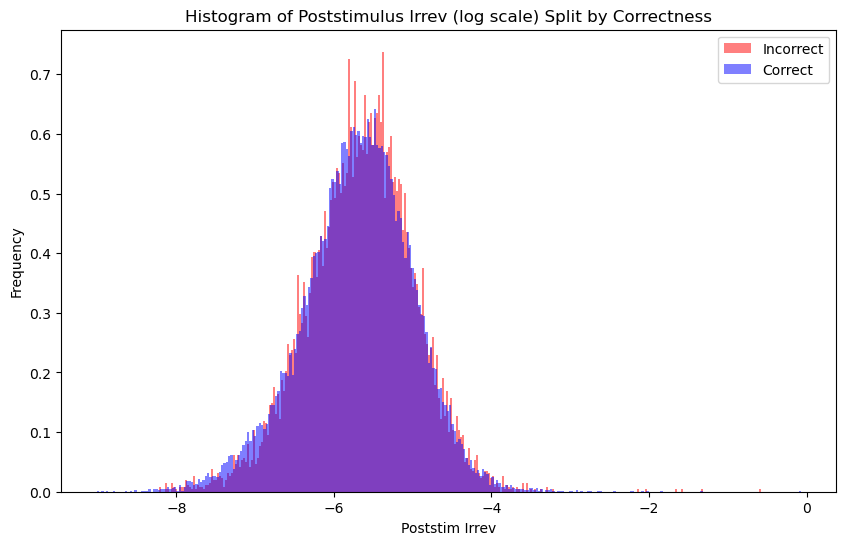

-2.243747727875166
0.024853502908886996


In [60]:


behavior = df

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
rt_incorrect = behavior[behavior['correct'] == 0]['poststim_irrev']
plt.hist(np.log(rt_incorrect), bins=300, alpha=0.5, label='Incorrect', color='red', density = True)

# Histogram for RT when correct is 1
rt_correct = behavior[behavior['correct'] == 1]['poststim_irrev']
plt.hist(np.log(rt_correct), bins=300, alpha=0.5, label='Correct', color='blue', density = True)

# Adding labels and title
plt.xlabel('Poststim Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Poststimulus Irrev (log scale) Split by Correctness')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.ttest_ind(rt_correct, rt_incorrect)

print(t_stat)
print(p_value)

### by drug

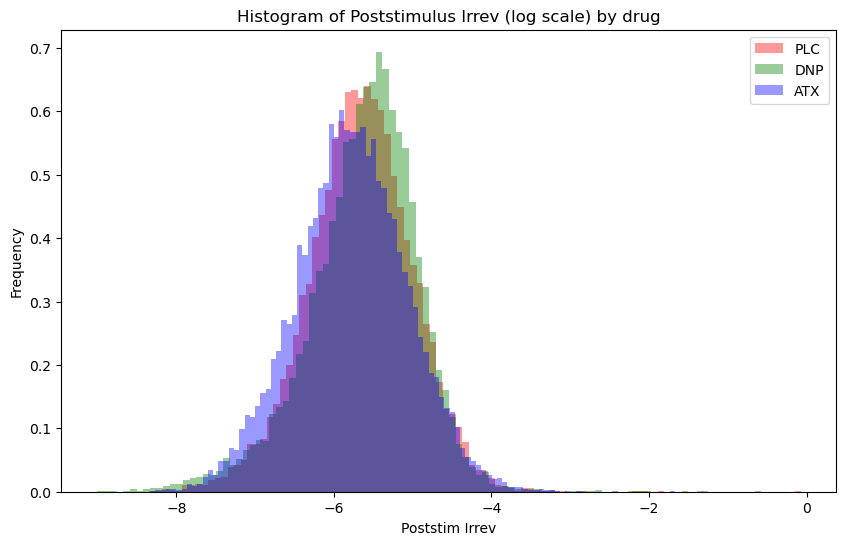

In [61]:
#prestimulus by drug
behavior = df

df_plc = behavior[(behavior['drug'] == 'PLC')]
df_dnp = behavior[(behavior['drug'] == 'DNP')]
df_atx = behavior[(behavior['drug'] == 'ATX')]

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

plt.hist(np.log(df_plc['poststim_irrev']), bins=100, alpha=0.4, label='PLC', color='red', density = True)
plt.hist(np.log(df_dnp['poststim_irrev']), bins=100, alpha=0.4, label='DNP', color='green', density = True)
plt.hist(np.log(df_atx['poststim_irrev']), bins=100, alpha=0.4, label='ATX', color='blue', density = True)

# Adding labels and title
plt.xlabel('Poststim Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Poststimulus Irrev (log scale) by drug')
plt.legend()

# Show the plot
plt.show()


## pre + post

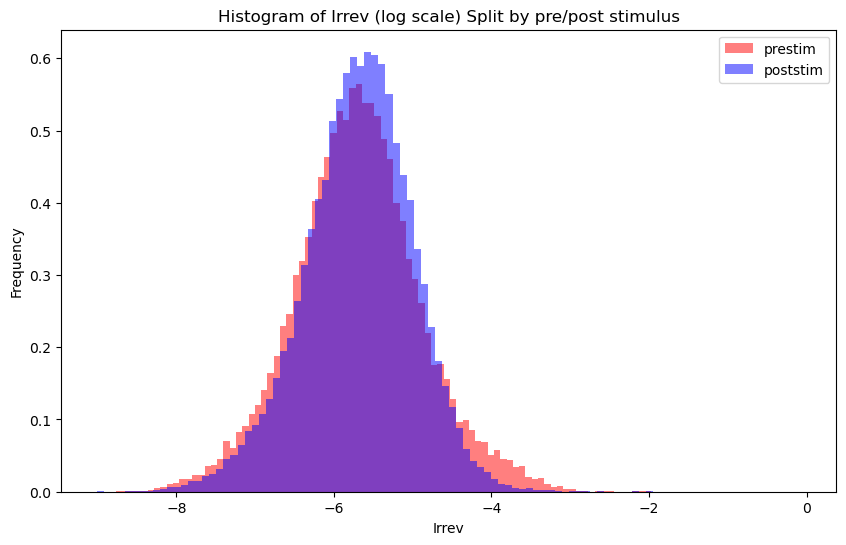

-2.372218604354637
0.017685825846638723
The std dev of the pre values in the pretty histogram (logged irrev values): 0.8071898560403837
The std dev of the post values in the pretty histogram (logged irrev values): 0.6939591345083789


In [62]:

behavior = df



# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
pre_irrev = behavior['prestim_irrev']
plt.hist(np.log(pre_irrev), bins=100, alpha=0.5, label='prestim', color='red', density = True)

# Histogram for RT when correct is 1
post_irrev = behavior['poststim_irrev']
plt.hist(np.log(post_irrev), bins=100, alpha=0.5, label='poststim', color='blue', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Irrev (log scale) Split by pre/post stimulus')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.ttest_rel(np.log(pre_irrev), np.log(post_irrev))

print(t_stat)
print(p_value)

print("The std dev of the pre values in the pretty histogram (logged irrev values): "+str(np.std(np.log(pre_irrev))))
print("The std dev of the post values in the pretty histogram (logged irrev values): "+str(np.std(np.log(post_irrev))))

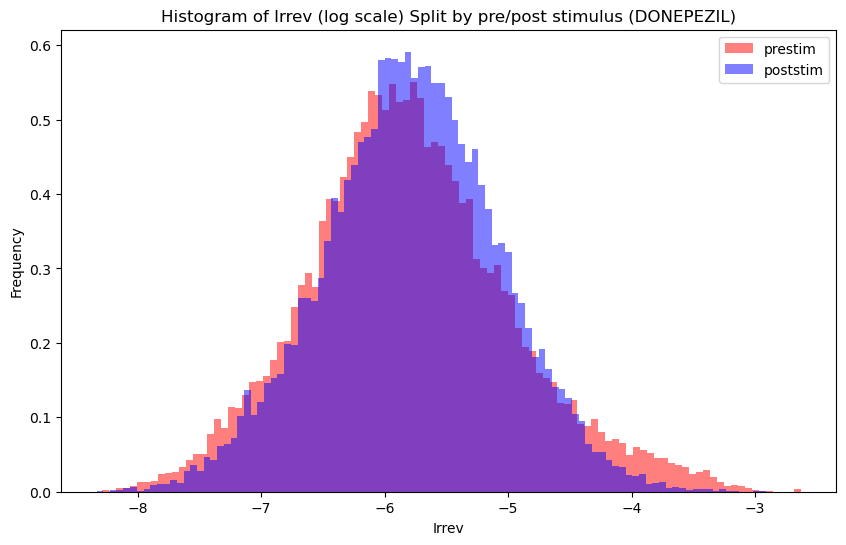

-2.9686458222274483
0.0029958311898162274
The std dev of the pre values in the pretty histogram (logged irrev values): 0.8330942280962594
The std dev of the post values in the pretty histogram (logged irrev values): 0.7105284256500772


In [63]:

behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior = behavior[behavior['drug'] == 'ATX']


# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
pre_irrev = behavior['prestim_irrev']
plt.hist(np.log(pre_irrev), bins=100, alpha=0.5, label='prestim', color='red', density = True)

# Histogram for RT when correct is 1
post_irrev = behavior['poststim_irrev']
plt.hist(np.log(post_irrev), bins=100, alpha=0.5, label='poststim', color='blue', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Irrev (log scale) Split by pre/post stimulus (DONEPEZIL)')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.ttest_rel(np.log(pre_irrev), np.log(post_irrev))

print(t_stat)
print(p_value)

print("The std dev of the pre values in the pretty histogram (logged irrev values): "+str(np.std(np.log(pre_irrev))))
print("The std dev of the post values in the pretty histogram (logged irrev values): "+str(np.std(np.log(post_irrev))))

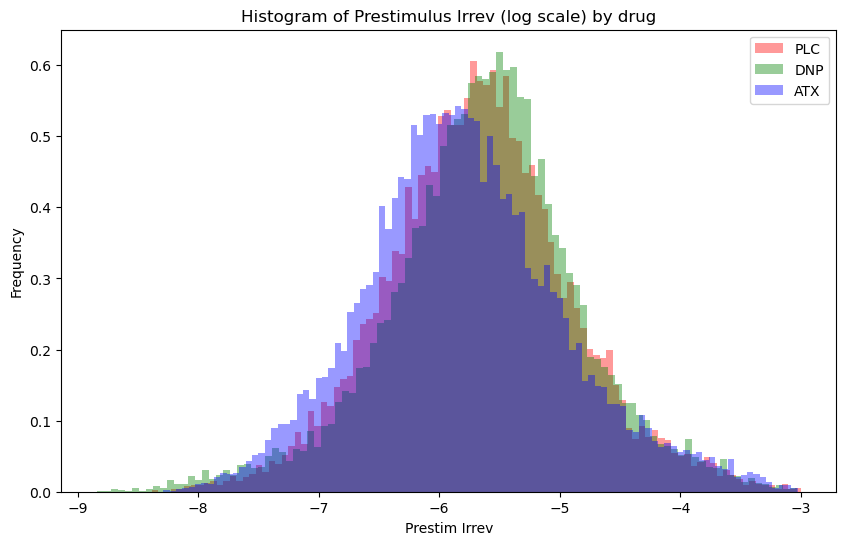

PLC - The std dev of the pre values in the pretty histogram (logged irrev values): 0.7671460307764469
DNP - The std dev of the pre values in the pretty histogram (logged irrev values): 0.7938261194384688
ATX - The std dev of the pre values in the pretty histogram (logged irrev values): 0.830575191448534


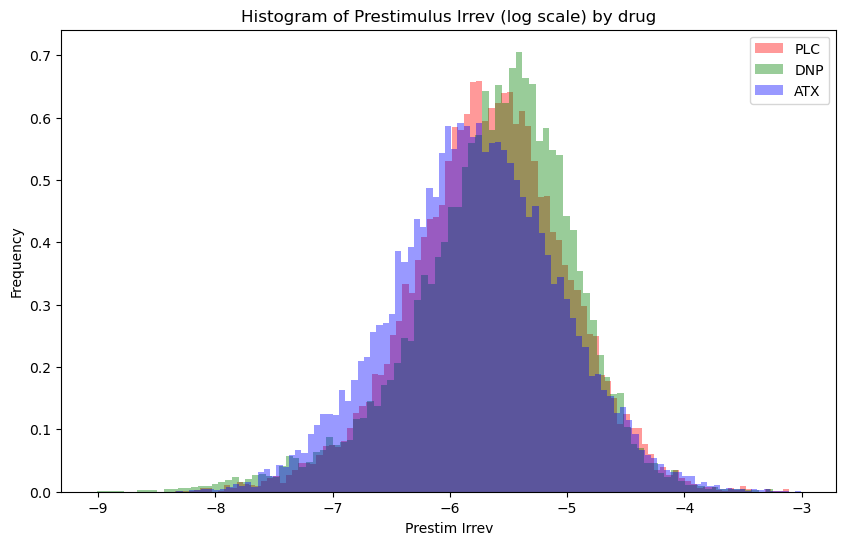

PLC - The std dev of the post values in the pretty histogram (logged irrev values): 0.6560628402088963
DNP - The std dev of the post values in the pretty histogram (logged irrev values): 0.6882623564771571
ATX - The std dev of the post values in the pretty histogram (logged irrev values): 0.7100277215211763
PLC - diff of the std devs: -0.11108319056755067
DNP - diff of the std devs: -0.10556376296131176
ATX - diff of the std devs: -0.12054746992735765


In [64]:

behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.05) & (behavior['prestim_irrev'] < 0.05)]

df_plc = behavior[behavior['drug'] == 'PLC']
df_dnp = behavior[behavior['drug'] == 'DNP']
df_atx = behavior[behavior['drug'] == 'ATX']

# Setting up the figure and axes
plt.figure(figsize=(10, 6))


plt.hist(np.log(df_plc['prestim_irrev']), bins=100, alpha=0.4, label='PLC', color='red', density = True)
plt.hist(np.log(df_dnp['prestim_irrev']), bins=100, alpha=0.4, label='DNP', color='green', density = True)
plt.hist(np.log(df_atx['prestim_irrev']), bins=100, alpha=0.4, label='ATX', color='blue', density = True)

# Adding labels and title
plt.xlabel('Prestim Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestimulus Irrev (log scale) by drug')
plt.legend()

plt.show()

plc_pre = np.std(np.log(df_plc['prestim_irrev']))
dnp_pre = np.std(np.log(df_dnp['prestim_irrev']))
atx_pre = np.std(np.log(df_atx['prestim_irrev']))

print("PLC - The std dev of the pre values in the pretty histogram (logged irrev values): " + str(
    plc_pre))
print("DNP - The std dev of the pre values in the pretty histogram (logged irrev values): " + str(
    dnp_pre))
print("ATX - The std dev of the pre values in the pretty histogram (logged irrev values): " + str(
    atx_pre))

#############POST###################

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

plt.hist(np.log(df_plc['poststim_irrev']), bins=100, alpha=0.4, label='PLC', color='red', density = True)
plt.hist(np.log(df_dnp['poststim_irrev']), bins=100, alpha=0.4, label='DNP', color='green', density = True)
plt.hist(np.log(df_atx['poststim_irrev']), bins=100, alpha=0.4, label='ATX', color='blue', density = True)

# Adding labels and title
plt.xlabel('Prestim Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestimulus Irrev (log scale) by drug')
plt.legend()

# Show the plot
plt.show()
plc_post = np.std(np.log(df_plc['poststim_irrev']))
dnp_post = np.std(np.log(df_dnp['poststim_irrev']))
atx_post = np.std(np.log(df_atx['poststim_irrev']))


print("PLC - The std dev of the post values in the pretty histogram (logged irrev values): " + str(
    plc_post))
print("DNP - The std dev of the post values in the pretty histogram (logged irrev values): " + str(
    dnp_post))
print("ATX - The std dev of the post values in the pretty histogram (logged irrev values): " + str(
    atx_post))


print("PLC - diff of the std devs: " + str(plc_post-plc_pre))
print("DNP - diff of the std devs: " + str(dnp_post-dnp_pre))
print("ATX - diff of the std devs: " + str(atx_post-atx_pre))





Text(0.5, 1.0, 'Histogram of Irrev (Logged data)')

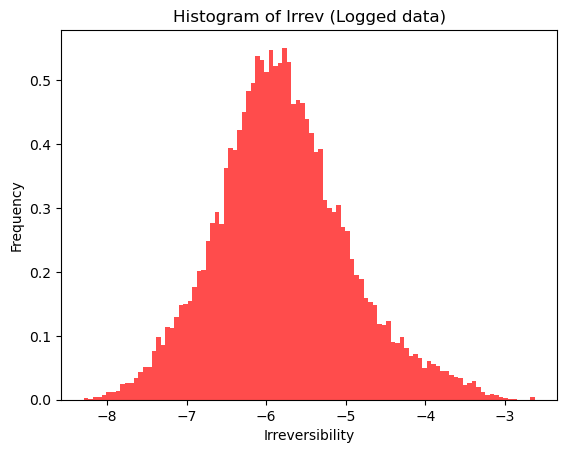

In [65]:
plt.hist(np.log(pre_irrev), bins=100, alpha=0.7, label='prestimus', color='red', density = True)
plt.xlabel('Irreversibility')
plt.ylabel('Frequency')
plt.title('Histogram of Irrev (Logged data)')

T-statistic (logged): 2.372218604354637
P-value (logged): 0.017685825846638723
not logged: 
T-statistic: 12.71052182389054
P-value: 5.988139118533451e-37


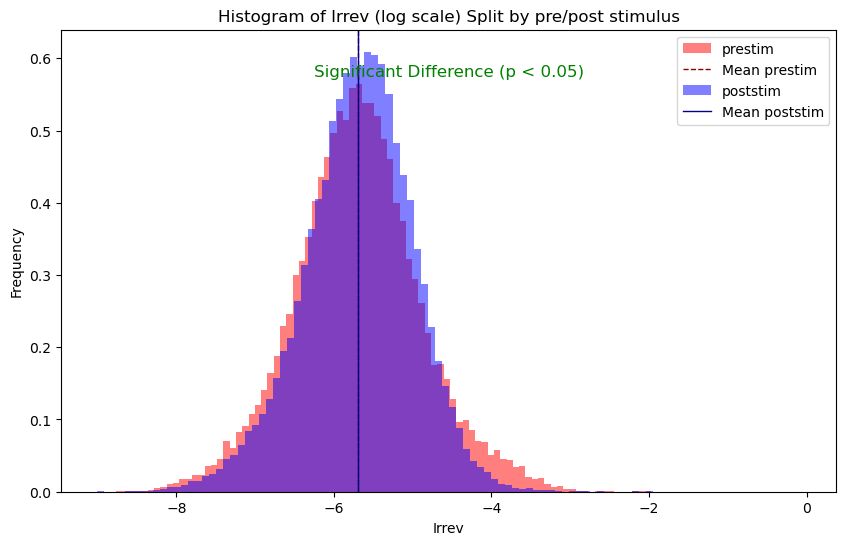

In [66]:
behavior = df
# Calculate means
mean_prestim = behavior['log_prestim'].mean()
mean_poststim = behavior['log_poststim'].mean()

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
plt.hist(behavior['log_prestim'], bins=100, alpha=0.5, label='prestim', color='red', density=True)
plt.axvline(mean_prestim, color='darkred', linestyle='dashed', linewidth=1, label='Mean prestim')

# Histogram for RT when correct is 1
plt.hist(behavior['log_poststim'], bins=100, alpha=0.5, label='poststim', color='blue', density=True)
plt.axvline(mean_poststim, color='darkblue', linestyle='solid', linewidth=1, label='Mean poststim')

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Irrev (log scale) Split by pre/post stimulus')
plt.legend()

# Conduct t-test on the logged data
t_stat, p_value = stats.ttest_rel(behavior['log_poststim'], behavior['log_prestim'])

# Show t-test results
print(f"T-statistic (logged): {t_stat}")
print(f"P-value (logged): {p_value}")

if p_value < 0.05:
    plt.annotate('Significant Difference (p < 0.05)', xy=(0.5, 0.9), xycoords='axes fraction', fontsize=12, ha='center', color='green')
else:
    plt.annotate('not significant', xy=(0.2, 0.9), xycoords='axes fraction', fontsize=12, ha='center', color='green')
# Conduct t-test on the logged data
t_stat, p_value = stats.ttest_rel(behavior['prestim_irrev'], behavior['poststim_irrev'])

# Show t-test results
print("not logged: ")
print(f"T-statistic: {t_stat}")
print(f"P-value: {p_value}")

# Show the plot
plt.show()

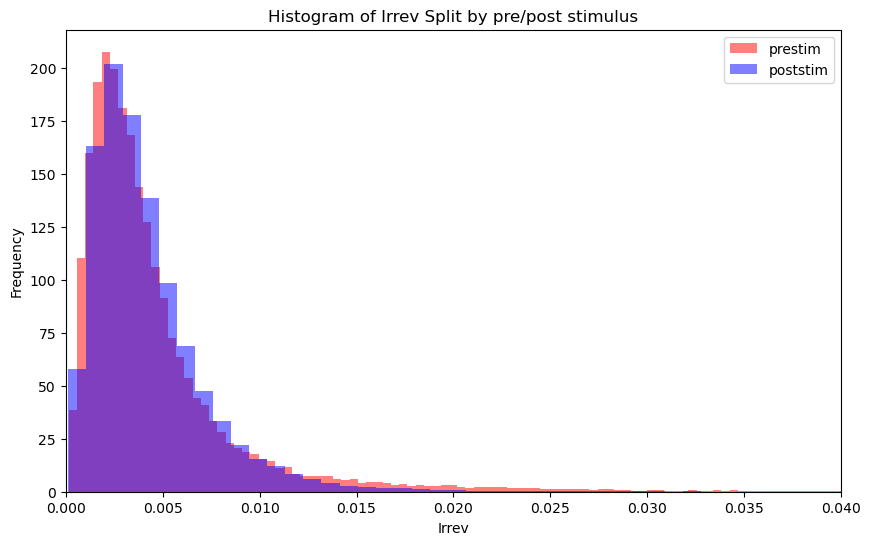

-12.71052182389054
5.988139118533451e-37


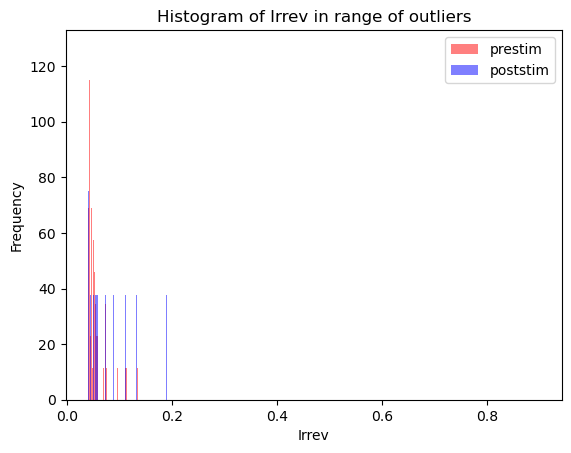

In [67]:
#same but not log scale
behavior = df

# Setting up the figure and axes
plt.figure(figsize=(10, 6))


rt_incorrect = behavior['prestim_irrev']
plt.hist(rt_incorrect, bins=1000, alpha=0.5, label='prestim', color='red', density = True)


rt_correct = behavior['poststim_irrev']
plt.hist(rt_correct, bins=1000, alpha=0.5, label='poststim', color='blue', density = True)
plt.xlim([0, 0.04])

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Irrev Split by pre/post stimulus')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.ttest_rel(rt_correct, rt_incorrect)

print(t_stat)
print(p_value)

rt_incorrect = behavior['prestim_irrev']
plt.hist(rt_incorrect, bins=1000, alpha=0.5, label='prestim', color='red', density = True,  range=(0.04, 0.9))

rt_correct = behavior['poststim_irrev']
plt.hist(rt_correct, bins=1000, alpha=0.5, label='poststim', color='blue', density = True, range=(0.04, 0.9))

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Irrev in range of outliers')
plt.legend()

# Show the plot
plt.show()

Text(0.5, 1.0, 'Histogram of Irrev (Raw Data)')

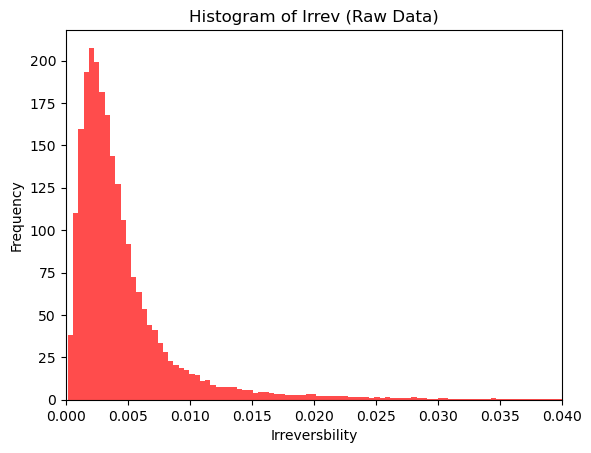

In [68]:
rt_correct = behavior['prestim_irrev']
plt.hist(rt_correct, bins=1000, alpha=0.7, label='poststim', color='red', density = True)
plt.xlim([0, 0.04])
plt.xlabel('Irreversbility')
plt.ylabel('Frequency')
plt.title('Histogram of Irrev (Raw Data)')


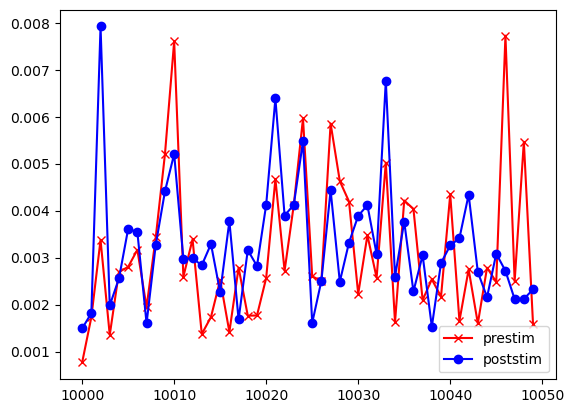

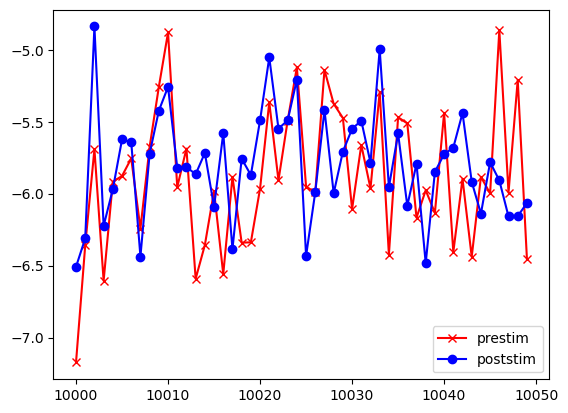

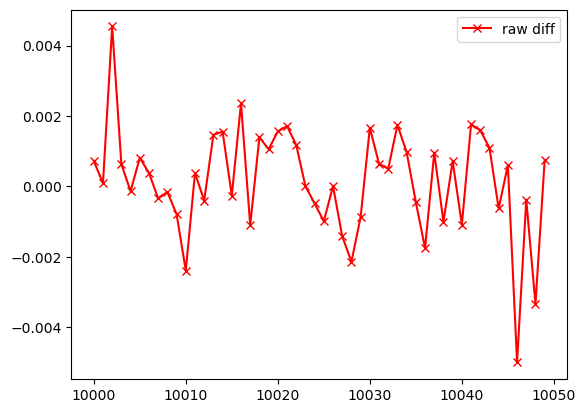

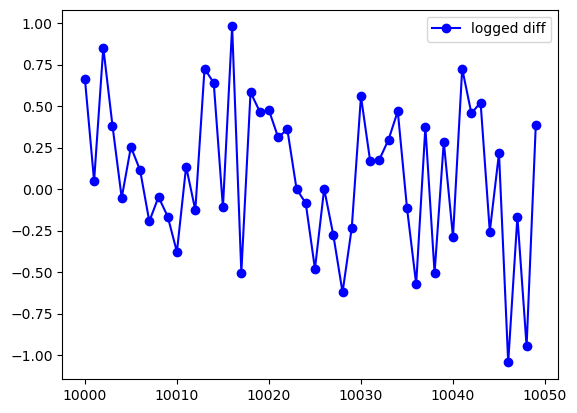

In [70]:
plt.plot(behavior['prestim_irrev'][10000:10050], label='prestim', marker='x', color = 'red')
plt.plot(behavior['poststim_irrev'][10000:10050], label='poststim', marker='o', color = 'blue')
plt.legend()
plt.show()

plt.plot(behavior['log_prestim'][10000:10050], label='prestim', marker='x', color = 'red')
plt.plot(behavior['log_poststim'][10000:10050], label='poststim', marker='o', color = 'blue')
plt.legend()
plt.show()


plt.plot(behavior['stim_diff'][10000:10050], label='raw diff', marker='x', color = 'red')
plt.legend()
plt.show()

plt.plot((behavior['log_poststim'][10000:10050]-behavior['log_prestim'][10000:10050]), label='logged diff', marker='o', color = 'blue')
plt.legend()
plt.show()



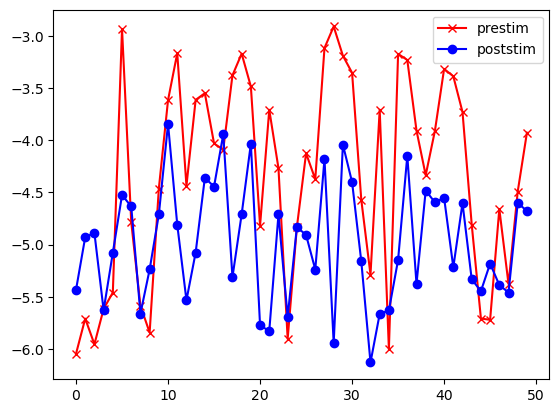

In [71]:
plt.plot(behavior['log_prestim'][0:50], label='prestim', marker='x', color = 'red')
plt.plot(behavior['log_poststim'][0:50], label='poststim', marker='o', color = 'blue')
plt.legend()
plt.show()

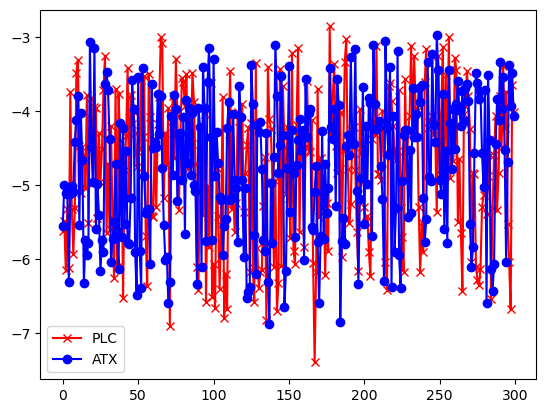

mean of plc (red): -4.754640634911913
mean of atx (blue): -4.7449762335762165


,index,Unnamed: 0,subject,drug,session,block,miniblock,trial_nr,cue,location,...,prestim_heirarchy,poststim_heirarchy,irreversibility,log_irreversibility,irreversibility_bin,poststimulus_irreversibility,log_bin,left_cue_irrev,contributions,right_cue_irrev
0,616,616,1,ATX,2,0,0,0,0,1,...,0.010951,0.006631,0.003873,-5.553665,1,0.003188,1,0.008570,"[0.005333083954941115, 0.0033494821995960107, ...",0.006180
1,617,617,1,ATX,2,0,0,2,1,0,...,0.023453,0.016205,0.006692,-5.006913,3,0.005675,3,0.010135,"[0.002402354350727799, 0.0016715784300059156, ...",0.005070
2,618,618,1,ATX,2,0,0,3,1,1,...,0.016879,0.013355,0.006000,-5.115923,3,0.005389,3,0.011970,"[0.006170272210206988, 0.003851157950486679, 0...",0.009746
3,619,619,1,ATX,2,0,0,4,1,1,...,0.016049,0.013286,0.005995,-5.116787,3,0.005584,3,0.012350,"[0.010268747860346022, 0.025316803893803513, 0...",0.003715
4,620,620,1,ATX,2,0,0,5,0,0,...,0.004545,0.012424,0.001811,-6.314039,3,0.005786,3,0.006932,"[0.0052577762977618885, 0.014270809505268232, ...",0.016948


In [72]:
behavior1 = behavior[(behavior['subject'] ==1) & (behavior['drug'] == 'PLC')][0:300].reset_index()
behavior2 = behavior[(behavior['subject'] ==1) & (behavior['drug'] == 'ATX')][0:300].reset_index()

plt.plot(behavior1['log_prestim'], label='PLC', marker='x', color = 'red')
plt.plot(behavior2['log_prestim'], label='ATX', marker='o', color = 'blue')
plt.legend()
plt.show()
print("mean of plc (red): " + str(np.mean(behavior1['log_prestim'])))
print("mean of atx (blue): " + str(np.mean(behavior2['log_prestim'])))

behavior1.head()
behavior2.head()

## diff histograms

c:\Users\Jake\anaconda3\envs\recoveredenv\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


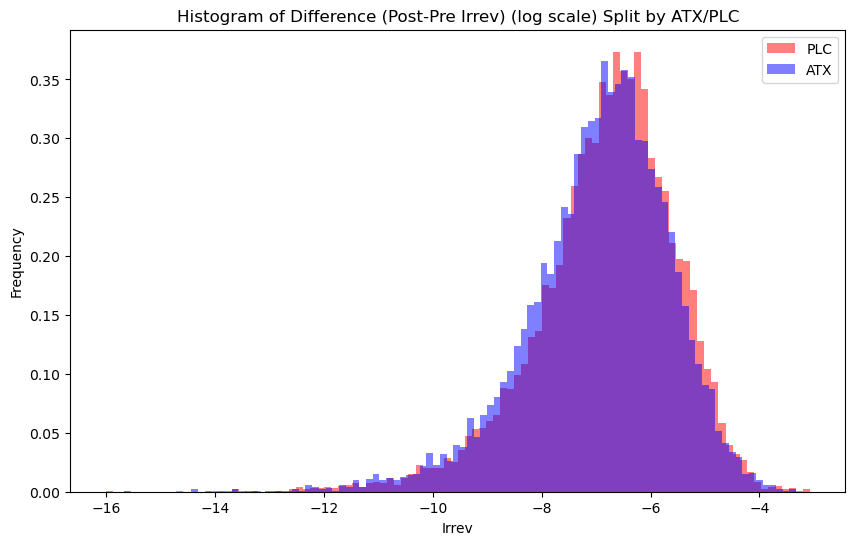

-12.71052182389054
5.988139118533451e-37


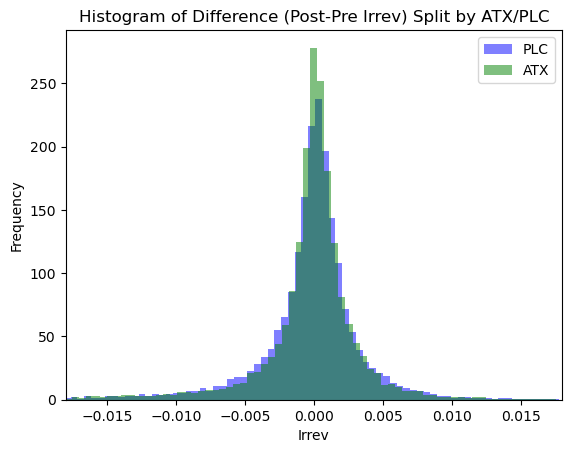

mean of diff (post-pre) in plc: -0.00042011851071370346
mean of diff (post-pre) in atx: -0.00047620410621906163
median of diff (post-pre) in plc: 0.0001050210959663468
median of diff (post-pre) in atx: 0.00013147807587559604
The std dev of the PLC DIFFERENCE (post-pre) values in the pretty histogram: 1.295115306971989
The std dev of the ATX DIFFERENCE (post-pre) values in the pretty histogram: 1.3151337780666033


In [73]:

behavior = df

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
diff_plc = behavior[behavior['drug'] == 'PLC']['stim_diff']
plt.hist(np.log(diff_plc), bins=100, alpha=0.5, label='PLC', color='red', density = True)

# Histogram for RT when correct is 1
diff_atx = behavior[behavior['drug'] == 'ATX']['stim_diff']
plt.hist(np.log(diff_atx), bins=100, alpha=0.5, label='ATX', color='blue', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Difference (Post-Pre Irrev) (log scale) Split by ATX/PLC')
plt.legend()

# Show the plot
plt.show()

print(t_stat)
print(p_value)

x1 = diff_plc
x2 = diff_atx

plt.hist(x1, bins=200, alpha=0.5, label='PLC', color='blue', density = True)
plt.hist(x2, bins=200, alpha=0.5, label='ATX', color='green', density = True)
plt.xlim(-0.018,0.018)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Difference (Post-Pre Irrev) Split by ATX/PLC')
plt.legend()

plt.show()

print("mean of diff (post-pre) in plc: " + str(np.mean(diff_plc)))
print("mean of diff (post-pre) in atx: " + str(np.mean(diff_atx)))
print("median of diff (post-pre) in plc: " + str(np.median(diff_plc)))
print("median of diff (post-pre) in atx: " + str(np.median(diff_atx)))

print("The std dev of the PLC DIFFERENCE (post-pre) values in the pretty histogram: "+str(np.std(np.log(diff_plc))))
print("The std dev of the ATX DIFFERENCE (post-pre) values in the pretty histogram: "+str(np.std(np.log(diff_atx))))

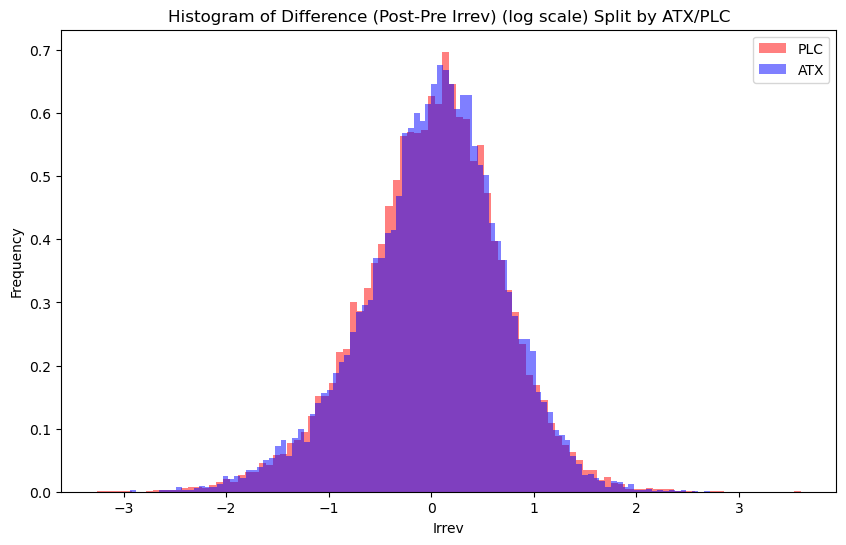

109553594.0
0.03828388871542211
-1.468604013774261
0.14195077587223343
mean of diff (post-pre) in plc: 0.004628996053824992
mean of diff (post-pre) in atx: 0.016107676603531376
median of diff (post-pre) in plc: 0.04110001190624457
median of diff (post-pre) in atx: 0.05946730178255866
The std dev of the PLC DIFFERENCE (post-pre) values in the pretty histogram: 1.0945408279204571
The std dev of the ATX DIFFERENCE (post-pre) values in the pretty histogram: 1.0988142757878305


In [74]:

behavior = df

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
diff_plc = (behavior[behavior['drug'] == 'PLC']['log_poststim']-behavior[behavior['drug'] == 'PLC']['log_prestim'])
plt.hist(diff_plc, bins=100, alpha=0.5, label='PLC', color='red', density = True)

# Histogram for RT when correct is 1
diff_atx = (behavior[behavior['drug'] == 'ATX']['log_poststim']-behavior[behavior['drug'] == 'ATX']['log_prestim'])
plt.hist(diff_atx, bins=100, alpha=0.5, label='ATX', color='blue', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Difference (Post-Pre Irrev) (log scale) Split by ATX/PLC')
plt.legend()

# Show the plot
plt.show()


from scipy import stats


t_stat, p_value = mannwhitneyu(diff_plc, diff_atx)

print(t_stat)
print(p_value)

t_stat, p_value = stats.ttest_ind(diff_plc, diff_atx)

print(t_stat)
print(p_value)


print("mean of diff (post-pre) in plc: " + str(np.mean(diff_plc)))
print("mean of diff (post-pre) in atx: " + str(np.mean(diff_atx)))
print("median of diff (post-pre) in plc: " + str(np.median(diff_plc)))
print("median of diff (post-pre) in atx: " + str(np.median(diff_atx)))

print("The std dev of the PLC DIFFERENCE (post-pre) values in the pretty histogram: "+str(np.std(np.log(diff_plc))))
print("The std dev of the ATX DIFFERENCE (post-pre) values in the pretty histogram: "+str(np.std(np.log(diff_atx))))

# Outliers

Max prestim irrev: 0.42660806107681926
Max prestim trial: 8566
Max poststim irrev: 0.933621986124411
Max poststim trial: 8681


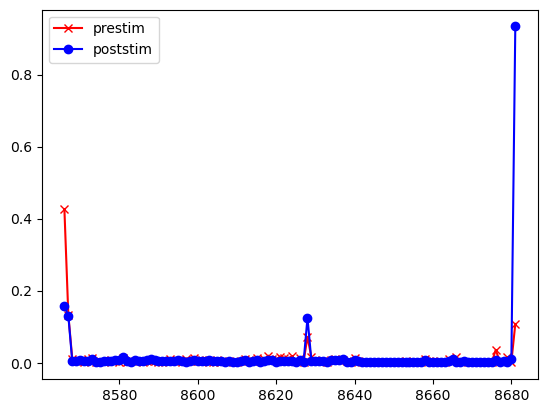

In [75]:
behavior = df

#max prestim and max poststim
print("Max prestim irrev: " + str(max(behavior['prestim_irrev'])))
print("Max prestim trial: " + str(behavior['prestim_irrev'].idxmax()))
print("Max poststim irrev: " + str(max(behavior['poststim_irrev'])))
print("Max poststim trial: " + str(behavior['poststim_irrev'].idxmax()))

plt.plot(behavior['prestim_irrev'][8566:8682], label='prestim', marker='x', color = 'red')
plt.plot(behavior['poststim_irrev'][8566:8682], label='poststim', marker='o', color = 'blue')
plt.legend()
plt.show()

In [76]:
print(behavior.index[behavior['prestim_irrev'] > 0.2])
print(behavior.index[behavior['poststim_irrev'] > 0.2])

Int64Index([8566, 9144, 9152, 9206], dtype='int64')
Int64Index([8412, 8681, 9180, 9198, 9212], dtype='int64')


In [77]:
print(behavior.index[(behavior['prestim_irrev'] > 0.1) & (behavior['prestim_irrev'] < 0.2)])
print(behavior.index[(behavior['poststim_irrev'] > 0.1) & (behavior['poststim_irrev'] < 0.2)])

Int64Index([5662, 8412, 8567, 8681, 9048, 9119, 22938, 27566], dtype='int64')
Int64Index([8411, 8566, 8567, 8628, 9206, 9211, 22945, 29541], dtype='int64')


In [78]:
print(behavior.index[(behavior['prestim_irrev'] > 0.05) & (behavior['prestim_irrev'] < 0.1)])
print(behavior.index[(behavior['poststim_irrev'] > 0.05) & (behavior['poststim_irrev'] < 0.1)])

Int64Index([    5,    28,    64,   215,   408,   552,   864,   935,   962,
             5174,  8411,  8432,  8500,  8628,  9211,  9212,  9248, 10541,
            10559, 10794, 18162, 18701, 18733, 18739, 22945, 22946, 23356,
            27843, 27952, 28042, 29499, 29877],
           dtype='int64')
Int64Index([4702, 4730, 4910, 9048, 9119, 9143, 9199, 9238, 18733, 22938,
            25903, 29271],
           dtype='int64')


In [79]:
print(behavior.index[(behavior['prestim_irrev'] > 0.08) & (behavior['prestim_irrev'] < 0.1)])
print(behavior.index[(behavior['poststim_irrev'] > 0.08) & (behavior['poststim_irrev'] < 0.1)])

Int64Index([5174, 8500, 9248, 10559], dtype='int64')
Int64Index([22938], dtype='int64')


#### % removed

In [80]:
behavior = df

size1 = len(behavior)
#Takes out outliers
behavior = behavior[(behavior['poststim_irrev'] < 0.02) & (behavior['prestim_irrev'] < 0.02)]
print("Percent of data removed: {:.2f}%".format(((size1 - len(behavior)) / size1) * 100))

Percent of data removed: 2.49%


In [81]:
behavior = df
behavior = behavior[behavior['drug']=='PLC']
size1 = len(behavior)
#Takes out outliers
behavior = behavior[(behavior['poststim_irrev'] < 0.02) & (behavior['prestim_irrev'] < 0.02)]
print("Percent of data removed: {:.2f}%".format(((size1 - len(behavior)) / size1) * 100))

behavior = df
behavior = behavior[behavior['drug']=='ATX']
size1 = len(behavior)
#Takes out outliers
behavior = behavior[(behavior['poststim_irrev'] < 0.02) & (behavior['prestim_irrev'] < 0.02)]
print("Percent of data removed: {:.2f}%".format(((size1 - len(behavior)) / size1) * 100))

Percent of data removed: 2.18%
Percent of data removed: 2.88%


#### 3 scaled median absolute deviations from the median

In [82]:
behavior = df
#behavior = behavior[(behavior['drug'] == drug)]

size1 = len(behavior)
#Takes out outliers

def remove_outliers_mad(behavior, column_name, threshold=3):
    """
    Remove outliers from a dataframe column using Median Absolute Deviation (MAD).
    
    Parameters:
    df (pandas.DataFrame): The input dataframe.
    column_name (str): The name of the column from which to remove outliers.
    threshold (float): The number of MADs from the median to use as a cutoff (default is 3).
    
    Returns:
    pandas.DataFrame: The dataframe with outliers removed.
    """
    # Compute the median and MAD
    df = behavior

    median = df[column_name].median()
    mad = np.median(np.abs(df[column_name] - median))
    
    # Compute the scaled MAD
    scaled_mad = 1.4826 * mad  # The scaling factor for MAD to make it consistent with standard deviation
    
    # Identify outliers
    outliers = np.abs(df[column_name] - median) > threshold * scaled_mad
    
    # Remove outliers
    df_cleaned = df[~outliers]
    
    return df_cleaned

# Example usage
# Create a sample dataframe

# Remove outliers from the 'values' column
#behavior = remove_outliers_mad(behavior, 'poststimulus_irreversibility')
behavior = remove_outliers_mad(behavior, 'prestim_irrev')
print("Percent of data removed: {:.2f}%".format(((size1 - len(behavior)) / size1) * 100))

Percent of data removed: 8.22%


#### testing major shit here

Statistic: 20.568012113710434, P-value: 1.440357170470232e-93
mean of prestim: 0.004692729398623327
mean of poststim: 0.004240376647943448
median of prestim: 0.003329100261862691
median of poststim: 0.0034808161111430955


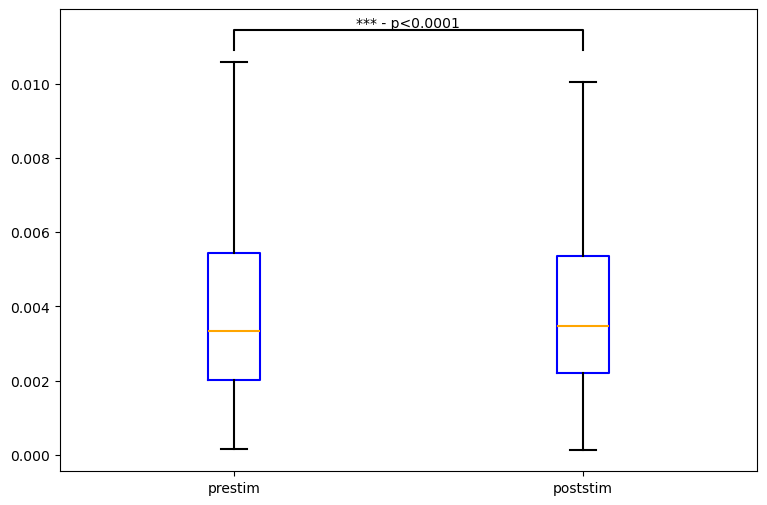

In [83]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

behavior = df
#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
behavior = behavior[(behavior['prestim_irrev']<0.08)&(behavior['poststim_irrev']<0.08)]
pre = behavior['prestim_irrev']
post = behavior['poststim_irrev']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['prestim', 'poststim'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = stats.ttest_rel(pre, post)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of prestim: " + str(np.mean(pre)))
print("mean of poststim: " + str(np.mean(post)))
print("median of prestim: " + str(np.median(pre)))
print("median of poststim: " + str(np.median(post)))

plt.show()

#Well shit. Expected post stim to be higher :O

#### difference histogram

(array([  3.17892825,   4.99545867,   4.54132607,   4.54132607,
          8.17438692,   5.44959128,   3.17892825,   7.72025431,
          8.17438692,   5.44959128,   7.26612171,   5.90372389,
          9.08265213,   6.8119891 ,   4.54132607,   5.90372389,
          9.08265213,   4.99545867,   6.8119891 ,   6.8119891 ,
          4.54132607,   3.63306085,   4.99545867,   7.26612171,
          8.62851953,   8.62851953,   8.62851953,   8.17438692,
          9.99091735,   8.62851953,   6.8119891 ,   9.99091735,
          9.99091735,   4.99545867,   7.72025431,   5.90372389,
          4.54132607,   7.72025431,   9.08265213,   8.17438692,
          9.53678474,   9.08265213,   6.35785649,   7.72025431,
         10.44504995,  12.26158038,   8.62851953,  11.35331517,
          9.08265213,  12.71571299,   6.8119891 ,  10.89918256,
         11.80744777,  12.26158038,   9.08265213,  12.26158038,
          9.99091735,  12.71571299,  11.35331517,  12.71571299,
         15.89464124,  16.34877384,  16.

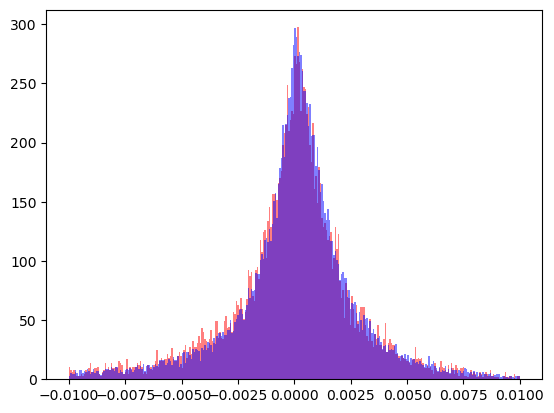

In [85]:
rt_incorrect = behavior[behavior['correct'] == 0]['stim_diff']
plt.hist(rt_incorrect, bins=300, alpha=0.5, label='Incorrect', color='red', density = True, range=(-0.01, 0.01))

# Histogram for RT when correct is 1
rt_correct = behavior[behavior['correct'] == 1]['stim_diff']
plt.hist(rt_correct, bins=300, alpha=0.5, label='Correct', color='blue', density = True, range=(-0.01, 0.01))

# Scatterplot

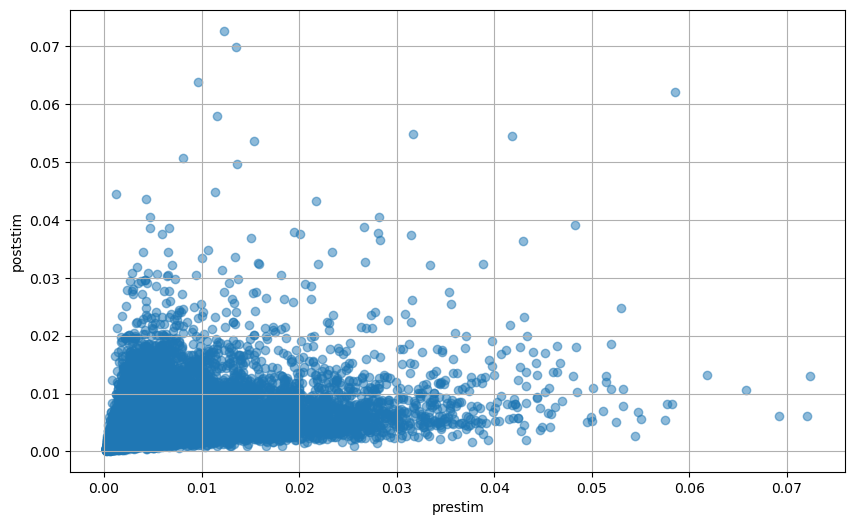

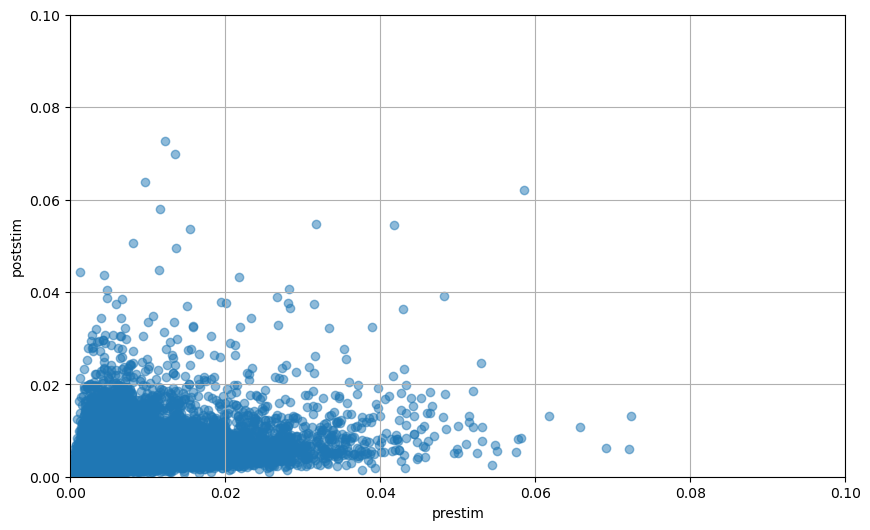

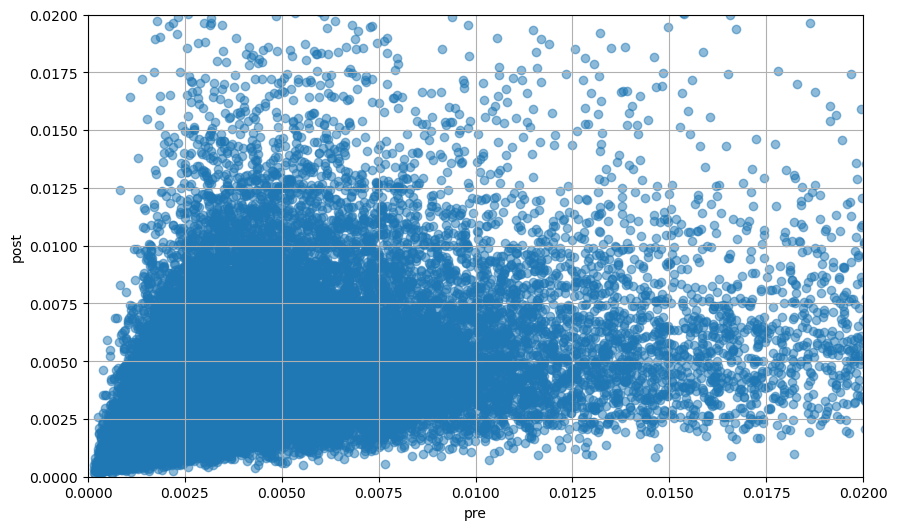

In [86]:
plt.figure(figsize=(10, 6))
plt.scatter(behavior['prestim_irrev'], behavior['poststim_irrev'], alpha=0.5)

plt.xlabel('prestim')
plt.ylabel('poststim')
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(behavior['prestim_irrev'], behavior['poststim_irrev'], alpha=0.5)
plt.xlabel('prestim')
plt.ylabel('poststim')
plt.xlim(0, 0.1)  # Focus x-axis from 20 to 80
plt.ylim(0, 0.1)
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(behavior['prestim_irrev'], behavior['poststim_irrev'], alpha=0.5)
plt.xlabel('pre')
plt.ylabel('post')
plt.xlim(0, 0.02)  # Focus x-axis from 20 to 80
plt.ylim(0, 0.02)
plt.grid(True)
plt.show()

## beautiful one

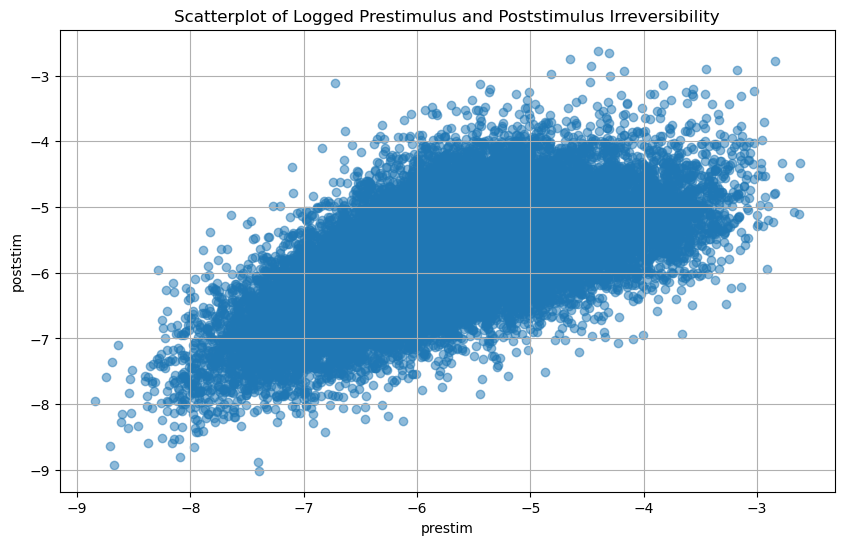

In [87]:

plt.figure(figsize=(10, 6))
plt.scatter(behavior['log_prestim'], behavior['log_poststim'], alpha=0.5)

plt.xlabel('prestim')
plt.ylabel('poststim')
plt.title('Scatterplot of Logged Prestimulus and Poststimulus Irreversibility')
plt.grid(True)
plt.show()
# we can do a 

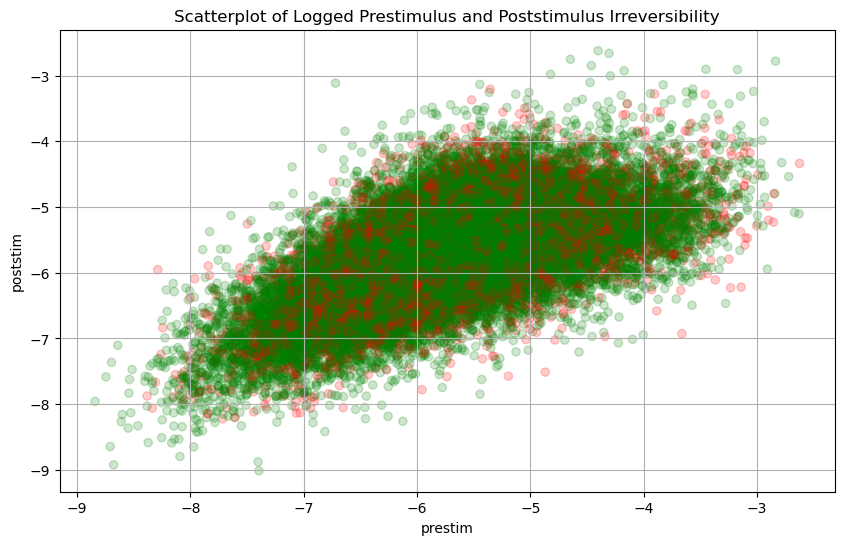

In [88]:
import matplotlib.pyplot as plt

# Ensure the 'correct' column is included in the 'behavior' DataFrame
# 'log_prestim' and 'log_poststim' are the logged values of prestimulus and poststimulus irreversibility

# Define colors based on the 'correct' column
colors = np.where(behavior['correct'] == 1, 'green', 'red')

# Create scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(behavior['log_prestim'], behavior['log_poststim'], c=colors, alpha=0.2)

plt.xlabel('prestim')
plt.ylabel('poststim')
plt.title('Scatterplot of Logged Prestimulus and Poststimulus Irreversibility')
plt.grid(True)
plt.show()


within subj

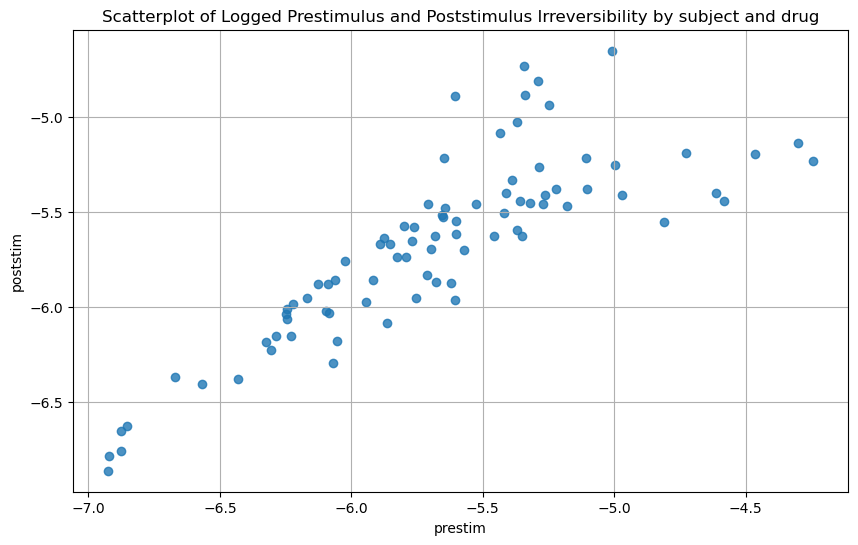

In [89]:


df1 = behavior.groupby(['subject','drug'])['log_prestim'].mean()
df2 = behavior.groupby(['subject','drug'])['log_poststim'].mean()

plt.figure(figsize=(10, 6))
plt.scatter(df1, df2, alpha=0.8)

plt.xlabel('prestim')
plt.ylabel('poststim')
plt.title('Scatterplot of Logged Prestimulus and Poststimulus Irreversibility by subject and drug')
plt.grid(True)
plt.show()

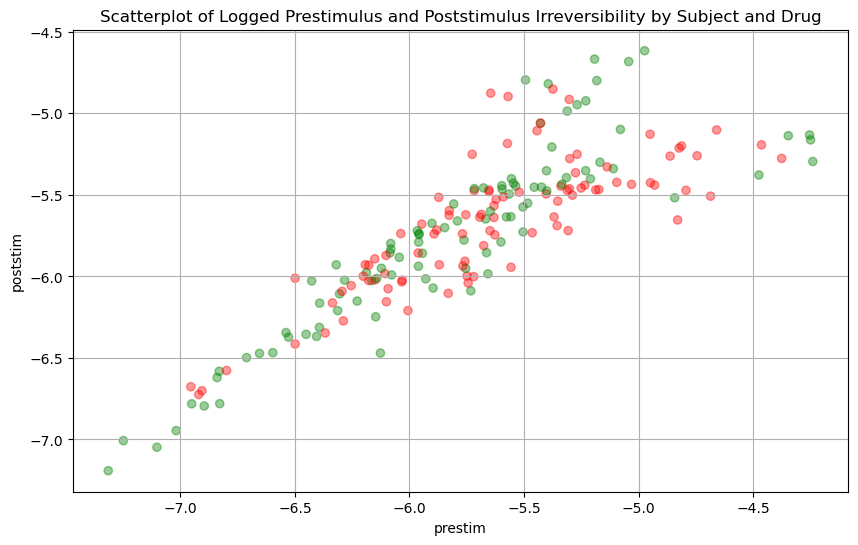

In [90]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming 'behavior' DataFrame includes the columns: 'subject', 'drug', 'log_prestim', 'log_poststim', 'correct'

# Calculate the mean prestim and poststim values by subject and drug
df1 = behavior.groupby(['subject', 'drug','session','block'])['log_prestim'].mean()
df2 = behavior.groupby(['subject', 'drug','session','block'])['log_poststim'].mean()

# Calculate the mean correctness by subject and drug
correctness = behavior.groupby(['subject', 'drug','session','block'])['correct'].mean()

# Calculate the median correctness
median_correctness = correctness.median()

# Assign colors based on whether correctness is above or below the median
colors = np.where(correctness > median_correctness, 'green', 'red')

# Create scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(df1, df2, c=colors, alpha=0.4)

plt.xlabel('prestim')
plt.ylabel('poststim')
plt.title('Scatterplot of Logged Prestimulus and Poststimulus Irreversibility by Subject and Drug')
plt.grid(True)
plt.show()


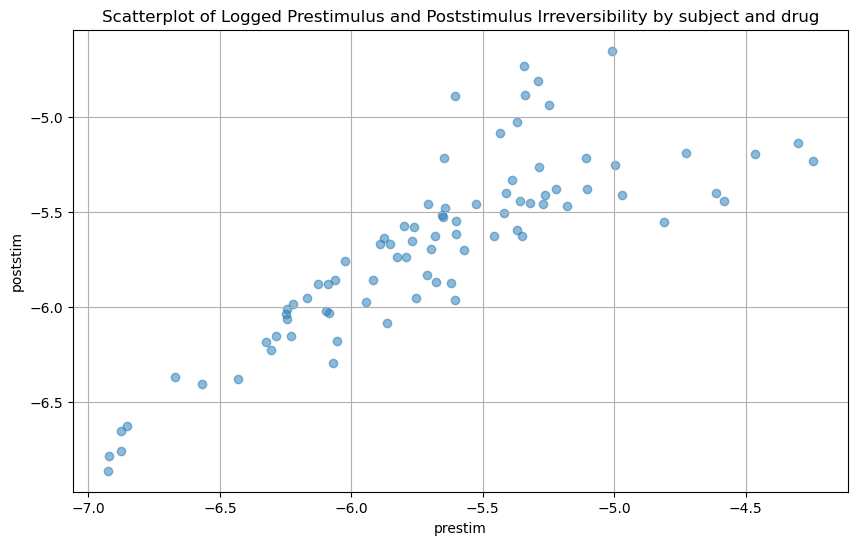

In [91]:
#behavior = behavior[behavior['drug'] == 'PLC']

df1 = behavior.groupby(['subject','drug'])['log_prestim'].mean()
df2 = behavior.groupby(['subject','drug'])['log_poststim'].mean()

plt.figure(figsize=(10, 6))
plt.scatter(df1, df2, alpha=0.5)

plt.xlabel('prestim')
plt.ylabel('poststim')
plt.title('Scatterplot of Logged Prestimulus and Poststimulus Irreversibility by subject and drug')
plt.grid(True)
plt.show()

testing testing

In [92]:
import statsmodels.api as sm

X = sm.add_constant(behavior['stim_diff'])  # adding a constant
y = behavior['correct']
model = sm.Logit(y, X)
result = model.fit()

# Print the results
print(result.summary())

Optimization terminated successfully.
         Current function value: 0.537873
         Iterations 5
                           Logit Regression Results                           
Dep. Variable:                correct   No. Observations:                44766
Model:                          Logit   Df Residuals:                    44764
Method:                           MLE   Df Model:                            1
Date:                Mon, 09 Sep 2024   Pseudo R-squ.:               0.0004369
Time:                        23:35:19   Log-Likelihood:                -24078.
converged:                       True   LL-Null:                       -24089.
Covariance Type:            nonrobust   LLR p-value:                 4.480e-06
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.2194      0.011    107.605      0.000       1.197       1.242
stim_diff     10.8777      2.

# ROIs

## Poststimulus

### CPP -- CPz, Cp1, and Cp2

In [93]:
behavior = df
behavior['pre_ref_matrices'] = df['prestim_ref_mat']
behavior['post_ref_matrices'] = df['poststim_ref_mat']

#### test

test1: [0.00664972 0.00651313 0.00717949 0.00838437 0.00710098 0.00641528
 0.00667001 0.00701245 0.00644496 0.00766432 0.0089885  0.0099953
 0.00868312 0.0078186  0.00731167 0.00785803 0.00863578 0.00922014
 0.01037001 0.01084619 0.01046024 0.01004316 0.00935267 0.00836348
 0.00989251 0.01069353 0.00969448 0.00685316 0.00933977 0.01048528
 0.01096612 0.01070455 0.00692461 0.00683728 0.00666119 0.00738476
 0.0084173  0.00929273 0.00868553 0.00726908 0.00649146 0.00667617
 0.0069465  0.00671331 0.00790851 0.00907231 0.0092169  0.00995991
 0.00982735 0.00907115 0.00832907 0.0073064  0.00822254 0.00915225
 0.00954005 0.01039221 0.0107645  0.01053418 0.01030705 0.00987705
 0.0092468  0.00982797 0.01037589 0.00920804]
test2: [0.00664972 0.00651313 0.00717949 0.00838437 0.00710098 0.00641528
 0.00667001 0.00701245 0.00644496 0.00766432 0.0089885  0.0099953
 0.00868312 0.0078186  0.00731167 0.00785803 0.00863578 0.00922014
 0.01037001 0.01084619 0.01046024 0.01004316 0.00935267 0.00836348
 0.0

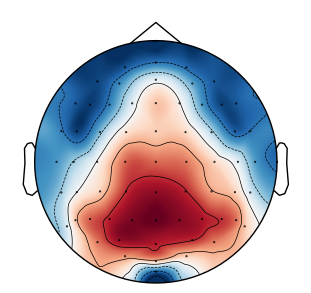

Mean irrev of CPz, CP1, CP2: 0.010488926531722488


In [94]:
# Technically this should be time-locked to response...... 
# Plus this cell is a test.


# channels = ['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3',
#	'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1',
#	'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz',
#	'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4',
#	'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4',
#	'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8',
#	'P10', 'PO8', 'PO4', 'O2']

data1 = np.zeros((64, 128)) # Replace with your data
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
channel_locs = montage.get_positions()['ch_pos']
info = mne.create_info(channels, sfreq=128, ch_types='eeg')
info.set_montage(montage) # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)

info = mne.create_info(channels, sfreq=128, ch_types='eeg')  # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)

# Set montage if known
montage = mne.channels.make_standard_montage('biosemi64')
raw.set_montage(montage)

avg_refmatrix = np.mean(behavior['post_ref_matrices'])

from scipy.stats import zscore

##
row = []
col = []

for r in range(64):
    i = np.mean(avg_refmatrix[r,:])
    row.append(i)
row = np.array(row)

for c in range(64):
    i = np.mean(avg_refmatrix[:,c])
    col.append(i)
col = np.array(col)

channel_contribution = row + col

##
row1 = np.mean(avg_refmatrix, axis=1)
col1 = np.mean(avg_refmatrix, axis=0)
channel_contribution1 = row + col
print("test1: " + str(channel_contribution))
print("test2: " + str(channel_contribution1))

zscore_matrix = zscore(channel_contribution, axis=None)

max1 = np.max(channel_contribution)

print("Max channel contribution: " + str(channels[np.argmax(channel_contribution)]) + ": " + str(max1))

max1 = np.max(avg_refmatrix)

print("Max Pairwise Irreversibility: " + str(channels[np.unravel_index(np.argmax(avg_refmatrix), avg_refmatrix.shape)[0]]) + "/" + 
      str(channels[np.unravel_index(np.argmax(avg_refmatrix), avg_refmatrix.shape)[1]])+  ": " + str(max1))

mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

#print(channel_contribution[channels.index('Pz')])
specific_electrodes = ['CPz', 'CP1', 'CP2']

electrode_indices = [channels.index(elec) for elec in specific_electrodes if elec in channels]

# Get the contribution values for these specific electrodes
specific_contributions = channel_contribution[electrode_indices]

print("Mean irrev of CPz, CP1, CP2: " + str(np.mean(specific_contributions)))

#### CPP Difference between pre/post -- we don't care though. Why would we care about the difference in CPP, see CPP Bins

Poststim: 
Max channel contribution: Pz: 0.010966120589071813
Max Pairwise Irreversibility: PO3/PO4: 0.00905838015934009


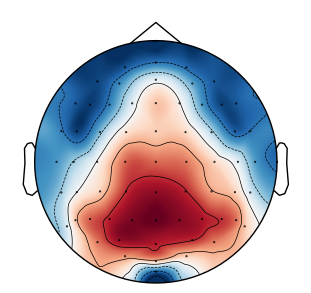

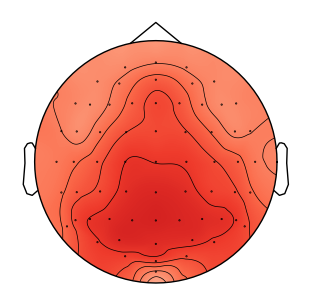

Prestim: 
Max channel contribution: PO8: 0.014498884291287258
Max Pairwise Irreversibility: PO8/P6: 0.01740070030583974


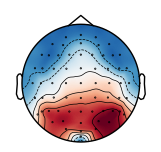

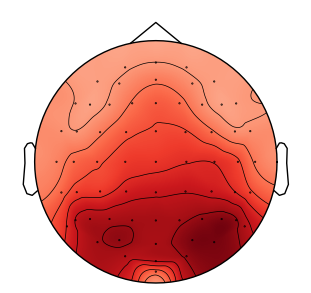

Diff (post - pre): 


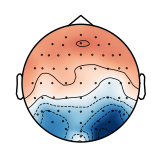

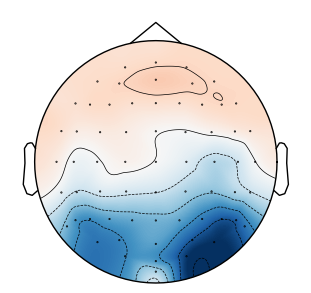

Mean irrev of CPz, CP1, CP2 in poststim: 0.010488926531722488
Mean irrev of CPz, CP1, CP2 in prestim: 0.01158278354737769
Mean irrev of CPz, CP1, CP2 (post - pre) (hopefully is positive!): -0.0010938570156552023
Paired t-test results:
T-statistic: 5.161798088318893
P-value: 0.035542775267575634


In [95]:
# Ahhhhh
from scipy.stats import zscore

# channels = ['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3',
#	'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1',
#	'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz',
#	'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4',
#	'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4',
#	'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8',
#	'P10', 'PO8', 'PO4', 'O2']
# Not important--
data1 = np.zeros((64, 128))  # Replace with your data
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
channel_locs = montage.get_positions()['ch_pos']
info = mne.create_info(channels, sfreq=128, ch_types='eeg')
info.set_montage(montage) # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)
info = mne.create_info(channels, sfreq=128, ch_types='eeg')  # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)
montage = mne.channels.make_standard_montage('biosemi64') # Set montage if known
raw.set_montage(montage)


#post
print("Poststim: ")
post_avg_refmatrix = np.mean(behavior['post_ref_matrices'])
row = np.mean(post_avg_refmatrix, axis=1)
col = np.mean(post_avg_refmatrix, axis=0)
post_channel_contribution = row + col
post_zscore_matrix = zscore(post_channel_contribution, axis=None)

max1 = np.max(post_channel_contribution)
print("Max channel contribution: " + str(channels[np.argmax(post_channel_contribution)]) + ": " + str(max1))
max1 = np.max(post_avg_refmatrix)
print("Max Pairwise Irreversibility: " + str(channels[np.unravel_index(np.argmax(post_avg_refmatrix), post_avg_refmatrix.shape)[0]]) + "/" + 
      str(channels[np.unravel_index(np.argmax(post_avg_refmatrix), post_avg_refmatrix.shape)[1]])+  ": " + str(max1))

mne.viz.plot_topomap(post_zscore_matrix, raw.info, res = 400, size = 3)
mne.viz.plot_topomap(post_channel_contribution, raw.info, res = 400, size = 3, vlim=(0.001, 0.015)) #Plottin

#pre
print("Prestim: ")
pre_avg_refmatrix = np.mean(behavior['pre_ref_matrices'])
row = np.mean(pre_avg_refmatrix, axis=1)
col = np.mean(pre_avg_refmatrix, axis=0)
pre_channel_contribution = row + col
pre_zscore_matrix = zscore(pre_channel_contribution, axis = None)

max1 = np.max(pre_channel_contribution)
print("Max channel contribution: " + str(channels[np.argmax(pre_channel_contribution)]) + ": " + str(max1))
max1 = np.max(pre_avg_refmatrix)
print("Max Pairwise Irreversibility: " + str(channels[np.unravel_index(np.argmax(pre_avg_refmatrix), pre_avg_refmatrix.shape)[0]]) + "/" + 
      str(channels[np.unravel_index(np.argmax(pre_avg_refmatrix), pre_avg_refmatrix.shape)[1]])+  ": " + str(max1))

mne.viz.plot_topomap(pre_zscore_matrix, raw.info, res = 400, size = 1.5) #Plottin
mne.viz.plot_topomap(pre_channel_contribution, raw.info, res = 400, size = 3, vlim=(0.001, 0.015)) #Plottin

#diff
print("Diff (post - pre): ")
diff_channel_contribution = post_channel_contribution - pre_channel_contribution
diff_zscore_matrix = zscore(diff_channel_contribution, axis=None)
mne.viz.plot_topomap(diff_zscore_matrix, raw.info, res = 400, size = 1.5)
mne.viz.plot_topomap(diff_channel_contribution, raw.info, res = 400, size = 3) #Plottin

#print(channel_contribution[channels.index('Pz')])
specific_electrodes = ['CPz', 'CP1', 'CP2']
electrode_indices = [channels.index(elec) for elec in specific_electrodes if elec in channels]
# Get the contribution values for these specific electrodes
post_cpp = post_channel_contribution[electrode_indices]
print("Mean irrev of CPz, CP1, CP2 in poststim: " + str(np.mean(post_cpp)))
pre_cpp = pre_channel_contribution[electrode_indices]
print("Mean irrev of CPz, CP1, CP2 in prestim: " + str(np.mean(pre_cpp)))
diff_cpp = diff_channel_contribution[electrode_indices]
print("Mean irrev of CPz, CP1, CP2 (post - pre) (hopefully is positive!): " + str(np.mean(diff_cpp)))

t_stat, p_value = sp.ttest_rel(pre_cpp, post_cpp)

# Output the results
print("Paired t-test results:")
print("T-statistic:", t_stat)
print("P-value:", p_value)

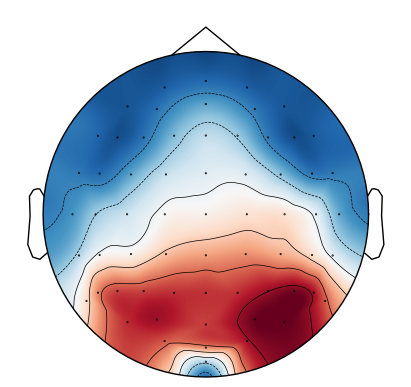

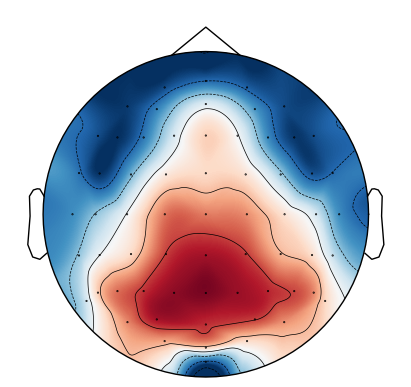

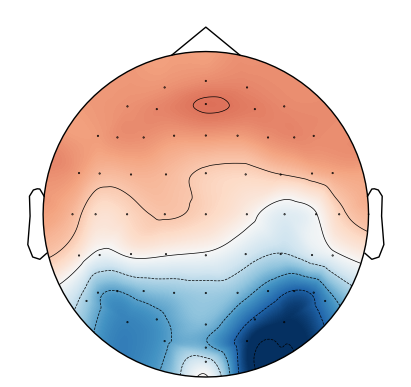

(<matplotlib.image.AxesImage at 0x25ae4047eb0>,
 <matplotlib.contour.QuadContourSet at 0x25ae1b55250>)

In [96]:
# this compares the pre AND post zscore included
all_data = np.vstack((pre_channel_contribution, post_channel_contribution))
# Calculate z-scores for the stacked array
z_scores = zscore(all_data, axis=1)
# Extract the z-scored data
pre_zscores = z_scores[0, :]
post_zscores = z_scores[1, :]

vmin = min(np.min(pre_zscores), np.min(post_zscores))
vmax = max(np.max(pre_zscores), np.max(post_zscores))

mne.viz.plot_topomap(pre_zscores, raw.info, res = 400, size = 4, vlim = (vmin, vmax))
mne.viz.plot_topomap(post_zscores, raw.info, res = 400, size = 4, vlim = (vmin, vmax))
mne.viz.plot_topomap(diff_zscore_matrix, raw.info, res = 400, size = 4)

#The only thing I don't understand is -- shouldn't there be BLUE in the front of the z_score matrix? This is, in theory, scaled correctly
#The post is clearly more blue in the front (lower irrev), so shouldn't lower - higher = very low? 

### CPP Bins -- linear relationship? (Post)

0.01048892653172245
The amount of empty cells is : 0
irreversibility_bin
0    0.003389
1    0.005833
2    0.008299
3    0.011893
4    0.023023
Name: cpp_irrev, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1022533716.py:41: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\1022533716.py:44: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


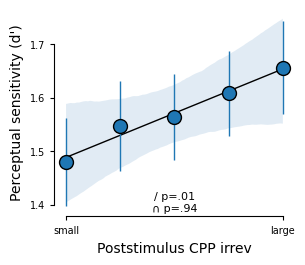

In [97]:
#drug = 'PLC'
#behavior = behavior[(behavior['drug'] == drug)]
behavior = df
behavior['post_ref_matrices'] = df['poststim_ref_mat']

specific_electrodes = ['CPz', 'CP1', 'CP2']
electrode_indices = [channels.index(elec) for elec in specific_electrodes if elec in channels]

cpp_array = []
for matrix in behavior['post_ref_matrices']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    post_contribution = row + col
    post_cpp = np.mean(post_contribution[electrode_indices])
    cpp_array.append(post_cpp)

behavior['cpp_irrev'] = cpp_array
print(np.mean(behavior['cpp_irrev']))

cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['cpp_irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['cpp_irrev'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first_irreversibility['d']
p_val_quadratic = betas_second_irreversibility['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststimulus CPP irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

#### PLC

C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2879416247.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['cpp_irrev'] = cpp_array
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2879416247.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['cpp_irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


0.010857728745274502
The amount of empty cells is : 0
irreversibility_bin
0    0.003440
1    0.005918
2    0.008379
3    0.012058
4    0.024488
Name: cpp_irrev, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2879416247.py:39: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\2879416247.py:42: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


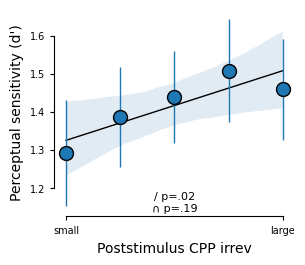

In [98]:

drug = 'PLC'
behavior = behavior[(behavior['drug'] == drug)]

specific_electrodes = ['CPz', 'CP1', 'CP2']
electrode_indices = [channels.index(elec) for elec in specific_electrodes if elec in channels]

cpp_array = []
for matrix in behavior['post_ref_matrices']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    post_contribution = row + col
    post_cpp = np.mean(post_contribution[electrode_indices])
    cpp_array.append(post_cpp)

behavior['cpp_irrev'] = cpp_array
print(np.mean(behavior['cpp_irrev']))

cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['cpp_irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['cpp_irrev'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first_irreversibility['d']
p_val_quadratic = betas_second_irreversibility['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststimulus CPP irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

## RATIO of CPP irrev:global irrev in that trial has an effect on performance

In [99]:
behavior = df

behavior['post_channel_contributions'] = [np.mean(matrix, axis=0) + np.mean(matrix, axis=1)
    for matrix in behavior['poststim_ref_mat']]

specific_electrodes = ['CPz', 'CP1', 'CP2']
electrode_indices = [channels.index(elec) for elec in specific_electrodes if elec in channels]
# Get the contribution values for these specific electrodes for all trials
post_cpp = [np.mean(matrix[electrode_indices])
    for matrix in behavior['post_channel_contributions']]


behavior['ratio'] = post_cpp / (behavior['poststim_irrev'])

behavior.head()


,Unnamed: 0,subject,drug,session,block,miniblock,trial_nr,cue,location,cue_val,...,poststimulus_irreversibility,log_bin,left_cue_irrev,contributions,right_cue_irrev,pre_ref_matrices,post_ref_matrices,cpp_irrev,post_channel_contributions,ratio
0,0,1,DNP,0,1,0,316,1,1,1,...,0.004368,1,0.006754,"[0.0022288245948319245, 0.0057013992038074624,...",0.024694,"[[0.0, 0.0006873881373122065, 0.00016213735834...","[[0.0, 0.0034406175735612415, 0.00032247166478...",0.005038,"[0.0022288245948319245, 0.0057013992038074624,...",1.153273
1,1,1,DNP,0,1,0,318,1,1,1,...,0.007235,3,0.012258,"[0.009274381514616759, 0.03291529569603245, 0....",0.008712,"[[0.0, 0.040240608719263854, 0.000460120231847...","[[0.0, 0.011221204332762597, 3.11892070731507e...",0.020538,"[0.009274381514616759, 0.03291529569603245, 0....",2.838759
2,2,1,DNP,0,1,0,319,0,1,0,...,0.007527,3,0.004845,"[0.040217687400140194, 0.004733697776624523, 0...",0.003071,"[[0.0, 0.00011810852016698719, 1.5823859782963...","[[6.933347799794049e-33, 0.0021569218713682363...",0.007315,"[0.040217687400140194, 0.004733697776624523, 0...",0.971728
3,3,1,DNP,0,1,0,320,1,1,1,...,0.003592,1,0.006380,"[0.0040296409210662885, 0.0017338833513004452,...",0.006109,"[[0.0, 6.157323424213391e-05, 0.00035627791271...","[[0.0, 9.957067986210528e-07, 1.23841343919133...",0.010806,"[0.0040296409210662885, 0.0017338833513004452,...",3.008598
4,4,1,DNP,0,1,0,321,1,1,1,...,0.006225,2,0.015977,"[0.009724910067185847, 0.032085306736020225, 0...",0.010927,"[[0.0, 0.005253544828395134, 0.001778205067022...","[[3.0814879110195774e-33, 0.012134126048785662...",0.014862,"[0.009724910067185847, 0.032085306736020225, 0...",2.387499


In [100]:
print(post_cpp[0])
print(behavior['poststim_irrev'][0])
print(behavior['ratio'][0])
print()
print(post_cpp[1])
print(behavior['poststim_irrev'][1])
print(behavior['ratio'][1])

0.005037607999519301
0.004368097827751872
1.1532727054586152

0.020538252493057973
0.007234940280185953
2.8387590909776104


The amount of empty cells is : 0
ratio_bin
0    0.909253
1    1.360587
2    1.664362
3    1.936080
4    2.205701
5    2.492523
6    2.816292
7    3.211402
8    3.748672
9    4.959978
Name: ratio, dtype: float64


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3006852069.py:29: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_ratiobin, 1, 'd'), 0)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3006852069.py:32: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_ratiobin, 2, 'd'), 0)


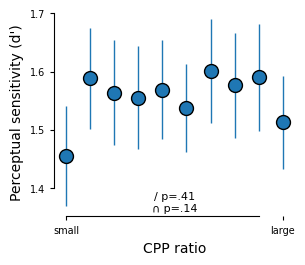

In [101]:


def run_model_ratiobin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['ratio_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]
#drug = 'PLC'

cfg = dict()
cfg['n_bins'] = 10 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['ratio_bin'] = behavior.groupby(['subject','drug'])['ratio'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','ratio_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'ratio_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('ratio_bin').mean()['ratio'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_ratiobin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_ratiobin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('ratio_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('ratio_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first_irreversibility['d']
p_val_quadratic = betas_second_irreversibility['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="ratio_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="ratio_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('CPP ratio')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()


# Std dev

## std dev of pre and post (raw)

Std dev of raw global irrev values in pre: 0.005980414278422955
Std devs of ref matrices in pre (averaged): 0.01280092367909819

Std dev of raw global irrev values in post: 0.006643439347311396
Std devs of ref matrices in post (averaged): 0.01106736961305236

The rest of these plots showing the RAW STD DEVS (skewed), and the log transforrmed std devs:


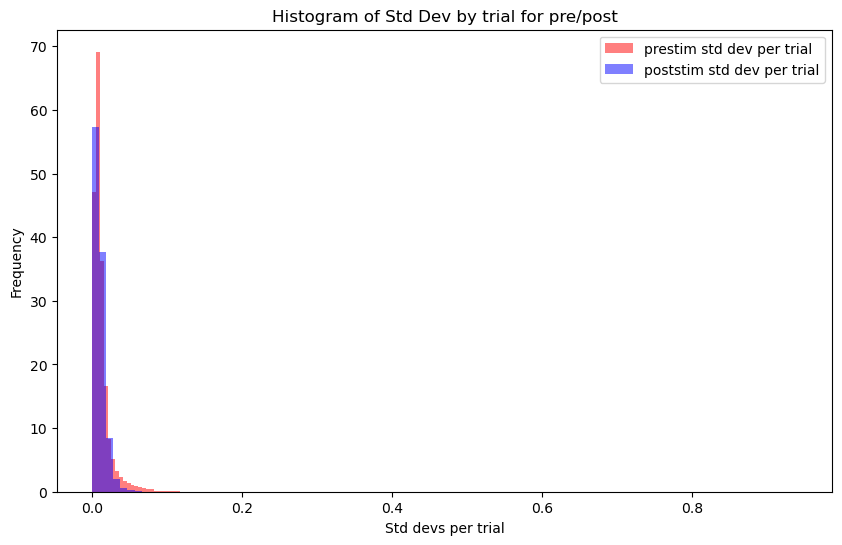

In [102]:
behavior = df

# pre -- 
#STD DEV  of global irrev in pre
print("Std dev of raw global irrev values in pre: " + str(np.std(behavior['prestim_irrev'])))
# ref matrices 
std_devs = [np.std(matrix) for matrix in behavior['prestim_ref_mat']]
std_devs_array = np.array(std_devs)
print("Std devs of ref matrices in pre (averaged): " + str(np.mean(std_devs_array)))
print()
# post -- 
# global irrev
print("Std dev of raw global irrev values in post: " + str(np.std(behavior['poststim_irrev'])))
# ref_matrices
std_devs1 = [np.std(matrix) for matrix in behavior['poststim_ref_mat']]
std_devs_array1 = np.array(std_devs1)
print("Std devs of ref matrices in post (averaged): " + str(np.mean(std_devs_array1)))

print()
print("The rest of these plots showing the RAW STD DEVS (skewed), and the log transforrmed std devs:")
plt.figure(figsize=(10, 6))

plt.hist(std_devs_array, bins=100, alpha=0.5, label='prestim std dev per trial', color='red', density = True)
plt.hist(std_devs_array1, bins=100, alpha=0.5, label='poststim std dev per trial', color='blue', density = True)

# Adding labels and title
plt.xlabel('Std devs per trial')
plt.ylabel('Frequency')
plt.title('Histogram of Std Dev by trial for pre/post')
plt.legend()

# Show the plot
plt.show()


## logged data -- logged std devs of the ref matrix show the same histogram basically as logged global values.

Std dev of logged global pre irrevs: 0.8071898560403837
Std dev of the ref matrices (but logged) (averaged at the group level): -4.68492336518974

Std dev of logged global post irrevs: 0.6939591345083789
Std dev of the ref matrices (but logged) (averaged at the group level): -4.706292080109429


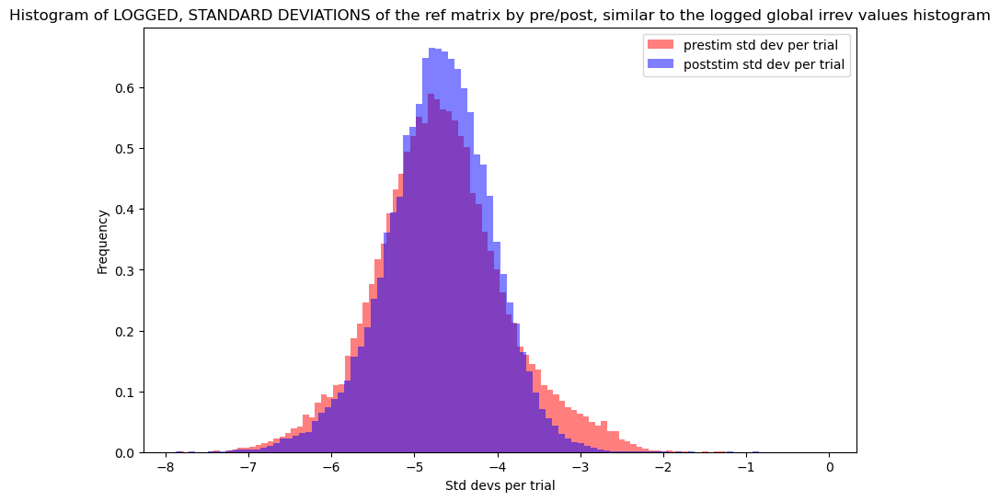

The std dev of those std devs in the pretty log histogram (pre): 0.7805218494415668
The std dev of those std devs in the pretty log histogram: (post): 0.6374800119577892


In [103]:
log_pre = behavior['log_prestim']
log_post = behavior['log_poststim']

### LOGGED DATA ### 
# Log pre = logged pre global irrev
print("Std dev of logged global pre irrevs: " + str(np.std(log_pre)))
# Std dev of logged ref matrix 
pre_log_ref = [np.std(matrix) for matrix in behavior['prestim_ref_mat']]
pre_std_devs_array = np.log(np.array(pre_log_ref))
print("Std dev of the ref matrices (but logged) (averaged at the group level): " + str(np.mean(pre_std_devs_array)))
print()

print("Std dev of logged global post irrevs: " + str(np.std(log_post)))
post_log_ref = [np.std(matrix) for matrix in behavior['poststim_ref_mat']]
post_std_devs_array = np.log(np.array(post_log_ref))
print("Std dev of the ref matrices (but logged) (averaged at the group level): " + str(np.mean(post_std_devs_array)))

plt.figure(figsize=(10, 6))

plt.hist(pre_std_devs_array, bins=100, alpha=0.5, label='prestim std dev per trial', color='red', density = True)
plt.hist(post_std_devs_array, bins=100, alpha=0.5, label='poststim std dev per trial', color='blue', density = True)

# Adding labels and title
plt.xlabel('Std devs per trial')
plt.ylabel('Frequency')
plt.title('Histogram of LOGGED, STANDARD DEVIATIONS of the ref matrix by pre/post, similar to the logged global irrev values histogram')
plt.legend()

# Show the plot
plt.show()

print("The std dev of those std devs in the pretty log histogram (pre): "+str(np.std(pre_std_devs_array)))
print("The std dev of those std devs in the pretty log histogram: (post): "+str(np.std(post_std_devs_array)))

## Significance testing in the std deviation of the logged pre/post

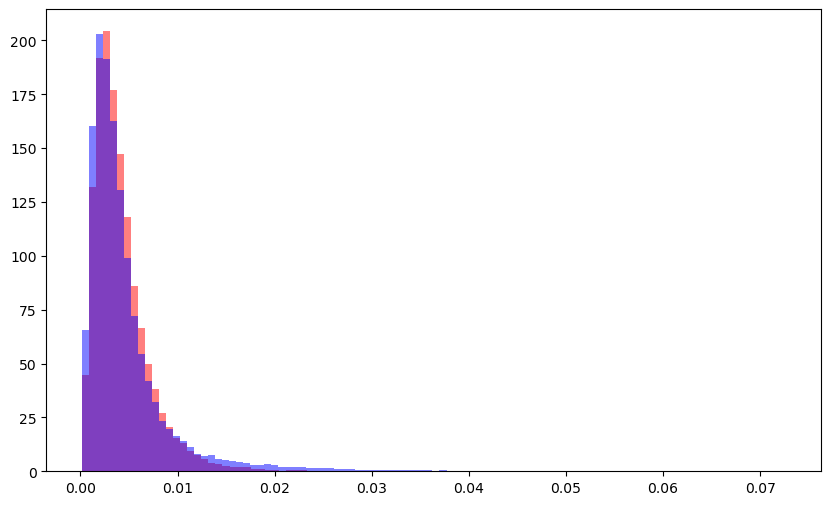

post std dev: 0.003226416561781769
pre std dev: 0.0048761027843813014
F test-- F-statistic: 0.4378195733108956, p-value: 0.9999999999999999
F test-- F-statistic: 2.2840458968925543, p-value: 0.9999999999999999
Levene's test statistic: 681.9389827684228, p-value: 9.24743356338503e-150
Brown-Forsythe test statistic: 681.9389827684228, p-value: 9.24743356338503e-150


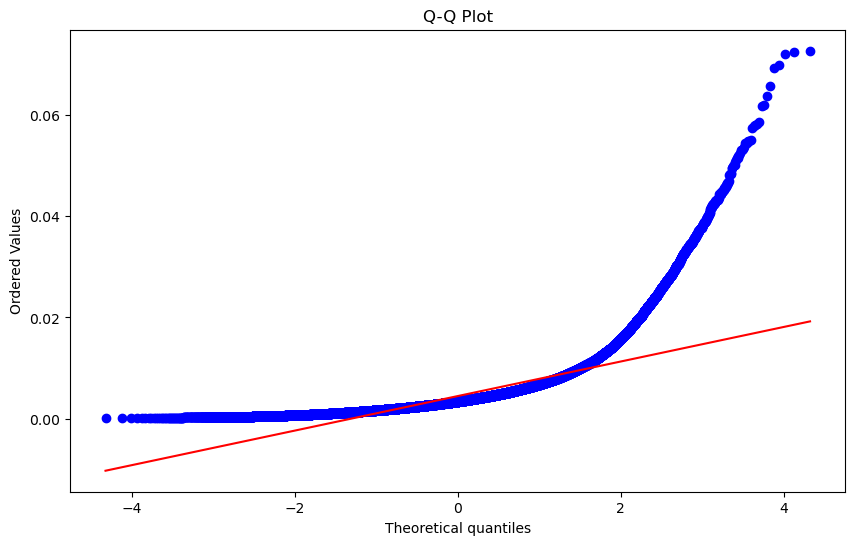

Shapiro-Wilk Test-- Group 1: stat=0.7668102501564386, p-value=1.1068069052961543e-116
Shapiro-Wilk Test-- Group 2: stat=0.6527626091878145, p-value=6.071762596166744e-128


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3486365702.py:61: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 44766.
  sw_stat1, sw_p1 = stats.shapiro(group1)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\3486365702.py:62: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 44766.
  sw_stat2, sw_p2 = stats.shapiro(group2)


In [104]:
behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
# Sample data
group1 = behavior['poststim_irrev']
group2 = behavior['prestim_irrev']

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='poststim', color='red', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='prestim', color='blue', density = True)

plt.show()

print("post std dev: " + str(np.std(group1)))
print("pre std dev: " + str(np.std(group2)))

import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic: {stat}, p-value: {p_value}")


##### QQ PLOT AND ASSUMPTION OF NORMALITY TESTING--
plt.figure(figsize=(10, 6))

stats.probplot(np.concatenate([group1, group2]), dist="norm", plot=plt)
plt.title('Q-Q Plot')
plt.show()

# Shapiro-Wilk Test -- higher p value is better....
sw_stat1, sw_p1 = stats.shapiro(group1)
sw_stat2, sw_p2 = stats.shapiro(group2)
print(f"Shapiro-Wilk Test-- Group 1: stat={sw_stat1}, p-value={sw_p1}")
print(f"Shapiro-Wilk Test-- Group 2: stat={sw_stat2}, p-value={sw_p2}")



### Now in the raw

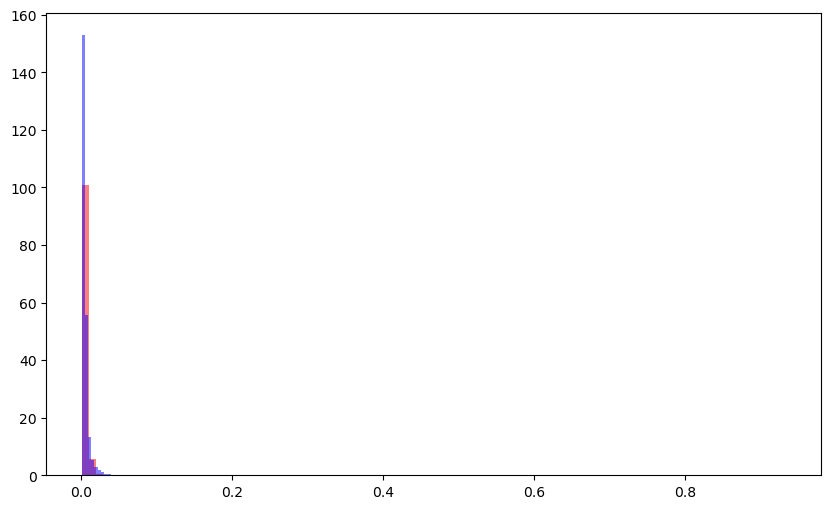

F test-- F-statistic: 1.23402344065969, p-value: 0.9999999999999999
Levene's test statistic: 228.59161103059807, p-value: 1.4004655408456402e-51
Brown-Forsythe test statistic: 228.59161103059807, p-value: 1.4004655408456402e-51


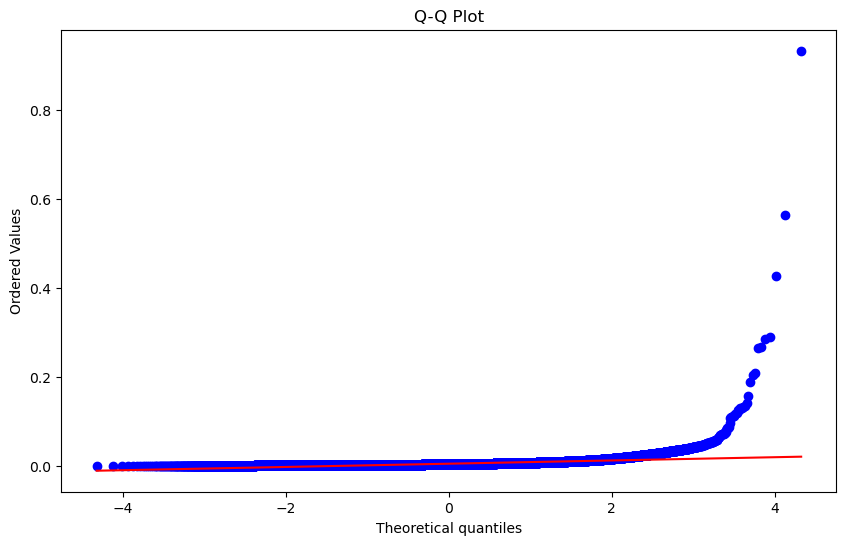

Shapiro-Wilk Test-- Group 1: stat=0.2197829720596478, p-value=1.7663028698722057e-152
Shapiro-Wilk Test-- Group 2: stat=0.4795433616187341, p-value=6.06451770838711e-140


C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\513975660.py:48: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 44790.
  sw_stat1, sw_p1 = stats.shapiro(group1)
C:\Users\Jake\AppData\Local\Temp\ipykernel_15852\513975660.py:49: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 44790.
  sw_stat2, sw_p2 = stats.shapiro(group2)


In [105]:
behavior = df
# Sample data
group1 = behavior['poststim_irrev']
group2 = behavior['prestim_irrev']

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='poststim', color='red', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='prestim', color='blue', density = True)

plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic: {stat}, p-value: {p_value}")


###### SOME TESTING OF NORMALITY / QQ PLOT
plt.figure(figsize=(10, 6))

stats.probplot(np.concatenate([group1, group2]), dist="norm", plot=plt)
plt.title('Q-Q Plot')
plt.show()

# Shapiro-Wilk Test -- higher is better
sw_stat1, sw_p1 = stats.shapiro(group1)
sw_stat2, sw_p2 = stats.shapiro(group2)
print(f"Shapiro-Wilk Test-- Group 1: stat={sw_stat1}, p-value={sw_p1}")
print(f"Shapiro-Wilk Test-- Group 2: stat={sw_stat2}, p-value={sw_p2}")





## within subjects? (Logged data)

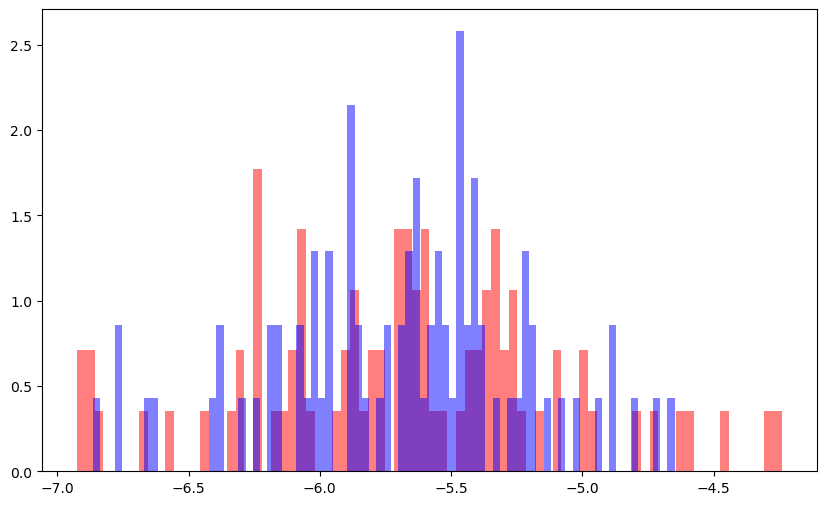

F test-- F-statistic: 1.529396722066428, p-value: 0.9727227495795487
Levene's test statistic: 2.4003578321429413, p-value: 0.12321188869784173
Brown-Forsythe test statistic: 2.4003578321429413, p-value: 0.12321188869784173


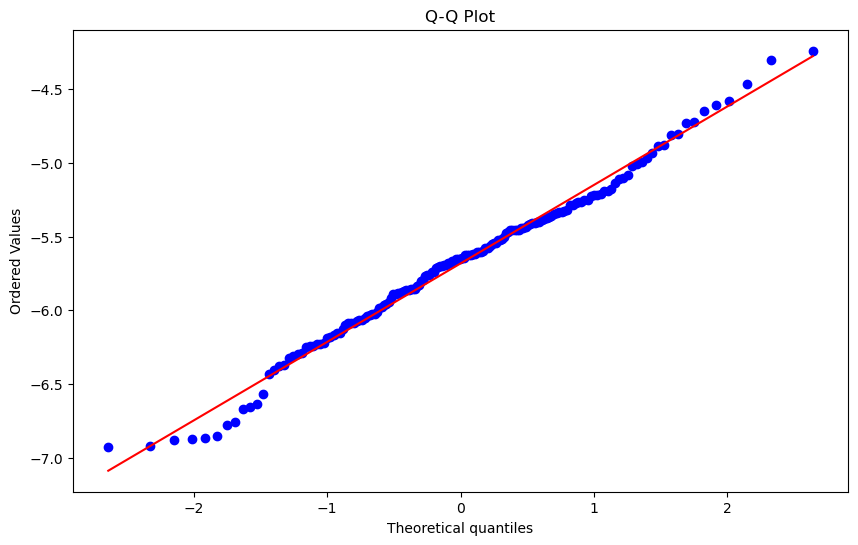

Shapiro-Wilk Test-- Group 1: stat=0.9831514301719924, p-value=0.3417979966200059
Shapiro-Wilk Test-- Group 2: stat=0.9840452459506766, p-value=0.38674988673163757


In [106]:
behavior = df

df1 = behavior.groupby(['subject','drug'])['log_prestim'].mean()
behavior.head()

df2 = behavior.groupby(['subject','drug'])['log_poststim'].mean()
behavior.head()

# Sample data
group1 = df1
group2 = df2

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=80, alpha=0.5, label='poststim', color='red', density = True)
plt.hist(group2, bins=80, alpha=0.5, label='prestim', color='blue', density = True)

plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic: {stat}, p-value: {p_value}")


##### QQ PLOT AND ASSUMPTION OF NORMALITY TESTING--
plt.figure(figsize=(10, 6))

stats.probplot(np.concatenate([group1, group2]), dist="norm", plot=plt)
plt.title('Q-Q Plot')
plt.show()

# Shapiro-Wilk Test -- higher p value is better....
sw_stat1, sw_p1 = stats.shapiro(group1)
sw_stat2, sw_p2 = stats.shapiro(group2)
print(f"Shapiro-Wilk Test-- Group 1: stat={sw_stat1}, p-value={sw_p1}")
print(f"Shapiro-Wilk Test-- Group 2: stat={sw_stat2}, p-value={sw_p2}")





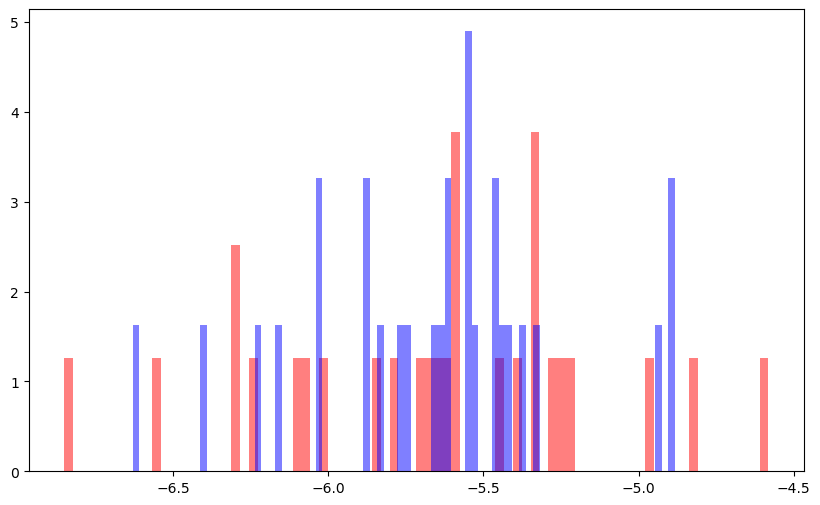

F test-- F-statistic: 1.5613052041598277, p-value: 0.8733122149583284
Levene's test statistic: 1.1618515538584233, p-value: 0.2858735142525762
Brown-Forsythe test statistic: 1.1618515538584233, p-value: 0.2858735142525762


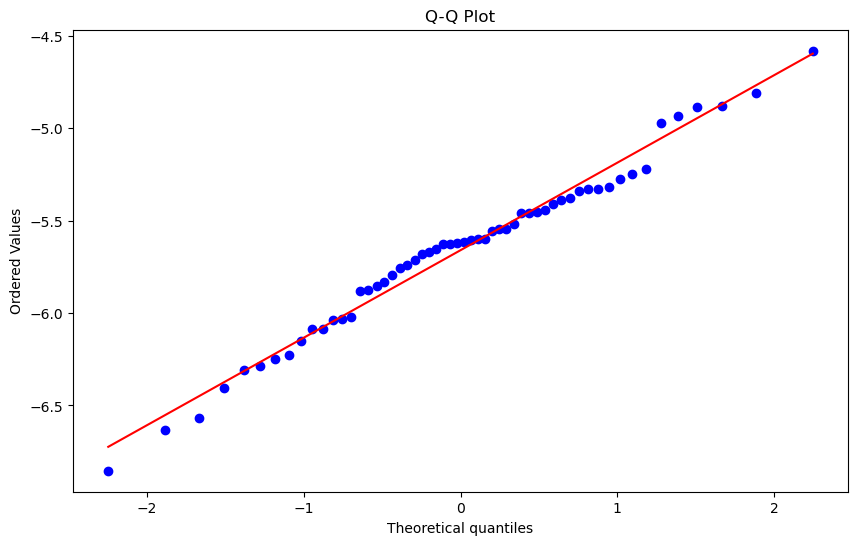

Shapiro-Wilk Test-- Group 1: stat=0.983922050303429, p-value=0.9315712375983412
Shapiro-Wilk Test-- Group 2: stat=0.9639848905530355, p-value=0.43138654735145465


In [107]:
behavior = df

behavior = behavior[behavior['drug']=='PLC']

df1 = behavior.groupby(['subject'])['log_prestim'].mean()
behavior.head()

df2 = behavior.groupby(['subject'])['log_poststim'].mean()
behavior.head()

# Sample data
group1 = df1
group2 = df2

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=80, alpha=0.5, label='poststim', color='red', density = True)
plt.hist(group2, bins=80, alpha=0.5, label='prestim', color='blue', density = True)

plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic: {stat}, p-value: {p_value}")


##### QQ PLOT AND ASSUMPTION OF NORMALITY TESTING--
plt.figure(figsize=(10, 6))

stats.probplot(np.concatenate([group1, group2]), dist="norm", plot=plt)
plt.title('Q-Q Plot')
plt.show()

# Shapiro-Wilk Test -- higher p value is better....
sw_stat1, sw_p1 = stats.shapiro(group1)
sw_stat2, sw_p2 = stats.shapiro(group2)
print(f"Shapiro-Wilk Test-- Group 1: stat={sw_stat1}, p-value={sw_p1}")
print(f"Shapiro-Wilk Test-- Group 2: stat={sw_stat2}, p-value={sw_p2}")





### same but raw

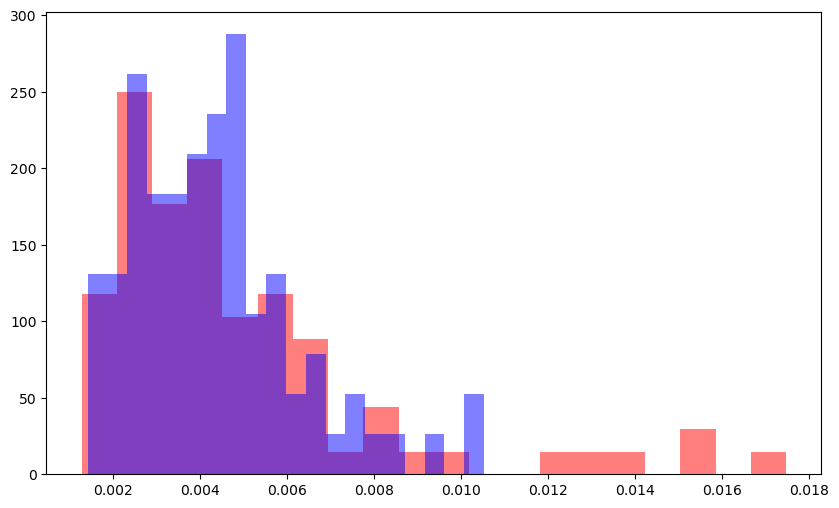

F test-- F-statistic: 2.9169634948758714, p-value: 0.9999989982586238
Levene's test statistic: 4.394491255570217, p-value: 0.03757154548825797
Brown-Forsythe test statistic: 4.394491255570217, p-value: 0.03757154548825797


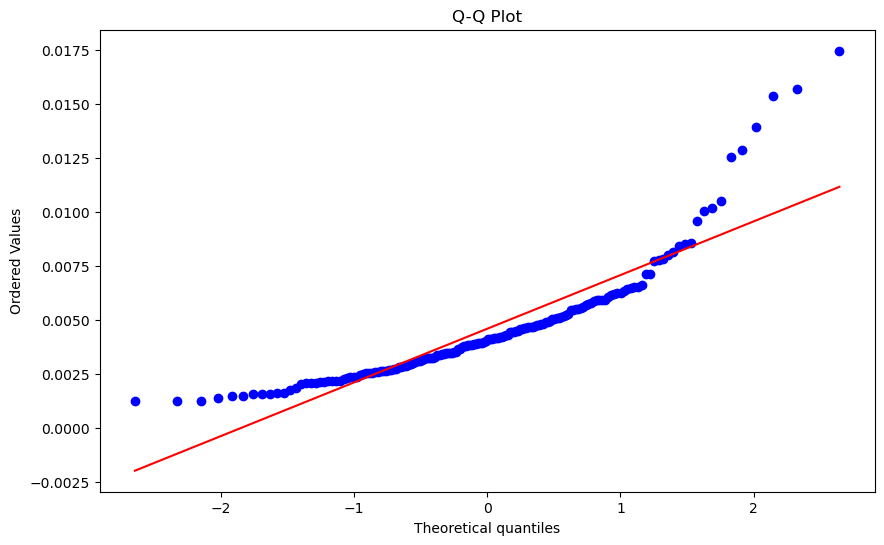

Shapiro-Wilk Test-- Group 1: stat=0.7912708578656107, p-value=1.4502719330382531e-09
Shapiro-Wilk Test-- Group 2: stat=0.930598112764331, p-value=0.00021751676476567


In [108]:
behavior = df
df1 = behavior.groupby(['subject','drug'])['prestim_irrev'].mean()
behavior.head()

df2 = behavior.groupby(['subject','drug'])['poststim_irrev'].mean()
behavior.head()

# Sample data
group1 = df1
group2 = df2

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=20, alpha=0.5, label='poststim', color='red', density = True)
plt.hist(group2, bins=20, alpha=0.5, label='prestim', color='blue', density = True)

plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic: {stat}, p-value: {p_value}")


##### QQ PLOT AND ASSUMPTION OF NORMALITY TESTING--
plt.figure(figsize=(10, 6))

stats.probplot(np.concatenate([group1, group2]), dist="norm", plot=plt)
plt.title('Q-Q Plot')
plt.show()

# Shapiro-Wilk Test -- higher p value is better....
sw_stat1, sw_p1 = stats.shapiro(group1)
sw_stat2, sw_p2 = stats.shapiro(group2)
print(f"Shapiro-Wilk Test-- Group 1: stat={sw_stat1}, p-value={sw_p1}")
print(f"Shapiro-Wilk Test-- Group 2: stat={sw_stat2}, p-value={sw_p2}")





# Cue analysis

## pre/post cue

### raw difference

In [109]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
behavior = df
behavior = behavior[behavior['drug'] == 'ATX']
pre = behavior['precue_irrev']
post = behavior['postcue_irrev']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['precue', 'postcue'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = stats.wilcoxon(pre, post)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of precue: " + str(np.mean(pre)))
print("mean of postcue: " + str(np.mean(post)))
print("median of precue: " + str(np.median(pre)))
print("median of postcue: " + str(np.median(post)))

plt.show()

plt.hist(np.log(pre), bins=200, color='blue', alpha=0.5, label='logged pre', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.5, label='logged post', density = True)
plt.legend()
plt.show()
#Well shit.

KeyError: 'precue_irrev'

### bins

#### pre-cue

C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1747892025.py:11: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


The amount of empty cells is : 0
irreversibility_bin
0    0.001865
1    0.002819
2    0.003707
3    0.004935
4    0.008748
Name: irreversibility, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1747892025.py:24: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1747892025.py:28: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1747892025.py:31: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, bet

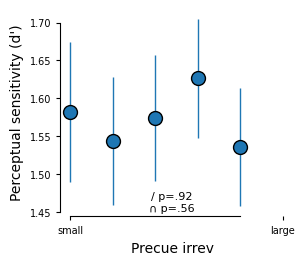

In [150]:
behavior = df

behavior['irreversibility'] = behavior['precue_irrev']

#drug = 'PLC'

#behavior = behavior[(behavior['drug'] == drug)]

cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first_irreversibility['d']
p_val_quadratic = betas_second_irreversibility['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Precue irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

#### post-cue

C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\3891503575.py:11: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


The amount of empty cells is : 0
irreversibility_bin
0    0.001838
1    0.002756
2    0.003586
3    0.004706
4    0.008215
Name: irreversibility, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\3891503575.py:24: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\3891503575.py:28: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\3891503575.py:31: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, bet

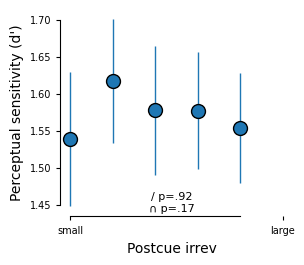

In [151]:
behavior = df

behavior['irreversibility'] = behavior['postcue_irrev']

#drug = 'PLC'

#behavior = behavior[(behavior['drug'] == drug)]

cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first_irreversibility['d']
p_val_quadratic = betas_second_irreversibility['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Postcue irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1794844273.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irreversibility'] = behavior['postcue_irrev']
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1794844273.py:15: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n

The amount of empty cells is : 0
irreversibility_bin
0    0.001590
1    0.002215
2    0.002621
3    0.002992
4    0.003429
5    0.003830
6    0.004331
7    0.005057
8    0.006164
9    0.009778
Name: irreversibility, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1794844273.py:28: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1794844273.py:32: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1794844273.py:35: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, bet

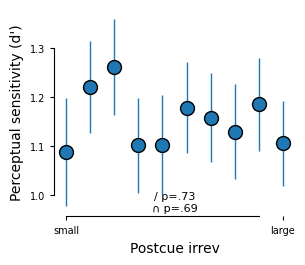

In [192]:
behavior = df

behavior = behavior[behavior['cue_val']==0]

behavior['irreversibility'] = behavior['postcue_irrev']

#drug = 'PLC'

#behavior = behavior[(behavior['drug'] == drug)]

cfg = dict()
cfg['n_bins'] = 10 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first_irreversibility['d']
p_val_quadratic = betas_second_irreversibility['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Postcue irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

#### cue diff

C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\171872408.py:11: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['diff_bin'] = behavior.groupby(['subject','drug'])['cue_diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


The amount of empty cells is : 0
diff_bin
0   -0.004421
1   -0.001227
2   -0.000110
3    0.000941
4    0.003853
Name: cue_diff, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\171872408.py:24: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  print(behavior.groupby('diff_bin').mean()['cue_diff'])
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\171872408.py:28: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\171872408.py:31: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibil

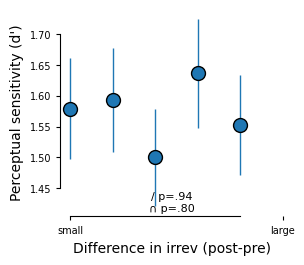

In [152]:
def run_model_diffbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['diff_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

behavior = df

cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['diff_bin'] = behavior.groupby(['subject','drug'])['cue_diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','diff_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'diff_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('diff_bin').mean()['cue_diff'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('diff_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('diff_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Difference in irrev (post-pre)')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\3981029659.py:15: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['diff_bin'] = behavior.groupby(['subject','drug'])['cue_diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


The amount of empty cells is : 0
diff_bin
0   -0.004424
1   -0.001229
2   -0.000108
3    0.000943
4    0.003880
Name: cue_diff, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\3981029659.py:28: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  print(behavior.groupby('diff_bin').mean()['cue_diff'])
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\3981029659.py:32: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\3981029659.py:35: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversi

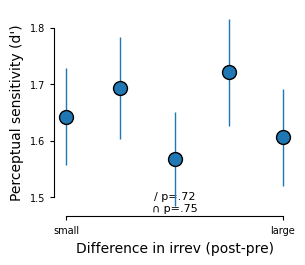

In [187]:
def run_model_diffbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['diff_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

behavior = df

behavior = behavior[behavior['cue_val']==1]

cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['diff_bin'] = behavior.groupby(['subject','drug'])['cue_diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','diff_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'diff_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('diff_bin').mean()['cue_diff'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('diff_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('diff_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Difference in irrev (post-pre)')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

#### diff btw pre-stim and post-cue! (expect negative correlation with performance?)

C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\4219099427.py:13: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['diff_bin'] = behavior.groupby(['subject','drug'])['cue_prestim_diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


The amount of empty cells is : 0
diff_bin
0   -0.005654
1   -0.002140
2   -0.001173
3   -0.000496
4    0.000067
5    0.000638
6    0.001279
7    0.002073
8    0.003288
9    0.007474
Name: cue_prestim_diff, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\4219099427.py:26: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  print(behavior.groupby('diff_bin').mean()['cue_prestim_diff'])
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\4219099427.py:30: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\4219099427.py:33: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_i

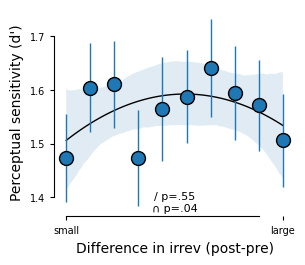

In [194]:
def run_model_diffbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['diff_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

behavior = df

cfg = dict()
cfg['n_bins'] = 10 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['diff_bin'] = behavior.groupby(['subject','drug'])['cue_prestim_diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','diff_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'diff_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('diff_bin').mean()['cue_prestim_diff'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('diff_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('diff_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Difference in irrev (post-pre)')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1550167289.py:14: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['diff_bin'] = behavior.groupby(['subject','drug'])['cue_prestim_diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1550167289.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['diff_

The amount of empty cells is : 0
diff_bin
0   -0.005697
1   -0.002141
2   -0.001172
3   -0.000494
4    0.000068
5    0.000645
6    0.001282
7    0.002064
8    0.003299
9    0.007585
Name: cue_prestim_diff, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1550167289.py:27: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  print(behavior.groupby('diff_bin').mean()['cue_prestim_diff'])
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1550167289.py:31: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\1550167289.py:34: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_i

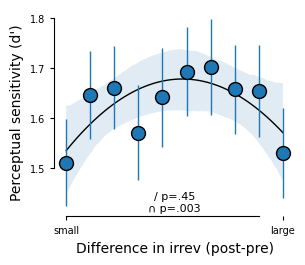

In [195]:



def run_model_diffbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['diff_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

behavior = df
behavior = behavior[behavior['cue_val'] == 1]

cfg = dict()
cfg['n_bins'] = 10 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['diff_bin'] = behavior.groupby(['subject','drug'])['cue_prestim_diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','diff_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'diff_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('diff_bin').mean()['cue_prestim_diff'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('diff_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('diff_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Difference in irrev (post-pre)')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

some random shit here -- 

C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\2169148822.py:15: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['diff_bin'] = behavior.groupby(['subject','drug'])['diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


The amount of empty cells is : 0
diff_bin
0   -0.004421
1   -0.001227
2   -0.000110
3    0.000941
4    0.003853
Name: diff, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\2169148822.py:28: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  print(behavior.groupby('diff_bin').mean()['diff'])
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\2169148822.py:32: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\2169148822.py:35: DeprecationWarning: Please import `ttest_1samp` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  _, betas_second_irreversibili

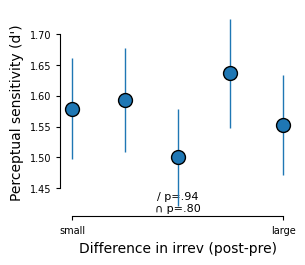

In [175]:
def run_model_diffbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['diff_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

behavior = df

behavior['diff'] = behavior['postcue_irrev'] - behavior['precue_irrev']

cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['diff_bin'] = behavior.groupby(['subject','drug'])['diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt_irreversibility = behavior.groupby(['subject','drug','diff_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt_irreversibility['d']).sum()))


# Average data across drug sessions to obtain behavioral outcomes per subject and irreversibility bin
df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'diff_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)

print(behavior.groupby('diff_bin').mean()['diff'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_diffbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('diff_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('diff_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

# Optionally add model fits if linear/quadratic fit was significant
if betas_first_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if betas_second_irreversibility['d'] < .05:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="diff_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Difference in irrev (post-pre)')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

## Histogram / Scatterplot

### pre/post

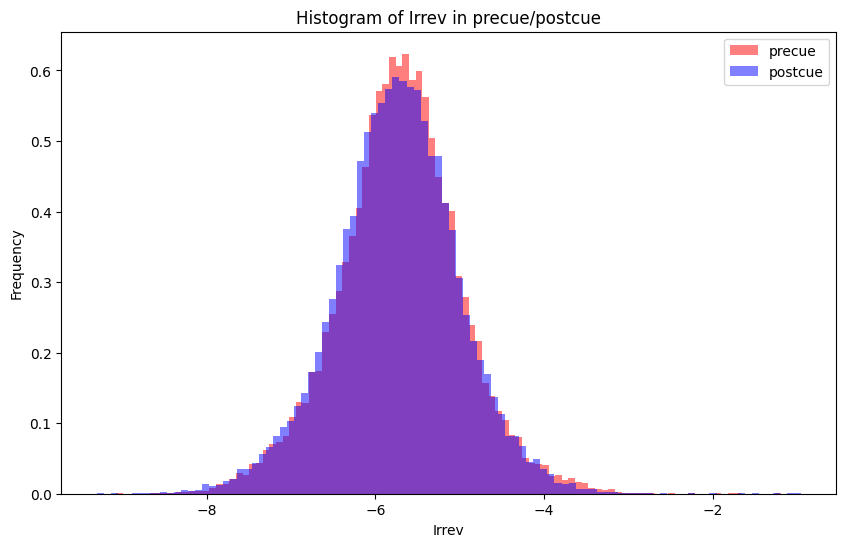

The mean of precue (raw irrev values): 0.004410852205820991
The mean of postcue (raw irrev values): 0.004253163789967464
The median of precue (raw irrev values): 0.003343294066502979
The median of postcue (raw irrev values): 0.0032417757372271445
The std dev of precue (logged irrev values): 0.730848154571019
The std dev of postcue (logged irrev values): 0.7349240206305279


In [180]:

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

plt.hist(behavior['log_precue'], bins=100, alpha=0.5, label='precue', color='red', density = True)
plt.hist(behavior['log_postcue'], bins=100, alpha=0.5, label='postcue', color='blue', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Irrev in precue/postcue')
plt.legend()

# Show the plot
plt.show()

print("The mean of precue (raw irrev values): "+str(np.mean(behavior['precue_irrev'])))
print("The mean of postcue (raw irrev values): "+str(np.mean(behavior['postcue_irrev'])))


print("The median of precue (raw irrev values): "+str(np.median(behavior['precue_irrev'])))
print("The median of postcue (raw irrev values): "+str(np.median(behavior['postcue_irrev'])))


print("The std dev of precue (logged irrev values): "+str(np.std(behavior['log_precue'])))
print("The std dev of postcue (logged irrev values): "+str(np.std(behavior['log_postcue'])))

0       -13.576042
1       -13.351461
2       -15.006268
3       -15.275946
4       -14.508127
           ...    
44785   -13.187093
44786   -12.533828
44787   -12.667167
44788   -12.359851
44789   -13.781680
Name: prestim_mean_alpha, Length: 44790, dtype: float64


c:\Users\jaket\anaconda3\envs\deco1\lib\site-packages\pandas\core\arraylike.py:402: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\jaket\AppData\Roaming\Python\Python39\site-packages\matplotlib\axes\_axes.py:6834: RuntimeWarning: All-NaN slice encountered
  xmin = min(xmin, np.nanmin(xi))
C:\Users\jaket\AppData\Roaming\Python\Python39\site-packages\matplotlib\axes\_axes.py:6835: RuntimeWarning: All-NaN slice encountered
  xmax = max(xmax, np.nanmax(xi))


ValueError: autodetected range of [nan, nan] is not finite

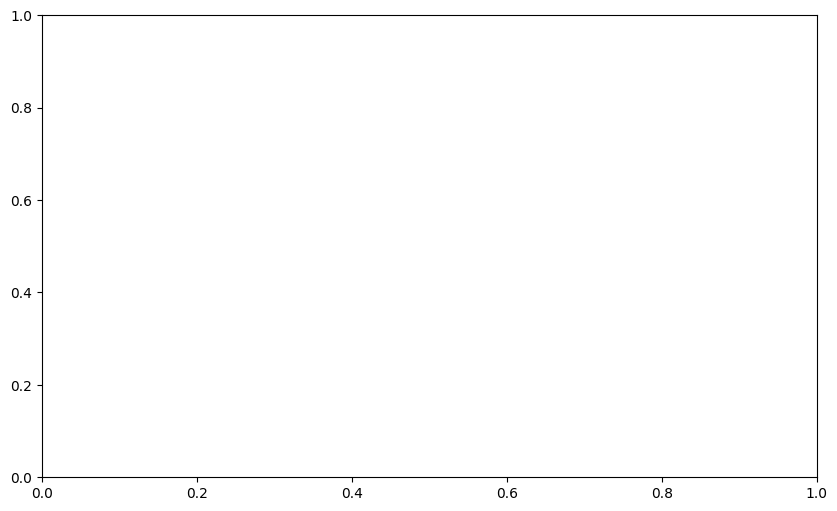

### all epochs

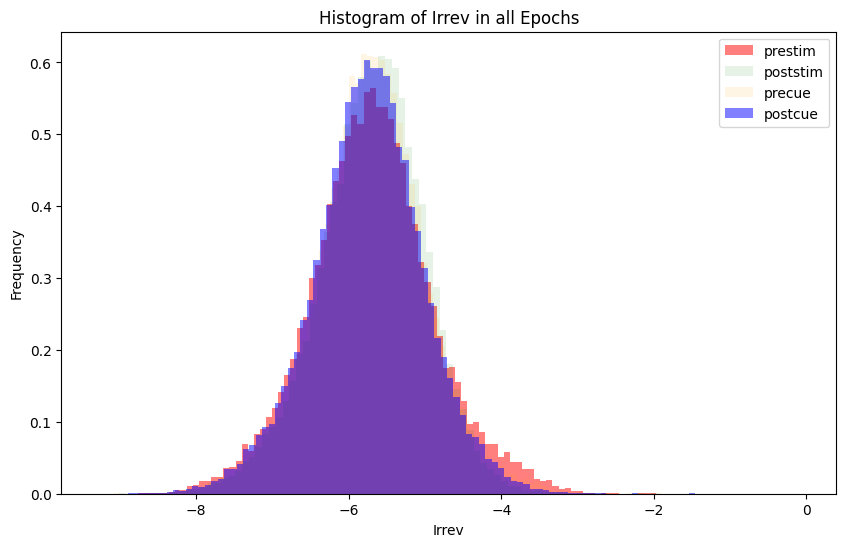

The mean of prestim (raw irrev values): 0.0047552148945395525
The mean of poststim (raw irrev values): 0.004320711276985528
The mean of precue (raw irrev values): 0.004415308502506991
The mean of postcue (raw irrev values): 0.00422061652009948
The median of prestim (raw irrev values): 0.003329921633541834
The median of poststim (raw irrev values): 0.0034825484965825644
The median of precue (raw irrev values): 0.0033645839070559984
The median of postcue (raw irrev values): 0.0032506435207782457
The std dev of prestim (logged irrev values): 0.8071898560403837
The std dev of poststim (logged irrev values): 0.6939591345083789
The std dev of precue (logged irrev values): 0.7274730576933497
The std dev of postcue (logged irrev values): 0.729201497923446


In [154]:

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

plt.hist(behavior['log_prestim'], bins=100, alpha=0.5, label='prestim', color='red', density = True)
plt.hist(behavior['log_poststim'], bins=100, alpha=0.1, label='poststim', color='green', density = True)
plt.hist(behavior['log_precue'], bins=100, alpha=0.1, label='precue', color='orange', density = True)
plt.hist(behavior['log_postcue'], bins=100, alpha=0.5, label='postcue', color='blue', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Irrev in all Epochs')
plt.legend()

# Show the plot
plt.show()

print("The mean of prestim (raw irrev values): "+str(np.mean(behavior['prestim_irrev'])))
print("The mean of poststim (raw irrev values): "+str(np.mean(behavior['poststim_irrev'])))
print("The mean of precue (raw irrev values): "+str(np.mean(behavior['precue_irrev'])))
print("The mean of postcue (raw irrev values): "+str(np.mean(behavior['postcue_irrev'])))

print("The median of prestim (raw irrev values): "+str(np.median(behavior['prestim_irrev'])))
print("The median of poststim (raw irrev values): "+str(np.median(behavior['poststim_irrev'])))
print("The median of precue (raw irrev values): "+str(np.median(behavior['precue_irrev'])))
print("The median of postcue (raw irrev values): "+str(np.median(behavior['postcue_irrev'])))

print("The std dev of prestim (logged irrev values): "+str(np.std(behavior['log_prestim'])))
print("The std dev of poststim (logged irrev values): "+str(np.std(behavior['log_poststim'])))
print("The std dev of precue (logged irrev values): "+str(np.std(behavior['log_precue'])))
print("The std dev of postcue (logged irrev values): "+str(np.std(behavior['log_postcue'])))

scatter

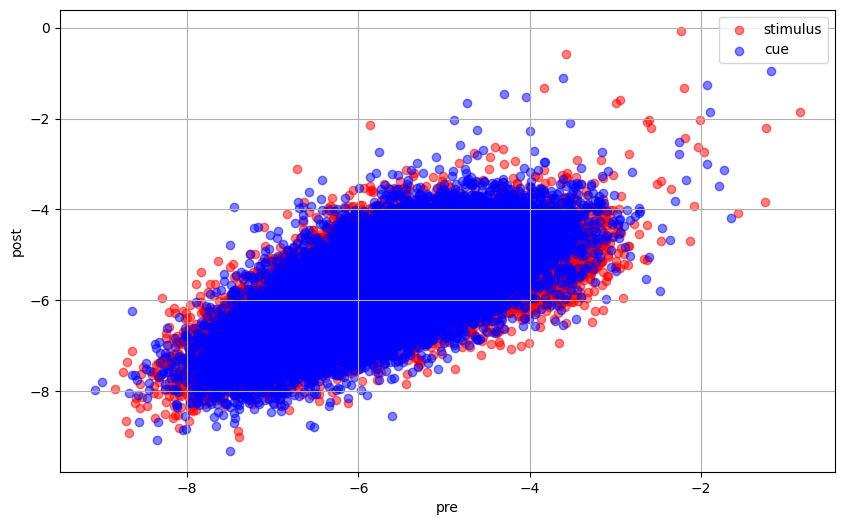

In [155]:
plt.figure(figsize=(10, 6))
plt.scatter(behavior['log_prestim'], behavior['log_poststim'], color = 'red', label = 'stimulus', alpha=0.5)
plt.scatter(behavior['log_precue'], behavior['log_postcue'], color = 'blue', label = 'cue', alpha=0.5)
plt.xlabel('pre')
plt.ylabel('post')
plt.grid(True)
plt.legend()
plt.show()

### by drug

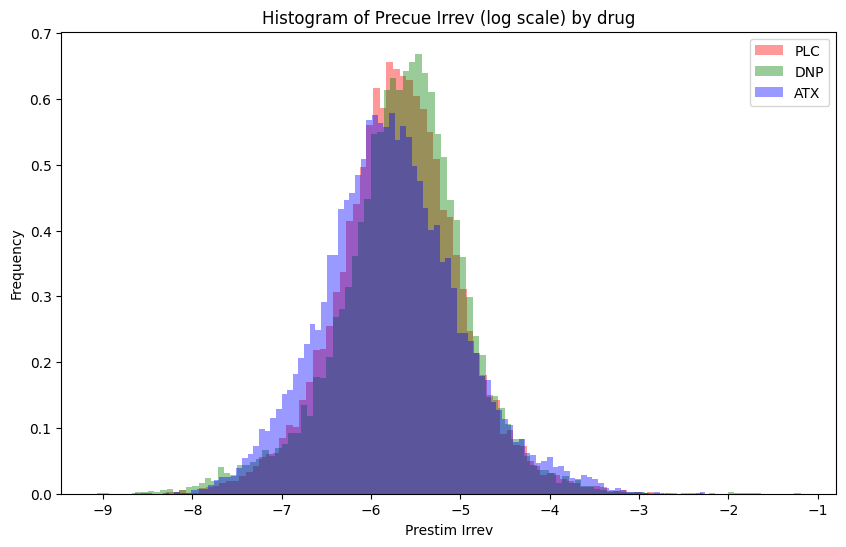

In [173]:
#precue by drug
behavior = df

df_plc = behavior[(behavior['drug'] == 'PLC')]
df_dnp = behavior[(behavior['drug'] == 'DNP')]
df_atx = behavior[(behavior['drug'] == 'ATX')]

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

plt.hist(np.log(df_plc['precue_irrev']), bins=100, alpha=0.4, label='PLC', color='red', density = True)
plt.hist(np.log(df_dnp['precue_irrev']), bins=100, alpha=0.4, label='DNP', color='green', density = True)
plt.hist(np.log(df_atx['precue_irrev']), bins=100, alpha=0.4, label='ATX', color='blue', density = True)

# Adding labels and title
plt.xlabel('Prestim Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Precue Irrev (log scale) by drug')
plt.legend()

# Show the plot
plt.show()


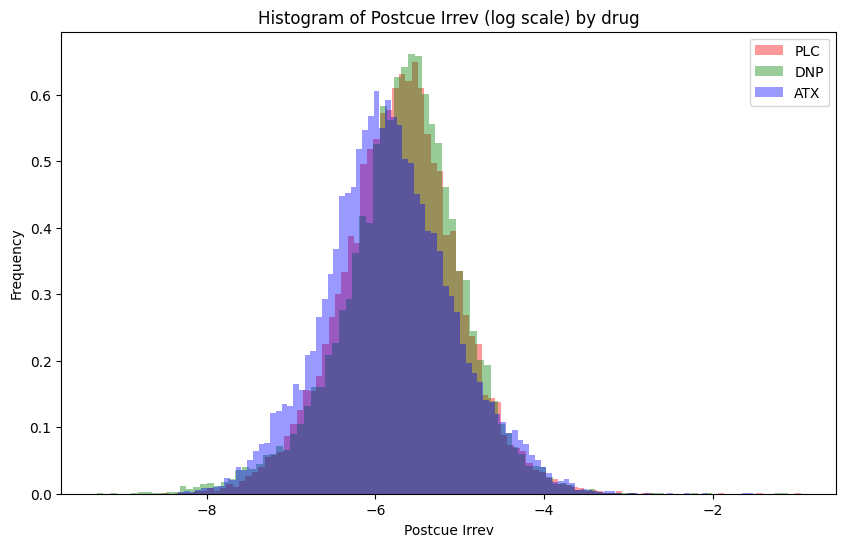

In [178]:
#postcue by drug
behavior = df

df_plc = behavior[(behavior['drug'] == 'PLC')]
df_dnp = behavior[(behavior['drug'] == 'DNP')]
df_atx = behavior[(behavior['drug'] == 'ATX')]

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

plt.hist(np.log(df_plc['postcue_irrev']), bins=100, alpha=0.4, label='PLC', color='red', density = True)
plt.hist(np.log(df_dnp['postcue_irrev']), bins=100, alpha=0.4, label='DNP', color='green', density = True)
plt.hist(np.log(df_atx['postcue_irrev']), bins=100, alpha=0.4, label='ATX', color='blue', density = True)

# Adding labels and title
plt.xlabel('Postcue Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Postcue Irrev (log scale) by drug')
plt.legend()

# Show the plot
plt.show()


## ROI / hemisphere

['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']
left cue associated irrev during left cue (expect higher): 0.011242332986269366
other hemisphere irrev in same (expect lower): 0.011330556820257019
left cue


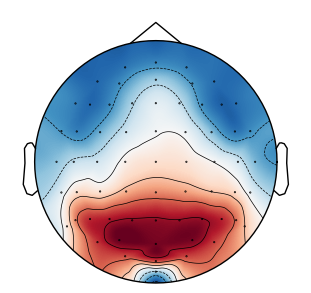

(<matplotlib.image.AxesImage at 0x1d713dc7640>,
 <matplotlib.contour.QuadContourSet at 0x1d713dc7b80>)

In [93]:
from scipy.stats import zscore
behavior = df


left_cue_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left cue
right_cue_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right cue
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_cue_indices = [channels.index(elec) for elec in left_cue_ROI if elec in channels]
right_cue_indices = [channels.index(elec) for elec in right_cue_ROI if elec in channels]

left_cue_irrev = []
contribution_arr = []
for matrix in behavior['postcue_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    contribution_arr.append(contribution)
    left_cue_trial = np.mean(contribution[left_cue_indices])
    left_cue_irrev.append(left_cue_trial)
behavior['left_cue_irrev'] = left_cue_irrev # RIGHT HEMISPHERE
behavior['contributions'] = contribution_arr

right_cue_irrev = []
for matrix in behavior['postcue_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    right_cue_trial = np.mean(contribution[right_cue_indices])
    right_cue_irrev.append(right_cue_trial)
behavior['right_cue_irrev'] = right_cue_irrev  # LEFT HEMISPHERE

print("left cue associated irrev during left cue (expect higher): " + str(np.mean(behavior[behavior['cue'] == 0]['left_cue_irrev'])))
print("other hemisphere irrev in same (expect lower): " + str(np.mean(behavior[behavior['cue'] == 0]['right_cue_irrev'])))


data1 = np.zeros((64, 128)) # Replace with your data
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
channel_locs = montage.get_positions()['ch_pos']
info = mne.create_info(channels, sfreq=128, ch_types='eeg')
info.set_montage(montage) # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)

print("left cue")
leftcue_refmatrix = behavior[behavior['cue'] == 0]['contributions'].mean()
zscore_matrix = zscore(leftcue_refmatrix, axis=None)

mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

In [91]:
from scipy.stats import zscore

left_cue_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left cue
right_cue_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right cue
total_ROI = ['O1', 'PO3', 'PO7', 'O2', 'PO4', 'PO8']
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_cue_indices = [channels.index(elec) for elec in left_cue_ROI if elec in channels]
right_cue_indices = [channels.index(elec) for elec in right_cue_ROI if elec in channels]
total_indices = [channels.index(elec) for elec in total_ROI if elec in channels]

left_cue_irrev = []
contribution_arr = []
total_ROI_arr = []
for matrix in behavior['postcue_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    contribution_arr.append(contribution)
    left_cue_trial = np.mean(contribution[left_cue_indices])
    left_cue_irrev.append(left_cue_trial)
    total_ROI_arr.append(np.mean(contribution[total_indices]))
behavior['left_cue_irrev'] = left_cue_irrev
behavior['contributions'] = contribution_arr
behavior['total_ROI'] = total_ROI_arr

print()

right_cue_irrev = []
for matrix in behavior['postcue_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    right_cue_trial = np.mean(contribution[right_cue_indices])
    right_cue_irrev.append(right_cue_trial)
behavior['right_cue_irrev'] = right_cue_irrev

print("right cue associated irrev during right cue (expect lower): " + str(np.mean(behavior[behavior['cue'] == 1]['left_cue_irrev'])))
print("other hemisphere irrev in same (expect higher): " + str(np.mean(behavior[behavior['cue'] == 1]['right_cue_irrev'])))

print("total ROI avg: " + str(np.mean(behavior[behavior['cue'] == 1]['total_ROI'])))


data1 = np.zeros((64, 128)) # Replace with your data
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
channel_locs = montage.get_positions()['ch_pos']
info = mne.create_info(channels, sfreq=128, ch_types='eeg')
info.set_montage(montage) # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)

print("right cue")
rightcue_refmatrix = behavior[behavior['cue'] == 1]['contributions'].mean()
zscore_matrix = zscore(rightcue_refmatrix, axis=None)

mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']

right cue associated irrev during right cue (expect lower): nan
other hemisphere irrev in same (expect higher): nan
total ROI avg: nan
right cue


TypeError: 'numpy.float64' object does not support item assignment

### stats testing on this:

['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']
left cue associated irrev during left cue (expect higher): 0.014110765916440726
other hemisphere irrev in same (expect lower): 0.01329880953762656
Statistic: 997880780.0, P-value: 0.17977369841694202
mean of CUED: 0.013682441756433919
mean of UNCUED: 0.013809794111038842
median of CUED: 0.006644678995951869
median of UNCUED: 0.006696982471337159


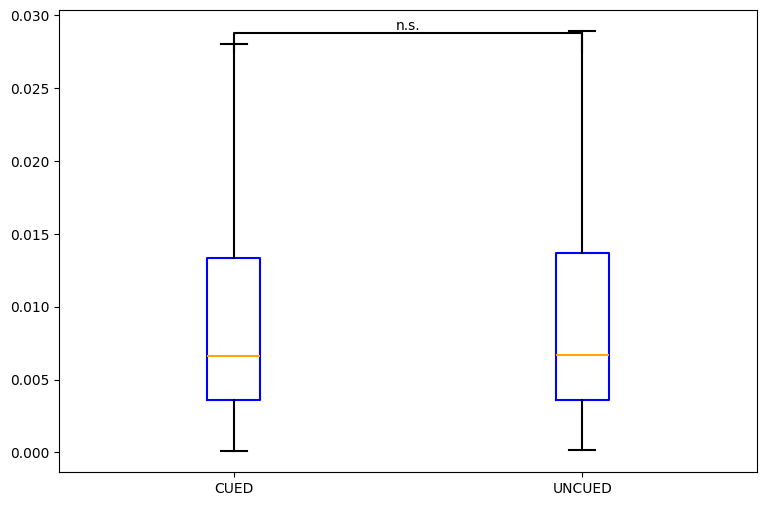

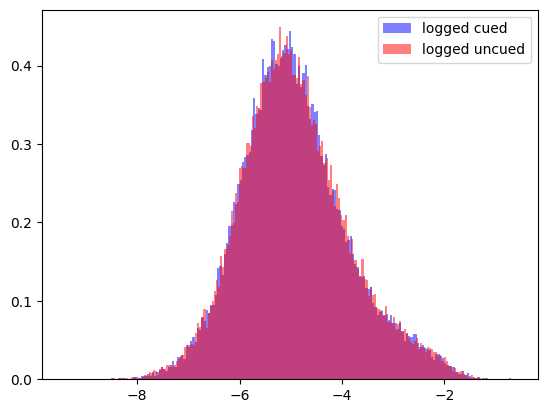

In [76]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
#behavior = behavior[behavior['drug'] == 'ATX']

behavior = df


left_cue_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left cue
right_cue_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right cue
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_cue_indices = [channels.index(elec) for elec in left_cue_ROI if elec in channels]
right_cue_indices = [channels.index(elec) for elec in right_cue_ROI if elec in channels]

left_cue_irrev = []
contribution_arr = []
for matrix in behavior['prestim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    contribution_arr.append(contribution)
    left_cue_trial = np.mean(contribution[left_cue_indices])
    left_cue_irrev.append(left_cue_trial)
behavior['left_cue_irrev'] = left_cue_irrev # RIGHT HEMISPHERE
behavior['contributions'] = contribution_arr

right_cue_irrev = []
for matrix in behavior['prestim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    right_cue_trial = np.mean(contribution[right_cue_indices])
    right_cue_irrev.append(right_cue_trial)
behavior['right_cue_irrev'] = right_cue_irrev  # LEFT HEMISPHERE

print("left cue associated irrev during left cue (expect higher): " + str(np.mean(behavior[behavior['cue'] == 0]['left_cue_irrev'])))
print("other hemisphere irrev in same (expect lower): " + str(np.mean(behavior[behavior['cue'] == 0]['right_cue_irrev'])))

cued_right = behavior[behavior['cue'] == 1]['right_cue_irrev'] 
cued_left = behavior[behavior['cue'] == 0]['left_cue_irrev'] 
pre = np.concatenate((cued_right, cued_left)) #CUED

uncued_right = behavior[behavior['cue'] == 0]['right_cue_irrev']
uncued_left = behavior[behavior['cue'] == 1]['left_cue_irrev']
post = np.concatenate((uncued_right, uncued_left)) #UNCUED


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['CUED', 'UNCUED'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(pre, post)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of CUED: " + str(np.mean(pre)))
print("mean of UNCUED: " + str(np.mean(post)))
print("median of CUED: " + str(np.median(pre)))
print("median of UNCUED: " + str(np.median(post)))

plt.show()

plt.hist(np.log(pre), bins=200, color='blue', alpha=0.5, label='logged cued', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.5, label='logged uncued', density = True)
plt.legend()
plt.show()
#Well shit.

#### poststim

['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']
left cue associated irrev during left cue (expect higher): 0.009798055263577398
other hemisphere irrev in same (expect lower): 0.010101611374532382
Statistic: 1001537716.0, P-value: 0.6917508985793086
mean of stimulusD: 0.009942005787792162
mean of UNstimulusD: 0.009955469158426922
median of stimulusD: 0.007012438718852754
median of UNstimulusD: 0.007030033194881859


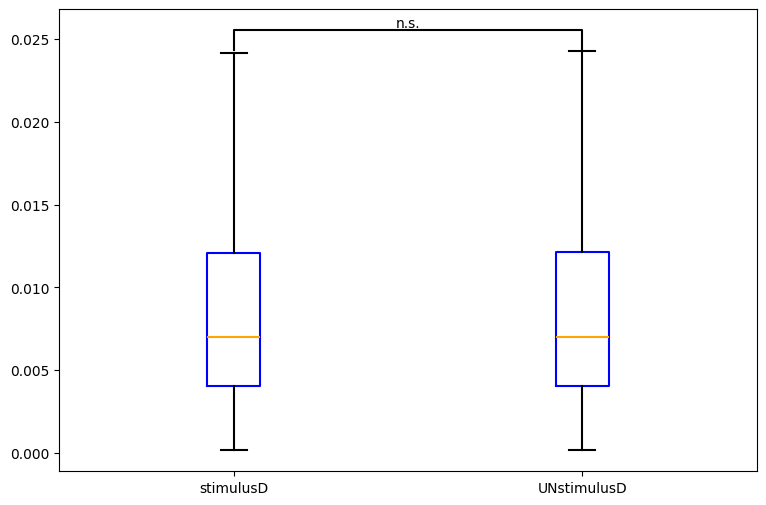

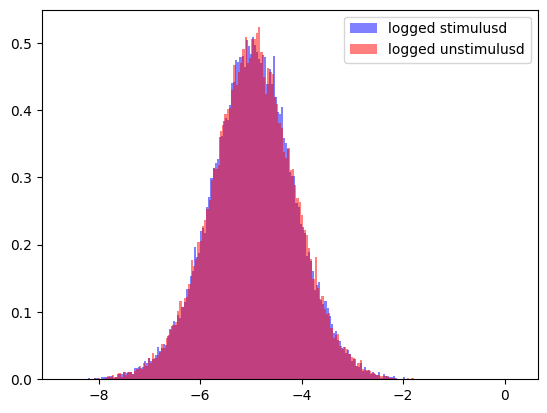

In [79]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
#behavior = behavior[behavior['drug'] == 'ATX']

behavior = df


left_cue_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left cue
right_cue_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right cue
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_cue_indices = [channels.index(elec) for elec in left_cue_ROI if elec in channels]
right_cue_indices = [channels.index(elec) for elec in right_cue_ROI if elec in channels]

left_cue_irrev = []
contribution_arr = []
for matrix in behavior['poststim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    contribution_arr.append(contribution)
    left_cue_trial = np.mean(contribution[left_cue_indices])
    left_cue_irrev.append(left_cue_trial)
behavior['left_stimulus_irrev'] = left_cue_irrev # RIGHT HEMISPHERE
behavior['contributions'] = contribution_arr

right_cue_irrev = []
for matrix in behavior['poststim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    right_cue_trial = np.mean(contribution[right_cue_indices])
    right_cue_irrev.append(right_cue_trial)
behavior['right_stimulus_irrev'] = right_cue_irrev  # LEFT HEMISPHERE

print("left cue associated irrev during left cue (expect higher): " + str(np.mean(behavior[behavior['stimulus'] == 0]['left_stimulus_irrev'])))
print("other hemisphere irrev in same (expect lower): " + str(np.mean(behavior[behavior['stimulus'] == 0]['right_stimulus_irrev'])))

stimulusd_right = behavior[behavior['stimulus'] == 1]['right_stimulus_irrev'] 
stimulusd_left = behavior[behavior['stimulus'] == 0]['left_stimulus_irrev'] 
pre = np.concatenate((stimulusd_right, stimulusd_left)) #stimulusD

unstimulusd_right = behavior[behavior['stimulus'] == 0]['right_stimulus_irrev']
unstimulusd_left = behavior[behavior['stimulus'] == 1]['left_stimulus_irrev']
post = np.concatenate((unstimulusd_right, unstimulusd_left)) #UNstimulusD


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['stimulusD', 'UNstimulusD'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(pre, post)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of stimulusD: " + str(np.mean(pre)))
print("mean of UNstimulusD: " + str(np.mean(post)))
print("median of stimulusD: " + str(np.median(pre)))
print("median of UNstimulusD: " + str(np.median(post)))

plt.show()

plt.hist(np.log(pre), bins=200, color='blue', alpha=0.5, label='logged stimulusd', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.5, label='logged unstimulusd', density = True)
plt.legend()
plt.show()
#Well shit.

#### alpha poststim

44790
['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']
left stimulus associated alpha during left stimulus (expect higher): 2.513618032299163e-05
other hemisphere alpha in same (expect lower): 1.692275941648053e-05
Statistic: 250378426.0, P-value: 0.7763141723493105
mean of stimulusD: 1.6293172549974202e-05
mean of UNstimulusD: 1.692275941648053e-05
median of stimulusD: 4.043675985908935e-06
median of UNstimulusD: 4.00932012887288e-06


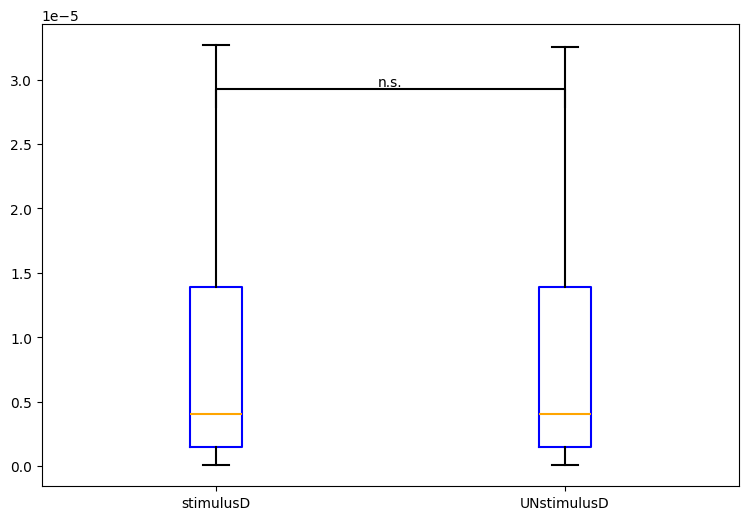

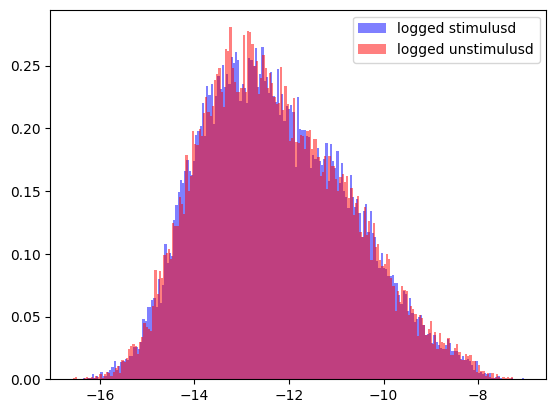

In [111]:


import pandas as pd
import numpy as np
from scipy.stats import rankdata
from statsmodels.formula.api import ols
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore

behavior = df
print(len(behavior))

behavior['poststim_channel_alpha'] = [poststim_channel_alpha[i] for i in range(poststim_channel_alpha.shape[0])]

left_stimulus_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left stimulus
right_stimulus_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right stimulus
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_stimulus_indices = [channels.index(elec) for elec in left_stimulus_ROI if elec in channels]
right_stimulus_indices = [channels.index(elec) for elec in right_stimulus_ROI if elec in channels]

left_stimulus_alpha = []
contribution_arr = []
for matrix in behavior['prestim_channel_alpha']:
    left_stimulus_trial = np.mean(matrix[left_stimulus_indices])
    left_stimulus_alpha.append(left_stimulus_trial)
behavior['left_stimulus_alpha'] = left_stimulus_alpha # RIGHT HEMISPHERE

right_stimulus_alpha = []
for matrix in behavior['prestim_channel_alpha']:
    right_stimulus_trial = np.mean(matrix[right_stimulus_indices])
    right_stimulus_alpha.append(right_stimulus_trial)
behavior['right_stimulus_alpha'] = right_stimulus_alpha  # LEFT HEMISPHERE

print("left stimulus associated alpha during left stimulus (expect higher): " + str(np.mean(behavior[behavior['stimulus'] == 0]['left_stimulus_alpha'])))
print("other hemisphere alpha in same (expect lower): " + str(np.mean(behavior[behavior['stimulus'] == 0]['right_stimulus_alpha'])))




import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
#behavior = behavior[behavior['drug'] == 'PLC']

stimulusd_right = behavior[behavior['stimulus'] == 1]['right_stimulus_alpha']
stimulusd_left = behavior[behavior['stimulus'] == 0]['left_stimulus_alpha']
pre = stimulusd_right #stimulusD

unstimulusd_right = behavior[behavior['stimulus'] == 0]['right_stimulus_alpha']
unstimulusd_left = behavior[behavior['stimulus'] == 1]['left_stimulus_alpha']
post = unstimulusd_right #UNstimulusD


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['stimulusD', 'UNstimulusD'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(pre, post)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of stimulusD: " + str(np.mean(pre)))
print("mean of UNstimulusD: " + str(np.mean(post)))
print("median of stimulusD: " + str(np.median(pre)))
print("median of UNstimulusD: " + str(np.median(post)))

plt.show()

plt.hist(np.log(pre), bins=200, color='blue', alpha=0.5, label='logged stimulusd', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.5, label='logged unstimulusd', density = True)
plt.legend()
plt.show()
#Well shit.

44790
['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']


left cue associated alpha during left cue (expect higher): 2.4067765533754387e-05
other hemisphere alpha in same (expect lower): 1.6634690926618978e-05
Statistic: 244114270.0, P-value: 1.1825310682573978e-06
mean of cueD: 1.6579813967680006e-05
mean of UNcueD: 1.6634690926618978e-05
median of cueD: 3.838781745907596e-06
median of UNcueD: 4.231144231262299e-06


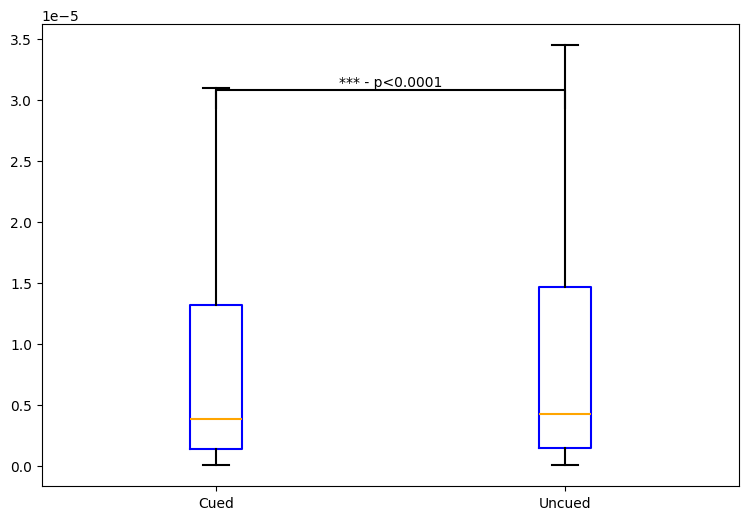

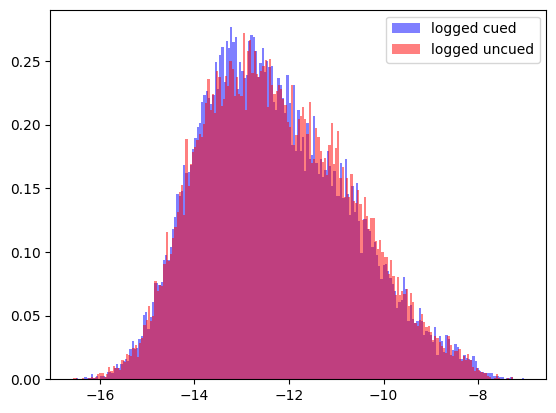

In [113]:


import pandas as pd
import numpy as np
from scipy.stats import rankdata
from statsmodels.formula.api import ols
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore

behavior = df
print(len(behavior))

behavior['poststim_channel_alpha'] = [poststim_channel_alpha[i] for i in range(poststim_channel_alpha.shape[0])]

left_cue_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left cue
right_cue_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right cue
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_cue_indices = [channels.index(elec) for elec in left_cue_ROI if elec in channels]
right_cue_indices = [channels.index(elec) for elec in right_cue_ROI if elec in channels]

left_cue_alpha = []
contribution_arr = []
for matrix in behavior['prestim_channel_alpha']:
    left_cue_trial = np.mean(matrix[left_cue_indices])
    left_cue_alpha.append(left_cue_trial)
behavior['left_cue_alpha'] = left_cue_alpha # RIGHT HEMISPHERE

right_cue_alpha = []
for matrix in behavior['prestim_channel_alpha']:
    right_cue_trial = np.mean(matrix[right_cue_indices])
    right_cue_alpha.append(right_cue_trial)
behavior['right_cue_alpha'] = right_cue_alpha  # LEFT HEMISPHERE

print("left cue associated alpha during left cue (expect higher): " + str(np.mean(behavior[behavior['cue'] == 0]['left_cue_alpha'])))
print("other hemisphere alpha in same (expect lower): " + str(np.mean(behavior[behavior['cue'] == 0]['right_cue_alpha'])))




import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
#behavior = behavior[behavior['drug'] == 'PLC']

cued_right = behavior[behavior['cue'] == 1]['right_cue_alpha']
cued_left = behavior[behavior['cue'] == 0]['left_cue_alpha']
pre = cued_right #cueD

uncued_right = behavior[behavior['cue'] == 0]['right_cue_alpha']
uncued_left = behavior[behavior['cue'] == 1]['left_cue_alpha']
post = uncued_right #UNcueD


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Cued', 'Uncued'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(pre, post)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of cueD: " + str(np.mean(pre)))
print("mean of UNcueD: " + str(np.mean(post)))
print("median of cueD: " + str(np.median(pre)))
print("median of UNcueD: " + str(np.median(post)))

plt.show()

plt.hist(np.log(pre), bins=200, color='blue', alpha=0.5, label='logged cued', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.5, label='logged uncued', density = True)
plt.legend()
plt.show()
#Well shit.

44790
['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']
left cue associated irrev during left cue (expect higher): 0.011242332986269366
other hemisphere irrev in same (expect lower): 0.011330556820257019
left cue


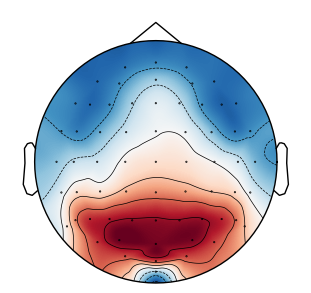

Statistic: 116218450.0, P-value: 0.07951917531256858
mean of CUED: -0.0002372351804532084
mean of UNCUED: 0.0002372351804532098
median of CUED: -0.004936599545495069
median of UNCUED: -0.005046839794510722


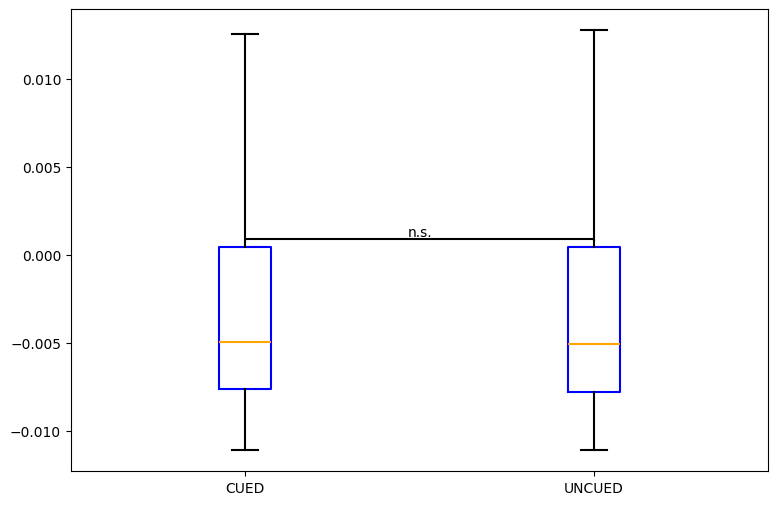

C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\1776201055.py:126: RuntimeWarning: invalid value encountered in log
  plt.hist(np.log(pre), bins=200, color='blue', alpha=0.5, label='logged cued', density = True)
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\1776201055.py:127: RuntimeWarning: invalid value encountered in log
  plt.hist(np.log(post), bins=200, color='red', alpha=0.5, label='logged uncued', density = True)


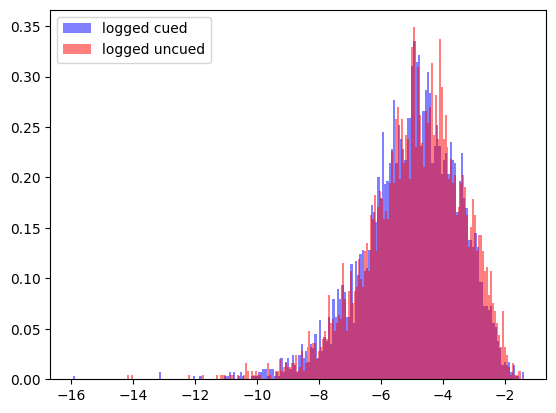

In [108]:
import pandas as pd
import numpy as np
from scipy.stats import rankdata
from statsmodels.formula.api import ols
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore

behavior = df
print(len(behavior))

left_cue_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left cue
right_cue_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right cue
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_cue_indices = [channels.index(elec) for elec in left_cue_ROI if elec in channels]
right_cue_indices = [channels.index(elec) for elec in right_cue_ROI if elec in channels]

left_cue_irrev = []
contribution_arr = []
for matrix in behavior['postcue_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    contribution_arr.append(contribution)
    left_cue_trial = np.mean(contribution[left_cue_indices])
    left_cue_irrev.append(left_cue_trial)
behavior['left_cue_irrev'] = left_cue_irrev # RIGHT HEMISPHERE
behavior['contributions'] = contribution_arr

right_cue_irrev = []
for matrix in behavior['postcue_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    right_cue_trial = np.mean(contribution[right_cue_indices])
    right_cue_irrev.append(right_cue_trial)
behavior['right_cue_irrev'] = right_cue_irrev  # LEFT HEMISPHERE

print("left cue associated irrev during left cue (expect higher): " + str(np.mean(behavior[behavior['cue'] == 0]['left_cue_irrev'])))
print("other hemisphere irrev in same (expect lower): " + str(np.mean(behavior[behavior['cue'] == 0]['right_cue_irrev'])))


data1 = np.zeros((64, 128)) # Replace with your data
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
channel_locs = montage.get_positions()['ch_pos']
info = mne.create_info(channels, sfreq=128, ch_types='eeg')
info.set_montage(montage) # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)

print("left cue")
leftcue_refmatrix = behavior[behavior['cue'] == 0]['contributions'].mean()
zscore_matrix = zscore(leftcue_refmatrix, axis=None)

mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

# Assuming 'behavior' is your DataFrame and it includes the columns: 
# 'subject', 'drug', 'cue', 'right_cue_irrev', 'left_cue_irrev'

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
behavior = behavior[behavior['drug'] == 'ATX']

cued_right = behavior[behavior['cue'] == 1]['right_cue_irrev']-behavior['right_cue_irrev'].mean()
cued_left = behavior[behavior['cue'] == 0]['left_cue_irrev']-behavior['left_cue_irrev'].mean()
pre = np.concatenate((cued_right, cued_left)) #CUED

uncued_right = behavior[behavior['cue'] == 0]['right_cue_irrev']-behavior['right_cue_irrev'].mean()
uncued_left = behavior[behavior['cue'] == 1]['left_cue_irrev']-behavior['left_cue_irrev'].mean()
post = np.concatenate((uncued_right, uncued_left))

print(len(pre))
print(len(post))
# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['CUED', 'UNCUED'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(pre, post)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of CUED: " + str(np.mean(pre)))
print("mean of UNCUED: " + str(np.mean(post)))
print("median of CUED: " + str(np.median(pre)))
print("median of UNCUED: " + str(np.median(post)))

plt.show()

plt.hist(np.log(pre), bins=200, color='blue', alpha=0.5, label='logged cued', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.5, label='logged uncued', density = True)
plt.legend()
plt.show()
#Well shit.


44790
['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']
left cue associated irrev during left cue (expect higher): 0.011242332986269366
other hemisphere irrev in same (expect lower): 0.011330556820257019
left cue


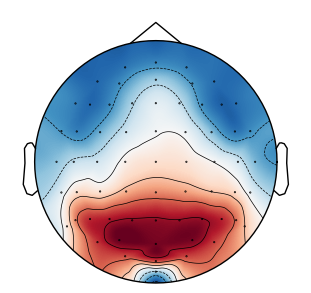

44790
subject            0
drug               0
cue                0
cue_condition      0
irreversibility    0
dtype: int64
cue_condition  drug
cued           ATX     15158
               DNP     14974
               PLC     14658
uncued         ATX     15158
               DNP     14974
               PLC     14658
dtype: int64
       subject drug  cue cue_condition  irreversibility
0            1  DNP    1          cued         0.003050
1            1  DNP    1          cued         0.002442
2            1  DNP    0          cued         0.014389
3            1  DNP    1          cued         0.014436
4            1  DNP    1          cued         0.045365
...        ...  ...  ...           ...              ...
89575       30  PLC    0        uncued         0.009533
89576       30  PLC    0        uncued         0.009056
89577       30  PLC    0        uncued         0.010468
89578       30  PLC    0        uncued         0.004894
89579       30  PLC    1        uncued         0.0090

C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\257519268.py:69: FutureWarning: This dataframe has a column name that matches the 'value_name' column name of the resulting Dataframe. In the future this will raise an error, please set the 'value_name' parameter of DataFrame.melt to a unique name.
  long_df = pd.melt(behavior, id_vars=['subject', 'drug', 'cue'], value_vars=['cued_irrev', 'uncued_irrev'],


                                sum_sq       df           F         PR(>F)
C(cue_condition)          3.013772e+09      1.0    4.530889   3.329105e-02
C(drug)                   3.149435e+11      2.0  236.742216  2.850678e-103
C(cue_condition):C(drug)  4.346865e+09      2.0    3.267527   3.810507e-02
Residual                  5.958116e+13  89574.0         NaN            NaN


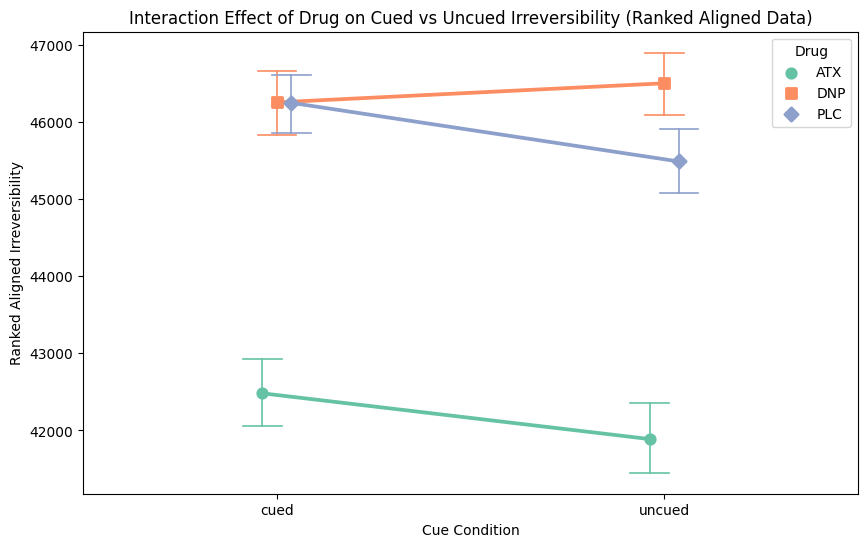

In [44]:
import pandas as pd
import numpy as np
from scipy.stats import rankdata
from statsmodels.formula.api import ols
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore

behavior = df
print(len(behavior))

left_cue_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left cue
right_cue_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right cue
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_cue_indices = [channels.index(elec) for elec in left_cue_ROI if elec in channels]
right_cue_indices = [channels.index(elec) for elec in right_cue_ROI if elec in channels]

left_cue_irrev = []
contribution_arr = []
for matrix in behavior['postcue_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    contribution_arr.append(contribution)
    left_cue_trial = np.mean(contribution[left_cue_indices])
    left_cue_irrev.append(left_cue_trial)
behavior['left_cue_irrev'] = left_cue_irrev # RIGHT HEMISPHERE
behavior['contributions'] = contribution_arr

right_cue_irrev = []
for matrix in behavior['postcue_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    right_cue_trial = np.mean(contribution[right_cue_indices])
    right_cue_irrev.append(right_cue_trial)
behavior['right_cue_irrev'] = right_cue_irrev  # LEFT HEMISPHERE

print("left cue associated irrev during left cue (expect higher): " + str(np.mean(behavior[behavior['cue'] == 0]['left_cue_irrev'])))
print("other hemisphere irrev in same (expect lower): " + str(np.mean(behavior[behavior['cue'] == 0]['right_cue_irrev'])))


data1 = np.zeros((64, 128)) # Replace with your data
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
channel_locs = montage.get_positions()['ch_pos']
info = mne.create_info(channels, sfreq=128, ch_types='eeg')
info.set_montage(montage) # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)

print("left cue")
leftcue_refmatrix = behavior[behavior['cue'] == 0]['contributions'].mean()
zscore_matrix = zscore(leftcue_refmatrix, axis=None)

mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

# Assuming 'behavior' is your DataFrame and it includes the columns: 
# 'subject', 'drug', 'cue', 'right_cue_irrev', 'left_cue_irrev'
print(len(behavior))
# Create the cued and uncued irreversibility values
behavior['cued_irrev'] = np.where(behavior['cue'] == 1, behavior['right_cue_irrev'], behavior['left_cue_irrev'])
behavior['uncued_irrev'] = np.where(behavior['cue'] == 0, behavior['right_cue_irrev'], behavior['left_cue_irrev'])

# Reshape the data to long format
long_df = pd.melt(behavior, id_vars=['subject', 'drug', 'cue'], value_vars=['cued_irrev', 'uncued_irrev'], 
                  var_name='cue_condition', value_name='irreversibility')

# Rename levels for clarity
long_df['cue_condition'] = long_df['cue_condition'].map({'cued_irrev': 'cued', 'uncued_irrev': 'uncued'})

# Check for any missing values or zero-length groups
print(long_df.isnull().sum())
print(long_df.groupby(['cue_condition', 'drug']).size())
print(long_df)

# Drop any rows with missing values
#long_df.dropna(inplace=True)

# Calculate grand mean
grand_mean = long_df['irreversibility'].mean()

# Calculate marginal means
cue_means = long_df.groupby('cue_condition')['irreversibility'].mean()
drug_means = long_df.groupby('drug')['irreversibility'].mean()
interaction_means = long_df.groupby(['cue_condition', 'drug'])['irreversibility'].mean()

# Align the data
def align_data(row):
    cue_mean = cue_means[row['cue_condition']]
    drug_mean = drug_means[row['drug']]
    interaction_mean = interaction_means[row['cue_condition'], row['drug']]
    aligned_value = row['irreversibility'] - cue_mean - drug_mean + interaction_mean + grand_mean
    return aligned_value

long_df['aligned_irreversibility'] = long_df.apply(align_data, axis=1)
# Rank the aligned data
long_df['ranked_aligned_irreversibility'] = rankdata(long_df['aligned_irreversibility'])
# Ensure all categorical variables are treated correctly
long_df['cue_condition'] = long_df['cue_condition'].astype('category')
long_df['drug'] = long_df['drug'].astype('category')

# Perform ANOVA on ranked aligned data
model = ols('ranked_aligned_irreversibility ~ C(cue_condition) * C(drug)', data=long_df).fit()
anova_table = sm.stats.anova_lm(model, typ=2)
print(anova_table)
# Plot the interaction
plt.figure(figsize=(10, 6))
sns.pointplot(data=long_df, x='cue_condition', y='ranked_aligned_irreversibility', hue='drug', dodge=True, markers=['o', 's', 'D'], capsize=.1, errwidth=1.2, palette='Set2')
plt.title('Interaction Effect of Drug on Cued vs Uncued Irreversibility (Ranked Aligned Data)')
plt.xlabel('Cue Condition')
plt.ylabel('Ranked Aligned Irreversibility')
plt.legend(title='Drug')
plt.show()


In [45]:
from scipy.stats import wilcoxon
from itertools import combinations
from statsmodels.stats.multitest import multipletests

# Define a function for pairwise Wilcoxon tests
def pairwise_wilcoxon(df, group_var1, group_var2, value_var):
    results = []
    groups = df[group_var1].unique()
    for g1, g2 in combinations(groups, 2):
        for g in df[group_var2].unique():
            group1 = df[(df[group_var1] == g1) & (df[group_var2] == g)][value_var]
            group2 = df[(df[group_var1] == g2) & (df[group_var2] == g)][value_var]
            stat, p = wilcoxon(group1, group2)
            results.append((g, g1, g2, stat, p))
    return results

# Perform pairwise comparisons for cue_condition within each drug
pairwise_results = pairwise_wilcoxon(long_df, 'cue_condition', 'drug', 'ranked_aligned_irreversibility')

# Adjust p-values for multiple comparisons
p_values = [result[4] for result in pairwise_results]
_, corrected_p_values, _, _ = multipletests(p_values, method='bonferroni')

# Display the results
for i, (drug, cue1, cue2, stat, p) in enumerate(pairwise_results):
    print(f"Drug: {drug}, Cue Comparison: {cue1} vs {cue2}, Wilcoxon stat: {stat}, Raw p-value: {p}, Corrected p-value: {corrected_p_values[i]}")


Drug: DNP, Cue Comparison: cued vs uncued, Wilcoxon stat: 55108924.0, Raw p-value: 0.07251152364845904, Corrected p-value: 0.21753457094537715
Drug: PLC, Cue Comparison: cued vs uncued, Wilcoxon stat: 51965896.0, Raw p-value: 0.000626815666535199, Corrected p-value: 0.0018804469996055969
Drug: ATX, Cue Comparison: cued vs uncued, Wilcoxon stat: 55927754.0, Raw p-value: 0.004858802964914416, Corrected p-value: 0.014576408894743249


Statistic: 27219000.0, P-value: 0.1055128184310828
mean of CUED: 0.011291106419284975
mean of UNCUED: 0.01128335669792155
median of CUED: 0.006901591799305927
median of UNCUED: 0.00678888364936641


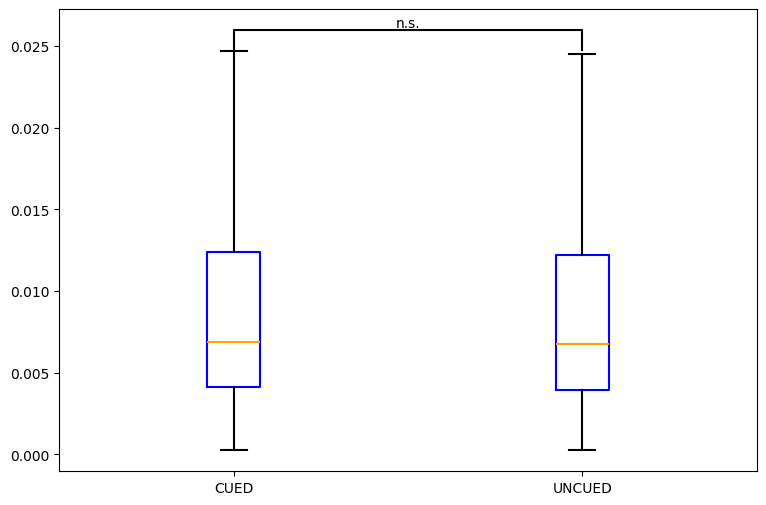

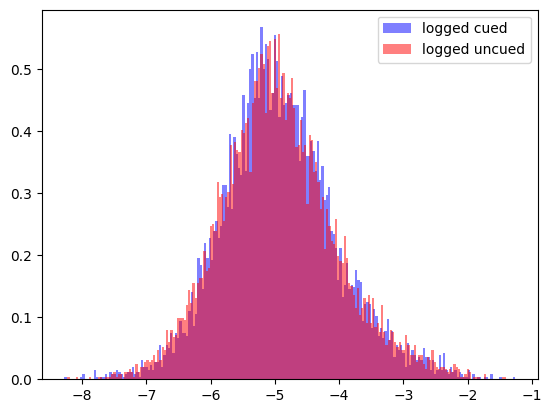

In [87]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
#behavior = behavior[behavior['drug'] == 'PLC']

cued_right = behavior[behavior['cue'] == 1]['right_cue_irrev']
cued_left = behavior[behavior['cue'] == 0]['left_cue_irrev']
pre = cued_right #CUED

uncued_right = behavior[behavior['cue'] == 0]['right_cue_irrev']
uncued_left = behavior[behavior['cue'] == 1]['left_cue_irrev']
post = uncued_right #UNCUED


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['CUED', 'UNCUED'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(pre, post)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of CUED: " + str(np.mean(pre)))
print("mean of UNCUED: " + str(np.mean(post)))
print("median of CUED: " + str(np.median(pre)))
print("median of UNCUED: " + str(np.median(post)))

plt.show()

plt.hist(np.log(pre), bins=200, color='blue', alpha=0.5, label='logged cued', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.5, label='logged uncued', density = True)
plt.legend()
plt.show()
#Well shit.

### ALPHA

44790


['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']
left cue associated alpha during left cue (expect higher): 2.4067765533754387e-05
other hemisphere alpha in same (expect lower): 1.6634690926618978e-05
right cue associated alpha during right cue (expect higher): 1.6579813967680006e-05
other hemisphere alpha in same (expect lower): 2.6281870095804147e-05
Statistic: 244114270.0, P-value: 1.1825310682573978e-06
mean of CUED: 1.6579813967680006e-05
mean of UNCUED: 1.6634690926618978e-05
median of CUED: 3.838781745907596e-06
median of UNCUED: 4.231144231262299e-06


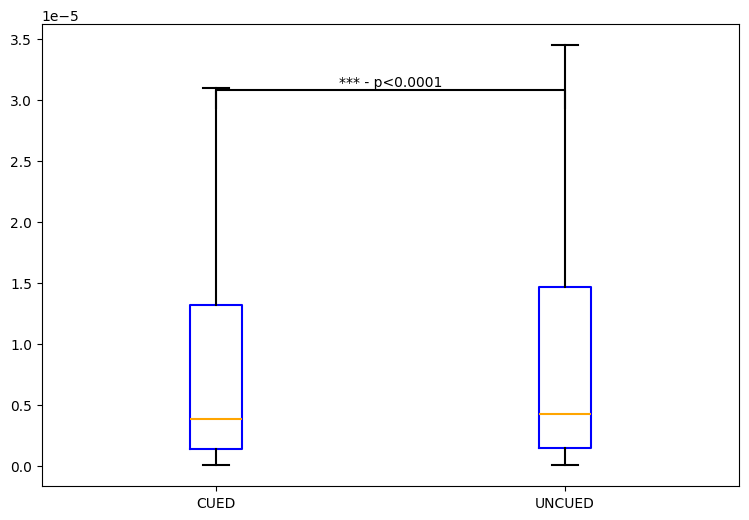

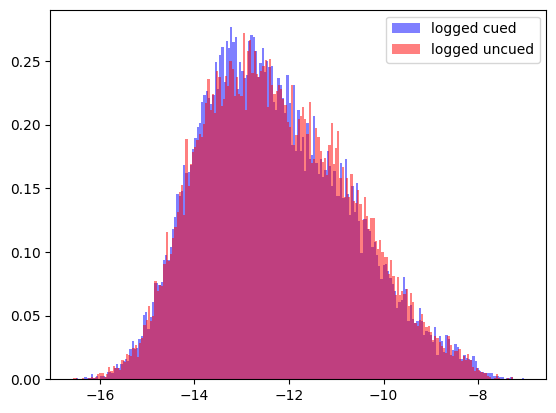

In [13]:


import pandas as pd
import numpy as np
from scipy.stats import rankdata
from statsmodels.formula.api import ols
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore

behavior = df
print(len(behavior))

behavior['prestim_channel_alpha'] = [prestim_channel_alpha[i] for i in range(prestim_channel_alpha.shape[0])]

left_cue_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left cue
right_cue_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right cue
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_cue_indices = [channels.index(elec) for elec in left_cue_ROI if elec in channels]
right_cue_indices = [channels.index(elec) for elec in right_cue_ROI if elec in channels]

left_cue_alpha = []
contribution_arr = []
for matrix in behavior['prestim_channel_alpha']:
    left_cue_trial = np.mean(matrix[left_cue_indices])
    left_cue_alpha.append(left_cue_trial)
behavior['left_cue_alpha'] = left_cue_alpha # RIGHT HEMISPHERE

right_cue_alpha = []
for matrix in behavior['prestim_channel_alpha']:
    right_cue_trial = np.mean(matrix[right_cue_indices])
    right_cue_alpha.append(right_cue_trial)
behavior['right_cue_alpha'] = right_cue_alpha  # LEFT HEMISPHERE

print("left cue associated alpha during left cue (expect higher): " + str(np.mean(behavior[behavior['cue'] == 0]['left_cue_alpha'])))
print("other hemisphere alpha in same (expect lower): " + str(np.mean(behavior[behavior['cue'] == 0]['right_cue_alpha'])))
print("right cue associated alpha during right cue (expect higher): " + str(np.mean(behavior[behavior['cue'] == 1]['right_cue_alpha'])))
print("other hemisphere alpha in same (expect lower): " + str(np.mean(behavior[behavior['cue'] == 1]['left_cue_alpha'])))




import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
#behavior = behavior[behavior['drug'] == 'PLC']

cued_right = behavior[behavior['cue'] == 1]['right_cue_alpha']
cued_left = behavior[behavior['cue'] == 0]['left_cue_alpha']
pre = cued_right #CUED

uncued_right = behavior[behavior['cue'] == 0]['right_cue_alpha']
uncued_left = behavior[behavior['cue'] == 1]['left_cue_alpha']
post = uncued_right #UNCUED


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['CUED', 'UNCUED'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(pre, post)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of CUED: " + str(np.mean(pre)))
print("mean of UNCUED: " + str(np.mean(post)))
print("median of CUED: " + str(np.median(pre)))
print("median of UNCUED: " + str(np.median(post)))

plt.show()

plt.hist(np.log(pre), bins=200, color='blue', alpha=0.5, label='logged cued', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.5, label='logged uncued', density = True)
plt.legend()
plt.show()
#Well shit.

44790
['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']
[63, 62, 61, 26, 25, 24]


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\3547195430.py:40: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['bl_pupil_bin'] = behavior.groupby(['subject', 'drug', 'block'])['ROI_alpha'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\3547195430.py:54: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  print(behavior.groupby('bl_pupil_bin').mean()['ROI_alpha'

bl_pupil_bin
0    6.616208e-07
1    1.107274e-06
2    1.558218e-06
3    2.251822e-06
4    4.668772e-06
Name: ROI_alpha, dtype: float64


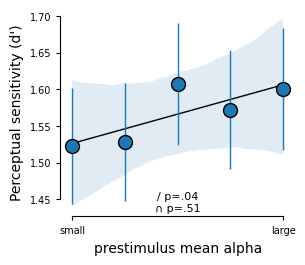

In [66]:
# ALL DRUGS





import pandas as pd
import numpy as np
from scipy.stats import rankdata
from statsmodels.formula.api import ols
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore

behavior = df
print(len(behavior))

behavior['prestim_channel_alpha'] = [prestim_channel_alpha[i] for i in range(prestim_channel_alpha.shape[0])]

alpha_ROI = ['O2', 'PO4', 'PO8', 'O1', 'PO3', 'PO7'] #right hemisphere processing for left cue

montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

alpha_ROI_indices = [channels.index(elec) for elec in alpha_ROI if elec in channels]
print(alpha_ROI_indices)

alpha_power_bytrial = []

for matrix in behavior['prestim_channel_alpha']:
    alpha = np.mean(matrix[alpha_ROI_indices])
    alpha_power_bytrial.append(alpha)
behavior['ROI_alpha'] = alpha_power_bytrial # RIGHT HEMISPHERE



cfg = {'n_bins': 5}  # Number of pupil bins
behavior['bl_pupil_bin'] = behavior.groupby(['subject', 'drug', 'block'])['ROI_alpha'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['ROI_alpha'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject','drug','bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin']).mean()
df_subject.reset_index(inplace=True)

print(behavior.groupby('bl_pupil_bin').mean()['ROI_alpha'])

betas_first = dict()
_, betas_first['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(1),('d')), 0)
betas_second = dict()
_, betas_second['d'] = sp.stats.ttest_1samp(df_subject.groupby(['subject']).apply(run_model_pupilbin,(2),('d')), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt.groupby('bl_pupil_bin').mean()['d']
yerr = df_sdt.groupby('bl_pupil_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first['d']
p_val_quadratic = betas_second['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject, x="bl_pupil_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first['d']),
                                        p_val_string(betas_second['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('prestimulus mean alpha')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

trying another way

0        0.003050
1        0.002442
3        0.014436
4        0.045365
6        0.024167
           ...   
44778    0.015109
44781    0.010173
44782    0.011187
44784    0.009951
44789    0.003740
Name: right_cue_irrev, Length: 22283, dtype: float64
(44790,)
Statistic: 1011184709.0, P-value: 0.036050722386570255
mean of CUED: 0.01106547762607593
mean of UNCUED: 0.011554058257164926
median of CUED: 0.00679659129097338
median of UNCUED: 0.006676682640138581


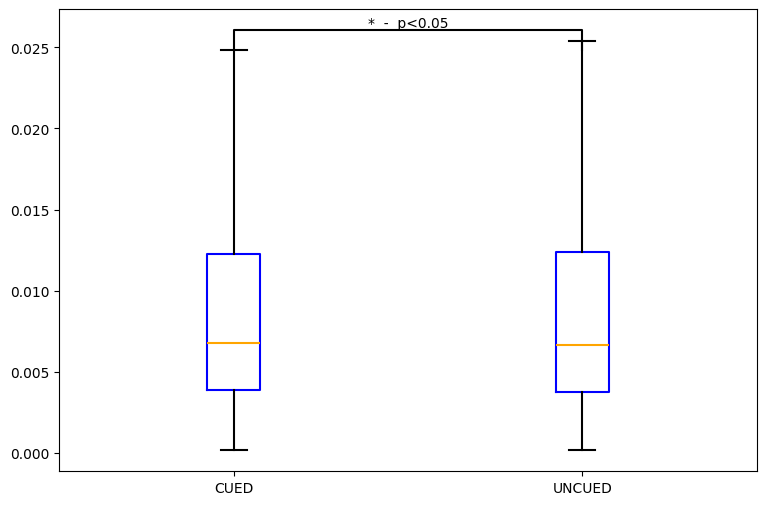

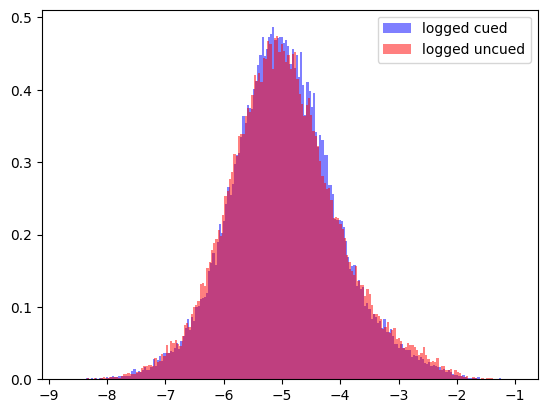

In [159]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
behavior = behavior

#pre = np.concatenate((df[df['cue'] == 1]['right_cue_irrev']),(df[df['cue'] == 0]['left_cue_irrev']))
print(behavior[behavior['cue'] == 1]['right_cue_irrev']) #CUED HEMISPHERE

pre = pd.concat([behavior[behavior['cue'] == 1]['right_cue_irrev'], behavior[behavior['cue'] == 0]['left_cue_irrev']]).to_numpy()
post = pd.concat([behavior[behavior['cue'] == 0]['right_cue_irrev'], behavior[behavior['cue'] == 1]['left_cue_irrev']]).to_numpy()

print(post.shape) #UNCUED HEMISPHERE


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['CUED', 'UNCUED'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(pre, post)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of CUED: " + str(np.mean(pre)))
print("mean of UNCUED: " + str(np.mean(post)))
print("median of CUED: " + str(np.median(pre)))
print("median of UNCUED: " + str(np.median(post)))

plt.show()

plt.hist(np.log(pre), bins=200, color='blue', alpha=0.5, label='logged cued', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.5, label='logged uncued', density = True)
plt.legend()
plt.show()
#Well shit.

### avg post cue

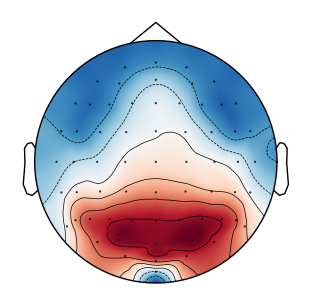

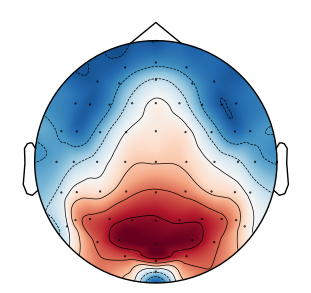

(<matplotlib.image.AxesImage at 0x222e35acb50>,
 <matplotlib.contour.QuadContourSet at 0x222e35aceb0>)

In [160]:

zscore_matrix = zscore(behavior['contributions'].mean(), axis=None)
behavior['ratio'] = behavior['contributions']/behavior['postcue_irrev']
zscore_matrix1 = zscore((behavior[behavior['cue'] == 0]['ratio'][].mean() - behavior['ratio'].mean())
zscore_matrix1 = zscore(behavior['ratio'].mean(), axis=None)

mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)
mne.viz.plot_topomap(zscore_matrix1, raw.info, res = 400, size = 3)

### cue left related - avg for cue

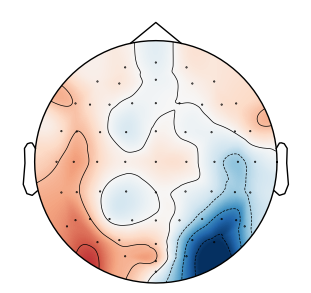

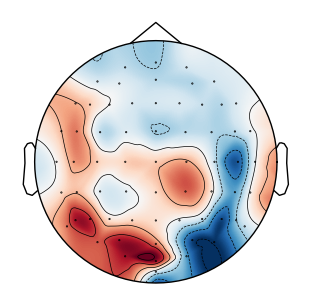

(<matplotlib.image.AxesImage at 0x222e3b7d430>,
 <matplotlib.contour.QuadContourSet at 0x222e3b7d790>)

In [161]:
leftminusavg_refmatrix = leftcue_refmatrix - behavior['contributions'].mean()
zscore_matrix = zscore(leftminusavg_refmatrix, axis=None)
zscore_matrix1 = zscore((behavior[behavior['cue'] == 0]['ratio'][].mean() - behavior['ratio'].mean()), axis=None)

mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)
mne.viz.plot_topomap(zscore_matrix1, raw.info, res = 400, size = 3)

### right cue - avg postcue contributions!!

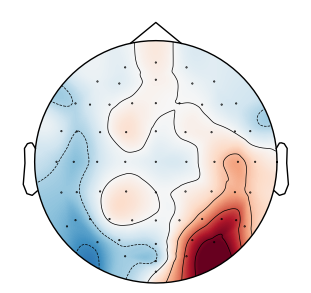

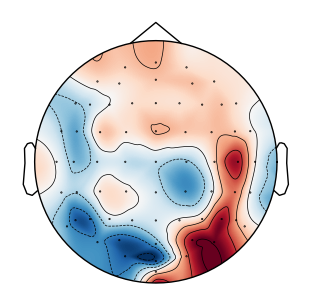

(<matplotlib.image.AxesImage at 0x222e3c32070>,
 <matplotlib.contour.QuadContourSet at 0x222e3c0fdc0>)

In [162]:
rightminusavg_refmatrix =  rightcue_refmatrix - behavior['contributions'].mean()
zscore_matrix = zscore(rightminusavg_refmatrix, axis=None)

zscore_matrix1 = zscore((behavior[behavior['cue'] == 1]['ratio'].mean() - behavior['ratio'].mean()), axis=None)

mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)
mne.viz.plot_topomap(zscore_matrix1, raw.info, res = 400, size = 3)

### prestimulus?

['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']
left cue associated irrev during left cue (expect higher): 0.014027789206372066
other hemisphere irrev in same (expect lower): 0.011161431129927103
left stimulus


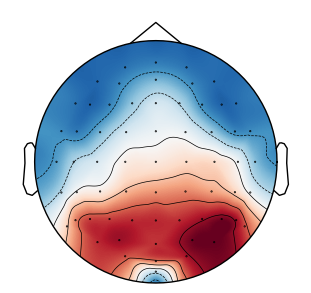

right stimulus


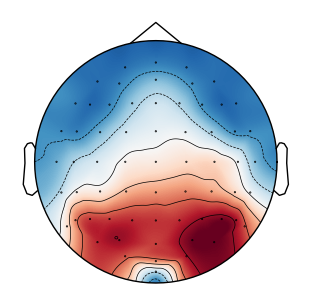

avg


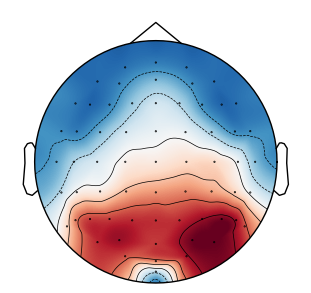

leftstim - avg: 


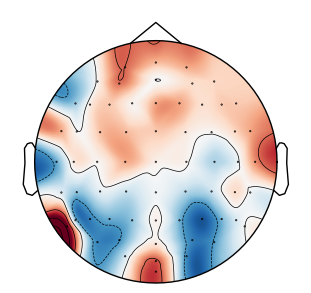

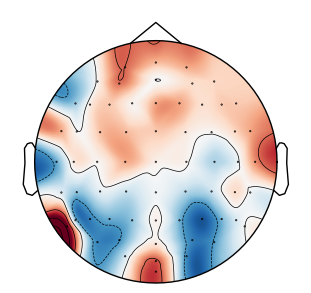

rightstim - avg: 


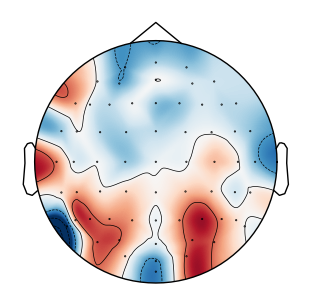

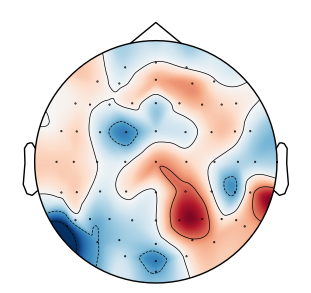

(<matplotlib.image.AxesImage at 0x222efbad580>,
 <matplotlib.contour.QuadContourSet at 0x222efbad340>)

In [183]:
from scipy.stats import zscore
behavior = df

left_cue_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left cue
right_cue_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right cue
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_cue_indices = [channels.index(elec) for elec in left_cue_ROI if elec in channels]
right_cue_indices = [channels.index(elec) for elec in right_cue_ROI if elec in channels]

contribution_arr = []
left_cue_irrev = []
for matrix in behavior['prestim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    contribution_arr.append(contribution)
    left_cue_trial = np.mean(contribution[left_cue_indices])
    left_cue_irrev.append(left_cue_trial)
behavior['left_cue_irrev'] = left_cue_irrev # RIGHT HEMISPHERE
behavior['prestim_contributions'] = contribution_arr

right_cue_irrev = []
for matrix in behavior['postcue_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    right_cue_trial = np.mean(contribution[right_cue_indices])
    right_cue_irrev.append(right_cue_trial)
behavior['right_cue_irrev'] = right_cue_irrev  # LEFT HEMISPHERE

print("left cue associated irrev during left cue (expect higher): " + str(np.mean(behavior[behavior['location'] == 0]['left_cue_irrev'])))
print("other hemisphere irrev in same (expect lower): " + str(np.mean(behavior[behavior['location'] == 0]['right_cue_irrev'])))

data1 = np.zeros((64, 128)) # Replace with your data
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
channel_locs = montage.get_positions()['ch_pos']
info = mne.create_info(channels, sfreq=128, ch_types='eeg')
info.set_montage(montage) # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)

behavior['prestim_ratio'] = behavior['prestim_contributions']/behavior['prestim_irrev']

print("left stimulus")
leftcue_refmatrix = behavior[behavior['location'] == 0]['prestim_contributions'].mean()
zscore_matrix = zscore(leftcue_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)


print("right stimulus")
rightcue_refmatrix = behavior[behavior['location'] == 1]['prestim_contributions'].mean()
zscore_matrix = zscore(rightcue_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)


print("avg")
zscore_matrix = zscore(behavior['prestim_contributions'].mean(), axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

print("leftstim - avg: ")
leftminusavg_refmatrix = leftcue_refmatrix - behavior['prestim_contributions'].mean()
zscore_matrix = zscore(leftminusavg_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

zscore_matrix1 = zscore((behavior[behavior['location'] == 0]['prestim_ratio'].mean() - behavior['prestim_ratio'].mean()), axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)


print("rightstim - avg: ")
rightminusavg_refmatrix =  rightcue_refmatrix - behavior['prestim_contributions'].mean()
zscore_matrix = zscore(rightminusavg_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

zscore_matrix1 = zscore((behavior[behavior['location'] == 1]['prestim_ratio'].mean() - behavior['prestim_ratio'].mean()), axis=None)
mne.viz.plot_topomap(zscore_matrix1, raw.info, res = 400, size = 3)

## Cue validity enhanced by post-cue irrev?

In [163]:
import statsmodels.api as sm
import statsmodels.formula.api as smf

behavior['irreversibility'] = behavior['postcue_irrev']

#drug = 'PLC'

#behavior = behavior[(behavior['drug'] == drug)]

cfg = dict()
cfg['n_bins'] = 5 # Number of bins, same as for pupil size

# Bin 'irreversibility' into quantiles within each subject and drug condition
behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

# Now calculate SDT measures for each subject, drug, and irreversibility bin
df_sdt = behavior.groupby(['subject','drug','cue_val','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

# Check for empty cells as before
print('The amount of empty cells is : {}'.format((np.inf == df_sdt['d']).sum()))

df_sdt = df_sdt.reset_index()

print(df_sdt['cue_val'].unique)

print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])


# Assuming 'df_sdt' is your DataFrame with the required columns: 'd_prime', 'cue_val', 'bl_pupil_bin', and 'subject'

# Fit a mixed-effects model
model = smf.mixedlm("d ~ cue_val * irreversibility_bin", data=df_sdt, groups=df_sdt['subject'], re_formula="~1")
result = model.fit()

# Print the summary of the model to see the coefficients and interaction effects
result.summary()


C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\2061553361.py:14: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irreversibility'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


The amount of empty cells is : 0
<bound method Series.unique of 0      0
1      0
2      0
3      0
4      0
      ..
835    1
836    1
837    1
838    1
839    1
Name: cue_val, Length: 840, dtype: int64>
irreversibility_bin
0    0.001838
1    0.002756
2    0.003586
3    0.004706
4    0.008215
Name: irreversibility, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\2061553361.py:26: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  print(behavior.groupby('irreversibility_bin').mean()['irreversibility'])


<class 'statsmodels.iolib.summary2.Summary'>
"""
                Mixed Linear Model Regression Results
======================================================================
Model:                 MixedLM      Dependent Variable:      d        
No. Observations:      840          Method:                  REML     
No. Groups:            28           Scale:                   0.3622   
Min. group size:       30           Log-Likelihood:          -819.8505
Max. group size:       30           Converged:               Yes      
Mean group size:       30.0                                           
----------------------------------------------------------------------
                            Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------
Intercept                    1.265    0.121 10.467 0.000  1.028  1.502
cue_val                      0.372    0.072  5.169 0.000  0.231  0.513
irreversibility_bin         -0.002    0.021 -0.110 0.912 -0.043  0.038
cue_val:irreversibility_bin  0.006    0.029  0.205 0.838 -0.052  0.064
Group Var                    0.337    0.160                           
======================================================================

"""

In [164]:

mod = smf.glm(formula= 'd ~ cue_val * irreversibility_bin', data= df_sdt)

res = mod.fit()

print(res.summary())


                 Generalized Linear Model Regression Results                  
Dep. Variable:                      d   No. Observations:                  840
Model:                            GLM   Df Residuals:                      836
Model Family:                Gaussian   Df Model:                            3
Link Function:               Identity   Scale:                         0.68834
Method:                          IRLS   Log-Likelihood:                -1033.0
Date:                Sat, 18 May 2024   Deviance:                       575.45
Time:                        01:13:23   Pearson chi2:                     575.
No. Iterations:                     3   Pseudo R-squ. (CS):            0.05213
Covariance Type:            nonrobust                                         
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
Intercept         

In [165]:

import statsmodels.api as sm
from statsmodels.formula.api import ols

behavior = behavior

model = ols('correct ~ postcue_irrev * cue_val', data=behavior).fit()
anova_table = sm.stats.anova_lm(model, typ=2)

# Print the ANOVA table
print(anova_table)

                            sum_sq       df           F        PR(>F)
postcue_irrev             3.323690      1.0   18.870882  1.401787e-05
cue_val                  18.911168      1.0  107.371745  3.939889e-25
postcue_irrev:cue_val     0.009497      1.0    0.053923  8.163739e-01
Residual               7888.067642  44786.0         NaN           NaN


In [166]:
import statsmodels.formula.api as smf

behavior = behavior

# Fit a linear mixed-effects model
model = smf.mixedlm('correct ~ postcue_irrev * cue_val', data=behavior, groups=behavior['subject'])
result = model.fit()

# Print the summary of the model
print(result.summary())

             Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   correct    
No. Observations:    44790     Method:               REML       
No. Groups:          28        Scale:                0.1688     
Min. group size:     1081      Log-Likelihood:       -23781.2349
Max. group size:     1791      Converged:            Yes        
Mean group size:     1599.6                                     
----------------------------------------------------------------
                      Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------
Intercept              0.729    0.018 41.196 0.000  0.694  0.764
postcue_irrev         -0.156    1.147 -0.136 0.892 -2.404  2.092
cue_val                0.054    0.007  7.707 0.000  0.040  0.068
postcue_irrev:cue_val -0.417    1.196 -0.349 0.727 -2.761  1.927
Group Var              0.008    0.005                           



c:\Users\jaket\anaconda3\envs\deco1\lib\site-packages\statsmodels\regression\mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


In [167]:
import statsmodels.formula.api as smf

behavior = df

# Fit a linear mixed-effects model
model = smf.mixedlm('correct ~ log_postcue * cue_val', data=behavior, groups=behavior['subject'])
result = model.fit()

# Print the summary of the model
print(result.summary())

            Mixed Linear Model Regression Results
Model:               MixedLM  Dependent Variable:  correct    
No. Observations:    44790    Method:              REML       
No. Groups:          28       Scale:               0.1688     
Min. group size:     1081     Log-Likelihood:      -23792.0767
Max. group size:     1791     Converged:           Yes        
Mean group size:     1599.6                                   
--------------------------------------------------------------
                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------
Intercept            0.722    0.040 17.950 0.000  0.644  0.801
log_postcue         -0.001    0.006 -0.161 0.872 -0.013  0.011
cue_val              0.056    0.039  1.449 0.147 -0.020  0.132
log_postcue:cue_val  0.001    0.007  0.098 0.922 -0.012  0.014
Group Var            0.008    0.005                           



c:\Users\jaket\anaconda3\envs\deco1\lib\site-packages\statsmodels\regression\mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


In [184]:
import statsmodels.formula.api as smf

behavior = df

# Fit a linear mixed-effects model
model = smf.mixedlm('correct ~ cue_diff * cue_val', data=behavior, groups=behavior['subject'])
result = model.fit()

# Print the summary of the model
print(result.summary())

           Mixed Linear Model Regression Results
Model:              MixedLM Dependent Variable: correct    
No. Observations:   44790   Method:             REML       
No. Groups:         28      Scale:              0.1688     
Min. group size:    1081    Log-Likelihood:     -23778.2821
Max. group size:    1791    Converged:          Yes        
Mean group size:    1599.6                                 
-----------------------------------------------------------
                 Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-----------------------------------------------------------
Intercept         0.729    0.017 42.760 0.000  0.696  0.762
cue_diff          2.929    1.054  2.780 0.005  0.864  4.994
cue_val           0.052    0.005 10.581 0.000  0.042  0.061
cue_diff:cue_val -3.011    1.139 -2.642 0.008 -5.244 -0.778
Group Var         0.008    0.005                           



c:\Users\jaket\anaconda3\envs\deco1\lib\site-packages\statsmodels\regression\mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


In [185]:
import statsmodels.formula.api as smf

behavior = df

# Fit a linear mixed-effects model
model = smf.mixedlm('correct ~ cue_prestim_diff * cue_val', data=behavior, groups=behavior['subject'])
result = model.fit()

# Print the summary of the model
print(result.summary())

               Mixed Linear Model Regression Results
Model:                MixedLM    Dependent Variable:    correct    
No. Observations:     44790      Method:                REML       
No. Groups:           28         Scale:                 0.1688     
Min. group size:      1081       Log-Likelihood:        -23779.6387
Max. group size:      1791       Converged:             Yes        
Mean group size:      1599.6                                       
-------------------------------------------------------------------
                         Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-------------------------------------------------------------------
Intercept                 0.729    0.017 42.768 0.000  0.696  0.763
cue_prestim_diff         -2.010    0.936 -2.147 0.032 -3.845 -0.175
cue_val                   0.051    0.005 10.423 0.000  0.041  0.061
cue_prestim_diff:cue_val  2.367    0.987  2.397 0.017  0.432  4.302
Group Var                 0.008    0.005                       

c:\Users\jaket\anaconda3\envs\deco1\lib\site-packages\statsmodels\regression\mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


### testing

In [177]:
behavior = df

left_cue_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left cue
right_cue_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right cue
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_cue_indices = [channels.index(elec) for elec in left_cue_ROI if elec in channels]

left_cue_irrev = []
contribution_arr = []
for matrix in behavior['postcue_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    contribution_arr.append(contribution)
    left_cue_trial = np.mean(contribution[left_cue_indices])
    left_cue_irrev.append(left_cue_trial)
behavior['left_cue_values'] = left_cue_irrev # RIGHT HEMISPHERE
behavior['contributions'] = contribution_arr

behavior = behavior[behavior['cue'] == 0]

import statsmodels.formula.api as smf

# Fit a linear mixed-effects model
model = smf.mixedlm('correct ~ left_cue_values * cue_val', data=behavior, groups=behavior['subject'])
result = model.fit()

# Print the summary of the model
print(result.summary())

['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']
              Mixed Linear Model Regression Results
Model:               MixedLM    Dependent Variable:    correct    
No. Observations:    22507      Method:                REML       
No. Groups:          28         Scale:                 0.1709     
Min. group size:     575        Log-Likelihood:        -12115.0687
Max. group size:     902        Converged:             Yes        
Mean group size:     803.8                                        
------------------------------------------------------------------
                        Coef.  Std.Err.   z    P>|z| [0.025 0.

c:\Users\jaket\anaconda3\envs\deco1\lib\site-packages\statsmodels\regression\mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


# 5/21 Gus tests--

## boxplot pre

Statistic: 122812723.0, P-value: 4.761727570068142e-56
mean of plc in prestim: 0.004775113227392409
mean of atx in prestim: 0.004486812411679671
median of plc prestim: 0.0034255806646090606
median of atx in prestim: 0.0029076360582561698


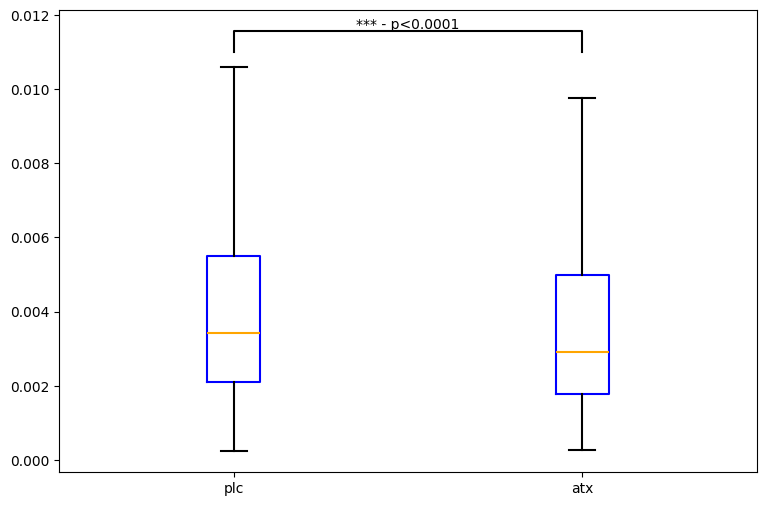

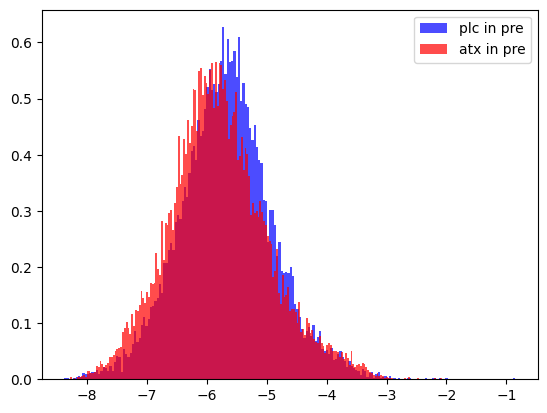

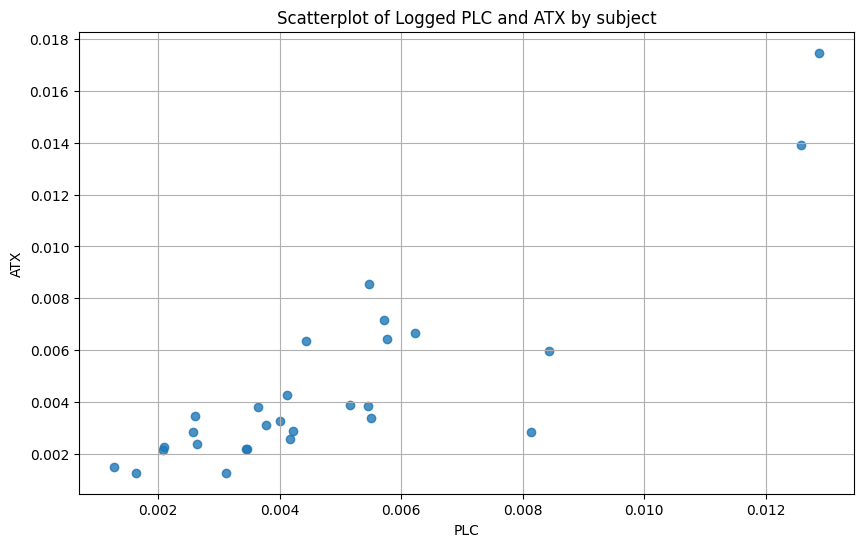

In [299]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


behavior = df
behavior1 = behavior[behavior['drug'] == 'PLC']
behavior2 = behavior[behavior['drug'] == 'ATX']
plc = behavior1['prestim_irrev']
atx = behavior2['prestim_irrev']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[plc, atx], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['plc', 'atx'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(plc, atx)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(plc, 75)
Q3_group2 = np.percentile(atx, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of plc in prestim: " + str(np.mean(plc)))
print("mean of atx in prestim: " + str(np.mean(atx)))
print("median of plc prestim: " + str(np.median(plc)))
print("median of atx in prestim: " + str(np.median(atx)))

plt.show()

plt.hist(np.log(plc), bins=200, color='blue', alpha=0.7, label='plc in pre', density = True)
plt.hist(np.log(atx), bins=200, color='red', alpha=0.7, label='atx in pre', density = True)
plt.legend()
plt.show()


##scatterplot
df1 = behavior1.groupby(['subject'])['prestim_irrev'].mean()
df2 = behavior2.groupby(['subject'])['prestim_irrev'].mean()

plt.figure(figsize=(10, 6))
plt.scatter(df1, df2, alpha=0.8)

plt.xlabel('PLC')
plt.ylabel('ATX')
plt.title('Scatterplot of Logged PLC and ATX by subject')
plt.grid(True)
plt.show()


#plt.scatter(behavior['prestim_irrev'], behavior['poststim_irrev'], alpha=0.5)



### std dev correctness in pre

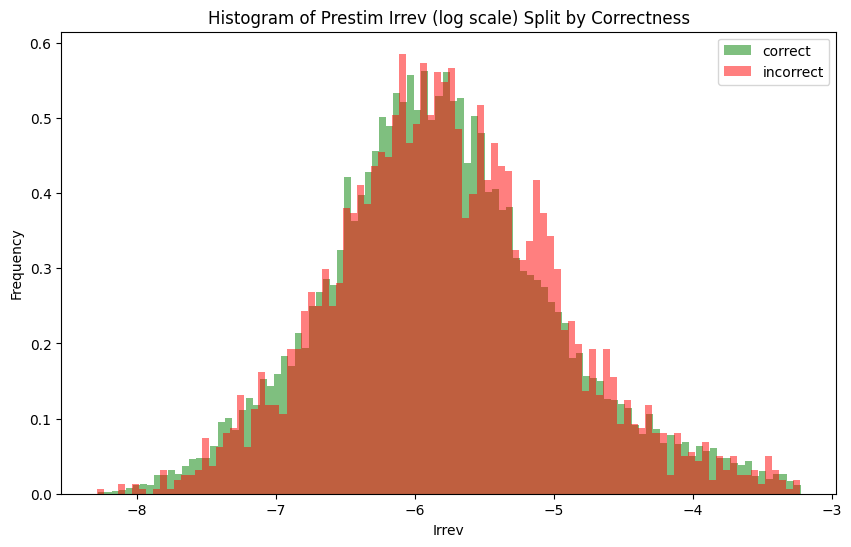

18340384.0
0.005176070244506086
Mean corr: 0.004368781574151212
Mean incorr: 0.004431145097094009
The std dev of the correct values in the pretty histogram (logged irrev values): 0.8298676472737808
The std dev of the incorrect values in the pretty histogram (logged irrev values): 0.8071029016625543
The std dev of the correct values of raw: 0.004816938945066425
The std dev of the incorrect values of raw: 0.004664521320371276


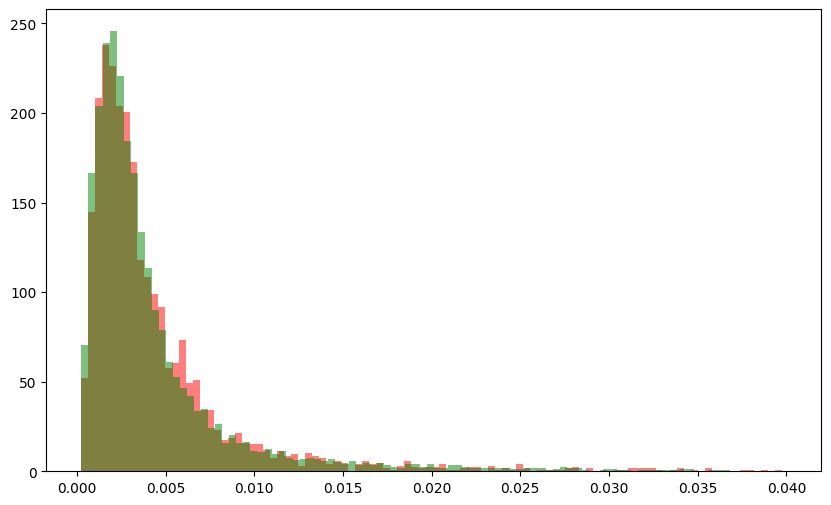

F test-- F-statistic: 0.9379345337683299, p-value: 0.987718726639045
F test-- F-statistic: 1.0661724928522573, p-value: 0.987718726639045
Levene's test statistic in raw: 0.057060767187128145, p-value: 0.8112065575973162
Brown-Forsythe test statistic in raw: 0.057060767187128145, p-value: 0.8112065575973162
Levene's test statistic in logged: 1.085774652367867, p-value: 0.2974259673122803
Brown-Forsythe test statistic in logged: 1.085774652367867, p-value: 0.2974259673122803


In [394]:

behavior = df
behavior = behavior[behavior['drug']=='ATX']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['correct']==1]['prestim_irrev']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='correct', color='green', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['correct']==0]['prestim_irrev']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='incorrect', color='red', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestim Irrev (log scale) Split by Correctness')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean corr: "+str(np.mean(correct_irrev)))
print("Mean incorr: "+str(np.mean(incorrect_irrev)))
print("The std dev of the correct values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the incorrect values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the correct values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the incorrect values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = behavior[behavior['correct']==0]['prestim_irrev']
group2 = behavior[behavior['correct']==1]['prestim_irrev']

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='incorrect', color='red', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='correct', color='green', density = True)

plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")





## boxplot post

In [1]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


behavior = df
plc = behavior[behavior['drug'] == 'PLC']['poststim_irrev']
atx = behavior[behavior['drug'] == 'ATX']['poststim_irrev']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[plc, atx], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['plc', 'atx'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(plc, atx)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(plc, 75)
Q3_group2 = np.percentile(atx, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of plc in poststim: " + str(np.mean(plc)))
print("mean of atx in poststim: " + str(np.mean(atx)))
print("median of plc in poststim: " + str(np.median(plc)))
print("median of atx in poststim: " + str(np.median(atx)))

plt.show()

plt.hist(np.log(plc), bins=200, color='blue', alpha=0.7, label='plc in post', density = True)
plt.hist(np.log(atx), bins=200, color='red', alpha=0.7, label='atx in post', density = True)
plt.legend()
plt.show()



##scatterplot
df1 = behavior1.groupby(['subject'])['poststim_irrev'].mean()
df2 = behavior2.groupby(['subject'])['poststim_irrev'].mean()

plt.figure(figsize=(10, 6))
plt.scatter(df1, df2, alpha=0.8)

plt.xlabel('PLC')
plt.ylabel('ATX')
plt.title('Scatterplot of PLC and ATX by subject')
plt.grid(True)
plt.show()

NameError: name 'df' is not defined

### std dev correctness

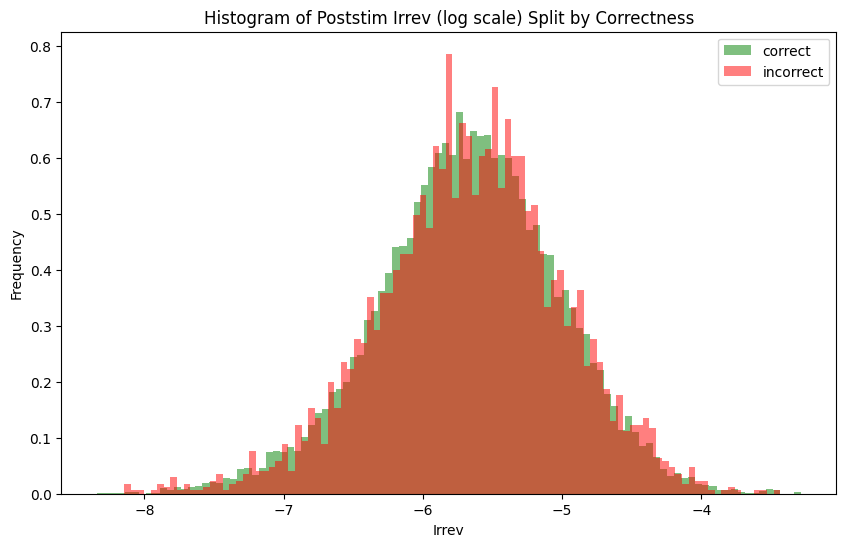

19570367.0
0.11910962692940648
Mean corr: 0.004231356207098442
Mean incorr: 0.0043125285776867365
The std dev of the correct values in the pretty histogram (logged irrev values): 0.6517057429697231
The std dev of the incorrect values in the pretty histogram (logged irrev values): 0.6588744827324369
The std dev of the correct values of raw: 0.0030023174890403
The std dev of the incorrect values of raw: 0.0029949761898398013


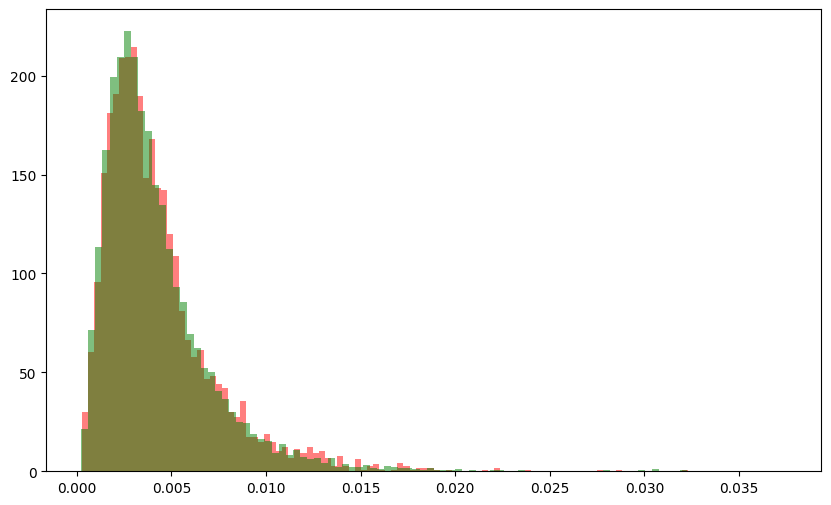

F test-- F-statistic: 0.9952999529540445, p-value: 0.5671866052823075
F test-- F-statistic: 1.0047222418045996, p-value: 0.5671866052823075
Levene's test statistic in raw: 1.0927658595444791, p-value: 0.2958764806926757
Brown-Forsythe test statistic in raw: 1.0927658595444791, p-value: 0.2958764806926757
Levene's test statistic in logged: 0.4658593784436853, p-value: 0.49490905641389005
Brown-Forsythe test statistic in logged: 0.4658593784436853, p-value: 0.49490905641389005


In [393]:

behavior = df
behavior = behavior[behavior['drug']=='ATX']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['correct']==1]['poststim_irrev']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='correct', color='green', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['correct']==0]['poststim_irrev']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='incorrect', color='red', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Poststim Irrev (log scale) Split by Correctness')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean corr: "+str(np.mean(correct_irrev)))
print("Mean incorr: "+str(np.mean(incorrect_irrev)))
print("The std dev of the correct values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the incorrect values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the correct values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the incorrect values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = behavior[behavior['correct']==0]['poststim_irrev']
group2 = behavior[behavior['correct']==1]['poststim_irrev']

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='incorrect', color='red', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='correct', color='green', density = True)

plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")





## boxplot pre/post

Statistic: 55053721.0, P-value: 7.063183898799438e-05
mean of prestim: 0.004381857131626193
mean of poststim: 0.003967261809131984
median of prestim: 0.002902941091788125
median of poststim: 0.0030925287093322277


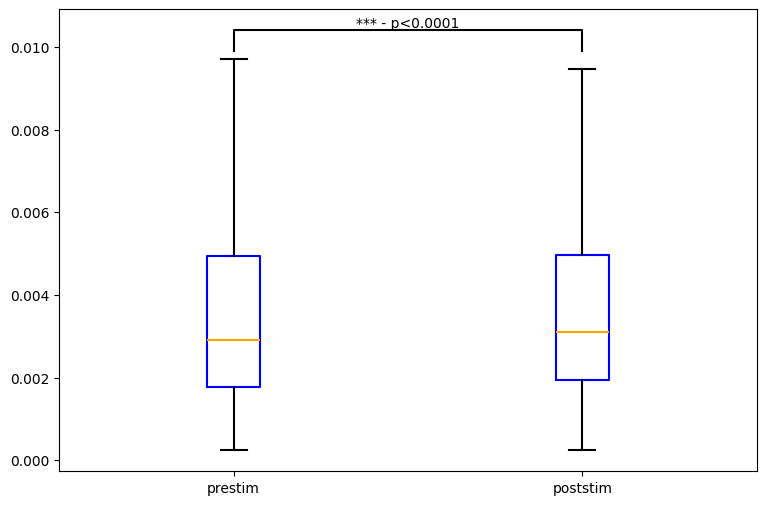

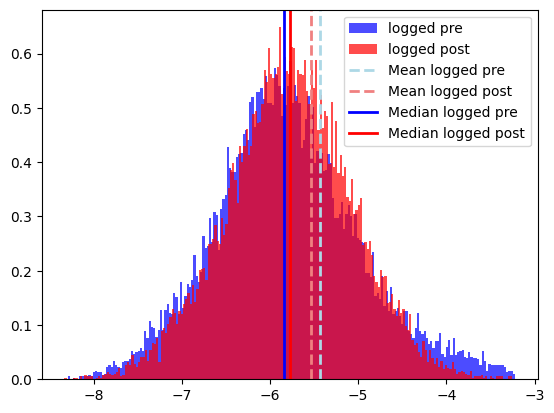

Statistic: -3.5154567938968166, P-value: 0.00044028283466725275
Statistic: 110364221.0, P-value: 1.3468425940454095e-07


In [67]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


behavior = df
behavior = behavior[behavior['drug']=='ATX']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
pre = behavior['prestim_irrev']
post = behavior['poststim_irrev']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['prestim', 'poststim'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = stats.wilcoxon(pre, post, alternative = "two-sided")
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '** - p<0.01'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of prestim: " + str(np.mean(pre)))
print("mean of poststim: " + str(np.mean(post)))
print("median of prestim: " + str(np.median(pre)))
print("median of poststim: " + str(np.median(post)))

plt.show()



plt.hist(np.log(pre), bins=200, color='blue', alpha=0.7, label='logged pre', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.7, label='logged post', density = True)
plt.axvline(np.log(np.mean(pre)), color='lightblue', linestyle='dashed', linewidth=2, label='Mean logged pre')
plt.axvline(np.log(np.mean(post)), color='lightcoral', linestyle='dashed', linewidth=2, label='Mean logged post')

plt.axvline(np.log(np.median(pre)), color='blue', linestyle='solid', linewidth=2, label='Median logged pre')
plt.axvline(np.log(np.median(post)), color='red', linestyle='solid', linewidth=2, label='Median logged post')
plt.legend()
plt.show()

t_stat, p_value = stats.ttest_rel(np.log(pre), np.log(post))
print(f'Statistic: {t_stat}, P-value: {p_value}')

t_stat, p_value = mannwhitneyu(pre, post, alternative = "two-sided")
print(f'Statistic: {t_stat}, P-value: {p_value}')
#Well shit.

### std dev of pre/post

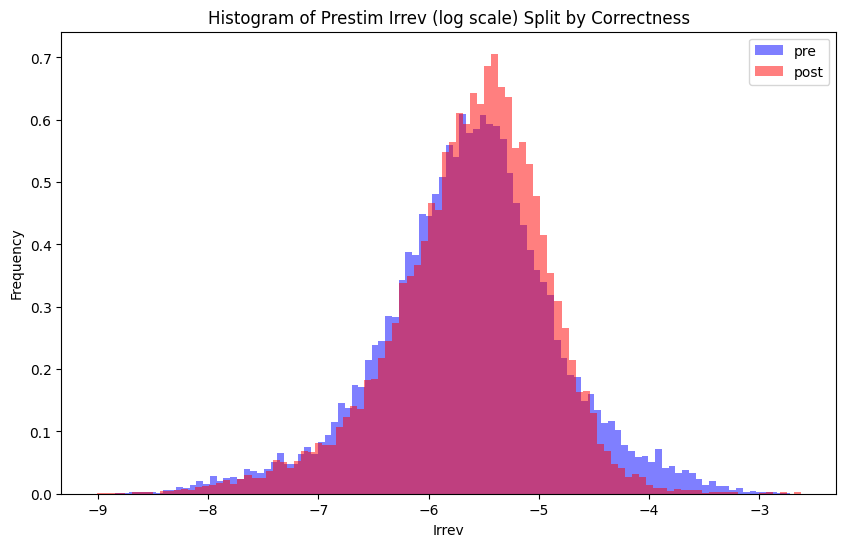

109660878.0
0.0023819797317326296
Mean corr: 0.004917954086090914
Mean incorr: 0.0044581966987540566
The std dev of the correct values in the pretty histogram (logged irrev values): 0.7973261460563369
The std dev of the incorrect values in the pretty histogram (logged irrev values): 0.6911275174441961
The std dev of the correct values of raw: 0.00479954889222413
The std dev of the incorrect values of raw: 0.003243722037796631


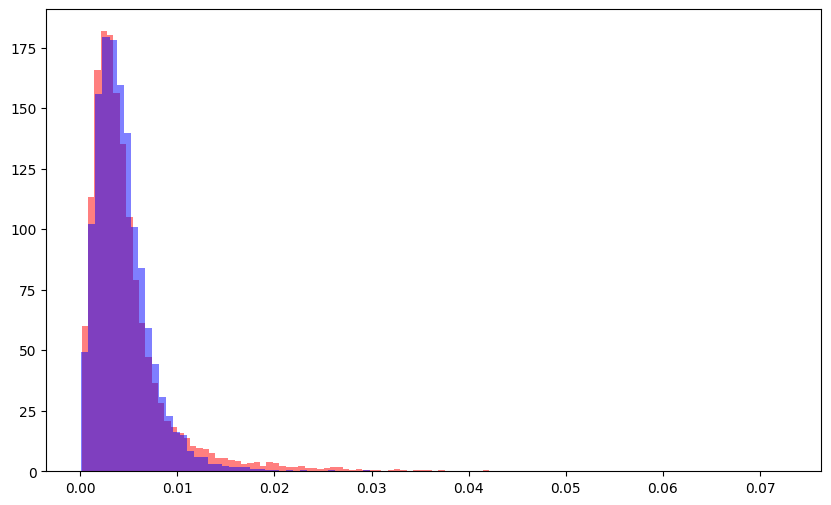

F test-- F-statistic: 2.189341842882482, p-value: 0.9999999999999999
F test-- F-statistic: 0.45675827338292796, p-value: 0.9999999999999999
Levene's test statistic in raw: 245.4056566841166, p-value: 4.3171086831464626e-55
Brown-Forsythe test statistic in raw: 245.4056566841166, p-value: 4.3171086831464626e-55
Levene's test statistic in logged: 192.39120934890192, p-value: 1.3047352979923176e-43
Brown-Forsythe test statistic in logged: 192.39120934890192, p-value: 1.3047352979923176e-43


In [9]:

behavior = df
behavior = behavior[behavior['drug']=='DNP']
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior['prestim_irrev']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='pre', color='blue', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior['poststim_irrev']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='post', color='red', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestim Irrev (log scale) Split by Correctness')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean corr: "+str(np.mean(correct_irrev)))
print("Mean incorr: "+str(np.mean(incorrect_irrev)))
print("The std dev of the correct values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the incorrect values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the correct values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the incorrect values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = behavior['prestim_irrev']
group2 = behavior['poststim_irrev']

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='pre', color='red', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='post', color='blue', density = True)

plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")





Statistic: 18844996.0, P-value: 4.69056847425987e-05
Mean correct: 0.004381542136663349
Mean incorrect: 0.004545889848308775
Median correct: 0.0037970386028599434
Median incorrect: 0.004003948055610301
0.004419381303659955


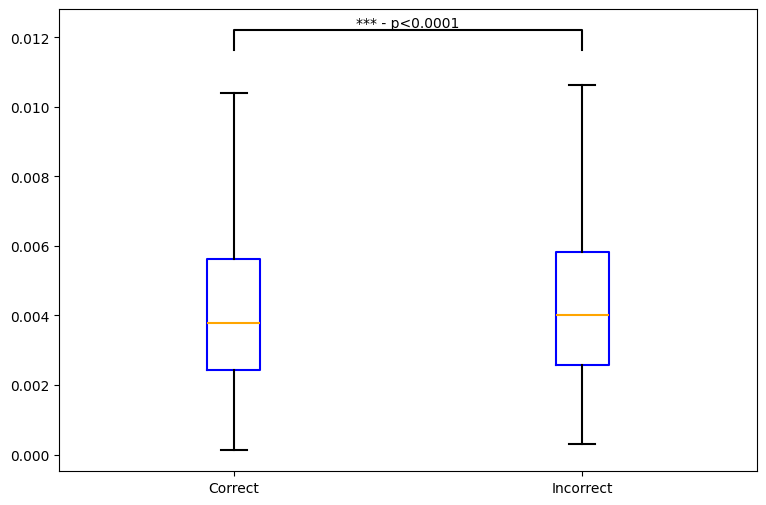

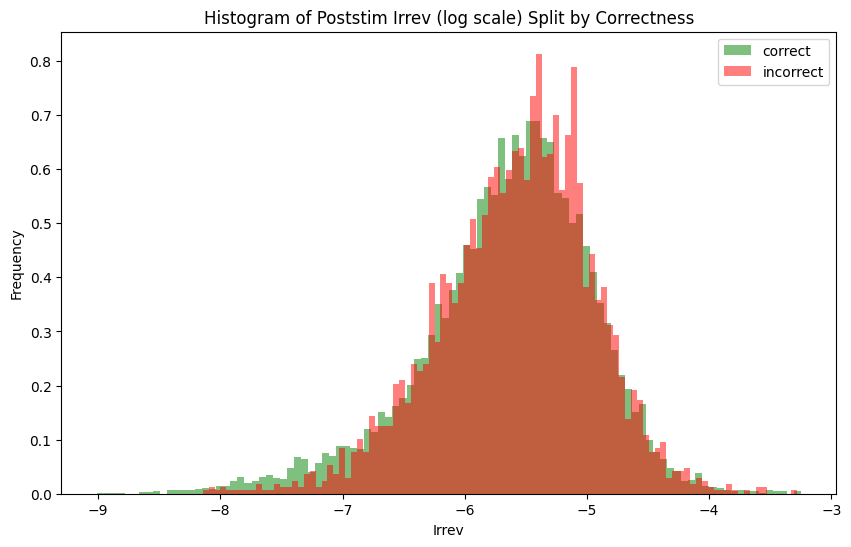

18844996.0
4.69056847425987e-05
Mean corr: 0.004381542136663349
Mean incorr: 0.004545889848308775
Median corr: 0.0037970386028599434
Median incorr: 0.004003948055610301
The std dev of the correct values in the pretty histogram (logged irrev values): 0.7035020085547861
The std dev of the incorrect values in the pretty histogram (logged irrev values): 0.6279595721171147
The std dev of the correct values of raw: 0.002995932039758627
The std dev of the incorrect values of raw: 0.0029210222086683054


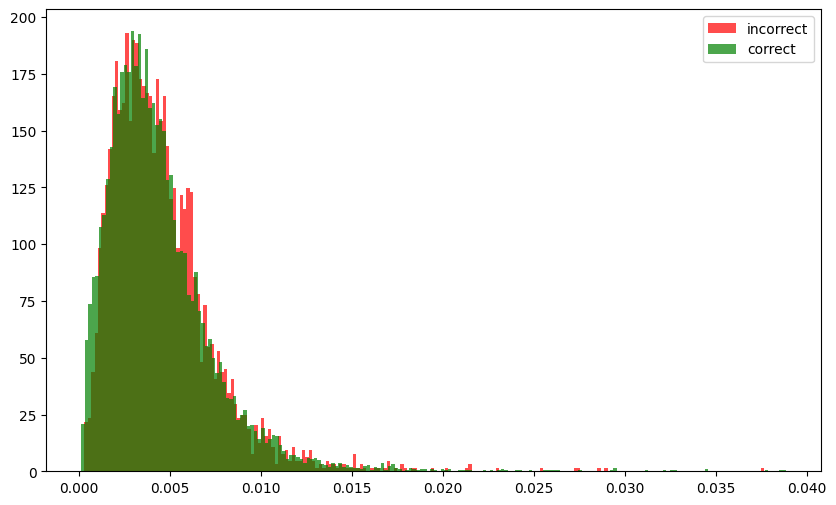

F test-- F-statistic: 0.9508114080628651, p-value: 0.9656915373740367
F test-- F-statistic: 1.0517332790919591, p-value: 0.9656915373740367
Levene's test statistic in raw: 0.3991746021768303, p-value: 0.5275255109701062
Brown-Forsythe test statistic in raw: 0.3991746021768303, p-value: 0.5275255109701062
Levene's test statistic in logged: 23.95650692339172, p-value: 9.95660042202807e-07
Brown-Forsythe test statistic in logged: 23.95650692339172, p-value: 9.95660042202807e-07


In [77]:

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

# Diff = (prestimulus_irrev_array - poststimulus_irrev_array)
#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
behavior = df
behavior = behavior[behavior['drug']=='DNP']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]

correct_df = behavior[behavior['correct'] == 1]
incorrect_df = behavior[behavior['correct'] == 0]

correct_irrev = correct_df['poststim_irrev']
incorrect_irrev = incorrect_df['poststim_irrev']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[correct_irrev, incorrect_irrev], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Correct', 'Incorrect'])
#ax.set_title('ATX')


# Perform the Mann-Whitney U test
stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev)
print(f'Statistic: {stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(correct_irrev, 75)
Q3_group2 = np.percentile(incorrect_irrev, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)


print("Mean correct: " + str(np.mean(behavior[behavior['correct']==1]['poststim_irrev'])))
print("Mean incorrect: " + str(np.mean(behavior[behavior['correct']==0]['poststim_irrev'])))
print("Median correct: " + str(np.median(behavior[behavior['correct']==1]['poststim_irrev'])))
print("Median incorrect: " + str(np.median(behavior[behavior['correct']==0]['poststim_irrev'])))
print(np.mean(behavior['poststim_irrev']))

plt.show()


# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['correct']==1]['poststim_irrev']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='correct', color='green', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['correct']==0]['poststim_irrev']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='incorrect', color='red', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Poststim Irrev (log scale) Split by Correctness')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean corr: "+str(np.mean(correct_irrev)))
print("Mean incorr: "+str(np.mean(incorrect_irrev)))
print("Median corr: "+str(np.median(correct_irrev)))
print("Median incorr: "+str(np.median(incorrect_irrev)))
print("The std dev of the correct values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the incorrect values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the correct values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the incorrect values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = behavior[behavior['correct']==0]['poststim_irrev']
group2 = behavior[behavior['correct']==1]['poststim_irrev']

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=200, alpha=0.7, label='incorrect', color='red', density = True)
plt.hist(group2, bins=200, alpha=0.7, label='correct', color='green', density = True)
plt.legend()
plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")



### std dev of diff

Statistic: 182387983.0, P-value: 5.3511512128184996e-08
Mean correct: -0.00035593019739856333
Mean incorrect: -0.0005561340536431001
Median correct: 0.00012194776646563214
Median incorrect: 3.067060827853952e-05
-0.000401772900781563


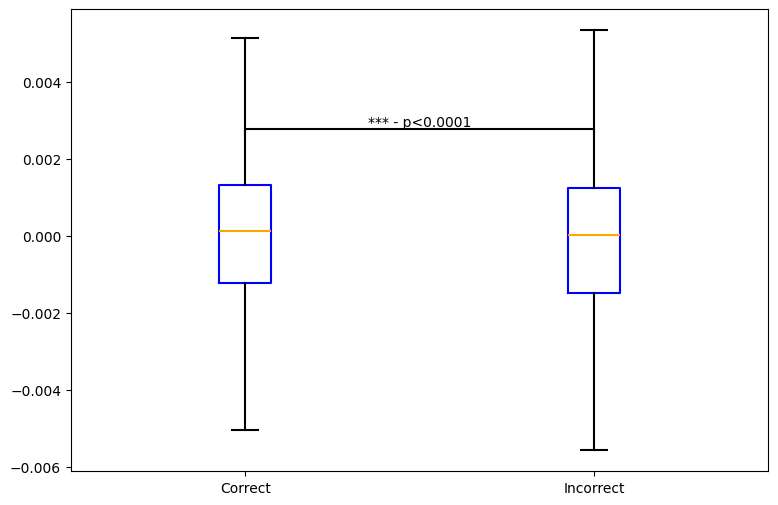

c:\Users\jaket\anaconda3\envs\deco1\lib\site-packages\pandas\core\arraylike.py:402: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


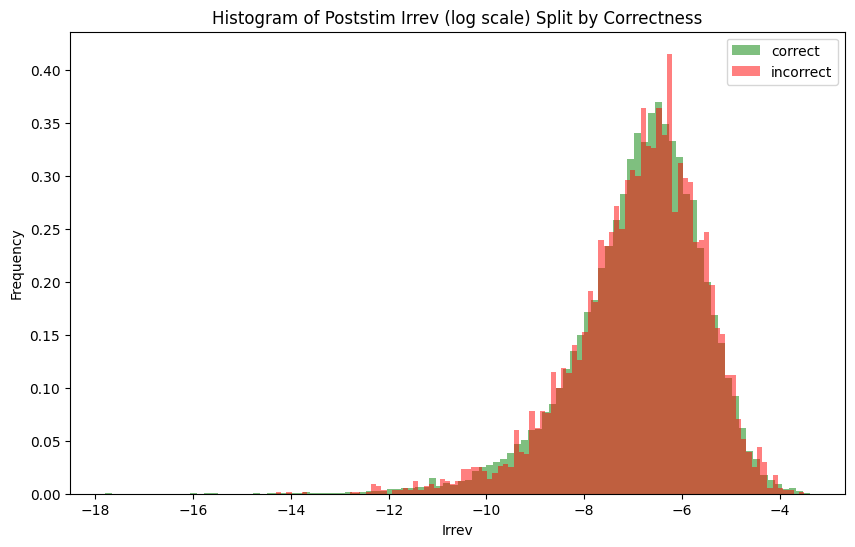

182387983.0
5.3511512128184996e-08
Mean corr: -0.00035593019739856333
Mean incorr: -0.0005561340536431001
Median corr: 0.00012194776646563214
Median incorr: 3.067060827853952e-05
The std dev of the correct values in the pretty histogram (logged irrev values): 1.3123663588007417
The std dev of the incorrect values in the pretty histogram (logged irrev values): 1.3074301855700206
The std dev of the correct values of raw: 0.004297906256642112
The std dev of the incorrect values of raw: 0.004401701128427802


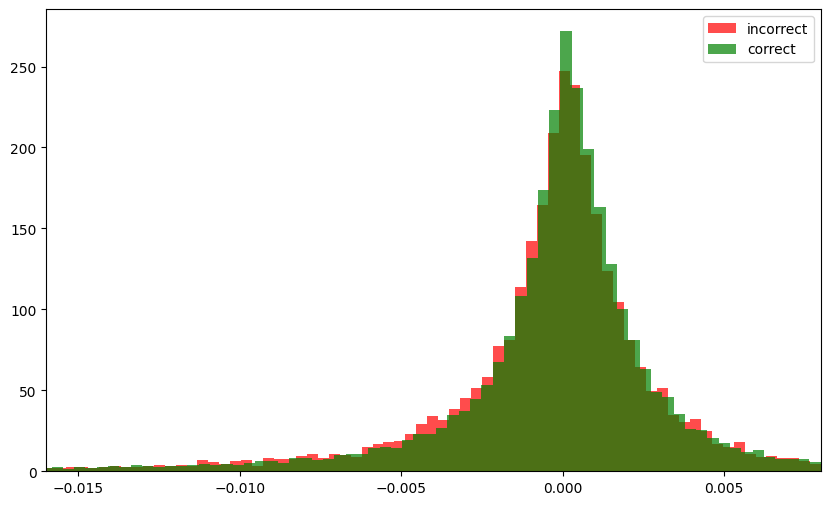

F test-- F-statistic: 1.0489555246301097, p-value: 0.998723442646601
F test-- F-statistic: 0.95332926565464, p-value: 0.9987234426465998
Levene's test statistic in raw: 8.181051213985912, p-value: 0.004234984341701409
Brown-Forsythe test statistic in raw: 8.181051213985912, p-value: 0.004234984341701409
Levene's test statistic in logged: nan, p-value: nan
Brown-Forsythe test statistic in logged: nan, p-value: nan


In [73]:

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

# Diff = (prestimulus_irrev_array - poststimulus_irrev_array)
#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
behavior = df
#behavior = behavior[behavior['drug']=='ATX']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]

correct_df = behavior[behavior['correct'] == 1]
incorrect_df = behavior[behavior['correct'] == 0]

correct_irrev = correct_df['stim_diff']
incorrect_irrev = incorrect_df['stim_diff']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[correct_irrev, incorrect_irrev], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Correct', 'Incorrect'])
#ax.set_title('ATX')


# Perform the Mann-Whitney U test
stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev)
print(f'Statistic: {stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(correct_irrev, 75)
Q3_group2 = np.percentile(incorrect_irrev, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)


print("Mean correct: " + str(np.mean(behavior[behavior['correct']==1]['stim_diff'])))
print("Mean incorrect: " + str(np.mean(behavior[behavior['correct']==0]['stim_diff'])))
print("Median correct: " + str(np.median(behavior[behavior['correct']==1]['stim_diff'])))
print("Median incorrect: " + str(np.median(behavior[behavior['correct']==0]['stim_diff'])))
print(np.mean(behavior['stim_diff']))

plt.show()


# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['correct']==1]['stim_diff']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='correct', color='green', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['correct']==0]['stim_diff']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='incorrect', color='red', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Poststim Irrev (log scale) Split by Correctness')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean corr: "+str(np.mean(correct_irrev)))
print("Mean incorr: "+str(np.mean(incorrect_irrev)))
print("Median corr: "+str(np.median(correct_irrev)))
print("Median incorr: "+str(np.median(incorrect_irrev)))
print("The std dev of the correct values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the incorrect values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the correct values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the incorrect values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = behavior[behavior['correct']==0]['stim_diff']
group2 = behavior[behavior['correct']==1]['stim_diff']

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=200, alpha=0.7, label='incorrect', color='red', density = True)
plt.hist(group2, bins=200, alpha=0.7, label='correct', color='green', density = True)
plt.legend()
plt.xlim(-0.016,0.008)
plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")





Statistic: 110214833.0, P-value: 0.23725880430757473
mean of plc in diff (post-pre): -0.0003775850035369016
mean of atx in diff (post-pre): -0.00047878594764558604
median of plc in diff (post-pre): 0.0001050210959663468
median of atx in diff (post-pre): 0.00013122866857955516
std dev of plc in diff (post-pre): 0.008712213912585075
std dev of atx in diff (post-pre): 0.00499672930172788


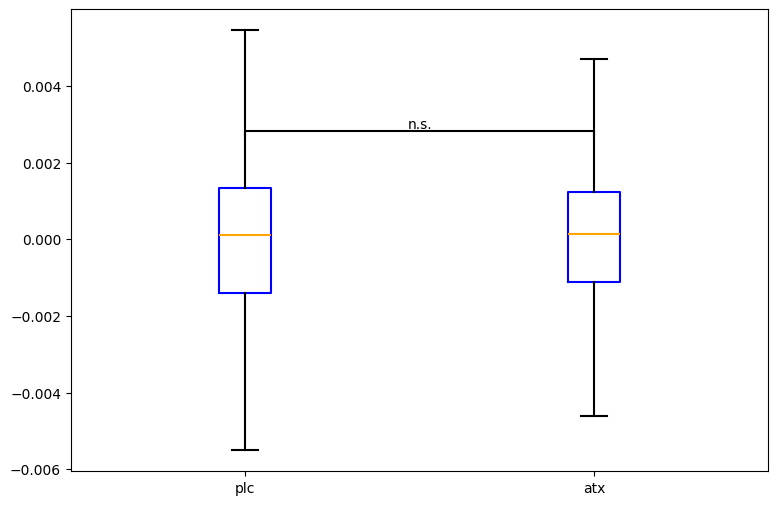

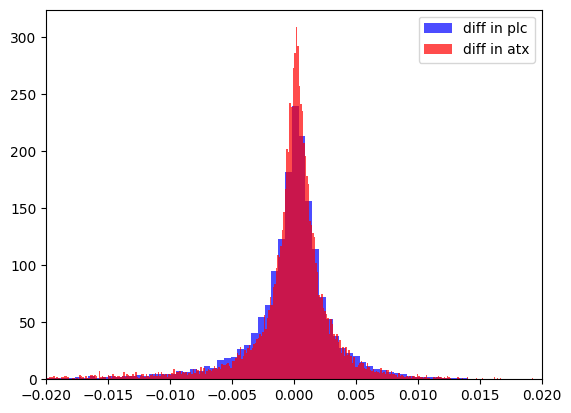

F test-- F-statistic: 3.040089668727241, p-value: 0.9999999999999999
F test-- F-statistic: 0.32893766597965457, p-value: 0.9999999999999999
Levene's test statistic in raw: 5.841571977088479, p-value: 0.01565779939869688
Brown-Forsythe test statistic in raw: 5.841571977088479, p-value: 0.01565779939869688
Levene's test statistic in logged: nan, p-value: nan
Brown-Forsythe test statistic in logged: nan, p-value: nan


c:\Users\jaket\anaconda3\envs\deco1\lib\site-packages\pandas\core\arraylike.py:402: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [72]:

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


behavior = df
plc = behavior[behavior['drug'] == 'PLC']['stim_diff']
atx = behavior[behavior['drug'] == 'ATX']['stim_diff']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[plc, atx], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['plc', 'atx'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(plc, atx)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(plc, 75)
Q3_group2 = np.percentile(atx, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of plc in diff (post-pre): " + str(np.mean(plc)))
print("mean of atx in diff (post-pre): " + str(np.mean(atx)))
print("median of plc in diff (post-pre): " + str(np.median(plc)))
print("median of atx in diff (post-pre): " + str(np.median(atx)))
print("std dev of plc in diff (post-pre): " + str(np.std(plc)))
print("std dev of atx in diff (post-pre): " + str(np.std(atx)))

plt.show()

plt.hist(plc, bins=2000, color='blue', alpha=0.7, label='diff in plc', density = True)
plt.hist(atx, bins=2000, color='red', alpha=0.7, label='diff in atx', density = True)
plt.xlim(-0.02, 0.02)  # Focus x-axis from 20 to 80
plt.legend()
plt.show()



###### significance testing
group1 = plc
group2 = atx


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")



C:\Users\jaket\AppData\Local\Temp\ipykernel_10012\2157180800.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['p'] = behavior[behavior['drug'] == 'PLC']['log_poststim']-behavior[behavior['drug'] == 'PLC']['log_prestim']
C:\Users\jaket\AppData\Local\Temp\ipykernel_10012\2157180800.py:10: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  plc = behavior.groupby('subject').mean()['p']
C:\Users\jaket\AppData\Local\Temp\ipykernel_10012\2157180800.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .

Statistic: 360.0, P-value: 0.6057249255219442
mean of plc in diff (post-pre): 0.017903392041363746
mean of atx in diff (post-pre): 0.029874521150903225
median of plc in diff (post-pre): 0.05535433870810412
median of atx in diff (post-pre): 0.07917593767004838


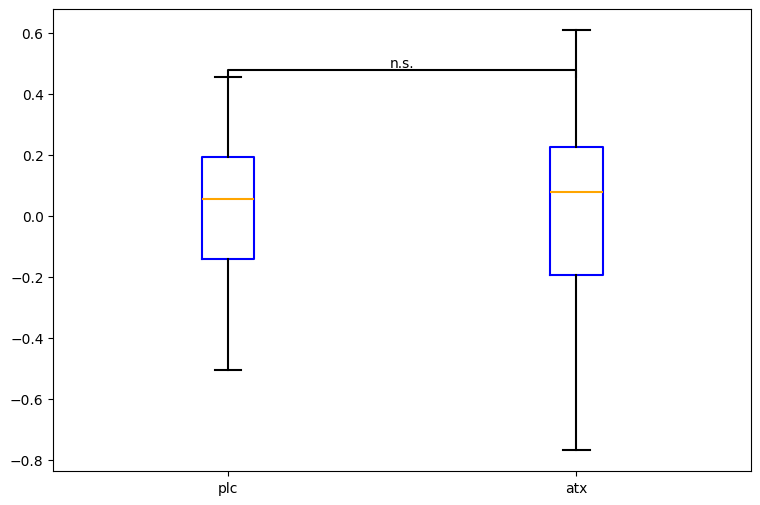

Statistic: 110214833.0, P-value: 0.23725880430757473
mean of plc in diff (post-pre): -0.0003775850035369016
mean of atx in diff (post-pre): -0.00047878594764558604
median of plc in diff (post-pre): 0.0001050210959663468
median of atx in diff (post-pre): 0.00013122866857955516


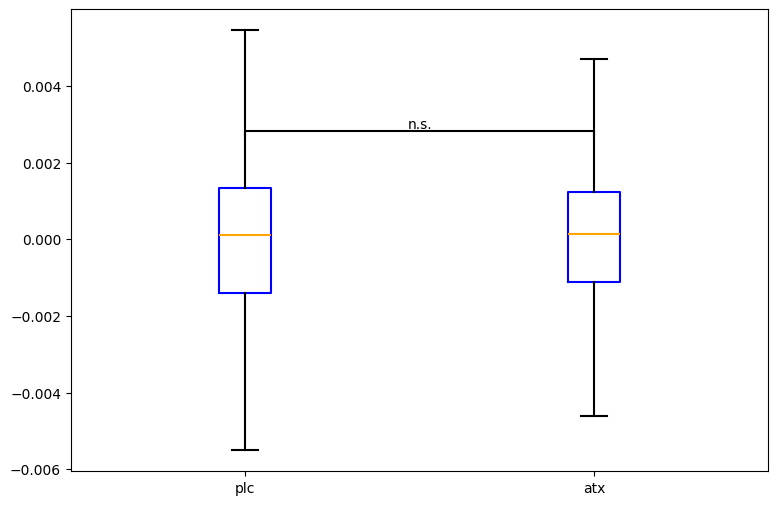

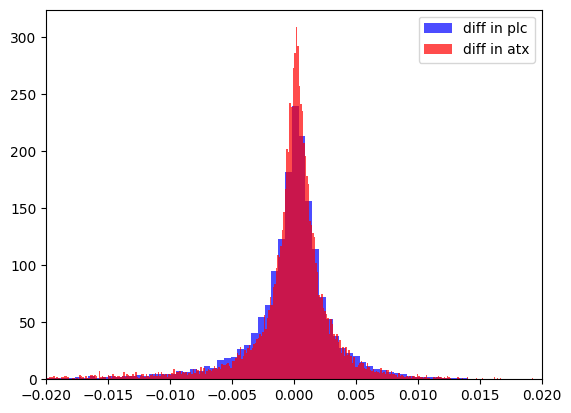

In [20]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.02) & (behavior['prestim_irrev'] < 0.02)]

behavior['p'] = behavior[behavior['drug'] == 'PLC']['log_poststim']-behavior[behavior['drug'] == 'PLC']['log_prestim']
plc = behavior.groupby('subject').mean()['p']
behavior['a'] = behavior[behavior['drug'] == 'ATX']['log_poststim']-behavior[behavior['drug'] == 'ATX']['log_prestim']
atx = behavior.groupby('subject').mean()['a']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[plc, atx], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['plc', 'atx'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(plc, atx)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(plc, 75)
Q3_group2 = np.percentile(atx, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of plc in diff (post-pre): " + str(np.mean(plc)))
print("mean of atx in diff (post-pre): " + str(np.mean(atx)))
print("median of plc in diff (post-pre): " + str(np.median(plc)))
print("median of atx in diff (post-pre): " + str(np.median(atx)))

plt.show()

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


behavior = df
plc = behavior[behavior['drug'] == 'PLC']['stim_diff']
atx = behavior[behavior['drug'] == 'ATX']['stim_diff']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[plc, atx], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['plc', 'atx'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(plc, atx)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(plc, 75)
Q3_group2 = np.percentile(atx, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of plc in diff (post-pre): " + str(np.mean(plc)))
print("mean of atx in diff (post-pre): " + str(np.mean(atx)))
print("median of plc in diff (post-pre): " + str(np.median(plc)))
print("median of atx in diff (post-pre): " + str(np.median(atx)))

plt.show()

plt.hist(plc, bins=2000, color='blue', alpha=0.7, label='diff in plc', density = True)
plt.hist(atx, bins=2000, color='red', alpha=0.7, label='diff in atx', density = True)
plt.xlim(-0.02, 0.02)  # Focus x-axis from 20 to 80
plt.legend()
plt.show()





logged!

#### plc vs atx

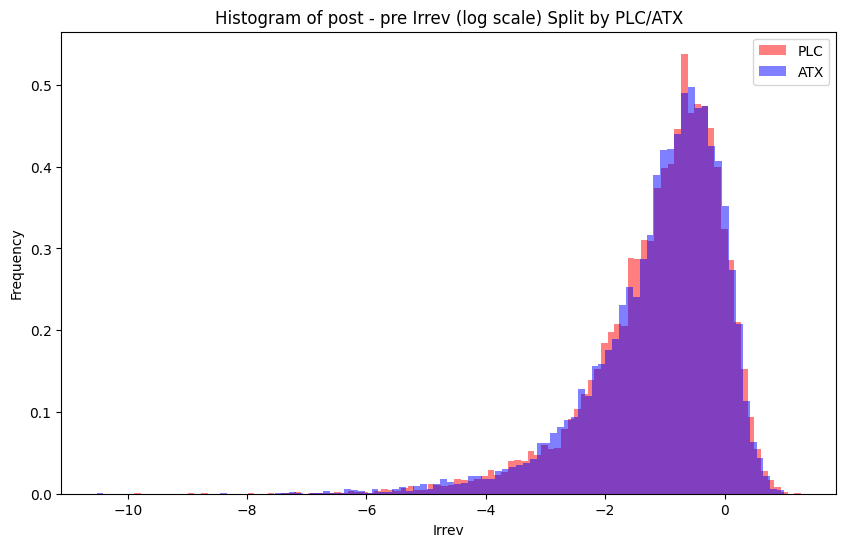

109455374.0
0.03714018005735312
Mean PLC: 0.00468741615269274
Mean ATX: 0.01622182573089626
The std dev of the PLC diff values in the pretty histogram (logged irrev values): 1.0945511129936054
The std dev of the ATX diff values in the pretty histogram (logged irrev values): 1.0987760804089555
The std dev of the PLC diff values of raw: 0.6760147923164462
The std dev of the ATX diff values of raw: 0.6726523386325312


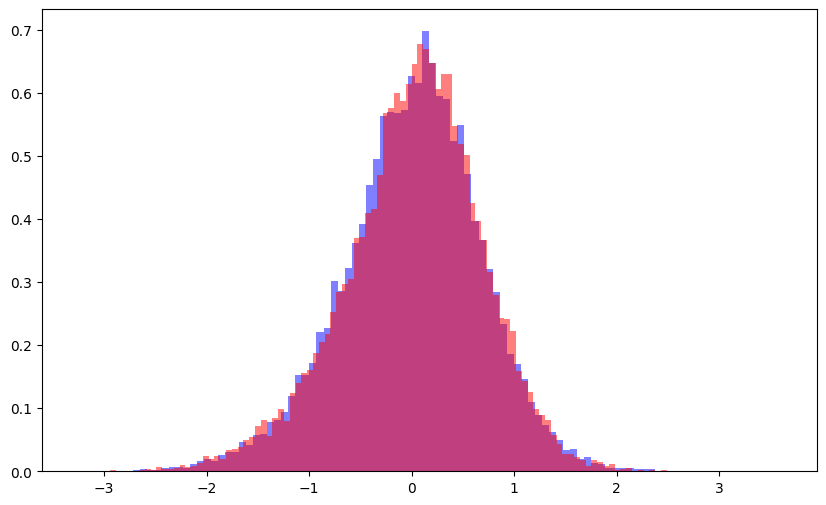

F test-- F-statistic: 1.0100248786496655, p-value: 0.7286817915249405
F test-- F-statistic: 0.9900746220597376, p-value: 0.7286817915249405
Levene's test statistic in raw: 0.5598318277070901, p-value: 0.45433391400658973
Brown-Forsythe test statistic in raw: 0.5598318277070901, p-value: 0.45433391400658973
Levene's test statistic in logged: nan, p-value: nan
Brown-Forsythe test statistic in logged: nan, p-value: nan


In [70]:
behavior = df

#behavior['stim_diff'] = behavior['log_poststim'] - behavior['log_prestim']

#behavior[behavior['drug'] == 'PLC']['stim_diff']
#behavior[behavior['drug'] == 'ATX']['stim_diff']


behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['drug'] == 'PLC']['stim_diff']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='PLC', color='red', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['drug'] == 'ATX']['stim_diff']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='ATX', color='blue', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of post - pre Irrev (log scale) Split by PLC/ATX')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean PLC: "+str(np.mean(correct_irrev)))
print("Mean ATX: "+str(np.mean(incorrect_irrev)))
print("The std dev of the PLC diff values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the ATX diff values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the PLC diff values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the ATX diff values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = behavior[behavior['drug'] == 'PLC']['stim_diff']
group2 = behavior[behavior['drug'] == 'ATX']['stim_diff']

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='PLC', color='blue', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='ATX', color='red', density = True)

plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")





Statistic: 110214833.0, P-value: 0.23725880430757473
mean of plc in diff (post-pre): -0.0003775850035369016
mean of atx in diff (post-pre): -0.00047878594764558604
median of plc in diff (post-pre): 0.0001050210959663468
median of atx in diff (post-pre): 0.00013122866857955516
std dev of plc in diff (post-pre): 0.008712213912585075
std dev of atx in diff (post-pre): 0.00499672930172788


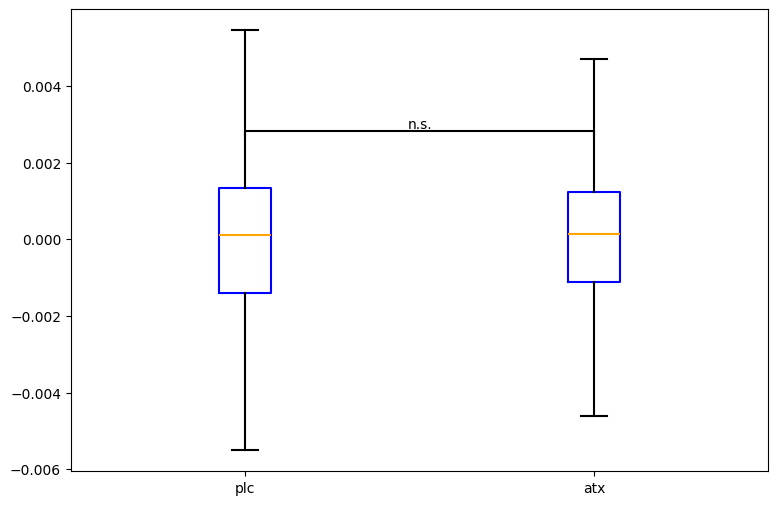

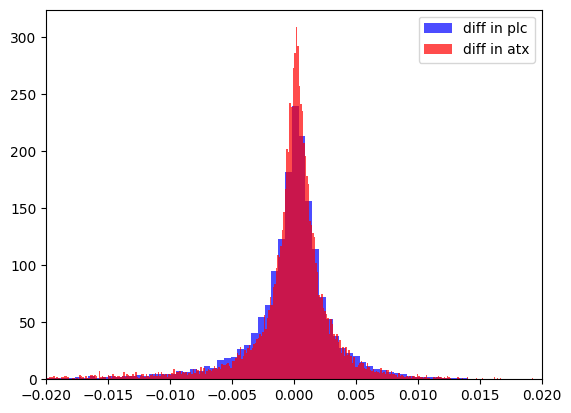

F test-- F-statistic: 3.040089668727241, p-value: 0.9999999999999999
F test-- F-statistic: 0.32893766597965457, p-value: 0.9999999999999999
Levene's test statistic in raw: 5.841571977088479, p-value: 0.01565779939869688
Brown-Forsythe test statistic in raw: 5.841571977088479, p-value: 0.01565779939869688
Levene's test statistic in logged: nan, p-value: nan
Brown-Forsythe test statistic in logged: nan, p-value: nan


c:\Users\jaket\anaconda3\envs\deco1\lib\site-packages\pandas\core\arraylike.py:402: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [81]:

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


behavior = df
plc = behavior[behavior['drug'] == 'PLC']['stim_diff']
atx = behavior[behavior['drug'] == 'ATX']['stim_diff']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[plc, atx], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['plc', 'atx'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(plc, atx)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(plc, 75)
Q3_group2 = np.percentile(atx, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of plc in diff (post-pre): " + str(np.mean(plc)))
print("mean of atx in diff (post-pre): " + str(np.mean(atx)))
print("median of plc in diff (post-pre): " + str(np.median(plc)))
print("median of atx in diff (post-pre): " + str(np.median(atx)))
print("std dev of plc in diff (post-pre): " + str(np.std(plc)))
print("std dev of atx in diff (post-pre): " + str(np.std(atx)))

plt.show()

plt.hist(plc, bins=2000, color='blue', alpha=0.7, label='diff in plc', density = True)
plt.hist(atx, bins=2000, color='red', alpha=0.7, label='diff in atx', density = True)
plt.xlim(-0.02, 0.02)  # Focus x-axis from 20 to 80
plt.legend()
plt.show()



###### significance testing
group1 = plc
group2 = atx


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")



Statistic: 122812723.0, P-value: 4.761727570068142e-56
mean of plc in diff (post-pre): 0.004775113227392409
mean of atx in diff (post-pre): 0.004486812411679671
median of plc in diff (post-pre): 0.0034255806646090606
median of atx in diff (post-pre): 0.0029076360582561698
std dev of plc in diff (post-pre): 0.006202838263675096
std dev of atx in diff (post-pre): 0.0053635128547693985


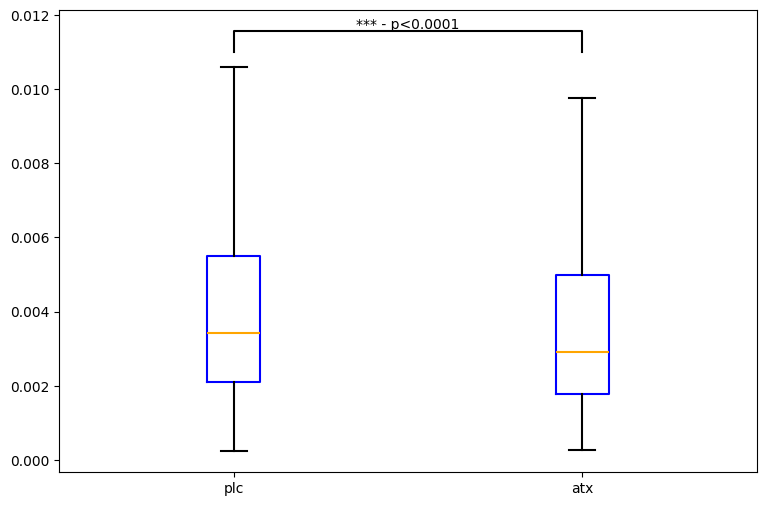

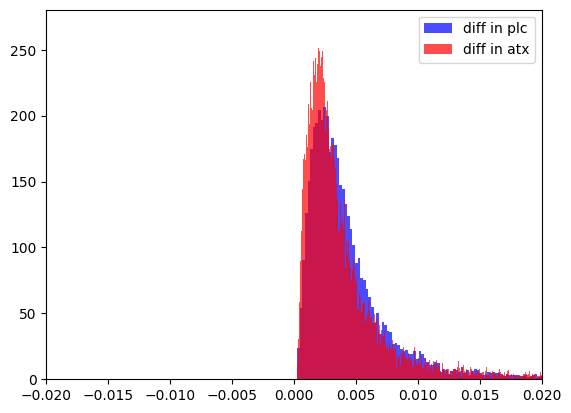

F test-- F-statistic: 1.3374675081411689, p-value: 0.9999999999999999
F test-- F-statistic: 0.7476817148177409, p-value: 0.9999999999999999
Levene's test statistic in raw: 0.5486762439750485, p-value: 0.45886491863065604
Brown-Forsythe test statistic in raw: 0.5486762439750485, p-value: 0.45886491863065604
Levene's test statistic in logged: 69.87961002748551, p-value: 6.574365468732479e-17
Brown-Forsythe test statistic in logged: 69.87961002748551, p-value: 6.574365468732479e-17


In [82]:

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


behavior = df
plc = behavior[behavior['drug'] == 'PLC']['prestim_irrev']
atx = behavior[behavior['drug'] == 'ATX']['prestim_irrev']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[plc, atx], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['plc', 'atx'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(plc, atx)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(plc, 75)
Q3_group2 = np.percentile(atx, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of plc in diff (post-pre): " + str(np.mean(plc)))
print("mean of atx in diff (post-pre): " + str(np.mean(atx)))
print("median of plc in diff (post-pre): " + str(np.median(plc)))
print("median of atx in diff (post-pre): " + str(np.median(atx)))
print("std dev of plc in diff (post-pre): " + str(np.std(plc)))
print("std dev of atx in diff (post-pre): " + str(np.std(atx)))

plt.show()

plt.hist(plc, bins=2000, color='blue', alpha=0.7, label='diff in plc', density = True)
plt.hist(atx, bins=2000, color='red', alpha=0.7, label='diff in atx', density = True)
plt.xlim(-0.02, 0.02)  # Focus x-axis from 20 to 80
plt.legend()
plt.show()



###### significance testing
group1 = plc
group2 = atx


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")



c:\Users\jaket\anaconda3\envs\deco1\lib\site-packages\pandas\core\arraylike.py:402: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


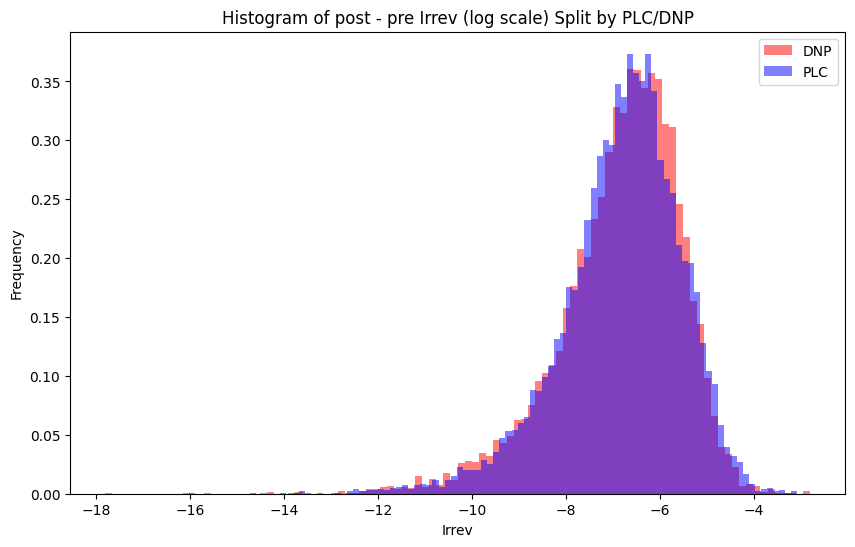

109213754.0
0.6026355260843148
Mean corr: -0.00045975738733685815
Mean incorr: -0.0004201185107137011
The std dev of the PLC diff values in the pretty histogram (logged irrev values): 1.3275241872542112
The std dev of the DNP diff values in the pretty histogram (logged irrev values): 1.295115306971989
The std dev of the PLC diff values of raw: 0.004565334239519227
The std dev of the DNP diff values of raw: 0.004618038979153819


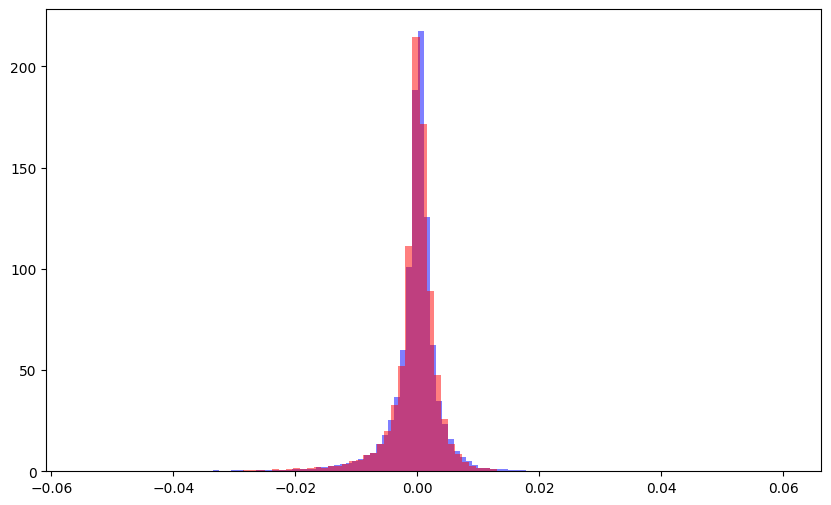

F test-- F-statistic: 1.0232238377277203, p-value: 0.9187526705295153
F test-- F-statistic: 0.9773032675047, p-value: 0.9187526705295153
Levene's test statistic in raw: 1.8471121729784286, p-value: 0.17412999090429693
Brown-Forsythe test statistic in raw: 1.8471121729784286, p-value: 0.17412999090429693
Levene's test statistic in logged: nan, p-value: nan
Brown-Forsythe test statistic in logged: nan, p-value: nan


In [21]:


behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['drug'] == 'DNP']['stim_diff']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='DNP', color='red', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['drug'] == 'PLC']['stim_diff']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='PLC', color='blue', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of post - pre Irrev (log scale) Split by PLC/DNP')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean corr: "+str(np.mean(correct_irrev)))
print("Mean incorr: "+str(np.mean(incorrect_irrev)))
print("The std dev of the PLC diff values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the DNP diff values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the PLC diff values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the DNP diff values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = behavior[behavior['drug'] == 'PLC']['stim_diff']
group2 = behavior[behavior['drug'] == 'DNP']['stim_diff']

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='PLC', color='blue', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='DNP', color='red', density = True)

plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")





## boxplot drugs

In [110]:
import pandas as pd
import numpy as np
from scipy.stats import levene

# Assuming 'df' is your DataFrame and it includes the columns:
# 'subject', 'drug', 'precue', 'postcue', 'prestim', 'poststim'

# Calculate standard deviations for each drug condition in each epoch
std_devs = df.groupby('drug')[['precue_irrev', 'postcue_irrev', 'prestim_irrev', 'poststim_irrev']].std()

print("Standard Deviations:")
print(std_devs)

# Define a function to perform pairwise Levene's tests
def pairwise_levenes_test(df, epochs, drugs):
    results = {}
    for epoch in epochs:
        results[epoch] = {}
        for i in range(len(drugs)):
            for j in range(i + 1, len(drugs)):
                drug1 = drugs[i]
                drug2 = drugs[j]
                stat, p_value = levene(df[df['drug'] == drug1][epoch],
                                       df[df['drug'] == drug2][epoch])
                results[epoch][f"{drug1} vs {drug2}"] = (stat, p_value)
    return results

# Define epochs and drugs
epochs = ['precue_irrev', 'postcue_irrev', 'prestim_irrev', 'poststim_irrev']
drugs = ['ATX', 'PLC', 'DNP']

# Perform pairwise Levene's tests
levene_results = pairwise_levenes_test(df, epochs, drugs)

# Display the results
for epoch, comparisons in levene_results.items():
    print(f"\nEpoch: {epoch}")
    for comparison, result in comparisons.items():
        stat, p_value = result
        print(f"{comparison}: Levene's stat = {stat:.4f}, p-value = {p_value:.4f}")


Standard Deviations:
      precue_irrev  postcue_irrev  prestim_irrev  poststim_irrev
drug                                                            
ATX       0.004579       0.004613       0.005364        0.003678
DNP       0.004252       0.005146       0.006329        0.006471
PLC       0.005492       0.005271       0.006203        0.008828

Epoch: precue_irrev
ATX vs PLC: Levene's stat = 12.6183, p-value = 0.0004
ATX vs DNP: Levene's stat = 20.1480, p-value = 0.0000
PLC vs DNP: Levene's stat = 0.0525, p-value = 0.8188

Epoch: postcue_irrev
ATX vs PLC: Levene's stat = 1.1616, p-value = 0.2811
ATX vs DNP: Levene's stat = 0.1939, p-value = 0.6597
PLC vs DNP: Levene's stat = 0.3733, p-value = 0.5412

Epoch: prestim_irrev
ATX vs PLC: Levene's stat = 0.5487, p-value = 0.4589
ATX vs DNP: Levene's stat = 1.0343, p-value = 0.3092
PLC vs DNP: Levene's stat = 2.6061, p-value = 0.1065

Epoch: poststim_irrev
ATX vs PLC: Levene's stat = 0.8343, p-value = 0.3610
ATX vs DNP: Levene's stat = 3.2609

In [255]:
from scipy.stats import friedmanchisquare

# Reshape the DataFrame for the Friedman test

df_agg = df.groupby(['subject', 'drug']).agg({'prestim_irrev': 'mean'}).reset_index()

# Reshape the DataFrame for the Friedman test
df_pivot = df_agg.pivot(index='subject', columns='drug', values='prestim_irrev')

print(df_pivot)
print(df_pivot.mean()['PLC'])
print(df_pivot.mean()['ATX'])
print(df_pivot.mean()['DNP'])

# Perform the Friedman test
stat, p = friedmanchisquare(df_pivot['PLC'], df_pivot['DNP'], df_pivot['ATX'])
print(f'Friedman test statistic: {stat}, p-value: {p}')

drug          ATX       DNP       PLC
subject                              
1        0.013931  0.015713  0.012575
2        0.006434  0.005782  0.005764
3        0.007148  0.005066  0.005716
4        0.006346  0.006236  0.004436
5        0.002576  0.003249  0.004166
6        0.002838  0.006255  0.008141
7        0.002199  0.004764  0.003469
8        0.002865  0.002177  0.002574
9        0.005957  0.010072  0.008431
10       0.003105  0.003485  0.003782
11       0.003829  0.005123  0.003648
12       0.008572  0.007852  0.005472
13       0.002283  0.002160  0.002104
14       0.002879  0.004467  0.004223
15       0.003834  0.003964  0.005449
16       0.002372  0.002626  0.002649
17       0.003375  0.005553  0.005506
18       0.017471  0.015366  0.012871
19       0.001279  0.001476  0.003125
20       0.001490  0.001578  0.001278
22       0.003452  0.003685  0.002612
23       0.006650  0.005202  0.006227
24       0.001278  0.003476  0.001642
25       0.003274  0.003929  0.004015
26       0.0

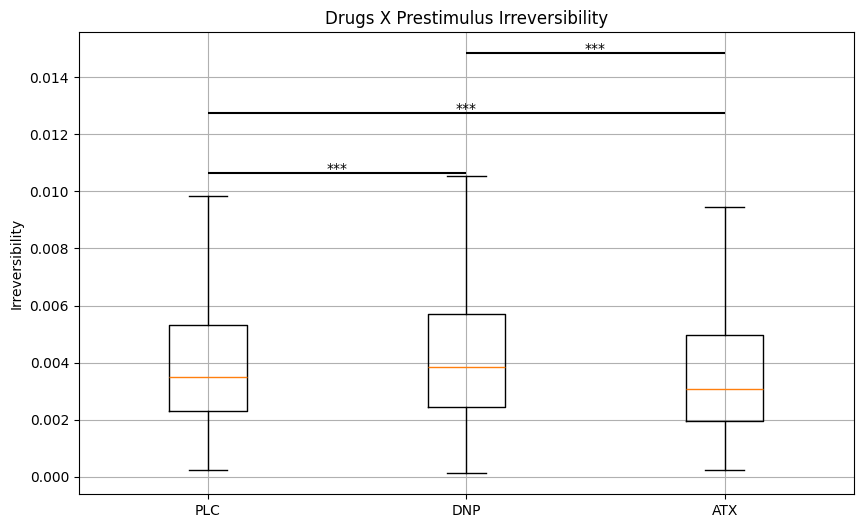

The std dev of PLC 0.003130632770668866
The std dev of DNP 0.0032094304538556784
The std dev of ATX 0.003263203894319235
The mean dev of PLC 0.004272075073922203
The mean dev of DNP 0.0044519243343410664
The mean dev of ATX 0.0039747568555572755


In [109]:

import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function


behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)

irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(behavior[behavior['drug'] == drug]['poststim_irrev'])

# Creating the boxplot with improved clarity
plt.figure(figsize=(10, 6))
box = plt.boxplot(irrev_sub_plc, positions=np.arange(len(drugs)), showfliers=False)
plt.xticks(np.arange(len(drugs)), drugs)
plt.ylabel('Irreversibility')
plt.title('Drugs X Prestimulus Irreversibility')
plt.grid(True)


# Mann-Whitney U tests across drugs with corrections

p_values = []
comparisons = []

for i in range(len(irrev_sub_plc)):
    for j in range(i + 1, len(irrev_sub_plc)):
        stat, p = stats.mannwhitneyu(irrev_sub_plc[i], irrev_sub_plc[j], alternative='two-sided')
        p_values.append(p)
        comparisons.append((drugs[i], drugs[j]))

corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]

# Annotating significant differences
max_y = max([item.get_data()[1].max() for item in box['caps']])  # Find the maximum y-value of the whiskers
y_offset = max_y * 0.1  # Slightly above the highest whisker
for i, (comp, corrected_p_val) in enumerate(zip(comparisons, corrected_p_values)):
    x1, x2 = drugs.index(comp[0]), drugs.index(comp[1])
    # Decide number of asterisks based on significance level
    if corrected_p_val < 0.0001:
        num_asterisks = '***'
    elif corrected_p_val < 0.01:
        num_asterisks = '**'
    elif corrected_p_val < 0.05:
        num_asterisks = '*'
    else:
        num_asterisks = ''

    if num_asterisks:  # Only draw if there's a significant result
        plt.hlines((max_y+max_y*0.01) + y_offset * i * 2, x1, x2, color="black")
        plt.text((x1 + x2) / 2, max_y + y_offset * (i * 2), num_asterisks, ha='center', va='bottom', color='black')

plt.show()

print("The std dev of PLC "+str(np.std(irrev_sub_plc[0])))
print("The std dev of DNP "+str(np.std(irrev_sub_plc[1])))
print("The std dev of ATX "+str(np.std(irrev_sub_plc[2])))
print("The mean dev of PLC "+str(np.mean(irrev_sub_plc[0])))
print("The mean dev of DNP "+str(np.mean(irrev_sub_plc[1])))
print("The mean dev of ATX "+str(np.mean(irrev_sub_plc[2])))


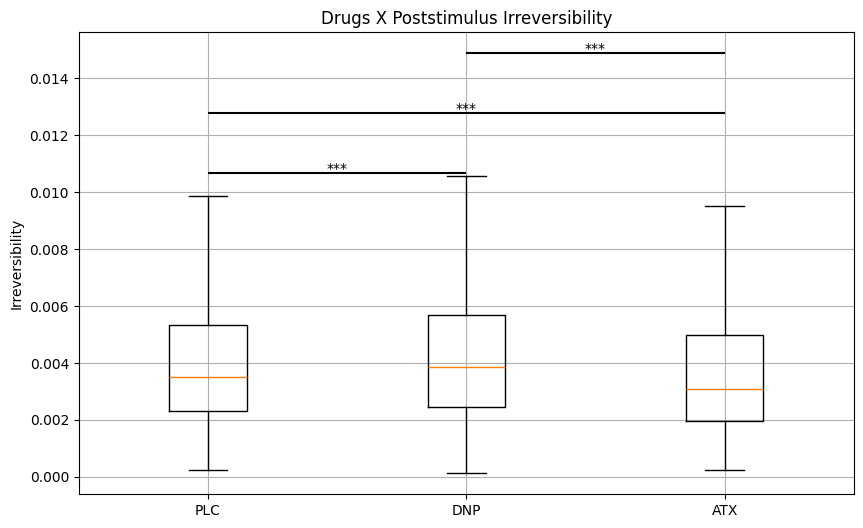

In [259]:
#4/12/2024-- TRY THIS OUT!!!
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df



irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(behavior[behavior['drug'] == drug]['poststim_irrev'])

# Creating the boxplot with improved clarity
plt.figure(figsize=(10, 6))
box = plt.boxplot(irrev_sub_plc, positions=np.arange(len(drugs)), showfliers=False)
plt.xticks(np.arange(len(drugs)), drugs)
plt.ylabel('Irreversibility')
plt.title('Drugs X Poststimulus Irreversibility')
plt.grid(True)


# Mann-Whitney U tests across drugs with corrections

p_values = []
comparisons = []

for i in range(len(irrev_sub_plc)):
    for j in range(i + 1, len(irrev_sub_plc)):
        stat, p = stats.mannwhitneyu(irrev_sub_plc[i], irrev_sub_plc[j], alternative='two-sided')
        p_values.append(p)
        comparisons.append((drugs[i], drugs[j]))

corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]

# Annotating significant differences
max_y = max([item.get_data()[1].max() for item in box['caps']])  # Find the maximum y-value of the whiskers
y_offset = max_y * 0.1  # Slightly above the highest whisker
for i, (comp, corrected_p_val) in enumerate(zip(comparisons, corrected_p_values)):
    x1, x2 = drugs.index(comp[0]), drugs.index(comp[1])
    # Decide number of asterisks based on significance level
    if corrected_p_val < 0.001:
        num_asterisks = '***'
    elif corrected_p_val < 0.01:
        num_asterisks = '**'
    elif corrected_p_val < 0.05:
        num_asterisks = '*'
    else:
        num_asterisks = ''

    if num_asterisks:  # Only draw if there's a significant result
        plt.hlines((max_y+max_y*0.01) + y_offset * i * 2, x1, x2, color="black")
        plt.text((x1 + x2) / 2, max_y + y_offset * (i * 2), num_asterisks, ha='center', va='bottom', color='black')

plt.show()


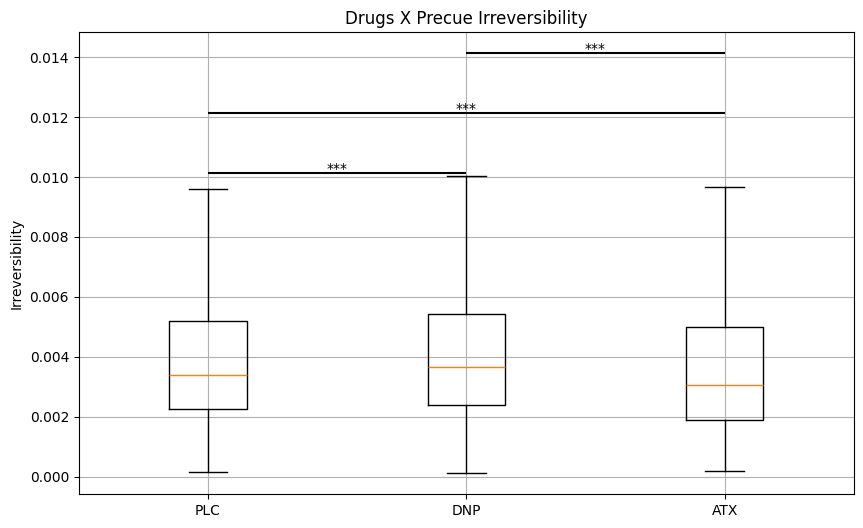

In [260]:
#4/12/2024-- TRY THIS OUT!!!
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(behavior[behavior['drug'] == drug]['precue_irrev'])

# Creating the boxplot with improved clarity
plt.figure(figsize=(10, 6))
box = plt.boxplot(irrev_sub_plc, positions=np.arange(len(drugs)), showfliers=False)
plt.xticks(np.arange(len(drugs)), drugs)
plt.ylabel('Irreversibility')
plt.title('Drugs X Precue Irreversibility')
plt.grid(True)


# Mann-Whitney U tests across drugs with corrections

p_values = []
comparisons = []

for i in range(len(irrev_sub_plc)):
    for j in range(i + 1, len(irrev_sub_plc)):
        stat, p = stats.mannwhitneyu(irrev_sub_plc[i], irrev_sub_plc[j], alternative='two-sided')
        p_values.append(p)
        comparisons.append((drugs[i], drugs[j]))

corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]

# Annotating significant differences
max_y = max([item.get_data()[1].max() for item in box['caps']])  # Find the maximum y-value of the whiskers
y_offset = max_y * 0.1  # Slightly above the highest whisker
for i, (comp, corrected_p_val) in enumerate(zip(comparisons, corrected_p_values)):
    x1, x2 = drugs.index(comp[0]), drugs.index(comp[1])
    # Decide number of asterisks based on significance level
    if corrected_p_val < 0.001:
        num_asterisks = '***'
    elif corrected_p_val < 0.01:
        num_asterisks = '**'
    elif corrected_p_val < 0.05:
        num_asterisks = '*'
    else:
        num_asterisks = ''

    if num_asterisks:  # Only draw if there's a significant result
        plt.hlines((max_y+max_y*0.01) + y_offset * i * 2, x1, x2, color="black")
        plt.text((x1 + x2) / 2, max_y + y_offset * (i * 2), num_asterisks, ha='center', va='bottom', color='black')

plt.show()


### std dev of pre stim per drug

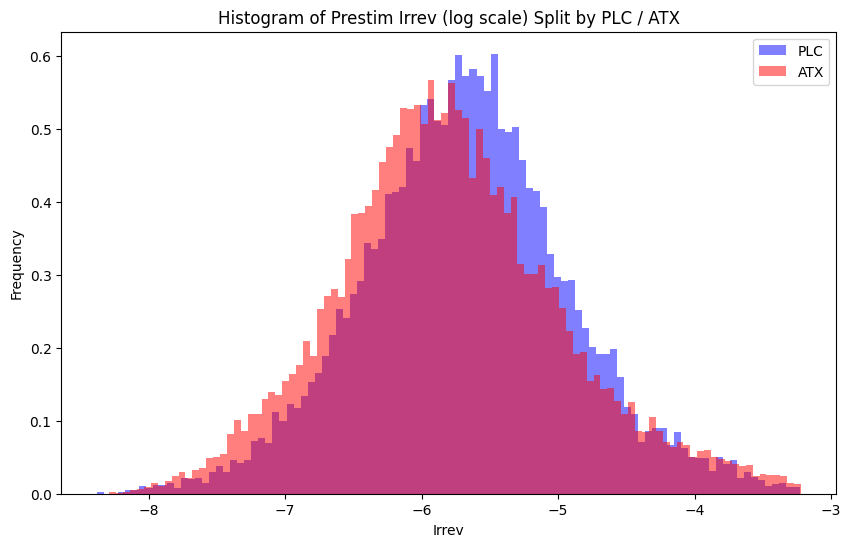

122260432.0
2.6874741534284297e-56
Mean PLC pre: 0.004627357551105664
Mean ATX pre: 0.004381857131626193
The std dev of the PLC Pre values in the pretty histogram (logged irrev values): 0.7617845444438743
The std dev of the ATX Pre values in the pretty histogram (logged irrev values): 0.8253027519750696
The std dev of the PLC values of raw: 0.004311435877165735
The std dev of the ATX values of raw: 0.004785451609578805


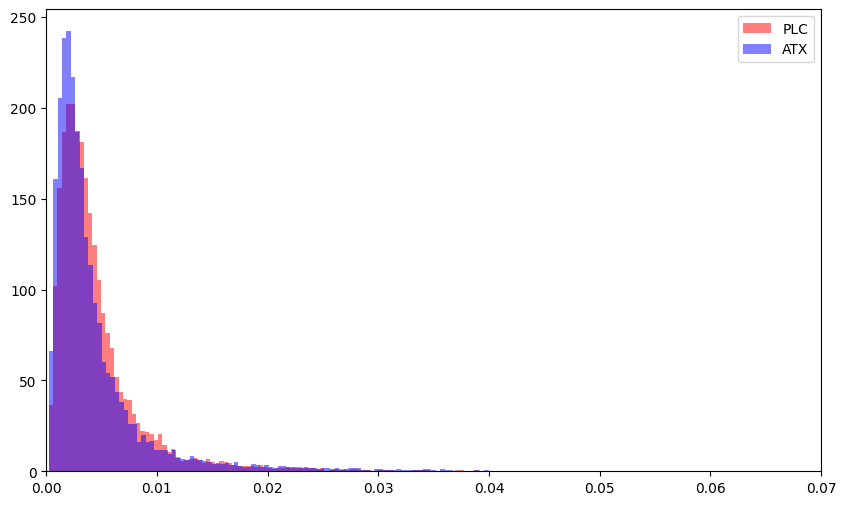

F test-- F-statistic: 0.8117064456424893, p-value: 0.9999999999999999
F test-- F-statistic: 1.2319724764640385, p-value: 0.9999999999999999
Levene's test statistic in raw: 3.615097926308762, p-value: 0.05726700564406538
Brown-Forsythe test statistic in raw: 3.615097926308762, p-value: 0.05726700564406538
Levene's test statistic in logged: 73.56973130442107, p-value: 1.0178189670854478e-17
Brown-Forsythe test statistic in logged: 73.56973130442107, p-value: 1.0178189670854478e-17


In [34]:

behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['drug']=='PLC']['prestim_irrev']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='PLC', color='blue', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['drug']=='ATX']['prestim_irrev']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='ATX', color='red', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestim Irrev (log scale) Split by PLC / ATX')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean PLC pre: "+str(np.mean(correct_irrev)))
print("Mean ATX pre: "+str(np.mean(incorrect_irrev)))
print("The std dev of the PLC Pre values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the ATX Pre values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the PLC values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the ATX values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = correct_irrev
group2 = incorrect_irrev

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='PLC', color='red', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='ATX', color='blue', density = True)
plt.legend()
plt.xlim(0,0.07)
plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")




In [ ]:

behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.05) & (behavior['prestim_irrev'] < 0.05)]

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['drug']=='PLC']['prestim_irrev']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='PLC', color='blue', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['drug']=='DNP']['prestim_irrev']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='DNP', color='red', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestim Irrev (log scale) Split by PLC / DNP')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean PLC pre: "+str(np.mean(correct_irrev)))
print("Mean DNP pre: "+str(np.mean(incorrect_irrev)))
print("The std dev of the PLC Pre values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the DNP Pre values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the PLC values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the DNP values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = correct_irrev
group2 = incorrect_irrev

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=2000, alpha=0.5, label='PLC', color='red', density = True)
plt.hist(group2, bins=1000, alpha=0.5, label='DNP', color='blue', density = True)
plt.legend()
plt.xlim(0,0.018)
plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")




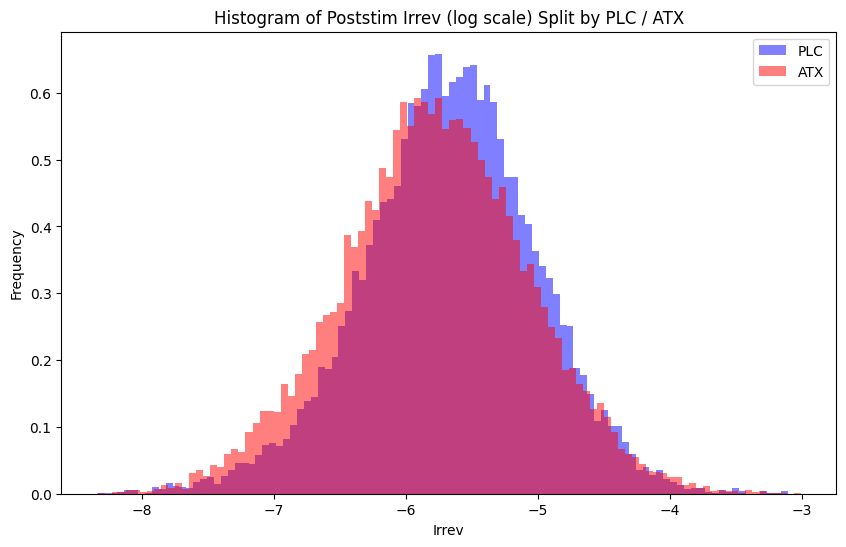

121865719.0
2.0007306480063003e-49
Mean PLC pre: 0.004273950400937697
Mean ATX pre: 0.003981965421043396
The std dev of the PLC Post values in the pretty histogram (logged irrev values): 0.6560628402088963
The std dev of the ATX Post values in the pretty histogram (logged irrev values): 0.7100277215211763
The std dev of the PLC values of raw: 0.0031045563873705116
The std dev of the ATX values of raw: 0.0032480865681865255


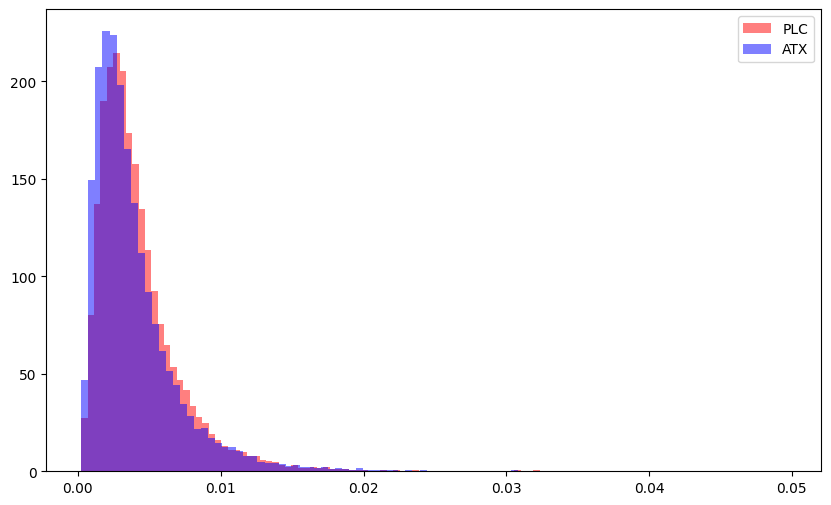

F test-- F-statistic: 0.9135764510425587, p-value: 0.9999999822840728
F test-- F-statistic: 1.0945991425882489, p-value: 0.9999999822840728
Levene's test statistic in raw: 0.9575905048676564, p-value: 0.3278026429482086
Brown-Forsythe test statistic in raw: 0.9575905048676564, p-value: 0.3278026429482086
Levene's test statistic in logged: 96.65618536185391, p-value: 8.933000207656477e-23
Brown-Forsythe test statistic in logged: 96.65618536185391, p-value: 8.933000207656477e-23


In [420]:

behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.05) & (behavior['prestim_irrev'] < 0.05)]

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['drug']=='PLC']['poststim_irrev']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='PLC', color='blue', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['drug']=='ATX']['poststim_irrev']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='ATX', color='red', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Poststim Irrev (log scale) Split by PLC / ATX')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean PLC pre: "+str(np.mean(correct_irrev)))
print("Mean ATX pre: "+str(np.mean(incorrect_irrev)))
print("The std dev of the PLC Post values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the ATX Post values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the PLC values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the ATX values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = correct_irrev
group2 = incorrect_irrev

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='PLC', color='red', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='ATX', color='blue', density = True)
plt.legend()
plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")




stats testing for a pairwise interaction effect on pre vs post variances by ATX vs. PLC

Levene's test for prestimulus variances: stat=0.5486762439750485, p-value=0.45886491863065604
Levene's test for poststimulus variances: stat=0.8343282413676705, p-value=0.3610313376961938
Observed difference of differences: -5.470683297686275e-05
Bootstrap p-value for interaction effect: 0.5611


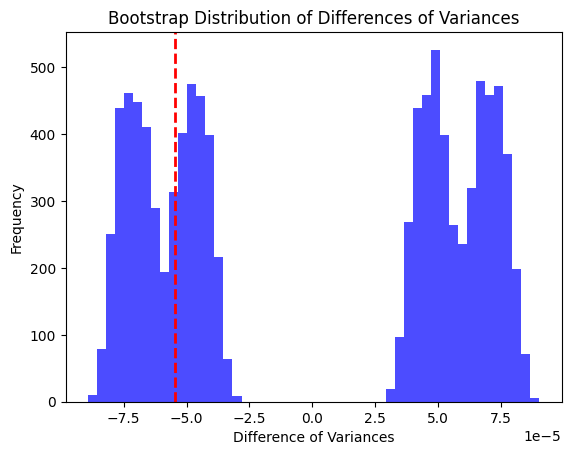

There is no significant interaction effect between drug and time period on variance differences.


In [421]:
import numpy as np
import pandas as pd
from scipy.stats import levene
import matplotlib.pyplot as plt
behavior = df
# Example data
# Replace these arrays with your actual data
prestimulus_placebo = behavior[behavior['drug']=='PLC']['prestim_irrev']
poststimulus_placebo = behavior[behavior['drug']=='PLC']['poststim_irrev']
prestimulus_atomoxetine = behavior[behavior['drug']=='ATX']['prestim_irrev']
poststimulus_atomoxetine = behavior[behavior['drug']=='ATX']['poststim_irrev']

# Calculate variances
var_prestimulus_placebo = np.var(prestimulus_placebo, ddof=1)
var_poststimulus_placebo = np.var(poststimulus_placebo, ddof=1)
var_prestimulus_atomoxetine = np.var(prestimulus_atomoxetine, ddof=1)
var_poststimulus_atomoxetine = np.var(poststimulus_atomoxetine, ddof=1)

# Calculate the differences in variances
diff_placebo = var_poststimulus_placebo - var_prestimulus_placebo
diff_atomoxetine = var_poststimulus_atomoxetine - var_prestimulus_atomoxetine

# Levene's test for equality of variances
stat_prestimulus, p_prestimulus = levene(prestimulus_placebo, prestimulus_atomoxetine)
stat_poststimulus, p_poststimulus = levene(poststimulus_placebo, poststimulus_atomoxetine)

print(f"Levene's test for prestimulus variances: stat={stat_prestimulus}, p-value={p_prestimulus}")
print(f"Levene's test for poststimulus variances: stat={stat_poststimulus}, p-value={p_poststimulus}")

# Bootstrapping to test interaction effect
def bootstrap_diff_var(data1, data2, n_bootstrap=10000):
    bootstrapped_diffs = []
    combined = np.concatenate([data1, data2])
    n1 = len(data1)
    for _ in range(n_bootstrap):
        np.random.shuffle(combined)
        boot1 = combined[:n1]
        boot2 = combined[n1:]
        var_diff = np.var(boot2, ddof=1) - np.var(boot1, ddof=1)
        bootstrapped_diffs.append(var_diff)
    return np.array(bootstrapped_diffs)

# Bootstrapping the differences in variances
boot_diff_placebo = bootstrap_diff_var(prestimulus_placebo, poststimulus_placebo)
boot_diff_atomoxetine = bootstrap_diff_var(prestimulus_atomoxetine, poststimulus_atomoxetine)

# Calculate observed difference in differences
observed_diff_of_diffs = diff_atomoxetine - diff_placebo

# Calculate the bootstrap distribution of differences
bootstrap_diff_of_diffs = boot_diff_atomoxetine - boot_diff_placebo

# Calculate p-value
p_value = np.mean(np.abs(bootstrap_diff_of_diffs) >= np.abs(observed_diff_of_diffs))

print(f"Observed difference of differences: {observed_diff_of_diffs}")
print(f"Bootstrap p-value for interaction effect: {p_value}")

# Plot the bootstrap distribution
plt.hist(bootstrap_diff_of_diffs, bins=50, alpha=0.7, color='blue')
plt.axvline(observed_diff_of_diffs, color='red', linestyle='dashed', linewidth=2)
plt.title('Bootstrap Distribution of Differences of Variances')
plt.xlabel('Difference of Variances')
plt.ylabel('Frequency')
plt.show()

if p_value < 0.05:
    print("There is a significant interaction effect between drug and time period on variance differences.")
else:
    print("There is no significant interaction effect between drug and time period on variance differences.")


### std devs by trial -- post-pre

c:\Users\jaket\anaconda3\envs\deco1\lib\site-packages\pandas\core\arraylike.py:402: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


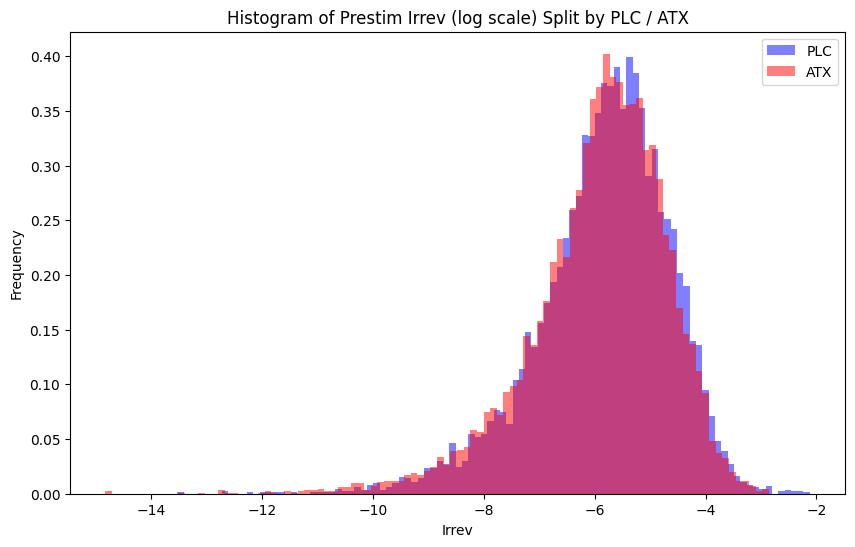

109211517.0
0.022959328270455007
Mean PLC post-pre std dev values: -0.0017172527841617421
Mean ATX post-pre std dev values: -0.0016904113141866294
Median PLC post-pre std dev values: -0.0017172527841617421
Median ATX post-pre std dev values: -0.0016904113141866294
The std dev of the PLC post-pre std dev values : 0.011985247435327685
The std dev of the ATX post-pre std dev values : 0.01177687031757605


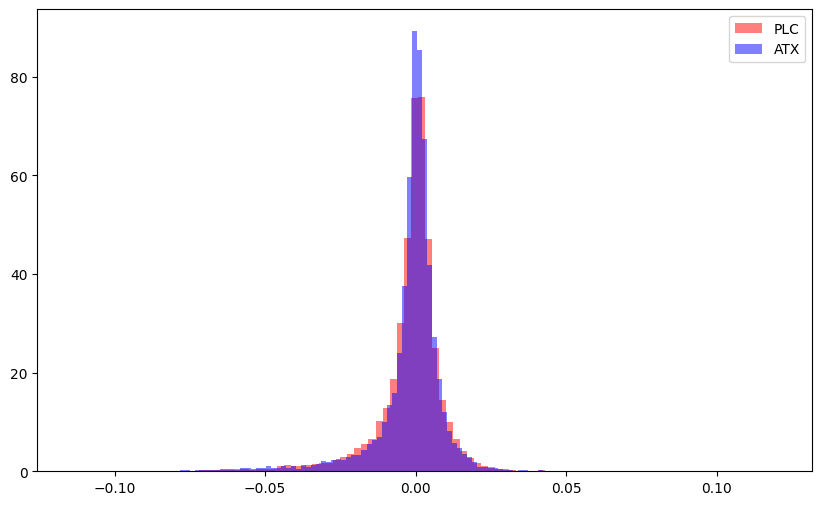

F test-- F-statistic: 1.0357029335638217, p-value: 0.9838439729183828
F test-- F-statistic: 0.9655278242372367, p-value: 0.9838439729183828
Levene's test statistic in raw: 11.589380568525163, p-value: 0.0006641688957737596
Brown-Forsythe test statistic in raw: 11.589380568525163, p-value: 0.0006641688957737596
Levene's test statistic in logged: nan, p-value: nan
Brown-Forsythe test statistic in logged: nan, p-value: nan


In [78]:
behavior = df

list1 = [np.std(matrix) for matrix in behavior['prestim_ref_mat']]
pre_std_devs = np.array(list1)

list2 = [np.std(matrix) for matrix in behavior['poststim_ref_mat']]
post_std_devs = np.array(list2)

behavior['stim_diff_stddevs'] = post_std_devs - pre_std_devs

behavior = behavior[(behavior['poststim_irrev'] < 0.05) & (behavior['prestim_irrev'] < 0.05)]

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['drug']=='PLC']['stim_diff_stddevs']
plt.hist(correct_irrev, bins=100, alpha=0.5, label='PLC', color='blue', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['drug']=='ATX']['stim_diff_stddevs']
plt.hist(incorrect_irrev, bins=100, alpha=0.5, label='ATX', color='red', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestim Irrev (log scale) Split by PLC / ATX')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean PLC post-pre std dev values: "+str(np.mean(correct_irrev)))
print("Mean ATX post-pre std dev values: "+str(np.mean(incorrect_irrev)))
print("Median PLC post-pre std dev values: "+str(np.median(correct_irrev)))
print("Median ATX post-pre std dev values: "+str(np.median(incorrect_irrev)))
print("The std dev of the PLC post-pre std dev values : "+str(np.std(correct_irrev)))
print("The std dev of the ATX post-pre std dev values : "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = correct_irrev
group2 = incorrect_irrev

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='PLC', color='red', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='ATX', color='blue', density = True)
plt.legend()
plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")




try plotting pre and post

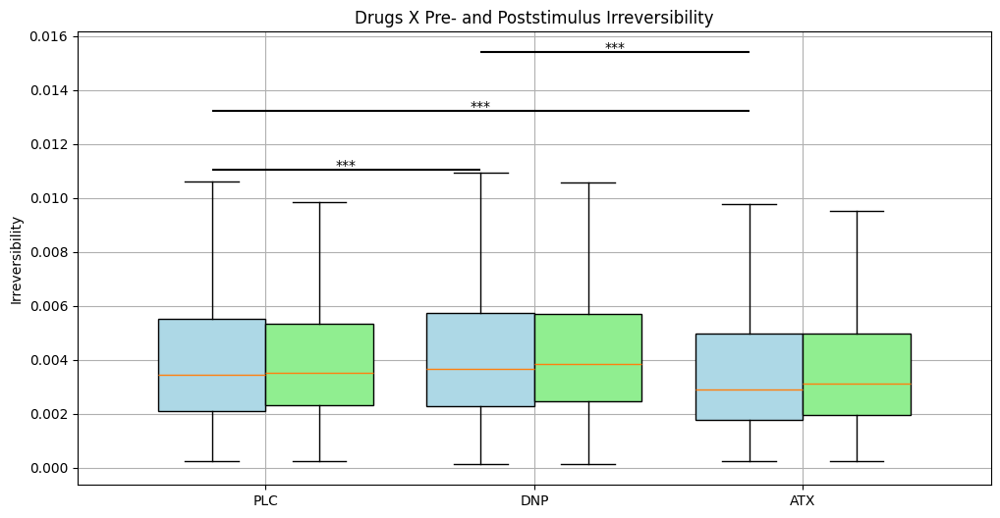

In [262]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

irrev_sub_plc = []
poststim_irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(behavior[behavior['drug'] == drug]['prestim_irrev'])
    poststim_irrev_sub_plc.append(behavior[behavior['drug'] == drug]['poststim_irrev'])

# Creating the boxplot with improved clarity
plt.figure(figsize=(12, 6))

# Define positions for the boxplots
positions = np.arange(len(drugs))
positions_post = positions + 0.4  # Slightly shift the positions for poststimulus values

# Plot prestimulus values
box_prestim = plt.boxplot(irrev_sub_plc, positions=positions, widths=0.4, patch_artist=True, showfliers=False, boxprops=dict(facecolor='lightblue'))
# Plot poststimulus values
box_poststim = plt.boxplot(poststim_irrev_sub_plc, positions=positions_post, widths=0.4, patch_artist=True, showfliers=False, boxprops=dict(facecolor='lightgreen'))

plt.xticks(positions + 0.2, drugs)  # Adjust x-ticks to be centered
plt.ylabel('Irreversibility')
plt.title('Drugs X Pre- and Poststimulus Irreversibility')
plt.grid(True)

# Mann-Whitney U tests across drugs with corrections for prestimulus values
p_values_prestim = []
comparisons_prestim = []

for i in range(len(irrev_sub_plc)):
    for j in range(i + 1, len(irrev_sub_plc)):
        stat, p = stats.mannwhitneyu(irrev_sub_plc[i], irrev_sub_plc[j], alternative='two-sided')
        p_values_prestim.append(p)
        comparisons_prestim.append((drugs[i], drugs[j]))

corrected_p_values_prestim = multipletests(p_values_prestim, alpha=0.05, method='bonferroni')[1]

# Annotating significant differences for prestimulus values
max_y_prestim = max([item.get_data()[1].max() for item in box_prestim['caps']])  # Find the maximum y-value of the whiskers
y_offset_prestim = max_y_prestim * 0.1  # Slightly above the highest whisker

for i, (comp, corrected_p_val) in enumerate(zip(comparisons_prestim, corrected_p_values_prestim)):
    x1, x2 = drugs.index(comp[0]), drugs.index(comp[1])
    # Decide number of asterisks based on significance level
    if corrected_p_val < 0.001:
        num_asterisks = '***'
    elif corrected_p_val < 0.01:
        num_asterisks = '**'
    elif corrected_p_val < 0.05:
        num_asterisks = '*'
    else:
        num_asterisks = ''

    if num_asterisks:  # Only draw if there's a significant result
        plt.hlines((max_y_prestim+max_y_prestim*0.01) + y_offset_prestim * i * 2, x1, x2, color="black")
        plt.text((x1 + x2) / 2, max_y_prestim + y_offset_prestim * (i * 2), num_asterisks, ha='center', va='bottom', color='black')

# Mann-Whitney U tests across drugs with corrections for poststimulus values
p_values_poststim = []
comparisons_poststim = []

for i in range(len(poststim_irrev_sub_plc)):
    for j in range(i + 1, len(poststim_irrev_sub_plc)):
        stat, p = stats.mannwhitneyu(poststim_irrev_sub_plc[i], poststim_irrev_sub_plc[j], alternative='two-sided')
        p_values_poststim.append(p)
        comparisons_poststim.append((drugs[i], drugs[j]))

corrected_p_values_poststim = multipletests(p_values_poststim, alpha=0.05, method='bonferroni')[1]

# Annotating significant differences for poststimulus values


plt.show()


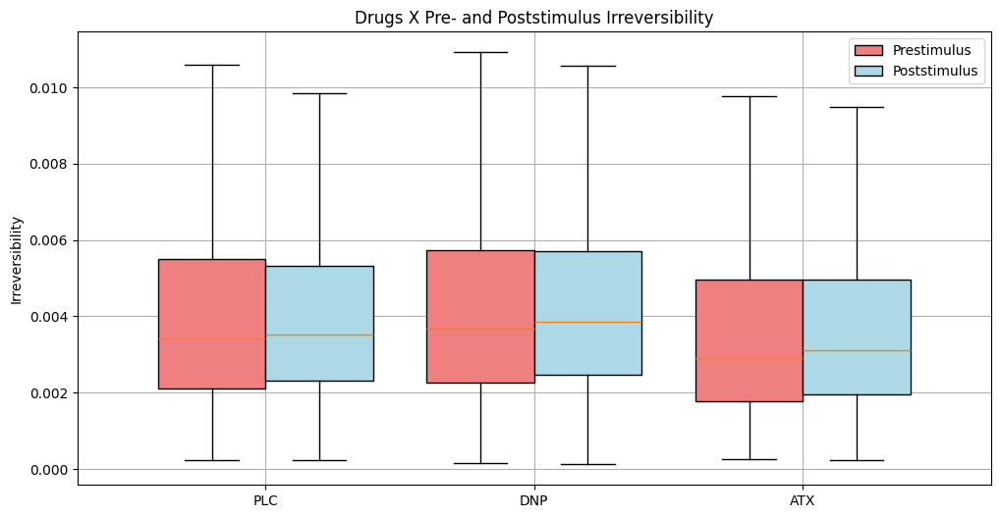

In [265]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

irrev_sub_plc = []
poststim_irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(behavior[behavior['drug'] == drug]['prestim_irrev'])
    poststim_irrev_sub_plc.append(behavior[behavior['drug'] == drug]['poststim_irrev'])

# Creating the boxplot with improved clarity
plt.figure(figsize=(12, 6))

# Define positions for the boxplots
positions = np.arange(len(drugs))
positions_post = positions + 0.4  # Slightly shift the positions for poststimulus values

# Plot prestimulus values
box_prestim = plt.boxplot(irrev_sub_plc, positions=positions, widths=0.4, patch_artist=True, showfliers=False,
                          boxprops=dict(facecolor='lightcoral'))
# Plot poststimulus values
box_poststim = plt.boxplot(poststim_irrev_sub_plc, positions=positions_post, widths=0.4, patch_artist=True, showfliers=False,
                           boxprops=dict(facecolor='lightblue'))

plt.xticks(positions + 0.2, drugs)  # Adjust x-ticks to be centered
plt.ylabel('Irreversibility')
plt.title('Drugs X Pre- and Poststimulus Irreversibility')
plt.grid(True)

# Add legend
plt.legend([box_prestim["boxes"][0], box_poststim["boxes"][0]], ['Prestimulus', 'Poststimulus'], loc='upper right')

plt.show()


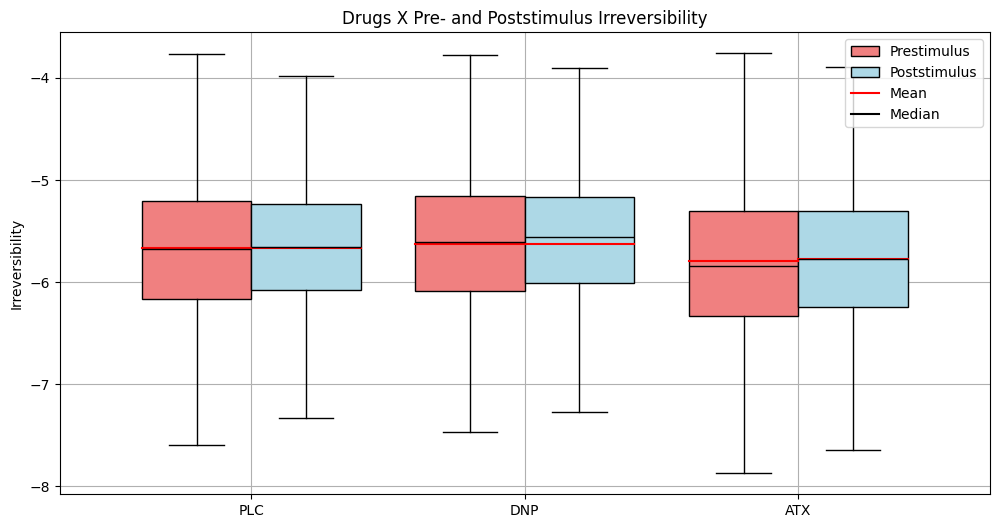

In [142]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

irrev_sub_plc = []
poststim_irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(behavior[behavior['drug'] == drug]['log_prestim'])
    poststim_irrev_sub_plc.append(behavior[behavior['drug'] == drug]['log_poststim'])

# Creating the boxplot with improved clarity
plt.figure(figsize=(12, 6))

# Define positions for the boxplots
positions = np.arange(len(drugs))
positions_post = positions + 0.4  # Slightly shift the positions for poststimulus values

# Plot prestimulus values
box_prestim = plt.boxplot(irrev_sub_plc, positions=positions, widths=0.4, patch_artist=True, showfliers=False,
                          boxprops=dict(facecolor='lightcoral'), medianprops=dict(color='black'))

# Plot poststimulus values
box_poststim = plt.boxplot(poststim_irrev_sub_plc, positions=positions_post, widths=0.4, patch_artist=True, showfliers=False,
                           boxprops=dict(facecolor='lightblue'), medianprops=dict(color='black'))

# Plot means as red lines
for i in range(len(drugs)):
    plt.plot([positions[i] - 0.2, positions[i] + 0.2], [np.mean(irrev_sub_plc[i]), np.mean(irrev_sub_plc[i])], color='red')
    plt.plot([positions_post[i] - 0.2, positions_post[i] + 0.2], [np.mean(poststim_irrev_sub_plc[i]), np.mean(poststim_irrev_sub_plc[i])], color='red')

plt.xticks(positions + 0.2, drugs)  # Adjust x-ticks to be centered
plt.ylabel('Irreversibility')
plt.title('Drugs X Pre- and Poststimulus Irreversibility')
plt.grid(True)

# Add legend
plt.legend([box_prestim["boxes"][0], box_poststim["boxes"][0], plt.Line2D([0], [0], color='red'), plt.Line2D([0], [0], color='black')],
           ['Prestimulus', 'Poststimulus', 'Mean', 'Median'], loc='upper right')

plt.show()


Statistic: 110214833.0, P-value: 0.23725880430757473
mean of plc in diff (post-pre): -0.0003775850035369016
mean of atx in diff (post-pre): -0.00047878594764558604
median of plc in diff (post-pre): 0.0001050210959663468
median of atx in diff (post-pre): 0.00013122866857955516


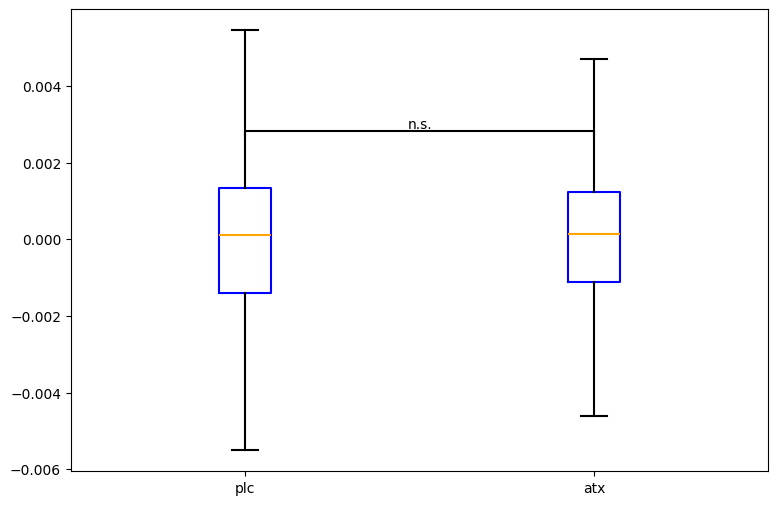

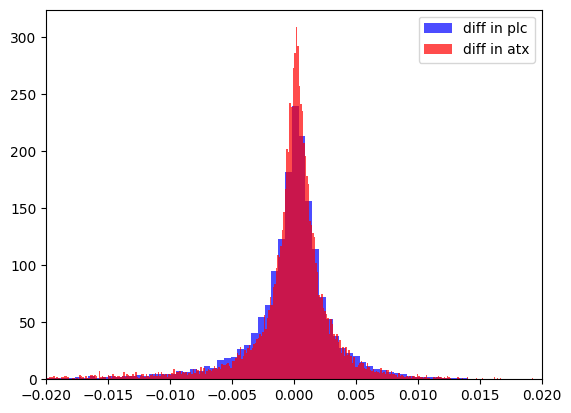

In [139]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


behavior = df
plc = behavior[behavior['drug'] == 'PLC']['stim_diff']
atx = behavior[behavior['drug'] == 'ATX']['stim_diff']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[plc, atx], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['plc', 'atx'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(plc, atx)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(plc, 75)
Q3_group2 = np.percentile(atx, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of plc in diff (post-pre): " + str(np.mean(plc)))
print("mean of atx in diff (post-pre): " + str(np.mean(atx)))
print("median of plc in diff (post-pre): " + str(np.median(plc)))
print("median of atx in diff (post-pre): " + str(np.median(atx)))

plt.show()

plt.hist(plc, bins=2000, color='blue', alpha=0.7, label='diff in plc', density = True)
plt.hist(atx, bins=2000, color='red', alpha=0.7, label='diff in atx', density = True)
plt.xlim(-0.02, 0.02)  # Focus x-axis from 20 to 80
plt.legend()
plt.show()





## 5/22

C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\1632711094.py:9: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  plc = behavior1.groupby('subject').mean()['stim_diff']
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\1632711094.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  atx = behavior2.groupby('subject').mean()['stim_diff']


28
Statistic: 367.0, P-value: 0.6880685751927261
mean of plc in diff (post-pre): -0.00016783934257559688
mean of atx in diff (post-pre): -0.0001648070253816461
median of plc in diff (post-pre): 8.178427957576432e-05
median of atx in diff (post-pre): 0.0001939518958989487


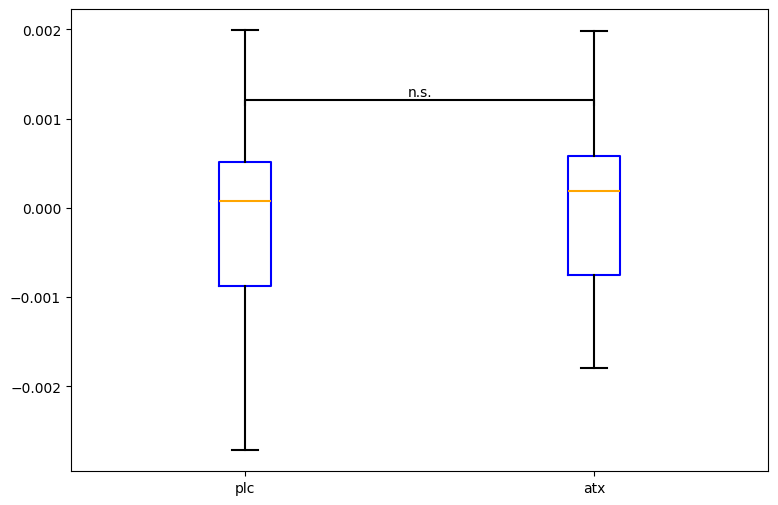

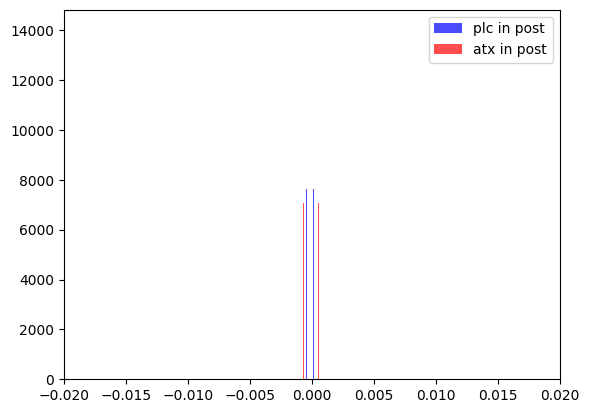

In [30]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.02) & (behavior['prestim_irrev'] < 0.02)]
behavior1 = behavior[behavior['drug'] == 'PLC']
plc = behavior1.groupby('subject').mean()['stim_diff']
behavior2 = behavior[behavior['drug'] == 'ATX']
atx = behavior2.groupby('subject','session','block').mean()['stim_diff']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[plc, atx], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['plc', 'atx'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(plc, atx)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(plc, 75)
Q3_group2 = np.percentile(atx, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of plc in diff (post-pre): " + str(np.mean(plc)))
print("mean of atx in diff (post-pre): " + str(np.mean(atx)))
print("median of plc in diff (post-pre): " + str(np.median(plc)))
print("median of atx in diff (post-pre): " + str(np.median(atx)))

plt.show()

plt.hist(plc, bins=2000, color='blue', alpha=0.7, label='plc in post', density = True)
plt.hist(atx, bins=2000, color='red', alpha=0.7, label='atx in post', density = True)
plt.xlim(-0.02, 0.02)  # Focus x-axis from 20 to 80
plt.legend()
plt.show()



C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\2037056869.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['p'] = behavior[behavior['drug'] == 'PLC']['log_poststim']-behavior[behavior['drug'] == 'PLC']['log_prestim']
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\2037056869.py:10: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  plc = behavior.groupby('subject').mean()['p']
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\2037056869.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc

Statistic: 360.0, P-value: 0.6057249255219442
mean of plc in diff (post-pre): 0.017903392041363746
mean of atx in diff (post-pre): 0.029874521150903225
median of plc in diff (post-pre): 0.05535433870810412
median of atx in diff (post-pre): 0.07917593767004838


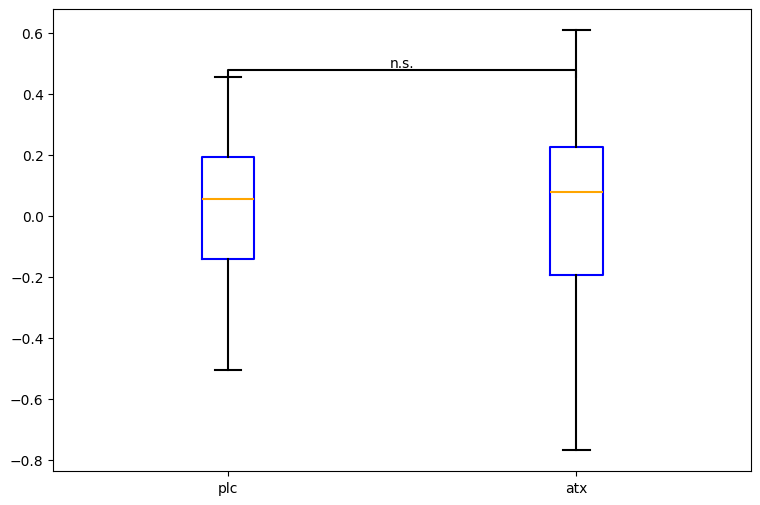

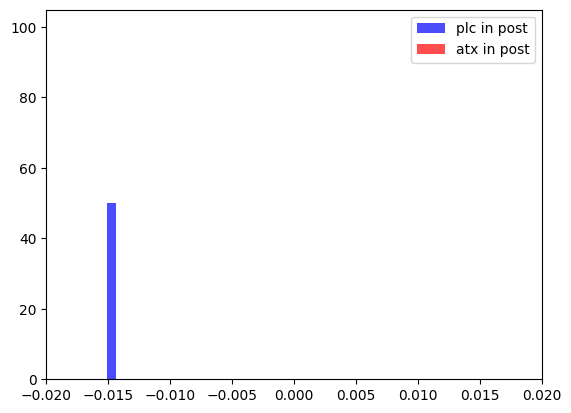

In [32]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.02) & (behavior['prestim_irrev'] < 0.02)]

behavior['p'] = behavior[behavior['drug'] == 'PLC']['log_poststim']-behavior[behavior['drug'] == 'PLC']['log_prestim']
plc = behavior.groupby('subject').mean()['p']
behavior['a'] = behavior[behavior['drug'] == 'ATX']['log_poststim']-behavior[behavior['drug'] == 'ATX']['log_prestim']
atx = behavior.groupby('subject').mean()['a']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[plc, atx], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['plc', 'atx'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(plc, atx)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(plc, 75)
Q3_group2 = np.percentile(atx, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of plc in diff (post-pre): " + str(np.mean(plc)))
print("mean of atx in diff (post-pre): " + str(np.mean(atx)))
print("median of plc in diff (post-pre): " + str(np.median(plc)))
print("median of atx in diff (post-pre): " + str(np.median(atx)))

plt.show()



## Scatter of prestim irrev and pupil size

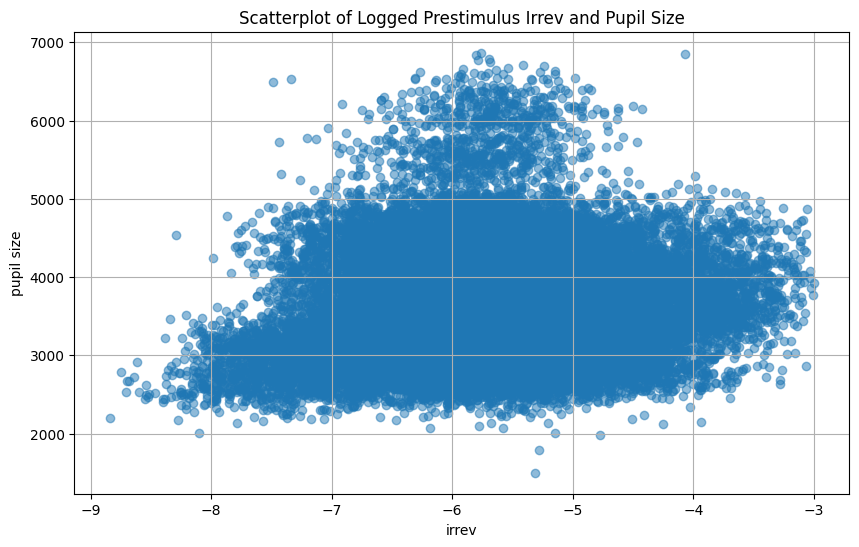

In [89]:
behavior = df

behavior = behavior[(behavior['poststim_irrev'] < 0.02) & (behavior['prestim_irrev'] < 0.05)]
plt.figure(figsize=(10, 6))
plt.scatter(behavior['log_prestim'], behavior['bl_pupil'], alpha=0.5)

plt.xlabel('irrev')
plt.ylabel('pupil size')
plt.title('Scatterplot of Logged Prestimulus Irrev and Pupil Size')
plt.grid(True)
plt.show()


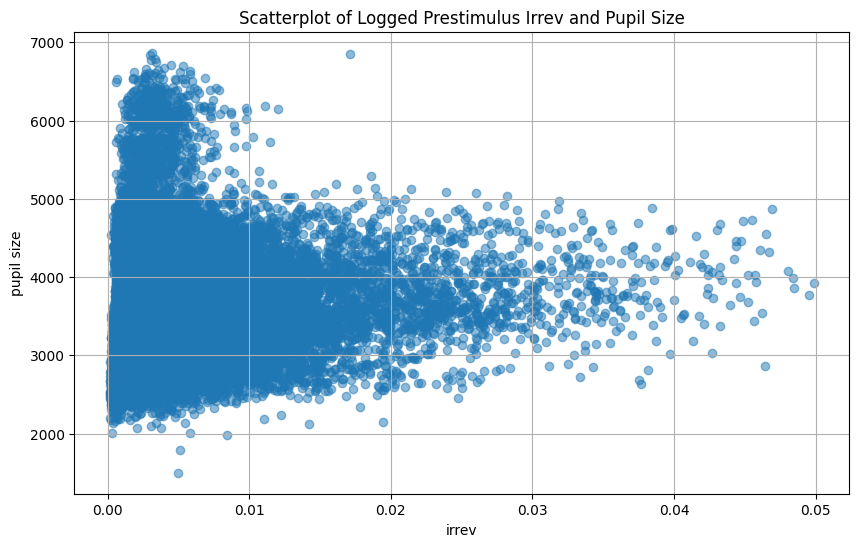

In [90]:
behavior = df

behavior = behavior[(behavior['poststim_irrev'] < 0.02) & (behavior['prestim_irrev'] < 0.05)]
plt.figure(figsize=(10, 6))
plt.scatter(behavior['prestim_irrev'], behavior['bl_pupil'], alpha=0.5)

plt.xlabel('irrev')
plt.ylabel('pupil size')
plt.title('Scatterplot of Logged Prestimulus Irrev and Pupil Size')
plt.grid(True)
plt.show()


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


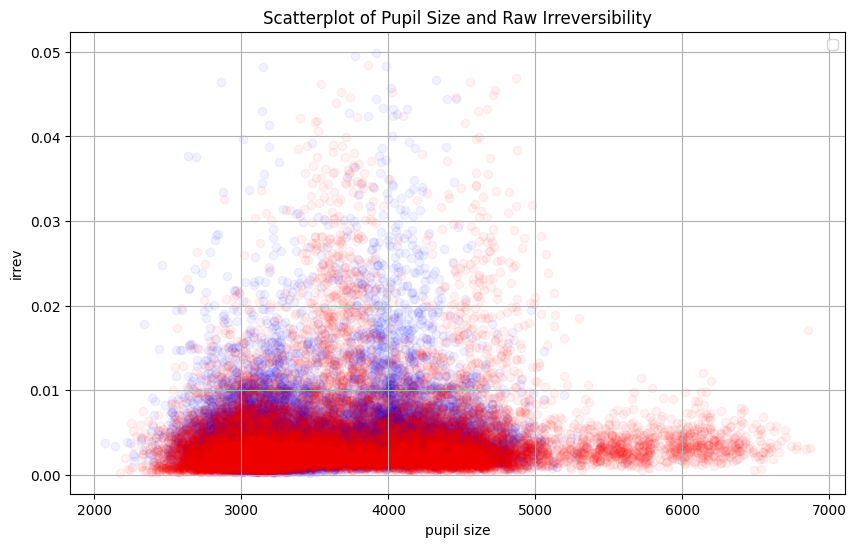

In [112]:
behavior = df
behavior1 = behavior[behavior['prestim_irrev'] < 0.05]
behavior1 = behavior1[behavior1['drug'] == 'PLC']
plt.figure(figsize=(10, 6))
plt.scatter(behavior1['bl_pupil'], behavior1['prestim_irrev'], color = 'blue', alpha=0.05)

behavior2 = behavior[behavior['prestim_irrev'] < 0.05]
behavior2 = behavior2[behavior2['drug'] == 'ATX']
plt.scatter(behavior2['bl_pupil'], behavior2['prestim_irrev'], color = 'red', alpha=0.05)


plt.ylabel('irrev')
plt.xlabel('pupil size')
plt.title('Scatterplot of Pupil Size and Raw Irreversibility')
plt.legend()
plt.grid(True)
plt.show()


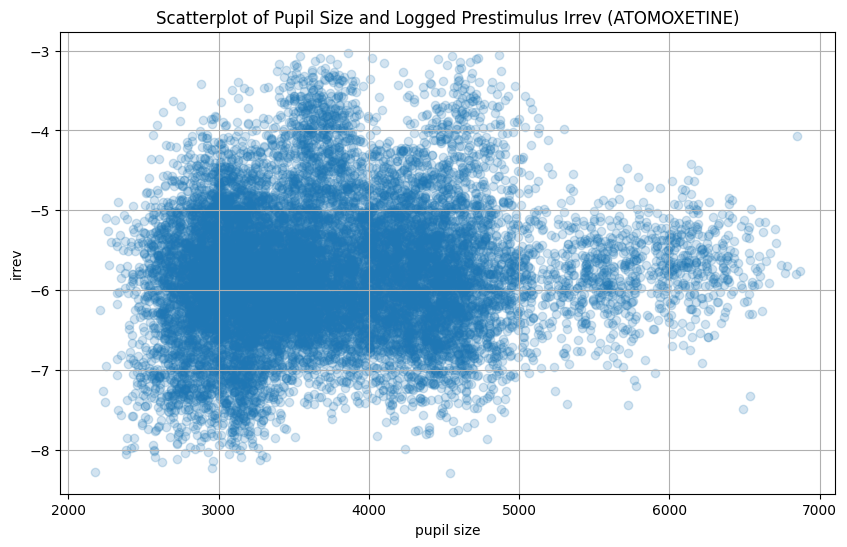

In [116]:
behavior = df
behavior = behavior[behavior['drug'] == 'ATX']
behavior = behavior[behavior['prestim_irrev'] < 0.05]
plt.figure(figsize=(10, 6))
plt.scatter(behavior['bl_pupil'], behavior['log_prestim'], alpha=0.2)

plt.ylabel('irrev')
plt.xlabel('pupil size')
plt.title('Scatterplot of Pupil Size and Logged Prestimulus Irrev (ATOMOXETINE)')
plt.grid(True)
plt.show()


C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\1123003111.py:4: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  irrev = behavior.groupby('subject').mean()['log_prestim']
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\1123003111.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  pupil = behavior.groupby('subject').mean()['bl_pupil']


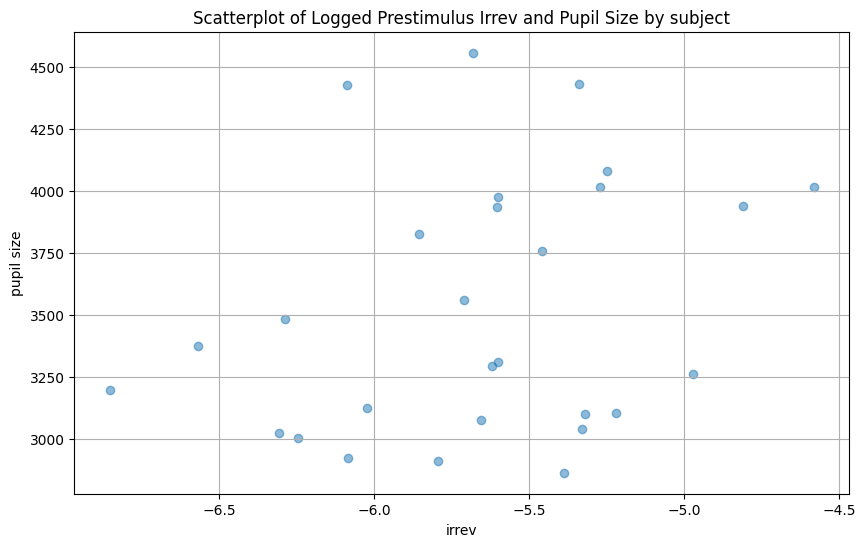

In [5]:
behavior = df


irrev = behavior.groupby('subject').mean()['log_prestim']
pupil = behavior.groupby('subject').mean()['bl_pupil']

plt.figure(figsize=(10, 6))
plt.scatter(irrev, pupil, alpha=0.5)

plt.xlabel('irrev')
plt.ylabel('pupil size')
plt.title('Scatterplot of Logged Prestimulus Irrev and Pupil Size by subject')
plt.grid(True)
plt.show()


C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\3485188468.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  irrev = behavior.groupby('subject').mean()['log_prestim']
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\3485188468.py:4: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  pupil = behavior.groupby('subject').mean()['bl_pupil']


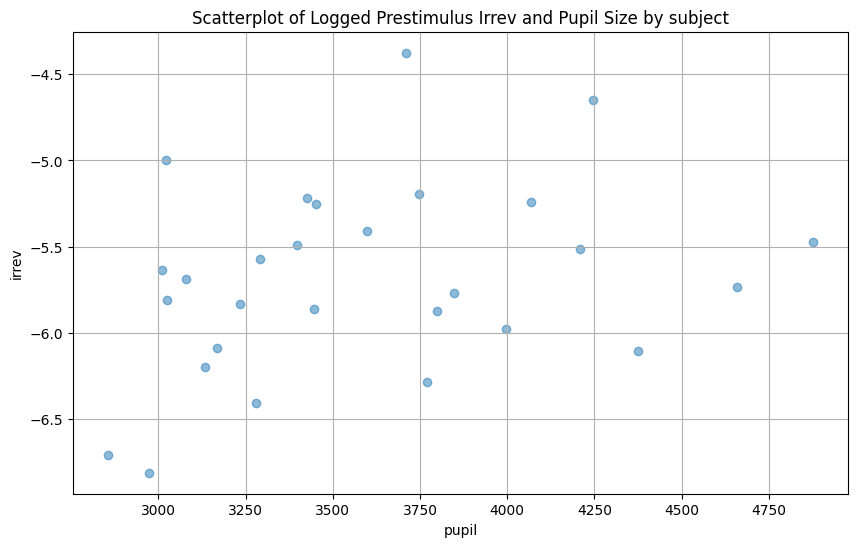

In [94]:
behavior = df

irrev = behavior.groupby('subject').mean()['log_prestim']
pupil = behavior.groupby('subject').mean()['bl_pupil']

plt.figure(figsize=(10, 6))
plt.scatter(pupil, irrev, alpha=0.5)

plt.xlabel('pupil')
plt.ylabel('irrev')
plt.title('Scatterplot of Logged Prestimulus Irrev and Pupil Size by subject')
plt.grid(True)
plt.show()


C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\4150919745.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  irrev = behavior.groupby(['subject','session']).mean()['prestim_irrev']
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\4150919745.py:4: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  pupil = behavior.groupby(['subject','session']).mean()['bl_pupil']


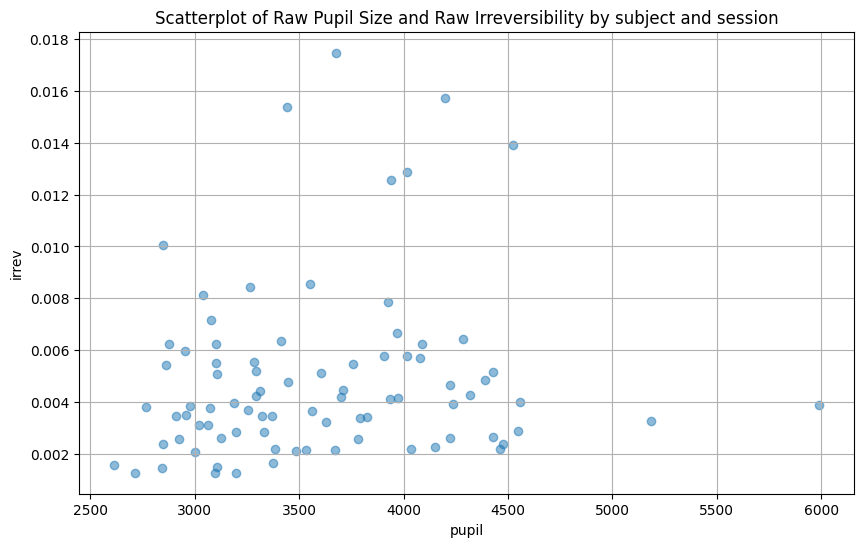

In [98]:
behavior = df

irrev = behavior.groupby(['subject','session']).mean()['prestim_irrev']
pupil = behavior.groupby(['subject','session']).mean()['bl_pupil']

plt.figure(figsize=(10, 6))
plt.scatter(pupil, irrev, alpha=0.5)

plt.xlabel('pupil')
plt.ylabel('irrev')
plt.title('Scatterplot of Raw Pupil Size and Raw Irreversibility by subject and session')
plt.grid(True)
plt.show()


C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\2403980803.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  pupil = behavior.groupby(['subject','session','block']).mean()['bl_pupil']
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\2403980803.py:2: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  irrev = behavior.groupby(['subject','session','block']).mean()['log_prestim']


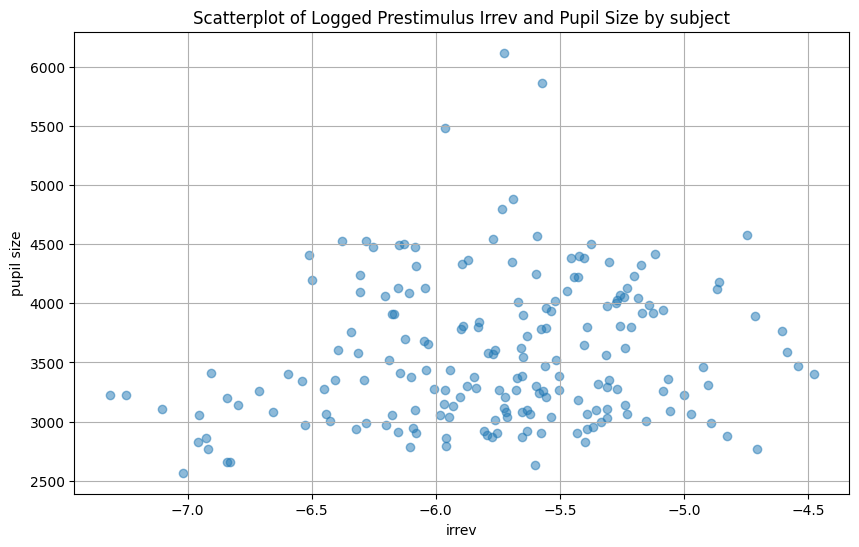

In [319]:

pupil = behavior.groupby(['subject','session','block']).mean()['bl_pupil']
irrev = behavior.groupby(['subject','session','block']).mean()['log_prestim']

plt.figure(figsize=(10, 6))
plt.scatter(irrev, pupil, alpha=0.5)

plt.xlabel('irrev')
plt.ylabel('pupil size')
plt.title('Scatterplot of Logged Prestimulus Irrev and Pupil Size by subject')
plt.grid(True)
plt.show()


## comparing ATX and PLC in prestim in one subject

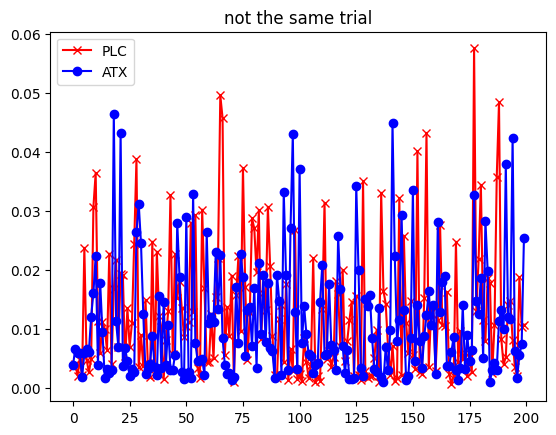

mean of plc (red): 0.01262760415835542
mean of atx (blue): 0.011268222889675286


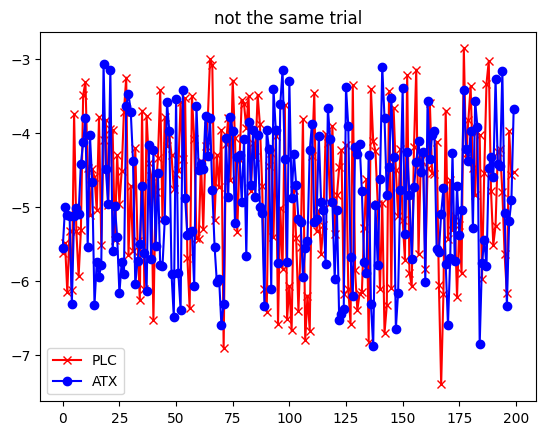

mean of logged plc (red): -4.801971156792891
mean of logged atx (blue): -4.882548402258684


In [7]:
behavior = df
behavior1 = behavior[(behavior['subject'] ==1) & (behavior['drug'] == 'PLC')][0:200].reset_index()
behavior2 = behavior[(behavior['subject'] ==1) & (behavior['drug'] == 'ATX')][0:200].reset_index()

plt.plot(behavior1['prestim_irrev'], label='PLC', marker='x', color = 'red')
plt.plot(behavior2['prestim_irrev'], label='ATX', marker='o', color = 'blue')
plt.title("not the same trial")
plt.legend()
plt.show()
print("mean of plc (red): " + str(np.mean(behavior1['prestim_irrev'])))
print("mean of atx (blue): " + str(np.mean(behavior2['prestim_irrev'])))



# NOW LOGGED
behavior = df
behavior1 = behavior[(behavior['subject'] ==1) & (behavior['drug'] == 'PLC')][0:200].reset_index()
behavior2 = behavior[(behavior['subject'] ==1) & (behavior['drug'] == 'ATX')][0:200].reset_index()

plt.plot(behavior1['log_prestim'], label='PLC', marker='x', color = 'red')
plt.plot(behavior2['log_prestim'], label='ATX', marker='o', color = 'blue')
plt.title("not the same trial")
plt.legend()
plt.show()
print("mean of logged plc (red): " + str(np.mean(behavior1['log_prestim'])))
print("mean of logged atx (blue): " + str(np.mean(behavior2['log_prestim'])))


### outliers removed

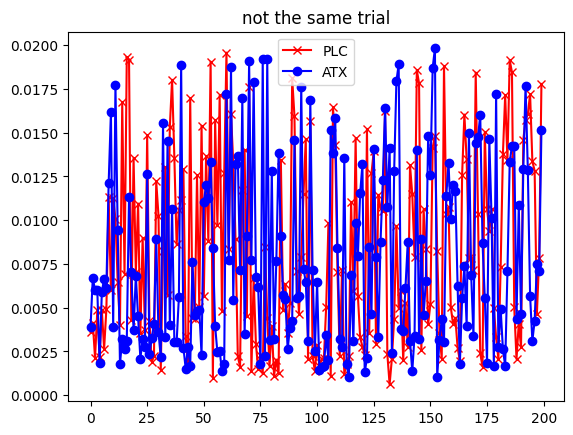

mean of plc (red): 0.008288870338628091
mean of atx (blue): 0.007840111971697183


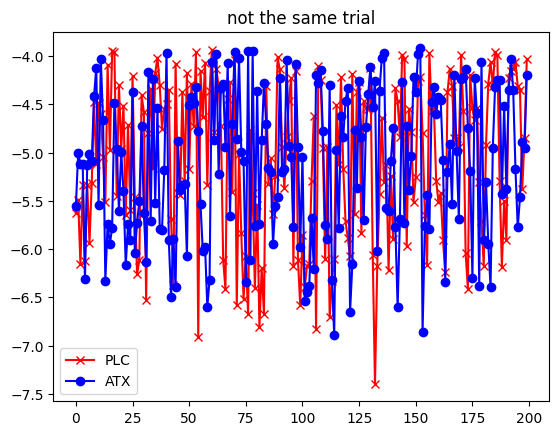

mean of logged plc (red): -5.080692237827178
mean of logged atx (blue): -5.1120424287222015


In [8]:
behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
behavior1 = behavior[(behavior['subject'] ==1) & (behavior['drug'] == 'PLC')][0:200].reset_index()
behavior2 = behavior[(behavior['subject'] ==1) & (behavior['drug'] == 'ATX')][0:200].reset_index()

plt.plot(behavior1['prestim_irrev'], label='PLC', marker='x', color = 'red')
plt.plot(behavior2['prestim_irrev'], label='ATX', marker='o', color = 'blue')
plt.title("not the same trial")
plt.legend()
plt.show()
print("mean of plc (red): " + str(np.mean(behavior1['prestim_irrev'])))
print("mean of atx (blue): " + str(np.mean(behavior2['prestim_irrev'])))



# NOW LOGGED
behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.02) & (behavior['prestim_irrev'] < 0.02)]
behavior1 = behavior[(behavior['subject'] ==1) & (behavior['drug'] == 'PLC')][0:200].reset_index()
behavior2 = behavior[(behavior['subject'] ==1) & (behavior['drug'] == 'ATX')][0:200].reset_index()

plt.plot(behavior1['log_prestim'], label='PLC', marker='x', color = 'red')
plt.plot(behavior2['log_prestim'], label='ATX', marker='o', color = 'blue')
plt.title("not the same trial")
plt.legend()
plt.show()
print("mean of logged plc (red): " + str(np.mean(behavior1['log_prestim'])))
print("mean of logged atx (blue): " + str(np.mean(behavior2['log_prestim'])))



## logged differences

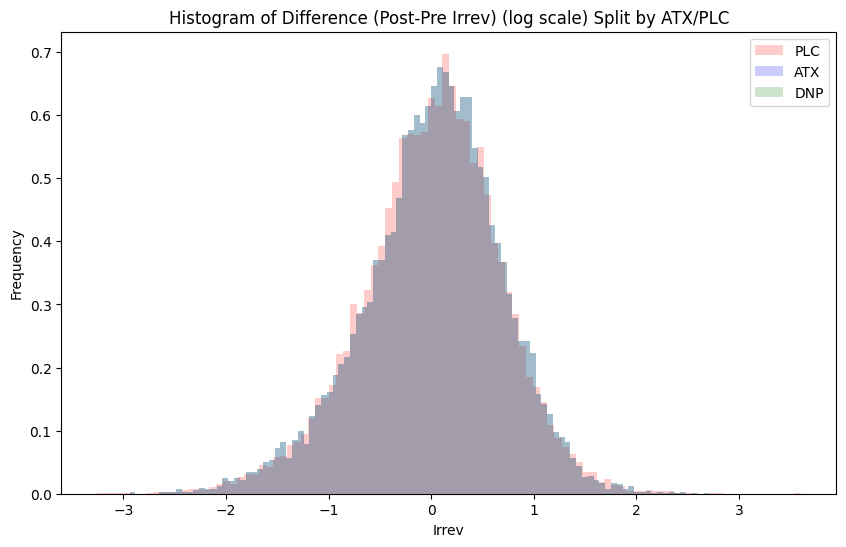

14658
15158
109553594.0
0.03828388871542211
mean of diff (post-pre) in plc: 0.004628996053824732
mean of diff (post-pre) in atx: 0.01610767660353121
median of diff (post-pre) in plc: 0.04110001190624457
median of diff (post-pre) in atx: 0.05946730178255866
mean of diff (post-pre) in dnp: 0.001402728184991873
median of diff (post-pre) in dnp: 0.024467165909575872
The std dev of the PLC DIFFERENCE (post-pre) values in the pretty histogram: 0.6765811473695397
The std dev of the ATX DIFFERENCE (post-pre) values in the pretty histogram: 0.6728624278538122


In [16]:

behavior = df

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
diff_plc = (behavior[behavior['drug'] == 'PLC']['log_poststim']-behavior[behavior['drug'] == 'PLC']['log_prestim'])
plt.hist(diff_plc, bins=100, alpha=0.2, label='PLC', color='red', density = True)

# Histogram for RT when correct is 1
diff_atx = (behavior[behavior['drug'] == 'ATX']['log_poststim']-behavior[behavior['drug'] == 'ATX']['log_prestim'])
plt.hist(diff_atx, bins=100, alpha=0.2, label='ATX', color='blue', density = True)

diff_dnp = (behavior[behavior['drug'] == 'DNP']['log_poststim']-behavior[behavior['drug'] == 'DNP']['log_prestim'])
plt.hist(diff_atx, bins=100, alpha=0.2, label='DNP', color='green', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Difference (Post-Pre Irrev) (log scale) Split by ATX/PLC')
plt.legend()

# Show the plot
plt.show()

print(len(diff_plc))
print(len(diff_atx))
from scipy import stats


t_stat, p_value = mannwhitneyu(diff_plc, diff_atx)

print(t_stat)
print(p_value)

diff_dnp
print("mean of diff (post-pre) in plc: " + str(np.mean(diff_plc)))
print("mean of diff (post-pre) in atx: " + str(np.mean(diff_atx)))
print("median of diff (post-pre) in plc: " + str(np.median(diff_plc)))
print("median of diff (post-pre) in atx: " + str(np.median(diff_atx)))
print("mean of diff (post-pre) in dnp: " + str(np.mean(diff_dnp)))
print("median of diff (post-pre) in dnp: " + str(np.median(diff_dnp)))

print("The std dev of the PLC DIFFERENCE (post-pre) values in the pretty histogram: "+str(np.std(diff_plc)))
print("The std dev of the ATX DIFFERENCE (post-pre) values in the pretty histogram: "+str(np.std(diff_atx)))

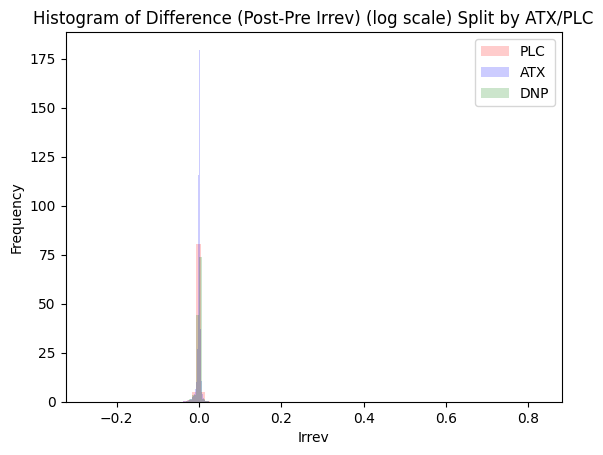

14658
15158
110214833.0
0.23725880430757473
mean of diff (post-pre) in plc: -0.0003775850035369016
mean of diff (post-pre) in atx: -0.00047878594764558604
median of diff (post-pre) in plc: 0.0001050210959663468
median of diff (post-pre) in atx: 0.00013122866857955516
mean of diff (post-pre) in dnp: -0.00044539459422926876
median of diff (post-pre) in dnp: 6.013968077230947e-05


In [19]:
diff_plc = (behavior[behavior['drug'] == 'PLC']['poststim_irrev']-behavior[behavior['drug'] == 'PLC']['prestim_irrev'])
plt.hist(diff_plc, bins=100, alpha=0.2, label='PLC', color='red', density = True)

# Histogram for RT when correct is 1
diff_atx = (behavior[behavior['drug'] == 'ATX']['poststim_irrev']-behavior[behavior['drug'] == 'ATX']['prestim_irrev'])
plt.hist(diff_atx, bins=100, alpha=0.2, label='ATX', color='blue', density = True)

diff_dnp = (behavior[behavior['drug'] == 'DNP']['poststim_irrev']-behavior[behavior['drug'] == 'DNP']['prestim_irrev'])
plt.hist(diff_dnp, bins=100, alpha=0.2, label='DNP', color='green', density = True)

plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Difference (Post-Pre Irrev) (log scale) Split by ATX/PLC')
plt.legend()

# Show the plot
plt.show()

print(len(diff_plc))
print(len(diff_atx))
from scipy import stats


t_stat, p_value = mannwhitneyu(diff_plc, diff_atx)

print(t_stat)
print(p_value)

print("mean of diff (post-pre) in plc: " + str(np.mean(diff_plc)))
print("mean of diff (post-pre) in atx: " + str(np.mean(diff_atx)))
print("median of diff (post-pre) in plc: " + str(np.median(diff_plc)))
print("median of diff (post-pre) in atx: " + str(np.median(diff_atx)))
print("mean of diff (post-pre) in dnp: " + str(np.mean(diff_dnp)))
print("median of diff (post-pre) in dnp: " + str(np.median(diff_dnp)))

### outliers removed

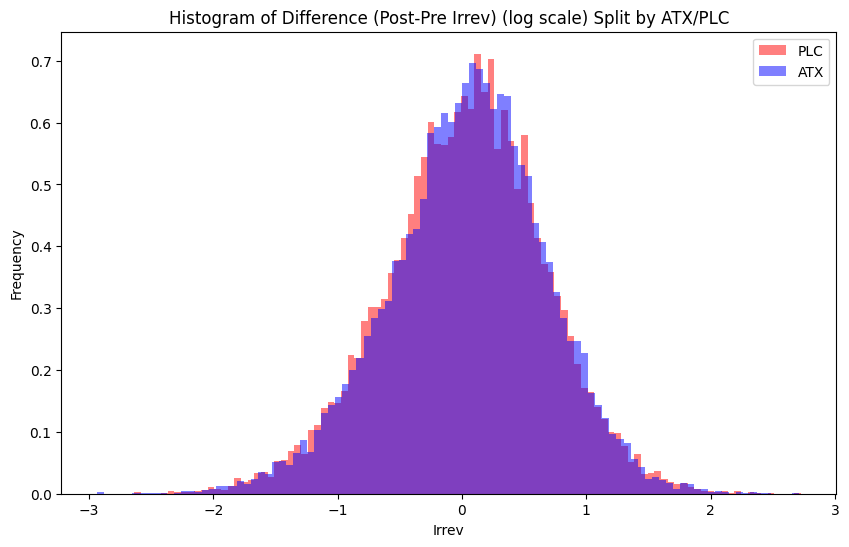

103476290.0
0.003861982060853622
mean of diff (post-pre) in plc: 0.027777149504448664
mean of diff (post-pre) in atx: 0.04723304322271886
median of diff (post-pre) in plc: 0.05361792186471659
median of diff (post-pre) in atx: 0.07451995700194347
The std dev of the PLC DIFFERENCE (post-pre) values in the pretty histogram: 0.6411261958503494
The std dev of the ATX DIFFERENCE (post-pre) values in the pretty histogram: 0.6333685373777018


In [263]:

behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.02) & (behavior['prestim_irrev'] < 0.02)]
# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
diff_plc = (behavior[behavior['drug'] == 'PLC']['log_poststim']-behavior[behavior['drug'] == 'PLC']['log_prestim'])
plt.hist(diff_plc, bins=100, alpha=0.5, label='PLC', color='red', density = True)

# Histogram for RT when correct is 1
diff_atx = (behavior[behavior['drug'] == 'ATX']['log_poststim']-behavior[behavior['drug'] == 'ATX']['log_prestim'])
plt.hist(diff_atx, bins=100, alpha=0.5, label='ATX', color='blue', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Difference (Post-Pre Irrev) (log scale) Split by ATX/PLC')
plt.legend()

# Show the plot
plt.show()


from scipy import stats


t_stat, p_value = mannwhitneyu(diff_plc, diff_atx)

print(t_stat)
print(p_value)


print("mean of diff (post-pre) in plc: " + str(np.mean(diff_plc)))
print("mean of diff (post-pre) in atx: " + str(np.mean(diff_atx)))
print("median of diff (post-pre) in plc: " + str(np.median(diff_plc)))
print("median of diff (post-pre) in atx: " + str(np.median(diff_atx)))

print("The std dev of the PLC DIFFERENCE (post-pre) values in the pretty histogram: "+str(np.std(diff_plc)))
print("The std dev of the ATX DIFFERENCE (post-pre) values in the pretty histogram: "+str(np.std(diff_atx)))

In [9]:
print("Mean correct: " + str(np.mean(behavior['stim_diff'])))


Mean correct: -8.873752251046579e-05


## Bins for comparing plc and atx

both plotted

C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\3052744805.py:8: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['poststim_irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\3052744805.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavio

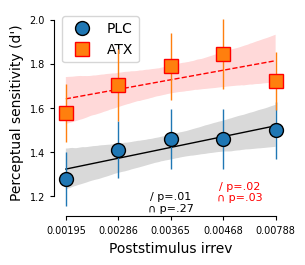

In [289]:
behavior = df

cfg = {'n_bins': 5}  # Number of pupil bins

# Function to process data for a given drug
def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['poststim_irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
    
    df_group = behavior.sort_values(by=['subject','session','block'])

    # make bins
    df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['poststim_irrev'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))))))
    
    correct_counts = True
    df_sdt_irreversibility = df_group.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['poststim_irrev']
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

# Ensure the bins are the same for both groups by using the overall mean bin values
bin_means = (bin_means_plc + bin_means_atx) / 2

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k', label='PLC')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='ATX')

# Linear and quadratic fits for PLC (if needed)
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Linear and quadratic fits for ATX (if needed)
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
plot_linear_plc = False
plot_quadratic_plc = False

if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='k',
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)

if plot_quadratic_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='k',
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)

# Determine which model to plot for ATX based on the significance and smaller p-value
plot_linear_atx = False
plot_quadratic_atx = False

if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=1, ci=68)

if plot_quadratic_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=2, ci=68)

# Plot p-values for the polynomial regression significance for PLC
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                        p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

# Plot p-values for the polynomial regression significance for ATX
ax.text(0.8, 0.06, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                        p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststimulus irrev')
ax.set_xticks(range(cfg['n_bins']))
ax.set_xticklabels(bin_means.round(5).values)  # Use rounded bin means as x-tick labels
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()


C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\932662580.py:8: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['prestim_irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\932662580.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['

C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\932662580.py:23: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('irreversibility_bin').mean()['prestim_irrev']
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\932662580.py:8: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['prestim_irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins'

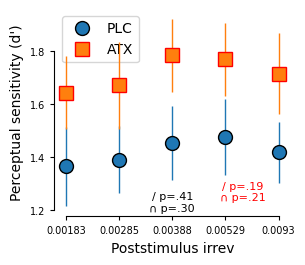

In [36]:
behavior = df

cfg = {'n_bins': 5}  # Number of pupil bins

# Function to process data for a given drug
def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['prestim_irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
    
    df_group = behavior.sort_values(by=['subject','session','block'])

    # make bins
    df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['prestim_irrev'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))))))
    
    correct_counts = True
    df_sdt_irreversibility = df_group.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['prestim_irrev']
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

# Ensure the bins are the same for both groups by using the overall mean bin values
bin_means = (bin_means_plc + bin_means_atx) / 2

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k', label='PLC')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='ATX')

# Linear and quadratic fits for PLC (if needed)
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Linear and quadratic fits for ATX (if needed)
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
plot_linear_plc = False
plot_quadratic_plc = False

if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='k',
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)

if plot_quadratic_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='k',
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)

# Determine which model to plot for ATX based on the significance and smaller p-value
plot_linear_atx = False
plot_quadratic_atx = False

if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=1, ci=68)

if plot_quadratic_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=2, ci=68)

# Plot p-values for the polynomial regression significance for PLC
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                        p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

# Plot p-values for the polynomial regression significance for ATX
ax.text(0.8, 0.06, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                        p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Prestimulus irrev')
ax.set_xticks(range(cfg['n_bins']))
ax.set_xticklabels(bin_means.round(5).values)  # Use rounded bin means as x-tick labels
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()


C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\649664036.py:8: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['stim_diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\649664036.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irre

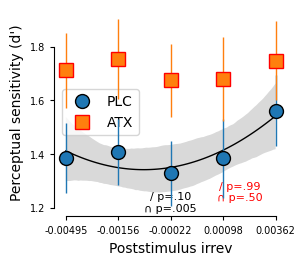

In [152]:
behavior = df

cfg = {'n_bins': 5}  # Number of pupil bins

# Function to process data for a given drug
def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['stim_diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
    
    df_group = behavior.sort_values(by=['subject','session','block'])

    # make bins
    df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['stim_diff'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))))))
    
    correct_counts = True
    df_sdt_irreversibility = df_group.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['stim_diff']
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

# Ensure the bins are the same for both groups by using the overall mean bin values
bin_means = (bin_means_plc + bin_means_atx) / 2

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k', label='PLC')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='ATX')

# Linear and quadratic fits for PLC (if needed)
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Linear and quadratic fits for ATX (if needed)
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
plot_linear_plc = False
plot_quadratic_plc = False

if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='k',
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)

if plot_quadratic_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='k',
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)

# Determine which model to plot for ATX based on the significance and smaller p-value
plot_linear_atx = False
plot_quadratic_atx = False

if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=1, ci=68)

if plot_quadratic_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=2, ci=68)

# Plot p-values for the polynomial regression significance for PLC
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                        p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

# Plot p-values for the polynomial regression significance for ATX
ax.text(0.8, 0.06, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                        p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststimulus irrev')
ax.set_xticks(range(cfg['n_bins']))
ax.set_xticklabels(bin_means.round(5).values)  # Use rounded bin means as x-tick labels
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()


C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\3516726981.py:8: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['log_poststim'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\3516726981.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior[

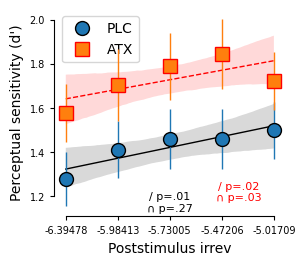

In [290]:
behavior = df

cfg = {'n_bins': 5}  # Number of pupil bins

# Function to process data for a given drug
def process_behavior(df, drug):
    behavior = df[(df['drug'] == drug)]
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['log_poststim'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
    
    df_group = behavior.sort_values(by=['subject','session','block'])

    # make bins
    df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['log_poststim'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))))))
    
    correct_counts = True
    df_sdt_irreversibility = df_group.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['log_poststim']
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(df, 'PLC')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(df, 'ATX')

# Ensure the bins are the same for both groups by using the overall mean bin values
bin_means = (bin_means_plc + bin_means_atx) / 2

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k', label='PLC')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='ATX')

# Linear and quadratic fits for PLC (if needed)
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Linear and quadratic fits for ATX (if needed)
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
plot_linear_plc = False
plot_quadratic_plc = False

if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='k',
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)

if plot_quadratic_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='k',
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)

# Determine which model to plot for ATX based on the significance and smaller p-value
plot_linear_atx = False
plot_quadratic_atx = False

if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=1, ci=68)

if plot_quadratic_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=2, ci=68)

# Plot p-values for the polynomial regression significance for PLC
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                        p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

# Plot p-values for the polynomial regression significance for ATX
ax.text(0.8, 0.06, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                        p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststimulus irrev')
ax.set_xticks(range(cfg['n_bins']))
ax.set_xticklabels(bin_means.round(5).values)  # Use rounded bin means as x-tick labels
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()


### diff bins

C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\2472145544.py:9: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\2472145544.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irrever

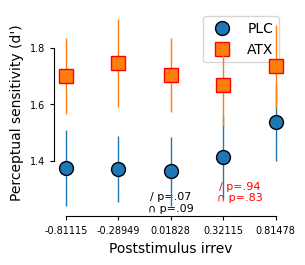

In [301]:
behavior = df
behavior['diff'] = (behavior['log_poststim']-behavior['log_prestim'])

cfg = {'n_bins': 5}  # Number of pupil bins

# Function to process data for a given drug
def process_behavior(df, drug):
    behavior = df[(df['drug'] == drug)]
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
    
    df_group = behavior.sort_values(by=['subject','session','block'])

    # make bins
    df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['diff'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))))))
    
    correct_counts = True
    df_sdt_irreversibility = df_group.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['diff']
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

# Ensure the bins are the same for both groups by using the overall mean bin values
bin_means = (bin_means_plc + bin_means_atx) / 2

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k', label='PLC')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='ATX')

# Linear and quadratic fits for PLC (if needed)
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Linear and quadratic fits for ATX (if needed)
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
plot_linear_plc = False
plot_quadratic_plc = False

if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='k',
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)

if plot_quadratic_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='k',
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)

# Determine which model to plot for ATX based on the significance and smaller p-value
plot_linear_atx = False
plot_quadratic_atx = False

if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=1, ci=68)

if plot_quadratic_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=2, ci=68)

# Plot p-values for the polynomial regression significance for PLC
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                        p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

# Plot p-values for the polynomial regression significance for ATX
ax.text(0.8, 0.06, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                        p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststimulus irrev')
ax.set_xticks(range(cfg['n_bins']))
ax.set_xticklabels(bin_means.round(5).values)  # Use rounded bin means as x-tick labels
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()


### testing

C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\3093983447.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['diff'] = (behavior['log_poststim']-behavior['log_prestim'])
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\3093983447.py:7: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['diff'].apply(lambda x: pd.qcut(x, cfg

irreversibility_bin
0   -0.823393
1   -0.296885
2    0.014081
3    0.316935
4    0.814460
Name: diff, dtype: float64


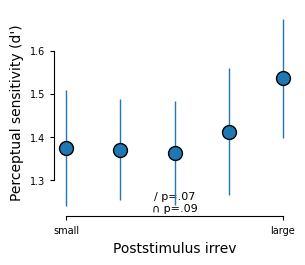

In [302]:
#drug = 'PLC'
behavior = df
behavior = behavior[(behavior['drug'] == 'PLC')]
behavior['diff'] = (behavior['log_poststim']-behavior['log_prestim'])

cfg = {'n_bins': 5}  # Number of pupil bins
behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['diff'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt_irreversibility = df_group.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)


print(behavior.groupby('irreversibility_bin').mean()['diff'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first_irreversibility['d']
p_val_quadratic = betas_second_irreversibility['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststimulus irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\283453603.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['diff'] = (behavior['log_poststim']-behavior['log_prestim'])
C:\Users\jaket\AppData\Local\Temp\ipykernel_5792\283453603.py:7: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['diff'].apply(lambda x: pd.qcut(x, cfg['

irreversibility_bin
0   -0.798906
1   -0.282086
2    0.022487
3    0.325355
4    0.815100
Name: diff, dtype: float64


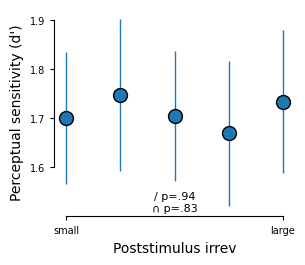

In [303]:
#drug = 'PLC'
behavior = df
behavior = behavior[(behavior['drug'] == 'ATX')]
behavior['diff'] = (behavior['log_poststim']-behavior['log_prestim'])

cfg = {'n_bins': 5}  # Number of pupil bins
behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['diff'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['diff'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

correct_counts = True
df_sdt_irreversibility = df_group.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
df_subject_irreversibility.reset_index(inplace=True)


print(behavior.groupby('irreversibility_bin').mean()['diff'])


betas_first_irreversibility = dict()
_, betas_first_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility = dict()
_, betas_second_irreversibility['d'] = sp.stats.ttest_1samp(df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)


# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(8*cm, 7*cm))

ym = df_sdt_irreversibility.groupby('irreversibility_bin').mean()['d']
yerr = df_sdt_irreversibility.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym, yerr=yerr, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='k')

p_val_linear = betas_first_irreversibility['d']
p_val_quadratic = betas_second_irreversibility['d']

# Initialize variables to decide which model to plot
plot_linear = False
plot_quadratic = False

# Determine which model to plot based on the significance and smaller p-value
if p_val_linear < 0.05 or p_val_quadratic < 0.05:
    if p_val_linear < p_val_quadratic:
        plot_linear = True
    elif p_val_quadratic < p_val_linear:
        plot_quadratic = True

# Optionally add model fits if linear/quadratic fit was significant
if plot_linear:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

if plot_quadratic:
    sns.regplot(ax=ax, data=df_subject_irreversibility, x="irreversibility_bin", y="d", scatter=False, color=sns.color_palette('Set1', 2)[-1],
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)
    # Adjusting line color to black for visibility
    ax.get_lines()[-1].set_color('k')

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ {}\n∩ {}'.format(p_val_string(betas_first_irreversibility['d']),
                                        p_val_string(betas_second_irreversibility['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8)

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststimulus irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large']) 
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

fig.tight_layout()
plt.show()

## bins all drugs 5/23- all drugs plotted together

### poststim

C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\118498113.py:15: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\118498113.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: PLC
Bin means: irreversibility_bin
0   -6.326145
1   -5.922781
2   -5.672689
3   -5.421720
4   -4.970015
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\118498113.py:15: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\118498113.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: DNP
Bin means: irreversibility_bin
0   -6.284041
1   -5.881428
2   -5.636691
3   -5.383603
4   -4.944682
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\118498113.py:15: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\118498113.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: ATX
Bin means: irreversibility_bin
0   -6.421300
1   -6.029071
2   -5.786428
3   -5.539522
4   -5.103786
Name: irrev, dtype: float64


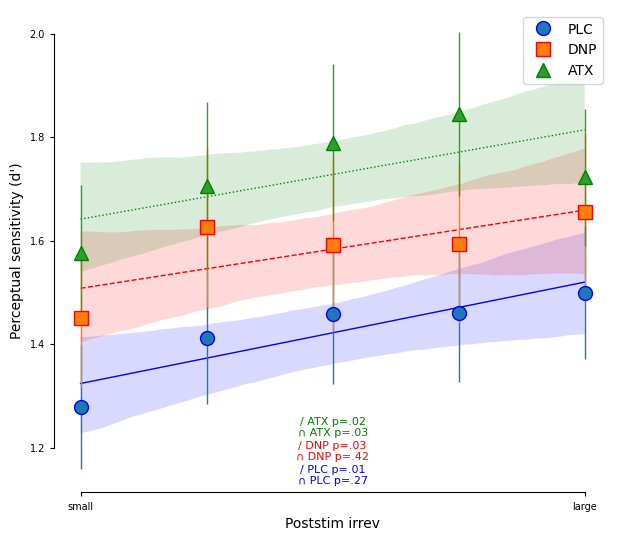

In [137]:

def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp

# Assuming df is already loaded and contains the relevant data
behavior = df
behavior['irrev'] = df['log_poststim']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

# Ensure the bins are the same for all groups by using the overall mean bin values
bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='b',
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)

if plot_quadratic_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='b',
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    sns.regplot(ax=ax, data=df_subject_irreversibility_dnp, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=1, ci=68)

if plot_quadratic_dnp:
    sns.regplot(ax=ax, data=df_subject_irreversibility_dnp, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=2, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='g',
                line_kws={'linestyle': ':', 'lw': 1}, order=1, ci=68)

if plot_quadratic_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='g',
                line_kws={'linestyle': ':', 'lw': 1}, order=2, ci=68)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color = 'b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststim irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large'])  # Use rounded bin means as x-tick labels
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



POSTSTIM -- CUE VALIDITY???

In [ ]:
cfg = {'n_bins': 5}

df_group = behavior.sort_values(by=['subject', 'session', 'block'])

    # Make bins
df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject', 'session', 'block'])['irrev'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))))))

print(df_group)

C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\3449018630.py:29: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\3449018630.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0   -6.326145
1   -5.922781
2   -5.672689
3   -5.421720
4   -4.970015
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\3449018630.py:29: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\3449018630.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0   -6.284041
1   -5.881428
2   -5.636691
3   -5.383603
4   -4.944682
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\3449018630.py:29: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\3449018630.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0   -6.421300
1   -6.029071
2   -5.786428
3   -5.539522
4   -5.103786
Name: irrev, dtype: float64


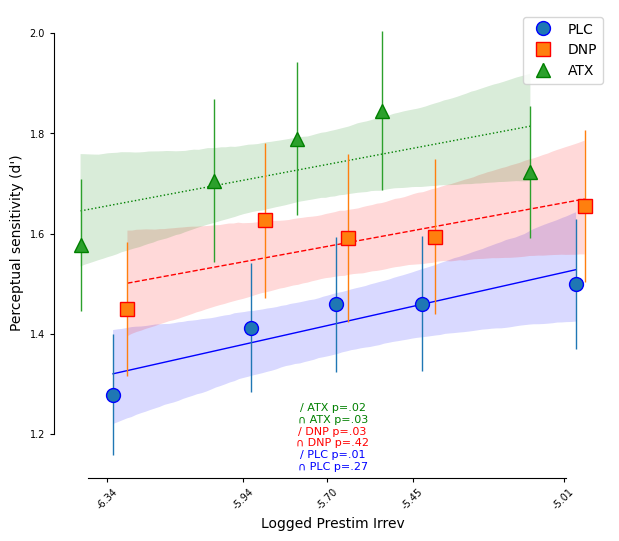

In [160]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp

# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df
behavior['irrev'] = df['log_poststim']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Logged Prestim Irrev')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\2294143888.py:17: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\2294143888.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irre

Drug: PLC
Bin means: irreversibility_bin
0    0.003438
1    0.003903
2    0.004143
3    0.004603
4    0.005242
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\2294143888.py:17: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\2294143888.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irre

Drug: DNP
Bin means: irreversibility_bin
0    0.003513
1    0.004052
2    0.004417
3    0.004698
4    0.005248
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\2294143888.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\2294143888.py:31: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = df_group.groupby('irreversibility_bin').mean()['irrev']


Drug: ATX
Bin means: irreversibility_bin
0    0.003164
1    0.003749
2    0.003917
3    0.004143
4    0.004830
Name: irrev, dtype: float64


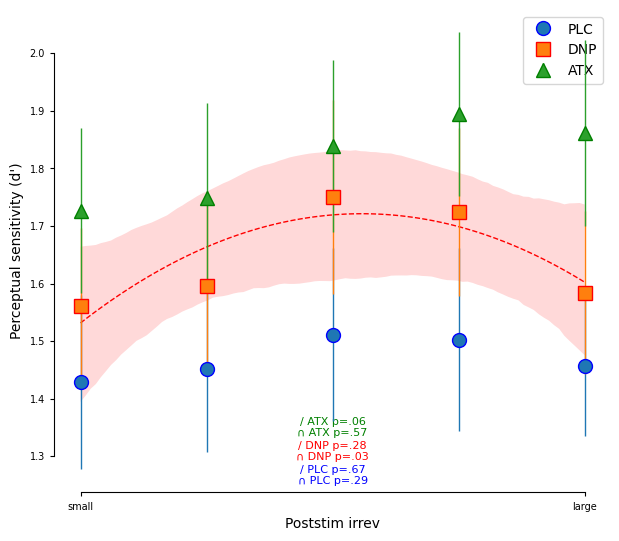

In [344]:

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp

# Assuming df is already loaded and contains the relevant data
behavior = df

behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
behavior = behavior[behavior['cue_val'] == 1]
behavior['irrev'] = behavior['poststim_irrev']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[behavior['drug'] == drug]
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'drug'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
    df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['irreversibility'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'],labels = range(cfg['n_bins']))))))

    correct_counts = True
    df_sdt = df_group.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

    df_subject = df_sdt.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject.reset_index(inplace=True)

    bin_means = df_group.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

# Ensure the bins are the same for all groups by using the overall mean bin values
bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='b',
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)

if plot_quadratic_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='b',
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    sns.regplot(ax=ax, data=df_subject_irreversibility_dnp, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=1, ci=68)

if plot_quadratic_dnp:
    sns.regplot(ax=ax, data=df_subject_irreversibility_dnp, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=2, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='g',
                line_kws={'linestyle': ':', 'lw': 1}, order=1, ci=68)

if plot_quadratic_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='g',
                line_kws={'linestyle': ':', 'lw': 1}, order=2, ci=68)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color = 'b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststim irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large'])  # Use rounded bin means as x-tick labels
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()


### prestim

C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\4019470806.py:23: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\4019470806.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0   -6.405524
1   -5.967114
2   -5.682211
3   -5.389508
4   -4.891874
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\4019470806.py:23: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\4019470806.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0   -6.347257
1   -5.909666
2   -5.645735
3   -5.361979
4   -4.872705
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\4019470806.py:23: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\4019470806.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0   -6.504525
1   -6.078785
2   -5.808588
3   -5.529723
4   -5.038837
Name: irrev, dtype: float64


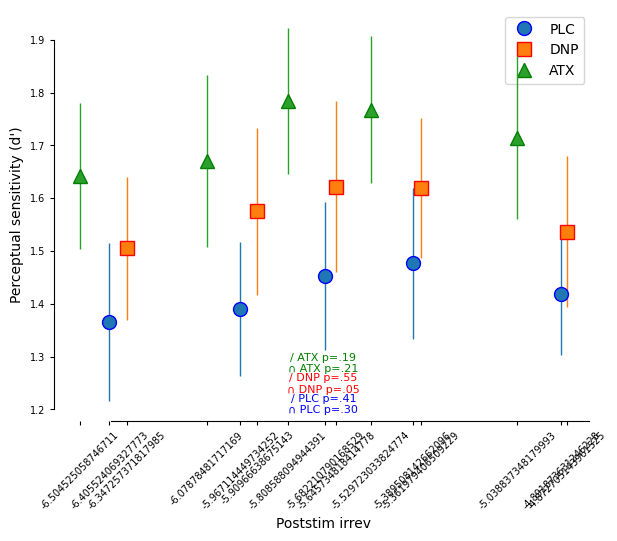

In [141]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]


import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp

# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df
behavior['irrev'] = df['log_prestim']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststim irrev')
ax.set_xticks(sorted(set(bin_means_plc.tolist() + bin_means_dnp.tolist() + bin_means_atx.tolist())))
ax.set_xticklabels(sorted(set(bin_means_plc.tolist() + bin_means_dnp.tolist() + bin_means_atx.tolist())), rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\4003301532.py:15: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\4003301532.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0   -6.405524
1   -5.967114
2   -5.682211
3   -5.389508
4   -4.891874
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\4003301532.py:24: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']


Drug: DNP
Bin means: irreversibility_bin
0   -6.347257
1   -5.909666
2   -5.645735
3   -5.361979
4   -4.872705
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\4003301532.py:15: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\4003301532.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0   -6.504525
1   -6.078785
2   -5.808588
3   -5.529723
4   -5.038837
Name: irrev, dtype: float64


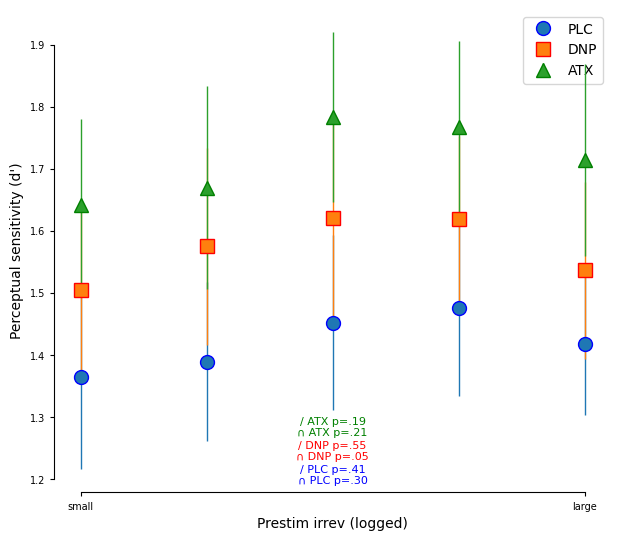

In [9]:

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp

# Assuming df is already loaded and contains the relevant data
behavior = df
behavior['irrev'] = df['log_prestim']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

# Ensure the bins are the same for all groups by using the overall mean bin values
bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='b',
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)

if plot_quadratic_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='b',
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    sns.regplot(ax=ax, data=df_subject_irreversibility_dnp, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=1, ci=68)

if plot_quadratic_dnp:
    sns.regplot(ax=ax, data=df_subject_irreversibility_dnp, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=2, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='g',
                line_kws={'linestyle': ':', 'lw': 1}, order=1, ci=68)

if plot_quadratic_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='g',
                line_kws={'linestyle': ':', 'lw': 1}, order=2, ci=68)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color = 'b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Prestim irrev (logged)')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large'])  # Use rounded bin means as x-tick labels
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



### diff

C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\1962523087.py:28: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('irreversibility_bin').mean()['stim_diff']


Drug: PLC
Bin means: irreversibility_bin
0    0.001461
1    0.000992
2    0.000249
3   -0.000780
4   -0.003808
Name: stim_diff, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\1962523087.py:28: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('irreversibility_bin').mean()['stim_diff']


Drug: DNP
Bin means: irreversibility_bin
0    0.001365
1    0.000827
2    0.000205
3   -0.000799
4   -0.003822
Name: stim_diff, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\1962523087.py:28: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('irreversibility_bin').mean()['stim_diff']


Drug: ATX
Bin means: irreversibility_bin
0    0.001281
1    0.000889
2    0.000078
3   -0.000873
4   -0.003766
Name: stim_diff, dtype: float64


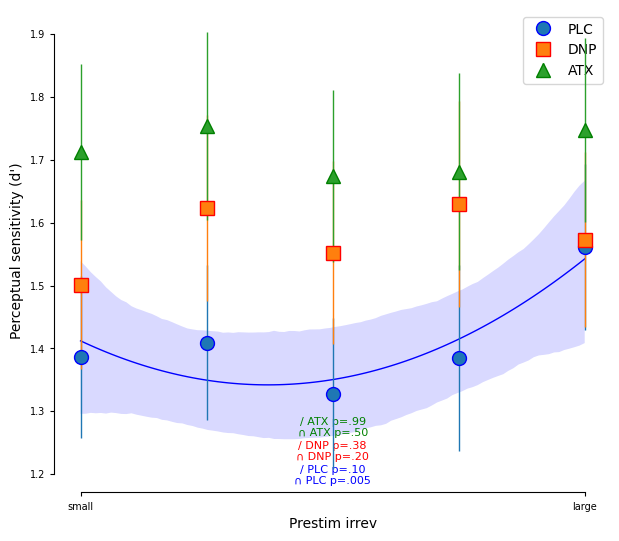

In [240]:

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp

# Assuming df is already loaded and contains the relevant data
behavior = df

cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    df_group = behavior.sort_values(by=['subject', 'drug'])

    # Make bins
    df_group['irreversibility_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject', 'drug'])['stim_diff'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))))))
    
    correct_counts = True
    df_sdt_irreversibility = df_group.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['stim_diff']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

# Ensure the bins are the same for all groups by using the overall mean bin values
bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='b',
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)

if plot_quadratic_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='b',
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    sns.regplot(ax=ax, data=df_subject_irreversibility_dnp, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=1, ci=68)

if plot_quadratic_dnp:
    sns.regplot(ax=ax, data=df_subject_irreversibility_dnp, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=2, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='g',
                line_kws={'linestyle': ':', 'lw': 1}, order=1, ci=68)

if plot_quadratic_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='g',
                line_kws={'linestyle': ':', 'lw': 1}, order=2, ci=68)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color = 'b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Prestim irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large'])  # Use rounded bin means as x-tick labels
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



#### old method diff

C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\552248299.py:15: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\552248299.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irrever

Drug: PLC
Bin means: irreversibility_bin
0   -0.005188
1   -0.001538
2   -0.000153
3    0.001051
4    0.003954
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\552248299.py:24: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\552248299.py:15: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()


Drug: DNP
Bin means: irreversibility_bin
0   -0.005220
1   -0.001538
2   -0.000249
3    0.000932
4    0.003858
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\552248299.py:24: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']


Drug: ATX
Bin means: irreversibility_bin
0   -0.004718
1   -0.001578
2   -0.000287
3    0.000912
4    0.003286
Name: irrev, dtype: float64


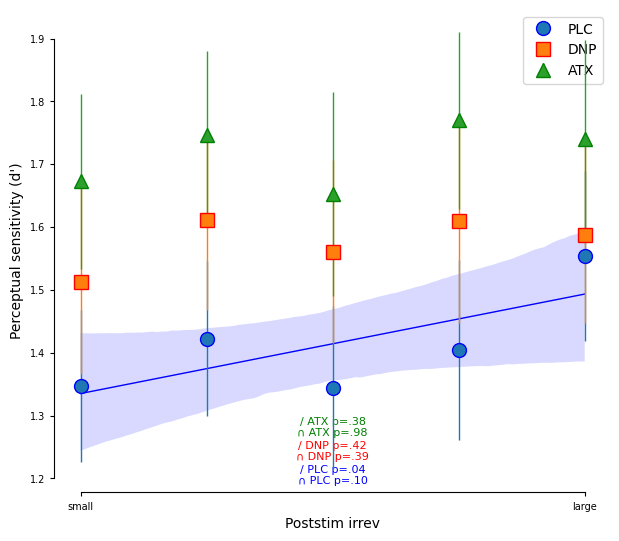

In [245]:

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp

# Assuming df is already loaded and contains the relevant data
behavior = df
behavior['irrev'] = df['stim_diff']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject','drug'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    # Now calculate SDT measures for each subject, drug, and irreversibility bin
    df_sdt_irreversibility = behavior.groupby(['subject','drug','irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))

    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

# Ensure the bins are the same for all groups by using the overall mean bin values
bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='b',
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)

if plot_quadratic_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='b',
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    sns.regplot(ax=ax, data=df_subject_irreversibility_dnp, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=1, ci=68)

if plot_quadratic_dnp:
    sns.regplot(ax=ax, data=df_subject_irreversibility_dnp, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=2, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='g',
                line_kws={'linestyle': ':', 'lw': 1}, order=1, ci=68)

if plot_quadratic_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='g',
                line_kws={'linestyle': ':', 'lw': 1}, order=2, ci=68)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color = 'b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Diff in irrev (post-pre)')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large'])  # Use rounded bin means as x-tick labels
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



#### cpp 

C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\688651043.py:29: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\688651043.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  beha

Drug: PLC
Bin means: irreversibility_bin
0    0.003474
1    0.005967
2    0.008415
3    0.012092
4    0.024322
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\688651043.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\688651043.py:38: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']


Drug: DNP
Bin means: irreversibility_bin
0    0.003455
1    0.005921
2    0.008386
3    0.011990
4    0.022987
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\688651043.py:29: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\688651043.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  beha

Drug: ATX
Bin means: irreversibility_bin
0    0.003329
1    0.005721
2    0.008196
3    0.011635
4    0.021464
Name: irrev, dtype: float64


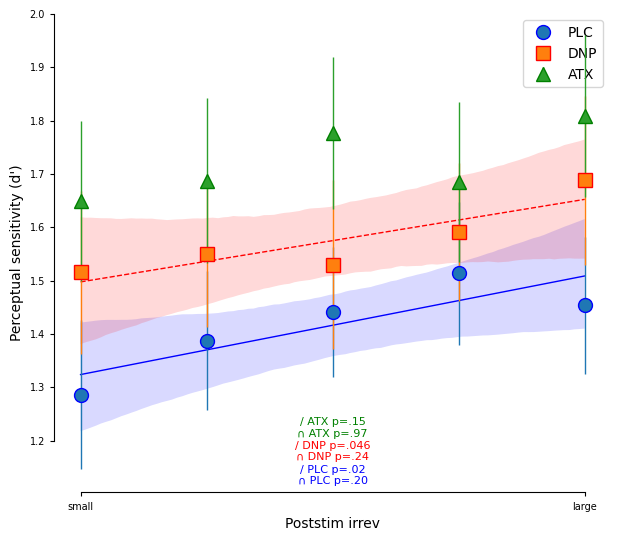

In [356]:
behavior = df

behavior['post_ref_matrices'] = df['poststim_ref_mat']

specific_electrodes = ['CPz', 'CP1', 'CP2']
electrode_indices = [channels.index(elec) for elec in specific_electrodes if elec in channels]

cpp_array = []
for matrix in behavior['post_ref_matrices']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    post_contribution = row + col
    post_cpp = np.mean(post_contribution[electrode_indices])
    cpp_array.append(post_cpp)

behavior['irrev'] = cpp_array

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp

cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

# Ensure the bins are the same for all groups by using the overall mean bin values
bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(range(cfg['n_bins']), ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='b',
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)

if plot_quadratic_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="irreversibility_bin", y="d", scatter=False, color='b',
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    sns.regplot(ax=ax, data=df_subject_irreversibility_dnp, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=1, ci=68)

if plot_quadratic_dnp:
    sns.regplot(ax=ax, data=df_subject_irreversibility_dnp, x="irreversibility_bin", y="d", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=2, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='g',
                line_kws={'linestyle': ':', 'lw': 1}, order=1, ci=68)

if plot_quadratic_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="irreversibility_bin", y="d", scatter=False, color='g',
                line_kws={'linestyle': ':', 'lw': 1}, order=2, ci=68)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color = 'b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Poststim irrev')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large'])  # Use rounded bin means as x-tick labels
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



### pupil bin

C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\34472930.py:25: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_sdt['irrev'] = df_group.groupby(['subject','drug','bl_pupil_bin']).mean()['irrev']
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\34472930.py:29: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('bl_pupil_bin').mean()['bl_pupil']


Drug: PLC
Bin means: bl_pupil_bin
0    3246.657173
1    3422.133266
2    3519.937337
3    3621.773325
4    3806.482278
Name: bl_pupil, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\34472930.py:25: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_sdt['irrev'] = df_group.groupby(['subject','drug','bl_pupil_bin']).mean()['irrev']
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\34472930.py:29: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('bl_pupil_bin').mean()['bl_pupil']


Drug: DNP
Bin means: bl_pupil_bin
0    3220.829906
1    3391.654361
2    3488.886422
3    3585.538943
4    3758.189555
Name: bl_pupil, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\34472930.py:25: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_sdt['irrev'] = df_group.groupby(['subject','drug','bl_pupil_bin']).mean()['irrev']
C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\34472930.py:29: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('bl_pupil_bin').mean()['bl_pupil']


Drug: ATX
Bin means: bl_pupil_bin
0    3449.138855
1    3641.609176
2    3751.281290
3    3862.559063
4    4063.612822
Name: bl_pupil, dtype: float64


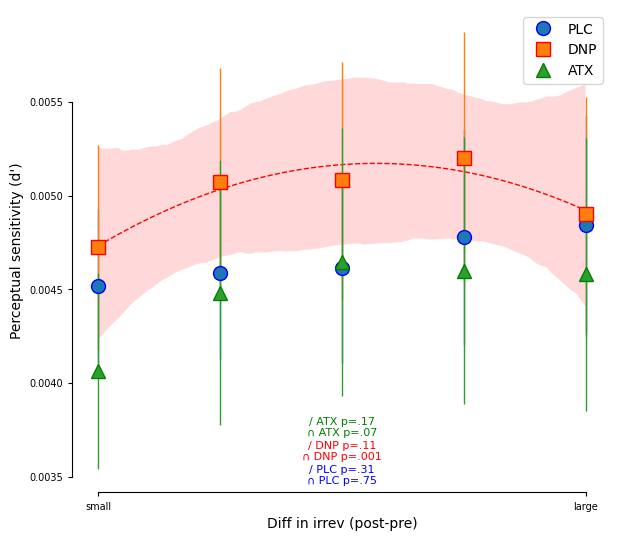

In [279]:

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp

# Assuming df is already loaded and contains the relevant data
behavior = df
behavior['irrev'] = df['prestim_irrev']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
        
        behavior = behavior[(behavior['drug'] == drug)]
    
        df_group = behavior.sort_values(by=['subject','session','block'])

        # make bins
        df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['bl_pupil'].agg(
        lambda x: list(pd.qcut(x, cfg['n_bins'], labels = range(cfg['n_bins']))))))

        correct_counts = True
        df_sdt = df_group.groupby(['subject','drug','bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))
        df_sdt['irrev'] = df_group.groupby(['subject','drug','bl_pupil_bin']).mean()['irrev']

        df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin']).mean()
        df_subject.reset_index(inplace=True)
        bin_means = behavior.groupby('bl_pupil_bin').mean()['bl_pupil']
        print("Drug: " + drug)
        print("Bin means: " + str(bin_means))
    
        return df_subject, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

# Ensure the bins are the same for all groups by using the overall mean bin values
bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('bl_pupil_bin').mean()['irrev']
yerr_plc = df_subject_irreversibility_plc.groupby('bl_pupil_bin').sem()['irrev']
ax.errorbar(range(cfg['n_bins']), ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('bl_pupil_bin').mean()['irrev']
yerr_dnp = df_subject_irreversibility_dnp.groupby('bl_pupil_bin').sem()['irrev']
ax.errorbar(range(cfg['n_bins']), ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('bl_pupil_bin').mean()['irrev']
yerr_atx = df_subject_irreversibility_atx.groupby('bl_pupil_bin').sem()['irrev']
ax.errorbar(range(cfg['n_bins']), ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_pupilbin, 1, 'irrev'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_pupilbin, 2, 'irrev'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_pupilbin, 1, 'irrev'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_pupilbin, 2, 'irrev'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_pupilbin, 1, 'irrev'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_pupilbin, 2, 'irrev'), 0)

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['irrev'] < 0.05 or betas_second_irreversibility_plc['irrev'] < 0.05:
    if betas_first_irreversibility_plc['irrev'] < betas_second_irreversibility_plc['irrev']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['irrev'] < betas_first_irreversibility_plc['irrev']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['irrev'] < 0.05 or betas_second_irreversibility_dnp['irrev'] < 0.05:
    if betas_first_irreversibility_dnp['irrev'] < betas_second_irreversibility_dnp['irrev']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['irrev'] < betas_first_irreversibility_dnp['irrev']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['irrev'] < 0.05 or betas_second_irreversibility_atx['irrev'] < 0.05:
    if betas_first_irreversibility_atx['irrev'] < betas_second_irreversibility_atx['irrev']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['irrev'] < betas_first_irreversibility_atx['irrev']:
        plot_quadratic_atx = True

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="bl_pupil_bin", y="irrev", scatter=False, color='b',
                line_kws={'linestyle': '-', 'lw': 1}, order=1, ci=68)

if plot_quadratic_plc:
    sns.regplot(ax=ax, data=df_subject_irreversibility_plc, x="bl_pupil_bin", y="irrev", scatter=False, color='b',
                line_kws={'linestyle': '-', 'lw': 1}, order=2, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    sns.regplot(ax=ax, data=df_subject_irreversibility_dnp, x="bl_pupil_bin", y="irrev", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=1, ci=68)

if plot_quadratic_dnp:
    sns.regplot(ax=ax, data=df_subject_irreversibility_dnp, x="bl_pupil_bin", y="irrev", scatter=False, color='r',
                line_kws={'linestyle': '--', 'lw': 1}, order=2, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="bl_pupil_bin", y="irrev", scatter=False, color='g',
                line_kws={'linestyle': ':', 'lw': 1}, order=1, ci=68)

if plot_quadratic_atx:
    sns.regplot(ax=ax, data=df_subject_irreversibility_atx, x="bl_pupil_bin", y="irrev", scatter=False, color='g',
                line_kws={'linestyle': ':', 'lw': 1}, order=2, ci=68)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['irrev']),
                                               p_val_string(betas_second_irreversibility_plc['irrev'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color = 'b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['irrev']),
                                               p_val_string(betas_second_irreversibility_dnp['irrev'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['irrev']),
                                               p_val_string(betas_second_irreversibility_atx['irrev'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('irrev')
ax.set_xlabel('pupil size')
ax.set_xticks([0,cfg['n_bins']-1])
ax.set_xticklabels(['small', 'large'])  # Use rounded bin means as x-tick labels
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()


## topoplots

C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\2648397514.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['precue_contributions'] = contribution_arr


precue


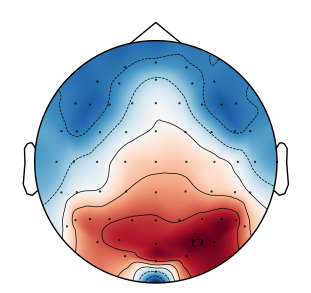

C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\2648397514.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['postcue_contributions'] = contribution_arr


postcue


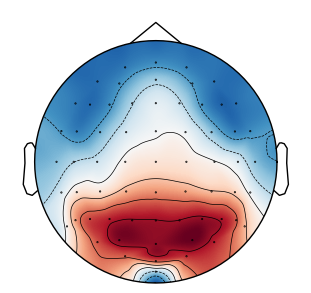

C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\2648397514.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['prestim_contributions'] = contribution_arr


prestim


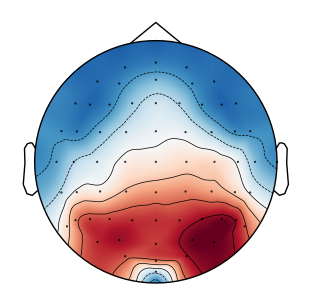

C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\2648397514.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['poststim_contributions'] = contribution_arr


poststim


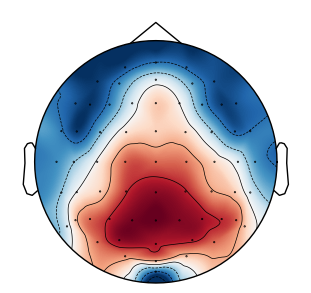

(<matplotlib.image.AxesImage at 0x1d71a599d30>,
 <matplotlib.contour.QuadContourSet at 0x1d71a599c70>)

In [80]:
data1 = np.zeros((64, 128)) # Replace with your data
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
info = mne.create_info(channels, sfreq=128, ch_types='eeg')
info.set_montage(montage) # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)

behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.05) & (behavior['prestim_irrev'] < 0.05)]

contribution_arr = []
for matrix in behavior['precue_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution_arr.append(row + col)
behavior['precue_contributions'] = contribution_arr

print("precue")
precue_refmatrix = behavior['precue_contributions'].mean()
zscore_matrix = zscore(precue_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

#############################
contribution_arr = []
for matrix in behavior['postcue_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution_arr.append(row + col)
behavior['postcue_contributions'] = contribution_arr

print("postcue")
postcue_refmatrix = behavior['postcue_contributions'].mean()
zscore_matrix = zscore(postcue_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

#############################
contribution_arr = []
for matrix in behavior['prestim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution_arr.append(row + col)
behavior['prestim_contributions'] = contribution_arr

print("prestim")
prestim_refmatrix = behavior['prestim_contributions'].mean()
zscore_matrix = zscore(prestim_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)


#############################
contribution_arr = []
for matrix in behavior['poststim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution_arr.append(row + col)
behavior['poststim_contributions'] = contribution_arr

print("poststim")
poststim_refmatrix = behavior['poststim_contributions'].mean()
zscore_matrix = zscore(poststim_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)



### 5/26 diff post-pre topo

prestim


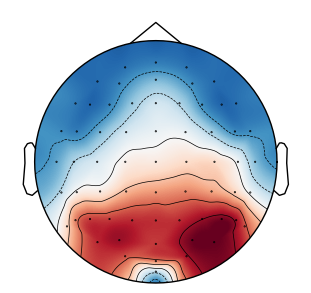

poststim:


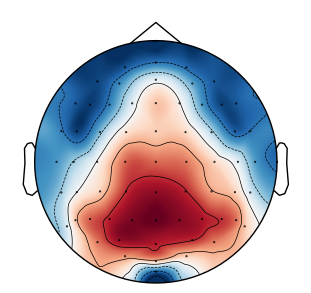

diff (zscore):


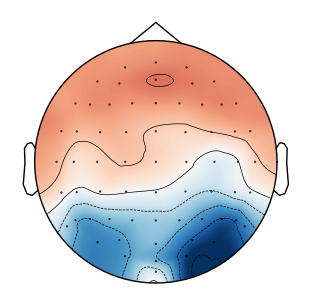

diff (raw):


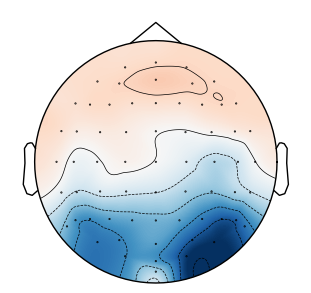

correct in diff:


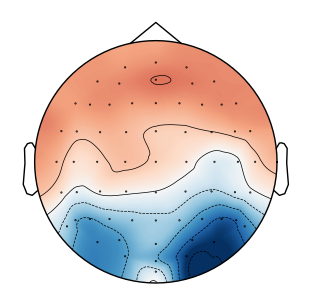

incorrect in diff:


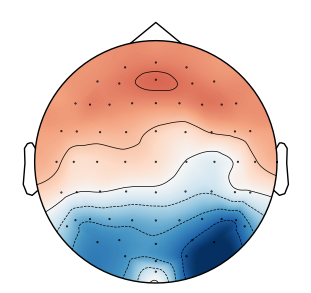

correct-avg in diff (zscore):


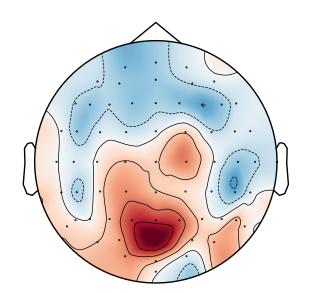

correct-avg in diff (raw):


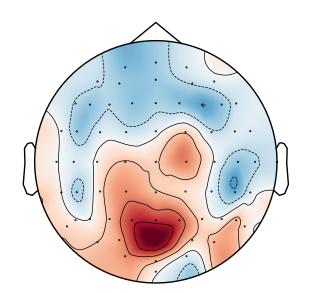

incorrect-avg in diff:


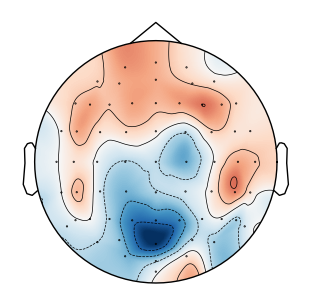

correct-incorrect in diff:


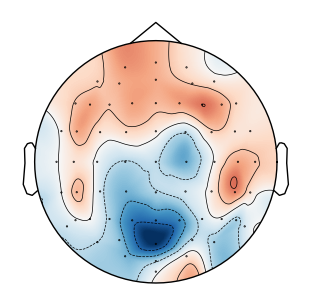

correct-incorrect:


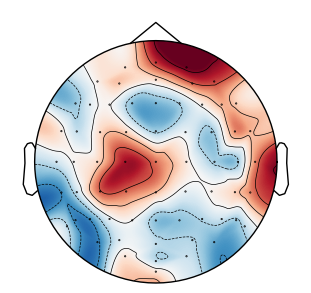

(<matplotlib.image.AxesImage at 0x16a4df037c0>,
 <matplotlib.contour.QuadContourSet at 0x16a4df03b20>)

In [378]:
data1 = np.zeros((64, 128)) # Replace with your data
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
info = mne.create_info(channels, sfreq=128, ch_types='eeg')
info.set_montage(montage) # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)

behavior = df

#############################
contribution_arr = []
for matrix in behavior['prestim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution_arr.append(row + col)
behavior['prestim_contributions'] = contribution_arr

print("prestim")
prestim_refmatrix = behavior['prestim_contributions'].mean()
zscore_matrix = zscore(prestim_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

#############################
contribution_arr = []
for matrix in behavior['poststim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution_arr.append(row + col)
behavior['poststim_contributions'] = contribution_arr

print("poststim:")
poststim_refmatrix = behavior['poststim_contributions'].mean()
zscore_matrix = zscore(poststim_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

print("diff (zscore):")
behavior['diff_contributions'] = behavior['poststim_contributions'] - behavior['prestim_contributions']
diff_refmatrix = behavior['diff_contributions'].mean()
zscore_matrix = zscore(diff_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

print("diff (raw):")
mne.viz.plot_topomap(diff_refmatrix, raw.info, res = 400, size = 3)

print("correct in diff:")
diff_refmatrix1 = behavior[behavior['correct'] == 1]['diff_contributions'].mean()
zscore_matrix = zscore(diff_refmatrix1, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

print("incorrect in diff:")
diff_refmatrix2 = behavior[behavior['correct'] == 0]['diff_contributions'].mean()
zscore_matrix = zscore(diff_refmatrix2, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)


print("correct-avg in diff (zscore):")
zscore_matrix = zscore(diff_refmatrix1-diff_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

print("correct-avg in diff (raw):")
zscore_matrix = zscore(diff_refmatrix1-diff_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

print("incorrect-avg in diff:")
zscore_matrix = zscore(diff_refmatrix2-diff_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)


print("correct-incorrect in diff:")
zscore_matrix = zscore(diff_refmatrix2-diff_refmatrix1, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

print("correct-incorrect:")
correctnessdiff = behavior[behavior['correct']==1]['poststim_contributions'].mean()-behavior[behavior['correct']==0]['poststim_contributions'].mean()
zscore_matrix = zscore(correctnessdiff, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)


by drug!?!?

C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\1067495122.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['prestim_contributions'] = contribution_arr


prestim


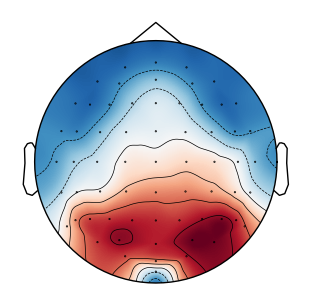

C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\1067495122.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['poststim_contributions'] = contribution_arr


poststim


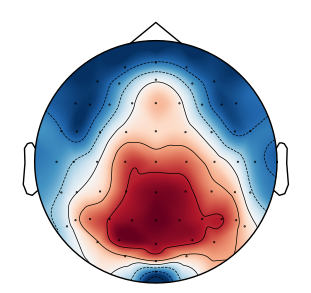

C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\1067495122.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['diff_refmatrix'] = behavior['poststim_contributions'] - behavior['prestim_contributions']


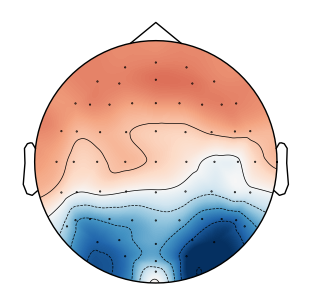

C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\1067495122.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['prestim_contributions'] = contribution_arr


prestim


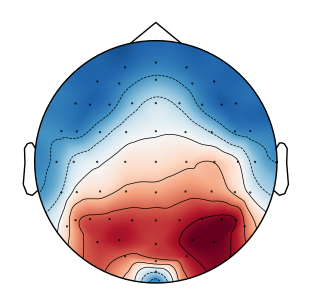

C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\1067495122.py:64: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['poststim_contributions'] = contribution_arr


poststim


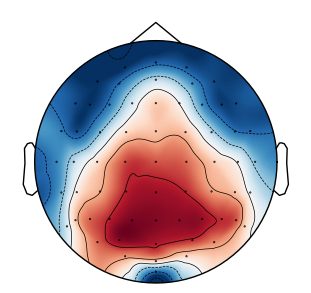

C:\Users\jaket\AppData\Local\Temp\ipykernel_9736\1067495122.py:72: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['diff_refmatrix'] = behavior['poststim_contributions'] - behavior['prestim_contributions']


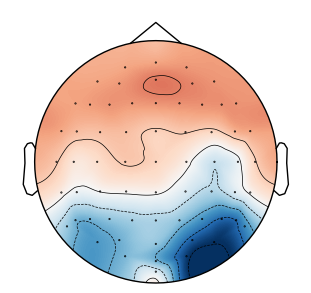

atx-plc?


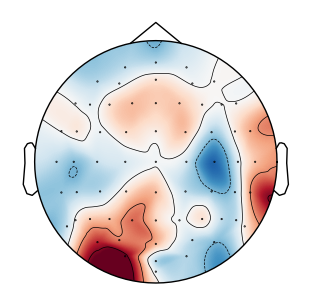

(<matplotlib.image.AxesImage at 0x16a6531bcd0>,
 <matplotlib.contour.QuadContourSet at 0x16a646ee550>)

In [358]:
data1 = np.zeros((64, 128)) # Replace with your data
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
info = mne.create_info(channels, sfreq=128, ch_types='eeg')
info.set_montage(montage) # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)

behavior = df
behavior = behavior[(behavior['drug'] == 'PLC')]
#############################
contribution_arr = []
for matrix in behavior['prestim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution_arr.append(row + col)
behavior['prestim_contributions'] = contribution_arr

print("prestim")
prestim_refmatrix = behavior['prestim_contributions'].mean()
zscore_matrix = zscore(prestim_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

#############################
contribution_arr = []
for matrix in behavior['poststim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution_arr.append(row + col)
behavior['poststim_contributions'] = contribution_arr

print("poststim")
poststim_refmatrix = behavior['poststim_contributions'].mean()
zscore_matrix = zscore(poststim_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)


behavior['diff_refmatrix'] = behavior['poststim_contributions'] - behavior['prestim_contributions']
diff_refmatrix1 = behavior['diff_refmatrix'].mean()
zscore_matrix = zscore(diff_refmatrix1, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)


behavior = df
behavior = behavior[(behavior['drug'] == 'ATX')]
#############################
contribution_arr = []
for matrix in behavior['prestim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution_arr.append(row + col)
behavior['prestim_contributions'] = contribution_arr

print("prestim")
prestim_refmatrix = behavior['prestim_contributions'].mean()
zscore_matrix = zscore(prestim_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

#############################
contribution_arr = []
for matrix in behavior['poststim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution_arr.append(row + col)
behavior['poststim_contributions'] = contribution_arr

print("poststim")
poststim_refmatrix = behavior['poststim_contributions'].mean()
zscore_matrix = zscore(poststim_refmatrix, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)


behavior['diff_refmatrix'] = behavior['poststim_contributions'] - behavior['prestim_contributions']
diff_refmatrix2 = behavior['diff_refmatrix'].mean()
zscore_matrix = zscore(diff_refmatrix2, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)



print("atx-plc?")
zscore_matrix = zscore(diff_refmatrix2-diff_refmatrix1, axis=None)
mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)

## CPP correctness

Statistic: 175024398.0, P-value: 0.0644180754428376
mean of correct: 0.010438691686770574
mean of incorrect: 0.010657970383329994
median of correct: 0.007592170553538187
median of incorrect: 0.007724263588205872


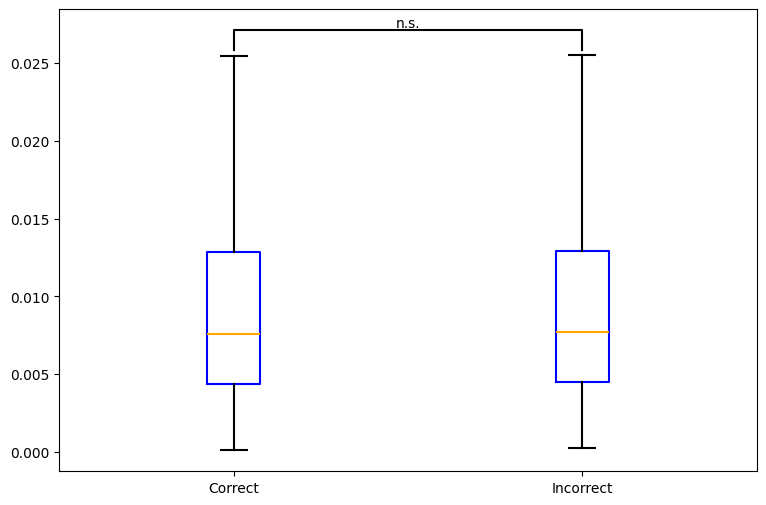

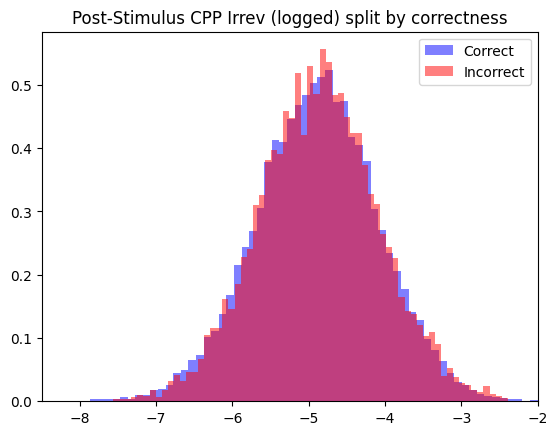

The std dev of the correct values in the pretty histogram (logged irrev values): 0.8074719933333268
The std dev of the incorrect values in the pretty histogram (logged irrev values): 0.7945147933283814
The std dev of the correct values of raw: 0.01559285572901321
The std dev of the incorrect values of raw: 0.013388262762707999


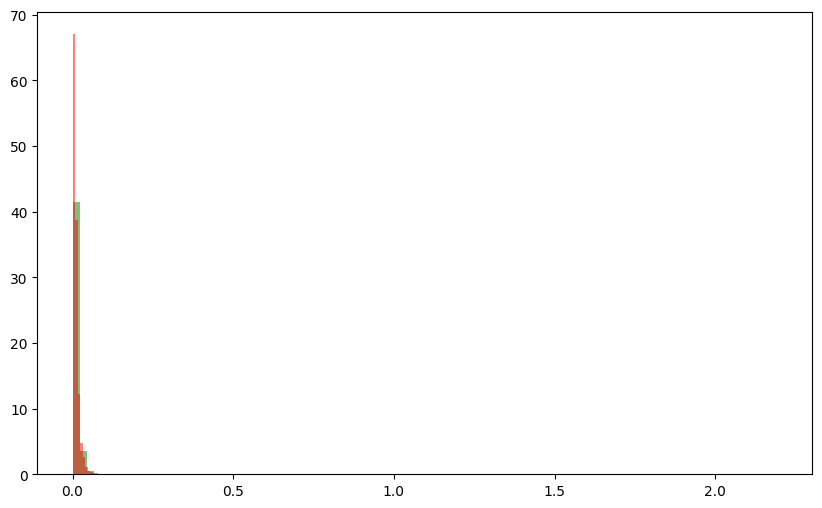

In [135]:

montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names

behavior = df
#behavior = behavior[behavior['drug']=='PLC']
#behavior = behavior[(behavior['poststim_irrev'] < 0.02) & (behavior['prestim_irrev'] < 0.02)]

specific_electrodes = ['CPz', 'CP1', 'CP2']
electrode_indices = [channels.index(elec) for elec in specific_electrodes if elec in channels]

cpp_array = []
for matrix in behavior['poststim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    post_contribution = row + col
    post_cpp = np.mean(post_contribution[electrode_indices])
    cpp_array.append(post_cpp)

behavior['cpp_irrev'] = cpp_array

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


correct_irrev = behavior[behavior['correct'] == 1]['cpp_irrev']
incorrect_irrev = behavior[behavior['correct'] == 0]['cpp_irrev']


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[correct_irrev, incorrect_irrev], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Correct', 'Incorrect'])
#ax.set_title('ATX')


# Perform the Mann-Whitney U test
stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev, alternative = 'two-sided')
print(f'Statistic: {stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(correct_irrev, 75)
Q3_group2 = np.percentile(incorrect_irrev, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of correct: " + str(np.mean(correct_irrev)))
print("mean of incorrect: " + str(np.mean(incorrect_irrev)))
print("median of correct: " + str(np.median(correct_irrev)))
print("median of incorrect: " + str(np.median(incorrect_irrev)))

plt.show()

plt.hist(np.log(correct_irrev), bins=100, color='blue', alpha=0.5, label='Correct', density = True)
plt.hist(np.log(incorrect_irrev), bins=100, color='red', alpha=0.5, label='Incorrect', density = True)
plt.xlim(-8.5,-2)
plt.legend()
plt.title('Post-Stimulus CPP Irrev (logged) split by correctness')
plt.show()

#Well shit.

print("The std dev of the correct values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the incorrect values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the correct values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the incorrect values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = correct_irrev
group2 = incorrect_irrev

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='correct', color='green', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='incorrect', color='red', density = True)

plt.show()



# 5/27- testing interactions...

In [26]:
import pandas as pd
import numpy as np
from scipy.stats import wilcoxon
from statsmodels.stats.multitest import multipletests
from itertools import combinations


# Calculate grand mean
grand_mean = df['poststim_irrev'].mean()

# Calculate marginal means
cue_means = df.groupby('cue_val')['poststim_irrev'].mean()
drug_means = df.groupby('drug')['poststim_irrev'].mean()
interaction_means = df.groupby(['cue_val', 'drug'])['poststim_irrev'].mean()

# Align the data
def align_data(row):
    cue_mean = cue_means[row['cue_val']]
    drug_mean = drug_means[row['drug']]
    interaction_mean = interaction_means[row['cue_val'], row['drug']]
    aligned_value = row['poststim_irrev'] - cue_mean - drug_mean + interaction_mean + grand_mean
    return aligned_value

df['aligned_poststim_irrev'] = df.apply(align_data, axis=1)

# Rank the aligned data
df['ranked_aligned_poststim_irrev'] = rankdata(df['aligned_poststim_irrev'])

# Perform ANOVA on ranked aligned data
model = ols('ranked_aligned_poststim_irrev ~ C(cue_val) * C(drug)', data=df).fit()
anova_table = sm.stats.anova_lm(model, typ=2)
print(anova_table)

# List of conditions for pairwise comparisons
conditions = df['drug'].unique()
cue_validities = df['cue_val'].unique()

# Collect all pairs of conditions
pairs = list(combinations(conditions, 2))

# Function to perform Wilcoxon signed-rank tests with Bonferroni correction
def pairwise_wilcoxon(df, group_var, value_var, pairs, cue_val):
    p_values = []
    for (cond1, cond2) in pairs:
        group1 = df[(df[group_var] == cond1) & (df['cue_val'] == cue_val)][value_var]
        group2 = df[(df[group_var] == cond2) & (df['cue_val'] == cue_val)][value_var]
        
        # Ensure both groups have the same length by subsampling the larger group
        min_length = min(len(group1), len(group2))
        if len(group1) != len(group2):
            group1 = np.random.choice(group1, min_length, replace=False)
            group2 = np.random.choice(group2, min_length, replace=False)
        
        stat, p = wilcoxon(group1, group2)
        p_values.append(p)
    return p_values

# Perform pairwise comparisons for each cue validity
all_p_values = []
for cue in cue_validities:
    p_values = pairwise_wilcoxon(df, 'drug', 'ranked_aligned_poststim_irrev', pairs, cue)
    all_p_values.extend(p_values)

# Apply Bonferroni correction
corrected_p_values = multipletests(all_p_values, method='bonferroni')[1]

# Print results
for (pair, p_value) in zip(pairs * len(cue_validities), corrected_p_values):
    print(f"Comparison: {pair[0]} vs {pair[1]} (Cue Validity: {cue}) - Corrected p-value: {p_value}")


                          sum_sq       df           F         PR(>F)
C(cue_val)          1.556151e+08      1.0    0.942072   3.317509e-01
C(drug)             8.887425e+10      2.0  269.015995  7.312638e-117
C(cue_val):C(drug)  1.266624e+09      2.0    3.833979   2.163049e-02
Residual            7.397598e+12  44784.0         NaN            NaN
Comparison: DNP vs PLC (Cue Validity: 0) - Corrected p-value: 1.7786978666889478e-13
Comparison: DNP vs ATX (Cue Validity: 0) - Corrected p-value: 2.087579440388531e-78
Comparison: PLC vs ATX (Cue Validity: 0) - Corrected p-value: 4.7234032435853465e-32
Comparison: DNP vs PLC (Cue Validity: 0) - Corrected p-value: 0.0020011396994648136
Comparison: DNP vs ATX (Cue Validity: 0) - Corrected p-value: 1.3432522301858193e-30
Comparison: PLC vs ATX (Cue Validity: 0) - Corrected p-value: 2.831764676485595e-16


C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\2953330620.py:21: FutureWarning: This dataframe has a column name that matches the 'value_name' column name of the resulting Dataframe. In the future this will raise an error, please set the 'value_name' parameter of DataFrame.melt to a unique name.
  long_df = pd.melt(behavior, id_vars=['subject', 'drug', 'cue_val'], value_vars=['cued_irrev', 'uncued_irrev'],


subject                0
drug                   0
cue_val                0
cue_condition          0
irreversibility    44790
dtype: int64
cue_condition  drug
cued           ATX     15158
               DNP     14974
               PLC     14658
uncued         ATX     15158
               DNP     14974
               PLC     14658
dtype: int64
   subject drug  cue_val cue_condition  irreversibility
0        1  DNP        1          cued         0.004368
1        1  DNP        1          cued         0.007235
2        1  DNP        0          cued              NaN
3        1  DNP        1          cued         0.003592
4        1  DNP        1          cued         0.006225
                                sum_sq       df           F         PR(>F)
C(cue_condition)          1.556151e+08      1.0    0.942072   3.317509e-01
C(drug)                   8.887425e+10      2.0  269.015995  7.312638e-117
C(cue_condition):C(drug)  1.266624e+09      2.0    3.833979   2.163049e-02
Residual           

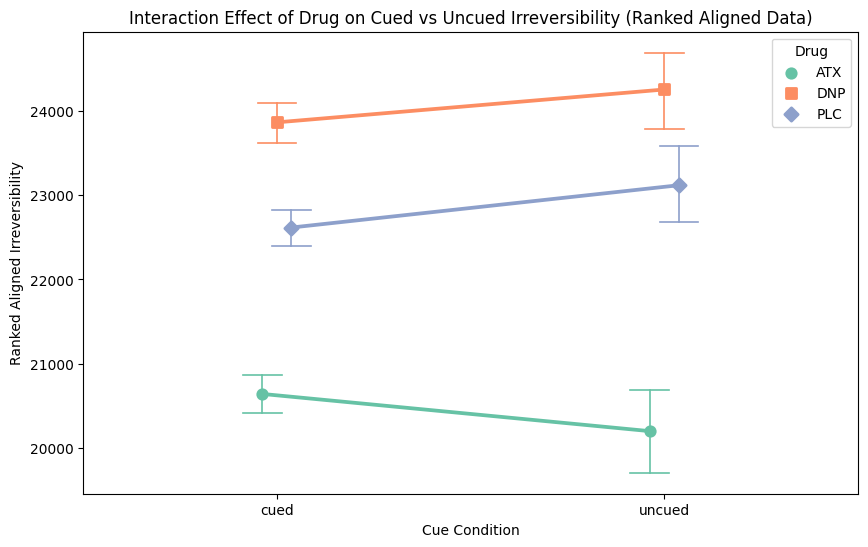

In [49]:
import pandas as pd
import numpy as np
from scipy.stats import rankdata
from statsmodels.formula.api import ols
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'df' is your DataFrame and it includes the columns: 
# 'subject', 'drug', 'cue_val', 'poststim_irrev'

behavior = df.copy()

# Calculate cued and uncued irreversibilities
behavior['cued_irrev'] = np.where(behavior['cue_val'] == 1, behavior['poststim_irrev'], np.nan)
behavior['uncued_irrev'] = np.where(behavior['cue_val'] == 0, behavior['poststim_irrev'], np.nan)

# Drop rows where both cued and uncued irreversibilities are NaN
behavior.dropna(subset=['cued_irrev', 'uncued_irrev'], how='all', inplace=True)
# Reshape the data to long format
long_df = pd.melt(behavior, id_vars=['subject', 'drug', 'cue_val'], value_vars=['cued_irrev', 'uncued_irrev'], 
                  var_name='cue_condition', value_name='irreversibility')

# Rename levels for clarity
long_df['cue_condition'] = long_df['cue_condition'].map({'cued_irrev': 'cued', 'uncued_irrev': 'uncued'})

# Check for any missing values or zero-length groups
print(long_df.isnull().sum())
print(long_df.groupby(['cue_condition', 'drug']).size())
print(long_df.head())

# Drop any rows with missing values
long_df.dropna(subset=['irreversibility'], inplace=True)
# Calculate grand mean
grand_mean = long_df['irreversibility'].mean()

# Calculate marginal means
cue_means = long_df.groupby('cue_condition')['irreversibility'].mean()
drug_means = long_df.groupby('drug')['irreversibility'].mean()
interaction_means = long_df.groupby(['cue_condition', 'drug'])['irreversibility'].mean()

# Align the data
def align_data(row):
    cue_mean = cue_means[row['cue_condition']]
    drug_mean = drug_means[row['drug']]
    interaction_mean = interaction_means[row['cue_condition'], row['drug']]
    aligned_value = row['irreversibility'] - cue_mean - drug_mean + interaction_mean + grand_mean
    return aligned_value

long_df['aligned_irreversibility'] = long_df.apply(align_data, axis=1)

# Rank the aligned data
long_df['ranked_aligned_irreversibility'] = rankdata(long_df['aligned_irreversibility'])
# Ensure all categorical variables are treated correctly
long_df['cue_condition'] = long_df['cue_condition'].astype('category')
long_df['drug'] = long_df['drug'].astype('category')

# Perform ANOVA on ranked aligned data
model = ols('ranked_aligned_irreversibility ~ C(cue_condition) * C(drug)', data=long_df).fit()
anova_table = sm.stats.anova_lm(model, typ=2)
print(anova_table)

# Plot the interaction
plt.figure(figsize=(10, 6))
sns.pointplot(data=long_df, x='cue_condition', y='ranked_aligned_irreversibility', hue='drug', dodge=True, markers=['o', 's', 'D'], capsize=.1, errwidth=1.2, palette='Set2')
plt.title('Interaction Effect of Drug on Cued vs Uncued Irreversibility (Ranked Aligned Data)')
plt.xlabel('Cue Condition')
plt.ylabel('Ranked Aligned Irreversibility')
plt.legend(title='Drug')
plt.show()


# 5/28 

In [131]:
print("Poststim: ")
post_avg_refmatrix = np.mean(behavior['poststim_ref_mat'])
row = np.mean(post_avg_refmatrix, axis=1)
col = np.mean(post_avg_refmatrix, axis=0)
post_channel_contribution = row + col

specific_electrodes = ['CPz', 'CP1', 'CP2']

electrode_indices = [channels.index(elec) for elec in specific_electrodes if elec in channels]

# Get the contribution values for these specific electrodes
behavior['specific_contributions'] = post_channel_contribution[electrode_indices]

print(behavior['specific_contributions'])

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu



behavior = df
#behavior = behavior[behavior['drug'] == drug]
behavior = behavior[behavior['drug']=='PLC']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]

correct_irrev = behavior[behavior['correct'] == 1]['poststim_irrev']
incorrect_irrev = behavior[behavior['correct'] == 0]['poststim_irrev']



# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[correct_irrev, incorrect_irrev], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Correct', 'Incorrect'])
#ax.set_title('ATX')


# Perform the Mann-Whitney U test
stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev, alternative = 'two-sided')
print(f'Statistic: {stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(correct_irrev, 75)
Q3_group2 = np.percentile(incorrect_irrev, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of correct: " + str(np.mean(correct_irrev)))
print("mean of incorrect: " + str(np.mean(incorrect_irrev)))
print("median of correct: " + str(np.median(correct_irrev)))
print("median of incorrect: " + str(np.median(incorrect_irrev)))

plt.show()

plt.hist(np.log(correct_irrev), bins=100, color='blue', alpha=0.5, label='Correct', density = True)
plt.hist(np.log(incorrect_irrev), bins=100, color='red', alpha=0.5, label='Incorrect', density = True)
plt.xlim(-8.5,-2)
plt.legend()
plt.title('Post-Stimulus Irrev (logged) split by correctness')
plt.show()

#Well shit.




Poststim: 


ValueError: Length of values (3) does not match length of index (44735)

## #1 test-

Statistic: 19459246.0, P-value: 0.03911650457344336
mean of correct: 0.010954392376811152
mean of incorrect: 0.011274977438451936
median of correct: 0.00918979590977709
median of incorrect: 0.009507670282643344


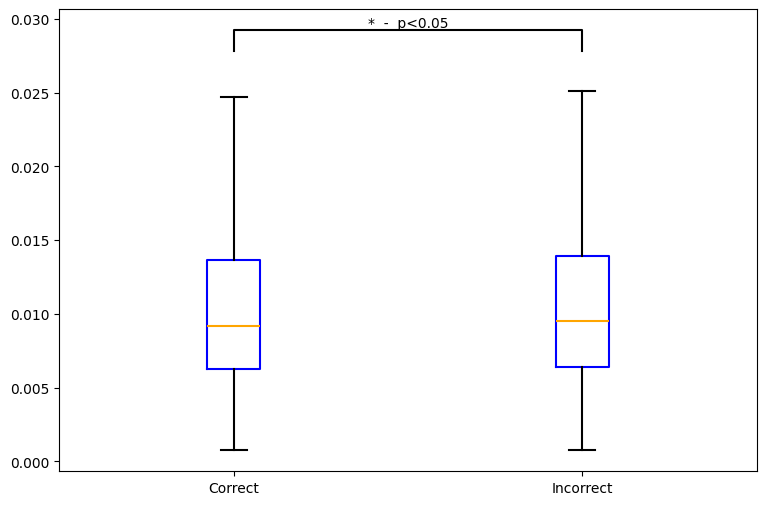

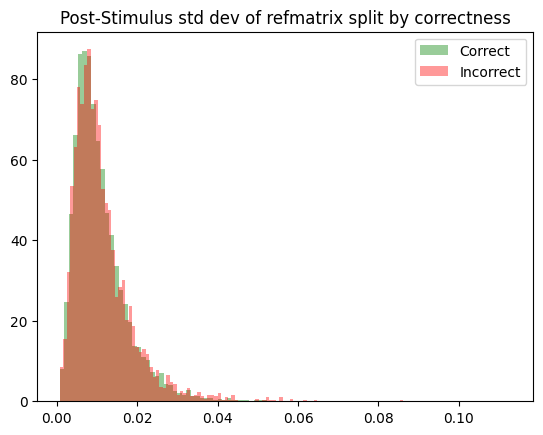

In [122]:
behavior = df

std_devs = [np.std(matrix) for matrix in behavior['poststim_ref_mat']]
behavior['std_devs'] = std_devs

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

#behavior = behavior[behavior['drug'] == drug]
behavior = behavior[behavior['drug']=='PLC']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]

correct_irrev = behavior[behavior['correct'] == 1]['std_devs']
incorrect_irrev = behavior[behavior['correct'] == 0]['std_devs']



# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[correct_irrev, incorrect_irrev], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Correct', 'Incorrect'])
#ax.set_title('ATX')


# Perform the Mann-Whitney U test
stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev, alternative = 'two-sided')
print(f'Statistic: {stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(correct_irrev, 75)
Q3_group2 = np.percentile(incorrect_irrev, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of correct: " + str(np.mean(correct_irrev)))
print("mean of incorrect: " + str(np.mean(incorrect_irrev)))
print("median of correct: " + str(np.median(correct_irrev)))
print("median of incorrect: " + str(np.median(incorrect_irrev)))

plt.show()

plt.hist(correct_irrev, bins=100, color='green', alpha=0.4, label='Correct', density = True)
plt.hist(incorrect_irrev, bins=100, color='red', alpha=0.4, label='Incorrect', density = True)
plt.legend()
plt.title('Post-Stimulus std dev of refmatrix split by correctness')
plt.show()

#Well shit.



## #2 test -

diff

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

# Diff = (prestimulus_irrev_array - poststimulus_irrev_array)
#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
behavior = df
#behavior = behavior[behavior['drug']=='ATX']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]

correct_df = behavior[behavior['correct'] == 1]
incorrect_df = behavior[behavior['correct'] == 0]

correct_irrev = correct_df['stim_diff']
incorrect_irrev = incorrect_df['stim_diff']


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[correct_irrev, incorrect_irrev], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Correct', 'Incorrect'])
#ax.set_title('ATX')


# Perform the Mann-Whitney U test
stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev)
print(f'Statistic: {stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(correct_irrev, 75)
Q3_group2 = np.percentile(incorrect_irrev, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)


print("Mean correct: " + str(np.mean(behavior[behavior['correct']==1]['stim_diff'])))
print("Mean incorrect: " + str(np.mean(behavior[behavior['correct']==0]['stim_diff'])))
print("Median correct: " + str(np.median(behavior[behavior['correct']==1]['stim_diff'])))
print("Median incorrect: " + str(np.median(behavior[behavior['correct']==0]['stim_diff'])))
print(np.mean(behavior['stim_diff']))

plt.show()

#This is actually a good result

Statistic: 18677669.0, P-value: 2.0121408722164217e-08
mean of correct: 0.012415068851169345
mean of incorrect: 0.013509705344238634
median of correct: 0.008976366009411256
median of incorrect: 0.009736631989306611


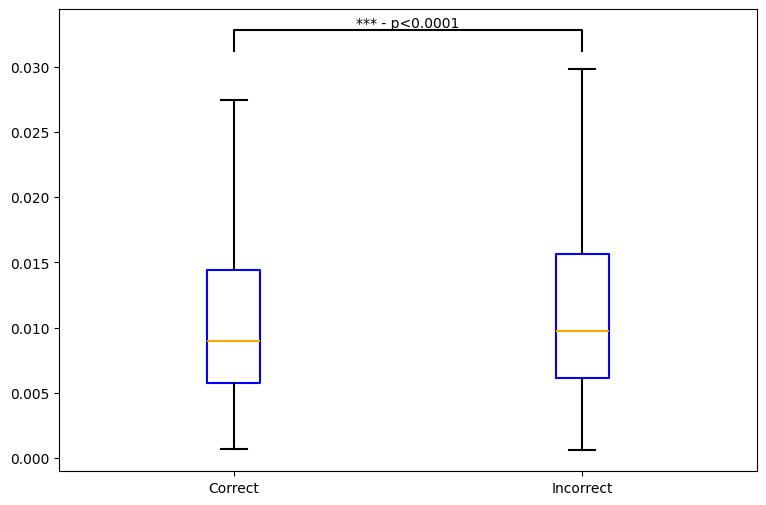

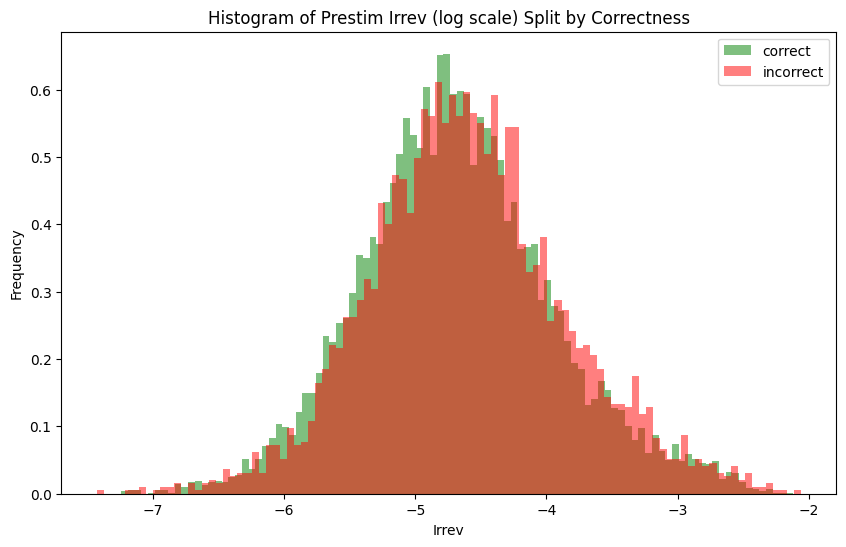

18677669.0
2.0121408722164217e-08
Mean corr: 0.012415068851169345
Mean incorr: 0.013509705344238634
The std dev of the correct values in the pretty histogram (logged irrev values): 0.7390389794892632
The std dev of the incorrect values in the pretty histogram (logged irrev values): 0.7530655285827496
The std dev of the correct values of raw: 0.011580510316502712
The std dev of the incorrect values of raw: 0.012657960551019427


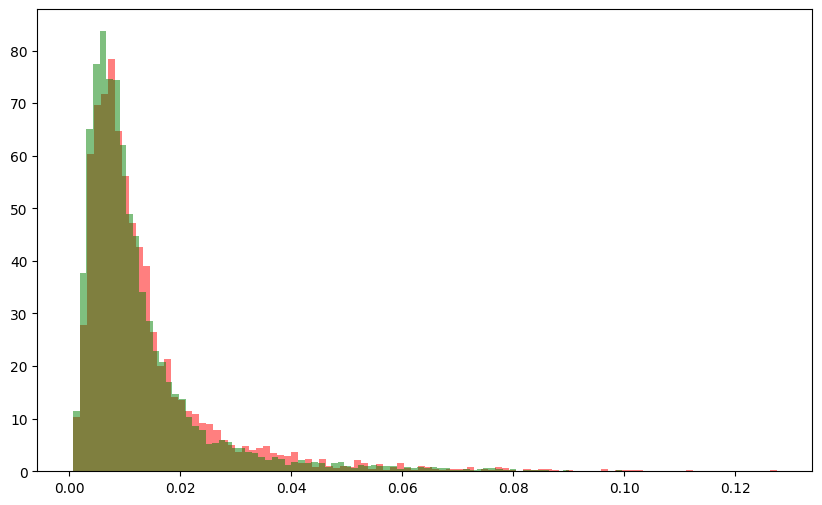

F test-- F-statistic: 1.1949577429246683, p-value: 0.9999999999875131
F test-- F-statistic: 0.8368496759998327, p-value: 0.9999999999875131
Levene's test statistic in raw: 12.138999951107214, p-value: 0.0004952282379668547
Brown-Forsythe test statistic in raw: 12.138999951107214, p-value: 0.0004952282379668547
Levene's test statistic in logged: 1.596461760981679, p-value: 0.2064255025198742
Brown-Forsythe test statistic in logged: 1.596461760981679, p-value: 0.2064255025198742


In [120]:

behavior = df

std_devs_array1 = [np.std(matrix) for matrix in behavior['prestim_ref_mat']]
behavior['std_devs1'] = std_devs_array1

std_devs_array2 = [np.std(matrix) for matrix in behavior['poststim_ref_mat']]
behavior['std_devs2'] = std_devs_array2


behavior = behavior[behavior['drug']=='PLC']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]



correct_irrev = behavior[behavior['correct'] == 1]['std_devs1']
incorrect_irrev = behavior[behavior['correct'] == 0]['std_devs1']



# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[correct_irrev, incorrect_irrev], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Correct', 'Incorrect'])
#ax.set_title('ATX')


# Perform the Mann-Whitney U test
stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev, alternative = 'two-sided')
print(f'Statistic: {stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(correct_irrev, 75)
Q3_group2 = np.percentile(incorrect_irrev, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of correct: " + str(np.mean(correct_irrev)))
print("mean of incorrect: " + str(np.mean(incorrect_irrev)))
print("median of correct: " + str(np.median(correct_irrev)))
print("median of incorrect: " + str(np.median(incorrect_irrev)))

plt.show()


# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['correct']==1]['std_devs1']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='correct', color='green', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['correct']==0]['std_devs1']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='incorrect', color='red', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestim Irrev (log scale) Split by Correctness')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean corr: "+str(np.mean(correct_irrev)))
print("Mean incorr: "+str(np.mean(incorrect_irrev)))
print("The std dev of the correct values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the incorrect values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the correct values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the incorrect values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = behavior[behavior['correct']==0]['std_devs1']
group2 = behavior[behavior['correct']==1]['std_devs1']

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='incorrect', color='red', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='correct', color='green', density = True)

plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")





Statistic: 56506783.0, P-value: 0.20480194482959735
mean of prestim: 0.011979542690280348
mean of poststim: 0.01036759388995016
median of prestim: 0.008012152566913152
median of poststim: 0.008407151631435055


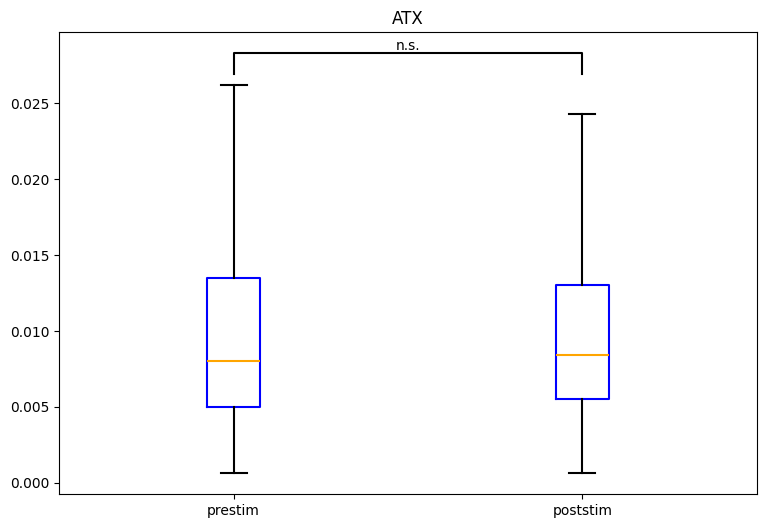

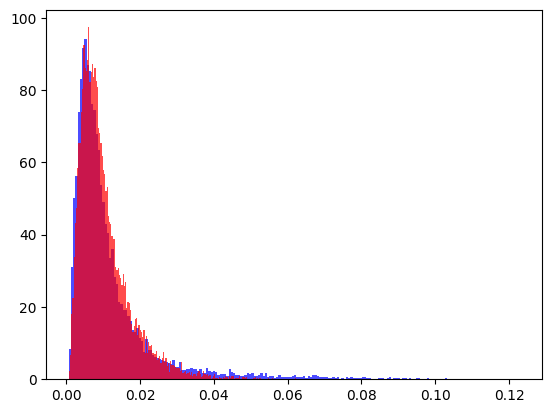

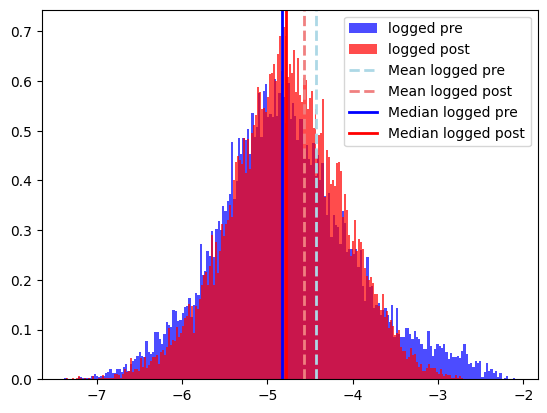

Statistic: 0.6228037787097754, P-value: 0.5334228659200597
Statistic: 111634292.0, P-value: 0.00031853770569728834


In [118]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

behavior = df

std_devs_array1 = [np.std(matrix) for matrix in behavior['prestim_ref_mat']]
behavior['std_devs1'] = std_devs_array1

std_devs_array2 = [np.std(matrix) for matrix in behavior['poststim_ref_mat']]
behavior['std_devs2'] = std_devs_array2

drug = 'ATX'
behavior = behavior[behavior['drug']==drug]
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
pre = behavior['std_devs1']
post = behavior['std_devs2']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['prestim', 'poststim'])
ax.set_title(drug)


# t test
from scipy import stats

t_stat, p_value = stats.wilcoxon(pre, post, alternative = "two-sided")
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '** - p<0.01'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of prestim: " + str(np.mean(pre)))
print("mean of poststim: " + str(np.mean(post)))
print("median of prestim: " + str(np.median(pre)))
print("median of poststim: " + str(np.median(post)))

plt.show()

plt.hist(pre, bins=200, color='blue', alpha=0.7, label='logged pre', density = True)
plt.hist(post, bins=200, color='red', alpha=0.7, label='logged post', density = True)

plt.show()

plt.hist(np.log(pre), bins=200, color='blue', alpha=0.7, label='logged pre', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.7, label='logged post', density = True)
plt.axvline(np.log(np.mean(pre)), color='lightblue', linestyle='dashed', linewidth=2, label='Mean logged pre')
plt.axvline(np.log(np.mean(post)), color='lightcoral', linestyle='dashed', linewidth=2, label='Mean logged post')

plt.axvline(np.log(np.median(pre)), color='blue', linestyle='solid', linewidth=2, label='Median logged pre')
plt.axvline(np.log(np.median(post)), color='red', linestyle='solid', linewidth=2, label='Median logged post')
plt.legend()
plt.show()

t_stat, p_value = stats.ttest_rel(np.log(pre), np.log(post))
print(f'Statistic: {t_stat}, P-value: {p_value}')

t_stat, p_value = mannwhitneyu(pre, post, alternative = "two-sided")
print(f'Statistic: {t_stat}, P-value: {p_value}')
#Well shit.

# 5/28 breakthrough

## poststim

C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2901092459.py:32: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2901092459.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0   -6.327043
1   -5.923771
2   -5.674180
3   -5.423622
4   -4.980590
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2901092459.py:32: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2901092459.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0   -6.284174
1   -5.881622
2   -5.637404
3   -5.384680
4   -4.958049
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2901092459.py:32: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2901092459.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0   -6.423122
1   -6.031608
2   -5.789093
3   -5.542767
4   -5.109134
Name: irrev, dtype: float64


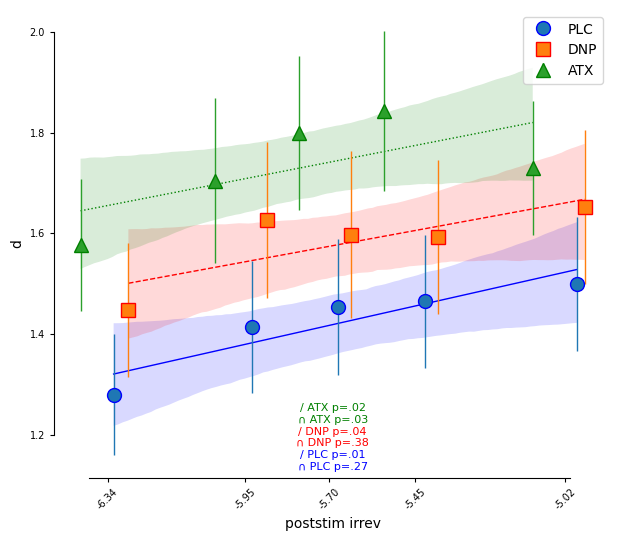

In [98]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe



# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

behavior['irrev'] = df['log_poststim']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for log_poststim'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('d')
ax.set_xlabel('poststim irrev')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



raw

C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\351769000.py:29: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\351769000.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: PLC
Bin means: irreversibility_bin
0    0.002048
1    0.002970
2    0.003772
3    0.004820
4    0.008374
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\351769000.py:29: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\351769000.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: DNP
Bin means: irreversibility_bin
0    0.002187
1    0.003154
2    0.003974
3    0.005037
4    0.008454
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\351769000.py:38: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']


Drug: ATX
Bin means: irreversibility_bin
0    0.001940
1    0.002800
2    0.003549
3    0.004520
4    0.007231
Name: irrev, dtype: float64


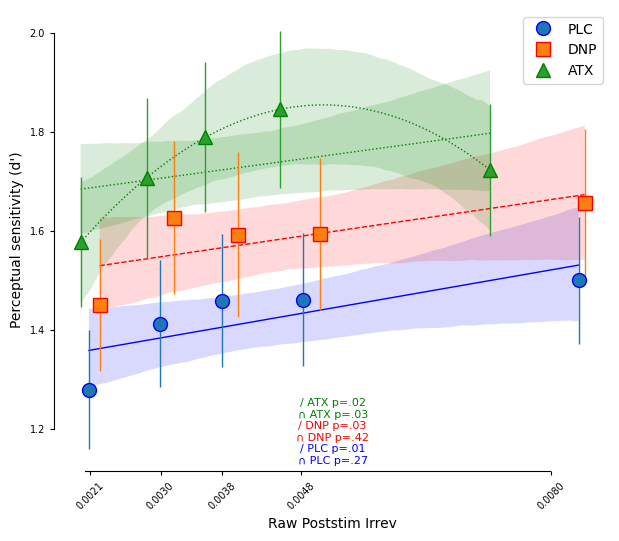

In [163]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp

# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df
behavior['irrev'] = df['poststim_irrev']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = True

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Raw Poststim Irrev')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.4f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



## CPP

C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\864229538.py:35: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\864229538.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: PLC
Bin means: irreversibility_bin
0   -5.892991
1   -5.297398
2   -4.910345
3   -4.501531
4   -3.846446
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\864229538.py:44: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\864229538.py:35: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']

Drug: DNP
Bin means: irreversibility_bin
0   -5.881508
1   -5.281381
2   -4.905048
3   -4.509194
4   -3.861418
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\864229538.py:44: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']


Drug: ATX
Bin means: irreversibility_bin
0   -5.970095
1   -5.366378
2   -4.994467
3   -4.612798
4   -3.981482
Name: irrev, dtype: float64


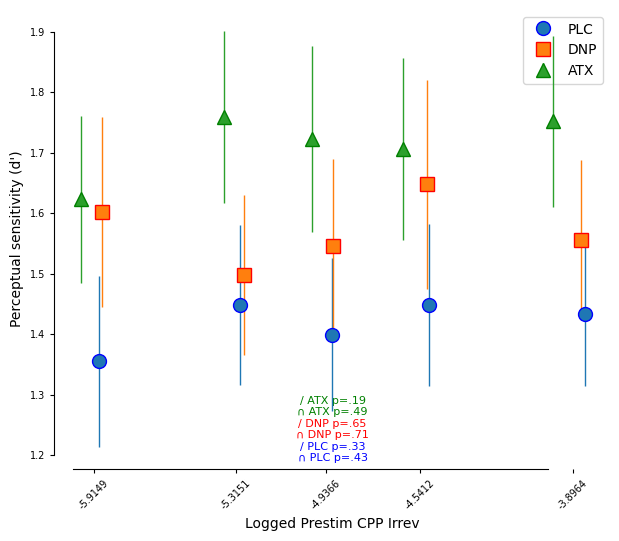

In [173]:
behavior['post_ref_matrices'] = df['prestim_ref_mat']

specific_electrodes = ['CPz', 'CP1', 'CP2']
electrode_indices = [channels.index(elec) for elec in specific_electrodes if elec in channels]

cpp_array = []
for matrix in behavior['post_ref_matrices']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    post_contribution = row + col
    post_cpp = np.mean(post_contribution[electrode_indices])
    cpp_array.append(post_cpp)

behavior['irrev'] = np.log(cpp_array)


def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Logged Prestim CPP Irrev')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.4f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



### testing some shit -- frontal electrodes in poststim

['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']


C:\Users\jaket\AppData\Local\Temp\ipykernel_12632\445105431.py:42: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12632\445105431.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: PLC
Bin means: irreversibility_bin
0   -6.178795
1   -5.568728
2   -5.178197
3   -4.789469
4   -4.169951
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12632\445105431.py:42: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12632\445105431.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: DNP
Bin means: irreversibility_bin
0   -6.225741
1   -5.575580
2   -5.170607
3   -4.759350
4   -4.117183
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12632\445105431.py:51: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
C:\Users\jaket\AppData\Local\Temp\ipykernel_12632\445105431.py:42: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']

Drug: ATX
Bin means: irreversibility_bin
0   -6.340536
1   -5.705216
2   -5.325140
3   -4.944708
4   -4.303730
Name: irrev, dtype: float64


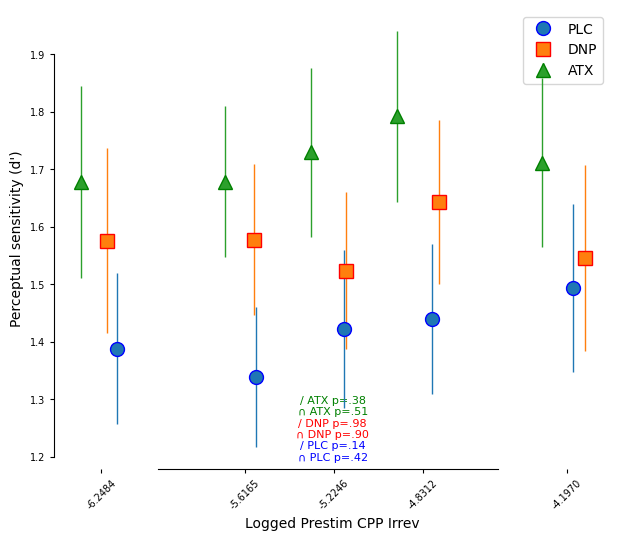

In [22]:
behavior = df

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)

behavior['post_ref_matrices'] = behavior['poststim_ref_mat']
print(channels)

specific_electrodes = ['F1', 'Fz', 'F3']
electrode_indices = [channels.index(elec) for elec in specific_electrodes if elec in channels]

cpp_array = []
for matrix in behavior['post_ref_matrices']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    post_contribution = row + col
    post_cpp = np.mean(post_contribution[electrode_indices])
    cpp_array.append(post_cpp)

behavior['irrev'] = np.log(cpp_array)


def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Logged Prestim CPP Irrev')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.4f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



### alpha in poststim CPP

C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2959591029.py:52: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2959591029.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0   -14.246627
1   -13.536819
2   -13.089866
3   -12.636691
4   -11.934698
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2959591029.py:52: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2959591029.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0   -14.145291
1   -13.421981
2   -12.985348
3   -12.532679
4   -11.856154
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2959591029.py:52: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2959591029.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0   -14.232066
1   -13.554724
2   -13.141244
3   -12.727100
4   -12.050750
Name: irrev, dtype: float64


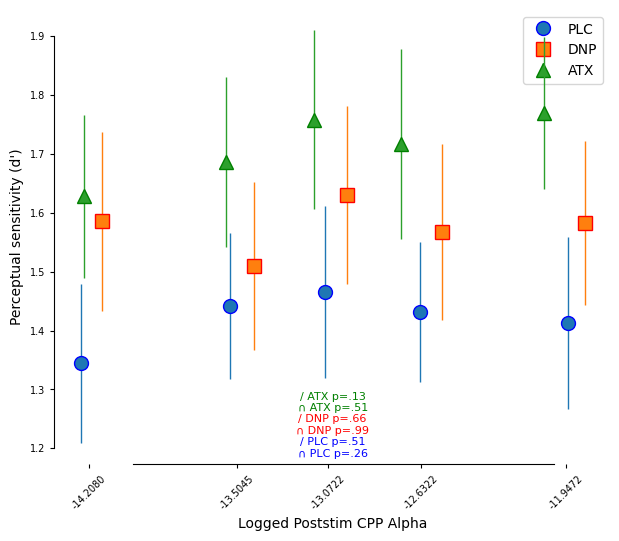

In [75]:

behavior = df
behavior['poststim_channel_alpha'] = [poststim_channel_alpha[i] for i in range(poststim_channel_alpha.shape[0])]
behavior['post_ref_matrices'] = behavior['poststim_channel_alpha']

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)



behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]


specific_electrodes = ['CPz', 'CP1', 'CP2']
electrode_indices = [channels.index(elec) for elec in specific_electrodes if elec in channels]

cpp_array = []
for matrix in behavior['post_ref_matrices']:
    post_cpp = np.mean(matrix[electrode_indices])
    cpp_array.append(post_cpp)

behavior['irrev'] = np.log(cpp_array)


def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Logged Poststim CPP Alpha')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.4f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



In [1]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df
behavior['poststim_channel_alpha'] = [poststim_channel_alpha[i] for i in range(poststim_channel_alpha.shape[0])]

specific_electrodes = ['CPz', 'CP1', 'CP2']
electrode_indices = [channels.index(elec) for elec in specific_electrodes if elec in channels]

cpp_array = []
for matrix in behavior['poststim_channel_alpha']:
    post_cpp = np.mean(matrix[electrode_indices])
    cpp_array.append(post_cpp)

behavior['CPP_alpha'] = np.log(cpp_array)

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'CPP_alpha', 0.999)

behavior = behavior[(behavior['poststim_irrev'] < 0.05) & (behavior['prestim_irrev'] < 0.05)]


behavior['post_ref_matrices'] = behavior['poststim_ref_mat']

specific_electrodes = ['CPz', 'CP1', 'CP2']
electrode_indices = [channels.index(elec) for elec in specific_electrodes if elec in channels]

cpp_array = []
for matrix in behavior['post_ref_matrices']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    post_contribution = row + col
    post_cpp = np.mean(post_contribution[electrode_indices])
    cpp_array.append(post_cpp)

behavior['irrev'] = np.log(cpp_array)

cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['CPP_alpha'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['CPP_alpha']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['CPP_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'CPP_alpha'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['CPP_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'CPP_alpha'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['CPP_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'CPP_alpha'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['CPP_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'CPP_alpha'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['CPP_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'CPP_alpha'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['CPP_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'CPP_alpha'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['CPP_alpha'] < 0.05 or betas_second_irreversibility_plc['CPP_alpha'] < 0.05:
    if betas_first_irreversibility_plc['CPP_alpha'] < betas_second_irreversibility_plc['CPP_alpha']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['CPP_alpha'] < betas_first_irreversibility_plc['CPP_alpha']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['CPP_alpha'] < 0.05 or betas_second_irreversibility_dnp['CPP_alpha'] < 0.05:
    if betas_first_irreversibility_dnp['CPP_alpha'] < betas_second_irreversibility_dnp['CPP_alpha']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['CPP_alpha'] < betas_first_irreversibility_dnp['CPP_alpha']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['CPP_alpha'] < 0.05 or betas_second_irreversibility_atx['CPP_alpha'] < 0.05:
    if betas_first_irreversibility_atx['CPP_alpha'] < betas_second_irreversibility_atx['CPP_alpha']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['CPP_alpha'] < betas_first_irreversibility_atx['CPP_alpha']:
        plot_quadratic_atx = True

# Plotting results for CPP_alpha'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['CPP_alpha']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['CPP_alpha']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['CPP_alpha']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['CPP_alpha']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['CPP_alpha']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['CPP_alpha']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="CPP_alpha", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['CPP_alpha']),
                                               p_val_string(betas_second_irreversibility_plc['CPP_alpha'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['CPP_alpha']),
                                               p_val_string(betas_second_irreversibility_dnp['CPP_alpha'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['CPP_alpha']),
                                               p_val_string(betas_second_irreversibility_atx['CPP_alpha'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Poststim CPP Alpha')
ax.set_xlabel('Poststim CPP Irrev')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



NameError: name 'df' is not defined

## prestim

C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2616691989.py:22: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2616691989.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0    0.001897
1    0.002910
2    0.003964
3    0.005422
4    0.009678
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2616691989.py:22: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2616691989.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0    0.002146
1    0.003255
2    0.004236
3    0.005606
4    0.009788
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2616691989.py:22: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2616691989.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0    0.001835
1    0.002860
2    0.003844
3    0.005153
4    0.008741
Name: irrev, dtype: float64
0.050469230682469265


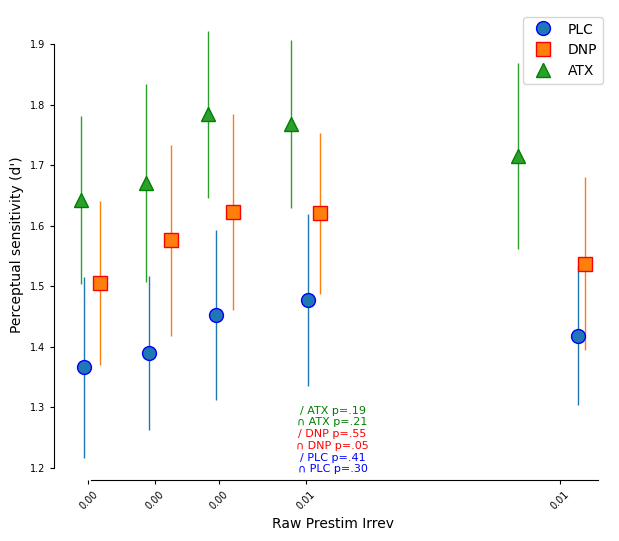

In [94]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp

# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df
behavior['irrev'] = df['prestim_irrev']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)
print(betas_second_irreversibility_dnp['d'])
# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Raw Prestim Irrev')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



## Pupil

### ANOVA

In [175]:
import pandas as pd
import numpy as np
import scipy.stats as sp
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
from statsmodels.formula.api import ols


# Data preparation
behavior = df
behavior['irreversibility'] = df['prestim_irrev']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
cfg = {'n_bins': 5}  # Number of pupil bins

df_group = behavior.sort_values(by=['subject','session','block'])

# Make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['bl_pupil'].agg(
    lambda x: list(pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject', 'drug', 'bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))
df_sdt['irreversibility'] = df_group.groupby(['subject', 'drug', 'bl_pupil_bin']).mean()['irreversibility']

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin', 'drug']).mean()
df_subject.reset_index(inplace=True)

df_irrev = df_subject

# Perform two-way ANOVA
formula = 'irreversibility ~ C(bl_pupil_bin) * C(drug)'
model = ols(formula, data=df_irrev).fit()
anova_table = sm.stats.anova_lm(model, typ=2)

# Print the ANOVA table
print(anova_table)

# Interpreting the results
print("Main Effect of Pupil Bin (C(bl_pupil_bin)):", anova_table.loc['C(bl_pupil_bin)', 'PR(>F)'])
print("Main Effect of Drug (C(drug)):", anova_table.loc['C(drug)', 'PR(>F)'])
print("Interaction Effect (C(bl_pupil_bin):C(drug)):", anova_table.loc['C(bl_pupil_bin):C(drug)', 'PR(>F)'])


                           sum_sq     df         F    PR(>F)
C(bl_pupil_bin)          0.000009    4.0  0.215748  0.929640
C(drug)                  0.000019    2.0  0.939351  0.391731
C(bl_pupil_bin):C(drug)  0.000003    8.0  0.039414  0.999977
Residual                 0.004203  405.0       NaN       NaN
Main Effect of Pupil Bin (C(bl_pupil_bin)): 0.9296397908791306
Main Effect of Drug (C(drug)): 0.39173136743660253
Interaction Effect (C(bl_pupil_bin):C(drug)): 0.9999766784253366


C:\Users\jaket\AppData\Local\Temp\ipykernel_25664\1061902212.py:24: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_sdt['irreversibility'] = df_group.groupby(['subject', 'drug', 'bl_pupil_bin']).mean()['irreversibility']


#### pairwise anova

In [33]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
from statsmodels.formula.api import ols

# Data preparation
behavior = df
behavior['irreversibility'] = df['prestim_irrev']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
cfg = {'n_bins': 5}  # Number of pupil bins

df_group = behavior.sort_values(by=['subject','session','block'])

# Make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['bl_pupil'].agg(
    lambda x: list(pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject', 'drug', 'bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))
df_sdt['irreversibility'] = df_group.groupby(['subject', 'drug', 'bl_pupil_bin']).mean()['irreversibility']

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin', 'drug']).mean()
df_subject.reset_index(inplace=True)

df_irrev = df_subject

# Define the pairs of drugs to compare
drug_pairs = [('ATX', 'PLC'), ('ATX', 'DNP'), ('PLC', 'DNP')]

# Perform pairwise two-way ANOVA
for drug1, drug2 in drug_pairs:
    pairwise_data = df_irrev[df_irrev['drug'].isin([drug1, drug2])]
    formula = 'irreversibility ~ C(bl_pupil_bin) * C(drug)'
    model = ols(formula, data=pairwise_data).fit()
    anova_table = sm.stats.anova_lm(model, typ=2)
    
    print(f"\nANOVA for {drug1} vs {drug2}:")
    print(anova_table)
    print("Main Effect of Pupil Bin (C(bl_pupil_bin)):", anova_table.loc['C(bl_pupil_bin)', 'PR(>F)'])
    print("Main Effect of Drug (C(drug)):", anova_table.loc['C(drug)', 'PR(>F)'])
    print("Interaction Effect (C(bl_pupil_bin):C(drug)):", anova_table.loc['C(bl_pupil_bin):C(drug)', 'PR(>F)'])



ANOVA for ATX vs PLC:
                           sum_sq     df         F    PR(>F)
C(bl_pupil_bin)          0.000007    4.0  0.160437  0.958126
C(drug)                  0.000003    1.0  0.254736  0.614171
C(bl_pupil_bin):C(drug)  0.000002    4.0  0.045008  0.996159
Residual                 0.002754  270.0       NaN       NaN
Main Effect of Pupil Bin (C(bl_pupil_bin)): 0.9581261384610571
Main Effect of Drug (C(drug)): 0.6141713978944224
Interaction Effect (C(bl_pupil_bin):C(drug)): 0.996158717058385

ANOVA for ATX vs DNP:
                           sum_sq     df         F    PR(>F)
C(bl_pupil_bin)          0.000009    4.0  0.189984  0.943511
C(drug)                  0.000019    1.0  1.603939  0.206437
C(bl_pupil_bin):C(drug)  0.000001    4.0  0.023169  0.998952
Residual                 0.003209  270.0       NaN       NaN
Main Effect of Pupil Bin (C(bl_pupil_bin)): 0.9435109169431805
Main Effect of Drug (C(drug)): 0.20643743797846167
Interaction Effect (C(bl_pupil_bin):C(drug)): 0.99895

C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\4215959373.py:20: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_sdt['irreversibility'] = df_group.groupby(['subject', 'drug', 'bl_pupil_bin']).mean()['irreversibility']


#### with alpha

In [35]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
from statsmodels.formula.api import ols

# Data preparation
behavior = df
behavior['irreversibility'] = df['prestim_irrev']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
cfg = {'n_bins': 5}  # Number of pupil bins

df_group = behavior.sort_values(by=['subject','session','block'])

# Make bins
df_group['bl_pupil_bin'] = np.concatenate(np.ravel(df_group.groupby(['subject','session','block'])['bl_pupil'].agg(
    lambda x: list(pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))))))

correct_counts = True
df_sdt = df_group.groupby(['subject', 'drug', 'bl_pupil_bin']).apply(lambda x: sdt(x, correct_counts))
df_sdt['irreversibility'] = df_group.groupby(['subject', 'drug', 'bl_pupil_bin']).mean()['irreversibility']
df_sdt['prestim_mean_alpha'] = df_group.groupby(['subject', 'drug', 'bl_pupil_bin']).mean()['prestim_mean_alpha']

df_subject = df_sdt.groupby(['subject', 'bl_pupil_bin', 'drug']).mean()
df_subject.reset_index(inplace=True)

df_irrev = df_subject

# Check for and handle NaN and Inf values
df_irrev = df_irrev.replace([np.inf, -np.inf], np.nan).dropna()

# Define the pairs of drugs to compare
drug_pairs = [('ATX', 'PLC'), ('ATX', 'DNP'), ('PLC', 'DNP')]

# Perform pairwise two-way ANOVA
for drug1, drug2 in drug_pairs:
    pairwise_data = df_irrev[df_irrev['drug'].isin([drug1, drug2])]
    formula = 'irreversibility ~ C(bl_pupil_bin) * C(drug) + prestim_mean_alpha'
    model = ols(formula, data=pairwise_data).fit()
    anova_table = sm.stats.anova_lm(model, typ=2)
    
    print(f"\nANOVA for {drug1} vs {drug2}:")
    print(anova_table)
    print("Main Effect of Pupil Bin (C(bl_pupil_bin)):", anova_table.loc['C(bl_pupil_bin)', 'PR(>F)'])
    print("Main Effect of Drug (C(drug)):", anova_table.loc['C(drug)', 'PR(>F)'])
    print("Main Effect of prestim_mean_alpha:", anova_table.loc['prestim_mean_alpha', 'PR(>F)'])
    print("Interaction Effect (C(bl_pupil_bin):C(drug)):", anova_table.loc['C(bl_pupil_bin):C(drug)', 'PR(>F)'])


C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\2837837490.py:20: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_sdt['irreversibility'] = df_group.groupby(['subject', 'drug', 'bl_pupil_bin']).mean()['irreversibility']
C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\2837837490.py:21: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_sdt['prestim_mean_alpha'] = df_group.groupby(['subject', 'drug', 'bl_pupil_bin']).mean()['prestim_mean_alpha']



ANOVA for ATX vs PLC:
                               sum_sq     df          F    PR(>F)
C(bl_pupil_bin)          5.393021e-06    4.0   0.137518  0.968292
C(drug)                  7.616847e-07    1.0   0.077690  0.780667
C(bl_pupil_bin):C(drug)  1.489109e-06    4.0   0.037971  0.997240
prestim_mean_alpha       1.164201e-04    1.0  11.874538  0.000660
Residual                 2.637324e-03  269.0        NaN       NaN
Main Effect of Pupil Bin (C(bl_pupil_bin)): 0.968292332675756
Main Effect of Drug (C(drug)): 0.7806670342423933
Main Effect of prestim_mean_alpha: 0.0006600811506341111
Interaction Effect (C(bl_pupil_bin):C(drug)): 0.9972399336743432

ANOVA for ATX vs DNP:
                               sum_sq     df         F    PR(>F)
C(bl_pupil_bin)          8.026174e-06    4.0  0.173133  0.952041
C(drug)                  5.584858e-06    1.0  0.481885  0.488169
C(bl_pupil_bin):C(drug)  7.624838e-07    4.0  0.016448  0.999467
prestim_mean_alpha       9.114549e-05    1.0  7.864418  0.005409

### Slide 8 but on one plot

C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\3811403046.py:24: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\3811403046.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0    3246.247271
1    3421.298886
2    3520.195006
3    3621.374967
4    3807.405521
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\3811403046.py:24: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\3811403046.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0    3219.803603
1    3391.597857
2    3489.526525
3    3586.410644
4    3758.369762
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\3811403046.py:24: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\3811403046.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0    3449.409712
1    3641.324911
2    3751.355072
3    3863.530534
4    4063.979878
Name: irrev, dtype: float64


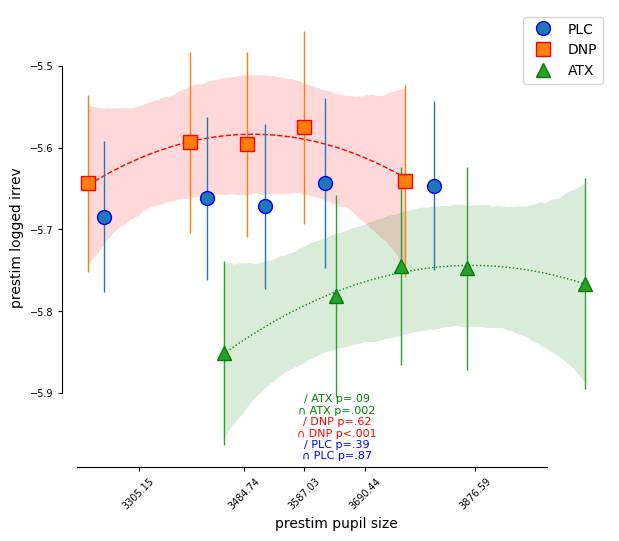

In [70]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df
#behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
behavior['irrev'] = df['bl_pupil']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['prestim_mean_alpha'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['log_prestim']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_mean_alpha'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_mean_alpha'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_mean_alpha'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_mean_alpha'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_mean_alpha'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_mean_alpha'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['prestim_mean_alpha'] < 0.05 or betas_second_irreversibility_plc['prestim_mean_alpha'] < 0.05:
    if betas_first_irreversibility_plc['prestim_mean_alpha'] < betas_second_irreversibility_plc['prestim_mean_alpha']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['prestim_mean_alpha'] < betas_first_irreversibility_plc['prestim_mean_alpha']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['prestim_mean_alpha'] < 0.05 or betas_second_irreversibility_dnp['prestim_mean_alpha'] < 0.05:
    if betas_first_irreversibility_dnp['prestim_mean_alpha'] < betas_second_irreversibility_dnp['prestim_mean_alpha']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['prestim_mean_alpha'] < betas_first_irreversibility_dnp['prestim_mean_alpha']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['prestim_mean_alpha'] < 0.05 or betas_second_irreversibility_atx['prestim_mean_alpha'] < 0.05:
    if betas_first_irreversibility_atx['prestim_mean_alpha'] < betas_second_irreversibility_atx['prestim_mean_alpha']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['prestim_mean_alpha'] < betas_first_irreversibility_atx['prestim_mean_alpha']:
        plot_quadratic_atx = True

# Plotting results for prestim_mean_alpha'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['prestim_mean_alpha']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['prestim_mean_alpha']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['prestim_mean_alpha']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['prestim_mean_alpha']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['prestim_mean_alpha']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['prestim_mean_alpha']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="prestim_mean_alpha", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['prestim_mean_alpha']),
                                               p_val_string(betas_second_irreversibility_plc['prestim_mean_alpha'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['prestim_mean_alpha']),
                                               p_val_string(betas_second_irreversibility_dnp['prestim_mean_alpha'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['prestim_mean_alpha']),
                                               p_val_string(betas_second_irreversibility_atx['prestim_mean_alpha'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('prestim logged irrev')
ax.set_xlabel('prestim pupil size')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



## d'

C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2666686367.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irrev'] = df['bl_pupil']
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2666686367.py:24: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels

Drug: PLC
Bin means: irreversibility_bin
0    3246.753809
1    3421.402747
2    3520.846856
3    3621.371062
4    3807.562004
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2666686367.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2666686367.py:33: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']


Drug: DNP
Bin means: irreversibility_bin
0    3220.357778
1    3392.390773
2    3489.861607
3    3587.106597
4    3758.788470
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2666686367.py:24: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2666686367.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0    3449.409712
1    3641.546674
2    3751.400788
3    3863.731226
4    4063.915793
Name: irrev, dtype: float64


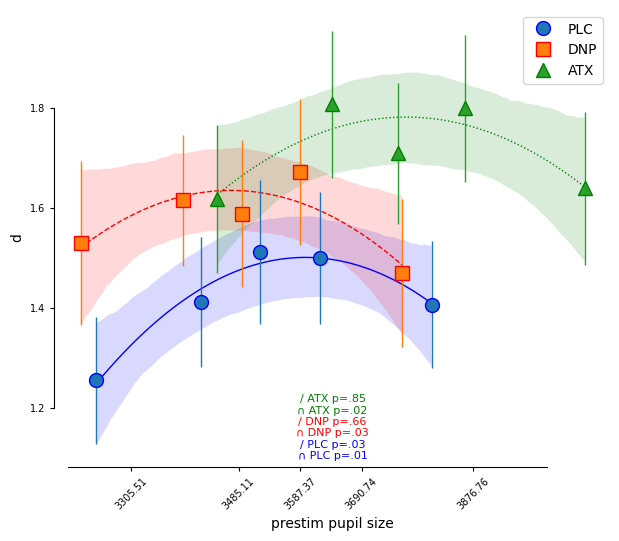

In [115]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior['irrev'] = df['bl_pupil']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    #df_sdt_irreversibility['d'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['log_prestim']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('d')
ax.set_xlabel('prestim pupil size')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



# Alpha

## alpha topoplots pre / post

44790


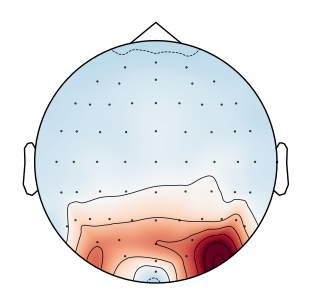

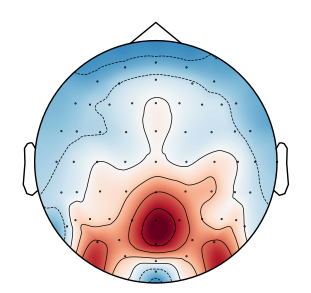

(<matplotlib.image.AxesImage at 0x19bddde7a90>,
 <matplotlib.contour.QuadContourSet at 0x19bddde7df0>)

In [8]:
import pandas as pd
import numpy as np
from scipy.stats import rankdata
from statsmodels.formula.api import ols
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore

behavior = df
print(len(behavior))

behavior['prestim_channel_alpha'] = [prestim_channel_alpha[i] for i in range(prestim_channel_alpha.shape[0])]
behavior['poststim_channel_alpha'] = [poststim_channel_alpha[i] for i in range(poststim_channel_alpha.shape[0])]

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.995)
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.995)


zscore_matrix = zscore(behavior['prestim_channel_alpha'].mean(), axis=None)
zscore_matrix1 = zscore(behavior['poststim_channel_alpha'].mean(), axis=None)


data1 = np.zeros((64, 128)) # Replace with your data
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
channel_locs = montage.get_positions()['ch_pos']
info = mne.create_info(channels, sfreq=128, ch_types='eeg')
info.set_montage(montage) # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)

info = mne.create_info(channels, sfreq=128, ch_types='eeg')  # Adjust accordingly
raw = mne.io.RawArray(data1, info, verbose = False)

# Set montage if known
montage = mne.channels.make_standard_montage('biosemi64')
raw.set_montage(montage)

mne.viz.plot_topomap(zscore_matrix, raw.info, res = 400, size = 3)
mne.viz.plot_topomap(zscore_matrix1, raw.info, res = 400, size = 3)

0        9.353471e-06
1        2.174312e-06
2        9.601332e-07
3        4.683720e-06
4        7.171046e-07
             ...     
44785    3.411014e-06
44786    2.332792e-05
44787    7.579263e-06
44788    1.014534e-05
44789    3.867557e-06
Name: prestim_mean_alpha, Length: 44790, dtype: float64


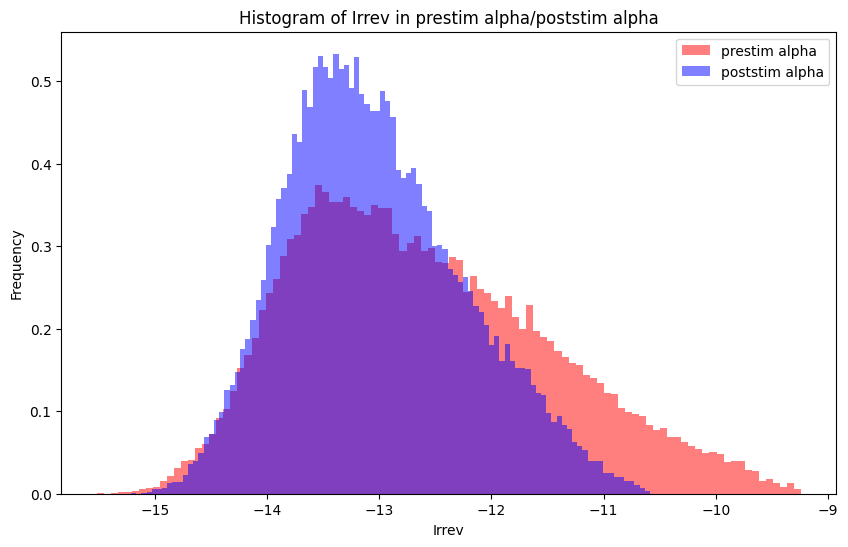

The mean of prestim alpha (raw irrev values): 6.776661488463716e-06
The mean of poststim alpha (raw irrev values): 3.0515760302273045e-06
The median of prestim alpha (raw irrev values): 2.8463218849942866e-06
The median of poststim alpha (raw irrev values): 1.9960949039349627e-06
The std dev of prestim alpha (logged irrev values): 1.0589246893240928e-05
The std dev of poststim alpha (logged irrev values): 2.9973576495632344e-06


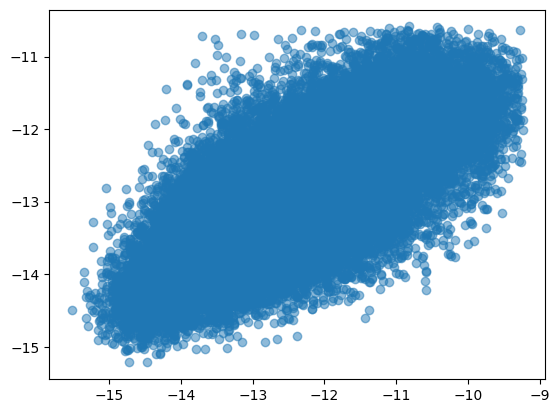

In [9]:

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

behavior = df

print(behavior['prestim_mean_alpha'])

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)

plt.hist(np.log(behavior['prestim_mean_alpha']), bins=100, alpha=0.5, label='prestim alpha', color='red', density = True)
plt.hist(np.log(behavior['poststim_mean_alpha']), bins=100, alpha=0.5, label='poststim alpha', color='blue', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Irrev in prestim alpha/poststim alpha')
plt.legend()

# Show the plot
plt.show()


plt.scatter(np.log(behavior['prestim_mean_alpha']), np.log(behavior['poststim_mean_alpha']), alpha=0.5)

print("The mean of prestim alpha (raw irrev values): "+str(np.mean(behavior['prestim_mean_alpha'])))
print("The mean of poststim alpha (raw irrev values): "+str(np.mean(behavior['poststim_mean_alpha'])))


print("The median of prestim alpha (raw irrev values): "+str(np.median(behavior['prestim_mean_alpha'])))
print("The median of poststim alpha (raw irrev values): "+str(np.median(behavior['poststim_mean_alpha'])))


print("The std dev of prestim alpha (logged irrev values): "+str(np.std(behavior['prestim_mean_alpha'])))
print("The std dev of poststim alpha (logged irrev values): "+str(np.std(behavior['poststim_mean_alpha'])))

## pupil / 1/f

In [10]:
max_index = df['prestim_mean_alpha'].idxmax()
print(f"The index of the maximum value in column 'C' is: {max_index}")

prestim_1overf = np.load(r'C:\Users\jaket\COGS280\DataDeco\prestim_1overf_slopes.npy')
df['prestim_1overf'] = prestim_1overf

The index of the maximum value in column 'C' is: 9152


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\3850645772.py:40: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\3850645772.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0    3173.397699
1    3321.605454
2    3394.729682
3    3449.075007
4    3497.438123
5    3544.936853
6    3595.011176
7    3648.530841
8    3726.111320
9    3886.630601
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\3850645772.py:40: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\3850645772.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0    3147.361523
1    3294.477330
2    3365.841229
3    3419.488997
4    3464.946308
5    3514.388920
6    3560.080163
7    3614.427143
8    3682.307719
9    3833.794343
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\3850645772.py:40: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\3850645772.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0    3371.143577
1    3529.554619
2    3608.816096
3    3673.342642
4    3726.539038
5    3775.663167
6    3834.729938
7    3891.648577
8    3974.783433
9    4151.232364
Name: irrev, dtype: float64


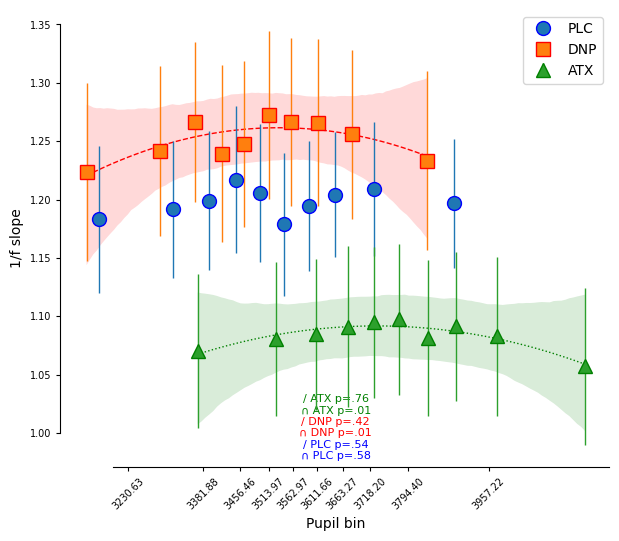

In [11]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_1overf', 0.999)



behavior = behavior[(behavior['poststim_irrev'] < 0.05) & (behavior['prestim_irrev'] < 0.05)]
behavior['irrev'] = behavior['bl_pupil']
cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['prestim_1overf'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['prestim_1overf']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['prestim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_1overf'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['prestim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_1overf'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['prestim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_1overf'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['prestim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_1overf'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['prestim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_1overf'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['prestim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_1overf'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['prestim_1overf'] < 0.05 or betas_second_irreversibility_plc['prestim_1overf'] < 0.05:
    if betas_first_irreversibility_plc['prestim_1overf'] < betas_second_irreversibility_plc['prestim_1overf']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['prestim_1overf'] < betas_first_irreversibility_plc['prestim_1overf']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['prestim_1overf'] < 0.05 or betas_second_irreversibility_dnp['prestim_1overf'] < 0.05:
    if betas_first_irreversibility_dnp['prestim_1overf'] < betas_second_irreversibility_dnp['prestim_1overf']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['prestim_1overf'] < betas_first_irreversibility_dnp['prestim_1overf']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['prestim_1overf'] < 0.05 or betas_second_irreversibility_atx['prestim_1overf'] < 0.05:
    if betas_first_irreversibility_atx['prestim_1overf'] < betas_second_irreversibility_atx['prestim_1overf']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['prestim_1overf'] < betas_first_irreversibility_atx['prestim_1overf']:
        plot_quadratic_atx = True

# Plotting results for prestim_1overf'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['prestim_1overf']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['prestim_1overf']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['prestim_1overf']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['prestim_1overf']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['prestim_1overf']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['prestim_1overf']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="prestim_1overf", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['prestim_1overf']),
                                               p_val_string(betas_second_irreversibility_plc['prestim_1overf'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['prestim_1overf']),
                                               p_val_string(betas_second_irreversibility_dnp['prestim_1overf'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['prestim_1overf']),
                                               p_val_string(betas_second_irreversibility_atx['prestim_1overf'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('1/f slope')
ax.set_xlabel('Pupil bin')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



## pupil / irrev

C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\3835680284.py:40: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\3835680284.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0    3172.522565
1    3321.065280
2    3392.669197
3    3448.824871
4    3495.920841
5    3544.070966
6    3594.106531
7    3647.109150
8    3725.242864
9    3885.294982
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\3835680284.py:40: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\3835680284.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0    3145.293533
1    3292.923295
2    3364.341032
3    3418.530099
4    3463.395713
5    3513.349674
6    3559.499866
7    3613.238498
8    3681.542808
9    3832.945693
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\3835680284.py:40: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\3835680284.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0    3369.796728
1    3528.654246
2    3607.296769
3    3672.736111
4    3725.438361
5    3774.797445
6    3834.982321
7    3890.053721
8    3974.864410
9    4150.719830
Name: irrev, dtype: float64


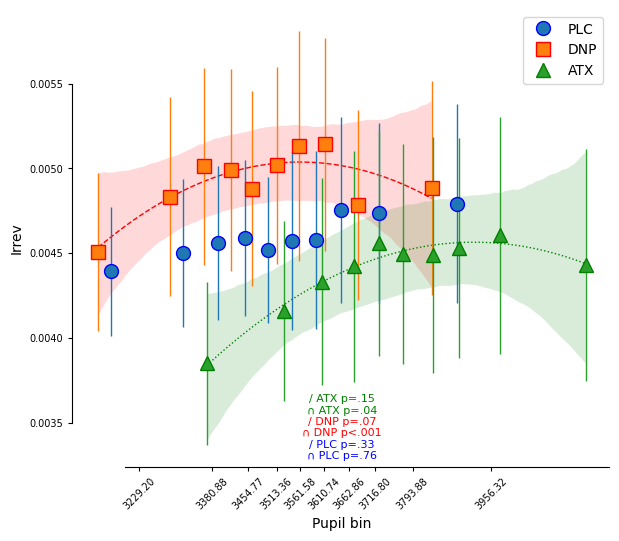

In [64]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_irrev', 0.995)



behavior = behavior[(behavior['poststim_irrev'] < 0.05) & (behavior['prestim_irrev'] < 0.05)]
behavior['irrev'] = behavior['bl_pupil']
cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['prestim_irrev'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['prestim_irrev']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['prestim_irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_irrev'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['prestim_irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_irrev'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['prestim_irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_irrev'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['prestim_irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_irrev'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['prestim_irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_irrev'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['prestim_irrev'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_irrev'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['prestim_irrev'] < 0.05 or betas_second_irreversibility_plc['prestim_irrev'] < 0.05:
    if betas_first_irreversibility_plc['prestim_irrev'] < betas_second_irreversibility_plc['prestim_irrev']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['prestim_irrev'] < betas_first_irreversibility_plc['prestim_irrev']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['prestim_irrev'] < 0.05 or betas_second_irreversibility_dnp['prestim_irrev'] < 0.05:
    if betas_first_irreversibility_dnp['prestim_irrev'] < betas_second_irreversibility_dnp['prestim_irrev']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['prestim_irrev'] < betas_first_irreversibility_dnp['prestim_irrev']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['prestim_irrev'] < 0.05 or betas_second_irreversibility_atx['prestim_irrev'] < 0.05:
    if betas_first_irreversibility_atx['prestim_irrev'] < betas_second_irreversibility_atx['prestim_irrev']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['prestim_irrev'] < betas_first_irreversibility_atx['prestim_irrev']:
        plot_quadratic_atx = True

# Plotting results for prestim_irrev'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['prestim_irrev']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['prestim_irrev']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['prestim_irrev']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['prestim_irrev']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['prestim_irrev']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['prestim_irrev']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="prestim_irrev", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['prestim_irrev']),
                                               p_val_string(betas_second_irreversibility_plc['prestim_irrev'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['prestim_irrev']),
                                               p_val_string(betas_second_irreversibility_dnp['prestim_irrev'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['prestim_irrev']),
                                               p_val_string(betas_second_irreversibility_atx['prestim_irrev'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Irrev')
ax.set_xlabel('Pupil bin')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



## pupil / alpha

## alpha / irrev

C:\Users\jaket\AppData\Local\Temp\ipykernel_5056\4272955223.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_5056\4272955223.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: PLC
Bin means: irreversibility_bin
0.0   -13.697992
1.0   -13.311117
2.0   -13.084224
3.0   -12.894191
4.0   -12.719445
5.0   -12.555500
6.0   -12.373609
7.0   -12.196456
8.0   -11.941794
9.0   -11.489466
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_5056\4272955223.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_5056\4272955223.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: DNP
Bin means: irreversibility_bin
0.0   -13.562381
1.0   -13.169422
2.0   -12.957212
3.0   -12.778965
4.0   -12.634019
5.0   -12.473981
6.0   -12.306564
7.0   -12.126096
8.0   -11.895713
9.0   -11.449610
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_5056\4272955223.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_5056\4272955223.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: ATX
Bin means: irreversibility_bin
0.0   -13.712493
1.0   -13.349928
2.0   -13.143074
3.0   -12.973225
4.0   -12.815019
5.0   -12.662937
6.0   -12.498454
7.0   -12.317210
8.0   -12.083234
9.0   -11.624106
Name: irrev, dtype: float64


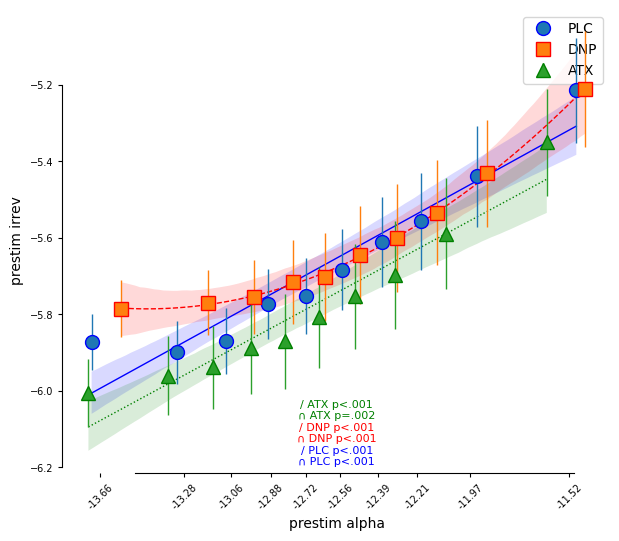

Slopes for linear models:
PLC: 0.06826875478290115
DNP: 0.05475105890439313
ATX: 0.061645857549153915
Slopes for quadratic models:
PLC: [-0.011634629434809113, -0.0009465851251816981, 0.0022875259107998924, 0.003587116173147442, 0.0072733505488727646, 0.018612382875308697, 0.004064952915212028, 0.014014804083498311, -0.002945317874699427, 0.002087615162871148, 0.005486305330931557, 0.01811574881596628, 0.005206644064905869, 0.003945554080056923, 0.021474163364266774, 0.006537518843179324, 0.011711031292557156, -0.01323985187410981, 0.018414489732856754, 0.009423997324710165, 0.0072559916046105455, 0.01014639614884938, 0.02376687444859693, 0.027307431629532752, 0.0023294002028937666, 0.01632220822289543, 0.0019468106729456092, 0.01217406661882775]
DNP: [-0.015173858695514575, 0.0015191179854354697, 0.0058918037192415285, 0.002272377960044203, 0.008696647878002839, 0.019108082654789416, 0.0007338435683652, 0.013252136436229661, -0.005882121316580974, 0.007936289987406808, 0.0015788409756

In [9]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df

def remove_top_percentile(dataframe, column, percentile=0.995):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe.loc[modified_dataframe[column] > threshold, column] = np.nan
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.995)

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior['irrev'] = np.log(behavior['prestim_mean_alpha'])
cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['log_prestim'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['log_prestim']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False



# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['log_prestim'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'log_prestim'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['log_prestim'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'log_prestim'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['log_prestim'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'log_prestim'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['log_prestim'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'log_prestim'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['log_prestim'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'log_prestim'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['log_prestim'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'log_prestim'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['log_prestim'] < 0.05 or betas_second_irreversibility_plc['log_prestim'] < 0.05:
    if betas_first_irreversibility_plc['log_prestim'] < betas_second_irreversibility_plc['log_prestim']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['log_prestim'] < betas_first_irreversibility_plc['log_prestim']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['log_prestim'] < 0.05 or betas_second_irreversibility_dnp['log_prestim'] < 0.05:
    if betas_first_irreversibility_dnp['log_prestim'] < betas_second_irreversibility_dnp['log_prestim']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['log_prestim'] < betas_first_irreversibility_dnp['log_prestim']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['log_prestim'] < 0.05 or betas_second_irreversibility_atx['log_prestim'] < 0.05:
    if betas_first_irreversibility_atx['log_prestim'] < betas_second_irreversibility_atx['log_prestim']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['log_prestim'] < betas_first_irreversibility_atx['log_prestim']:
        plot_quadratic_atx = True



# Plotting results for log_prestim'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['log_prestim']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['log_prestim']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['log_prestim']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['log_prestim']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['log_prestim']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['log_prestim']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="log_prestim", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['log_prestim']),
                                               p_val_string(betas_second_irreversibility_plc['log_prestim'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['log_prestim']),
                                               p_val_string(betas_second_irreversibility_dnp['log_prestim'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['log_prestim']),
                                               p_val_string(betas_second_irreversibility_atx['log_prestim'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('prestim irrev')
ax.set_xlabel('prestim alpha')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()

def run_model_irrevbin1(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model

# Adjust the code where `run_model_irrevbin1` is used to get the model object
def calculate_slope_and_pvalues(df_subject_irreversibility, deg, var):
    slopes = []
    p_values = []
    models = df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin1, deg, var)
    
    for model in models:
        slopes.append(model.params[deg])
        p_values.append(model.pvalues[deg])
        
    return slopes, p_values

# Calculate slopes and p-values for each drug and model
slopes_plc_linear, pvals_plc_linear = calculate_slope_and_pvalues(df_subject_irreversibility_plc, 1, 'log_prestim')
slopes_plc_quadratic, pvals_plc_quadratic = calculate_slope_and_pvalues(df_subject_irreversibility_plc, 2, 'log_prestim')

slopes_dnp_linear, pvals_dnp_linear = calculate_slope_and_pvalues(df_subject_irreversibility_dnp, 1, 'log_prestim')
slopes_dnp_quadratic, pvals_dnp_quadratic = calculate_slope_and_pvalues(df_subject_irreversibility_dnp, 2, 'log_prestim')

slopes_atx_linear, pvals_atx_linear = calculate_slope_and_pvalues(df_subject_irreversibility_atx, 1, 'log_prestim')
slopes_atx_quadratic, pvals_atx_quadratic = calculate_slope_and_pvalues(df_subject_irreversibility_atx, 2, 'log_prestim')

# Print slopes for linear models
print("Slopes for linear models:")
print("PLC:", np.mean(slopes_plc_linear))
print("DNP:", np.mean(slopes_dnp_linear))
print("ATX:", np.mean(slopes_atx_linear))

# Print slopes for quadratic models
print("Slopes for quadratic models:")
print("PLC:", slopes_plc_quadratic)
print("DNP:", slopes_dnp_quadratic)
print("ATX:", slopes_atx_quadratic)



C:\Users\jaket\AppData\Local\Temp\ipykernel_5056\3460144571.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_5056\3460144571.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: PLC
Bin means: irreversibility_bin
0   -13.790606
1   -13.525869
2   -13.378719
3   -13.256023
4   -13.141718
5   -13.029034
6   -12.892142
7   -12.760441
8   -12.567106
9   -12.167262
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_5056\3460144571.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_5056\3460144571.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: DNP
Bin means: irreversibility_bin
0   -13.711470
1   -13.448068
2   -13.300197
3   -13.175823
4   -13.065763
5   -12.951813
6   -12.834548
7   -12.693693
8   -12.511960
9   -12.103093
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_5056\3460144571.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_5056\3460144571.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: ATX
Bin means: irreversibility_bin
0   -13.787654
1   -13.523677
2   -13.380706
3   -13.259155
4   -13.149357
5   -13.043819
6   -12.923207
7   -12.794500
8   -12.613891
9   -12.205899
Name: irrev, dtype: float64


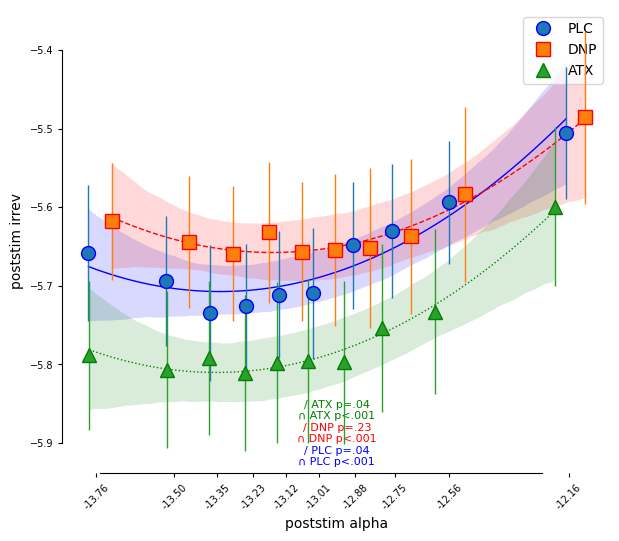

Slopes for linear models:
PLC: 0.017138500980957032
DNP: 0.010115770778396775
ATX: 0.014877867377510984
Slopes for quadratic models:
PLC: [0.013265110014589215, 0.003740671279622826, -0.003167414326677054, -0.0054527868005070645, 0.005379238133335684, 0.011108042167367993, 0.010437224860953553, 0.000927916123277639, 0.013915922586933666, -0.0010418887297901636, 0.008994312239931246, 0.014473658872522721, 0.003473764773506166, 0.006165659188697992, 0.0005875468462176736, 0.0019425777891726725, 0.006210986087472142, 0.006814137852996449, -8.223803511014927e-05, 0.004996311299102746, 0.004030002862990462, 0.007231342639643146, 0.008184667116672123, 0.010650666226534766, 0.009148288642702035, 0.016204319669313072, -0.0010043444238272692, 0.013760424505226188]
DNP: [-0.00016868661912641802, 0.0010665860033371444, 0.00034091706163402735, -0.0028576492874729242, -0.0005089447881352072, 0.010980829607012355, 0.0033921339999734568, 0.005811097492605388, 0.00554144662531636, -0.00190350376587472

In [10]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df

def remove_top_percentile(dataframe, column, percentile=0.995):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe.loc[modified_dataframe[column] > threshold, column] = np.nan
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior['irrev'] = np.log(behavior['poststim_mean_alpha'])
cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['log_poststim'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['log_poststim']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False



# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'log_poststim'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'log_poststim'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'log_poststim'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'log_poststim'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'log_poststim'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'log_poststim'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['log_poststim'] < 0.05 or betas_second_irreversibility_plc['log_poststim'] < 0.05:
    if betas_first_irreversibility_plc['log_poststim'] < betas_second_irreversibility_plc['log_poststim']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['log_poststim'] < betas_first_irreversibility_plc['log_poststim']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['log_poststim'] < 0.05 or betas_second_irreversibility_dnp['log_poststim'] < 0.05:
    if betas_first_irreversibility_dnp['log_poststim'] < betas_second_irreversibility_dnp['log_poststim']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['log_poststim'] < betas_first_irreversibility_dnp['log_poststim']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['log_poststim'] < 0.05 or betas_second_irreversibility_atx['log_poststim'] < 0.05:
    if betas_first_irreversibility_atx['log_poststim'] < betas_second_irreversibility_atx['log_poststim']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['log_poststim'] < betas_first_irreversibility_atx['log_poststim']:
        plot_quadratic_atx = True



# Plotting results for log_poststim'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['log_poststim']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['log_poststim']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['log_poststim']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['log_poststim']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['log_poststim']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['log_poststim']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="log_poststim", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['log_poststim']),
                                               p_val_string(betas_second_irreversibility_plc['log_poststim'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['log_poststim']),
                                               p_val_string(betas_second_irreversibility_dnp['log_poststim'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['log_poststim']),
                                               p_val_string(betas_second_irreversibility_atx['log_poststim'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('poststim irrev')
ax.set_xlabel('poststim alpha')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()

def run_model_irrevbin1(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model

# Adjust the code where `run_model_irrevbin1` is used to get the model object
def calculate_slope_and_pvalues(df_subject_irreversibility, deg, var):
    slopes = []
    p_values = []
    models = df_subject_irreversibility.groupby(['subject']).apply(run_model_irrevbin1, deg, var)
    
    for model in models:
        slopes.append(model.params[deg])
        p_values.append(model.pvalues[deg])
        
    return slopes, p_values

# Calculate slopes and p-values for each drug and model
slopes_plc_linear, pvals_plc_linear = calculate_slope_and_pvalues(df_subject_irreversibility_plc, 1, 'log_poststim')
slopes_plc_quadratic, pvals_plc_quadratic = calculate_slope_and_pvalues(df_subject_irreversibility_plc, 2, 'log_poststim')

slopes_dnp_linear, pvals_dnp_linear = calculate_slope_and_pvalues(df_subject_irreversibility_dnp, 1, 'log_poststim')
slopes_dnp_quadratic, pvals_dnp_quadratic = calculate_slope_and_pvalues(df_subject_irreversibility_dnp, 2, 'log_poststim')

slopes_atx_linear, pvals_atx_linear = calculate_slope_and_pvalues(df_subject_irreversibility_atx, 1, 'log_poststim')
slopes_atx_quadratic, pvals_atx_quadratic = calculate_slope_and_pvalues(df_subject_irreversibility_atx, 2, 'log_poststim')

# Print slopes for linear models
print("Slopes for linear models:")
print("PLC:", np.mean(slopes_plc_linear))
print("DNP:", np.mean(slopes_dnp_linear))
print("ATX:", np.mean(slopes_atx_linear))

# Print slopes for quadratic models
print("Slopes for quadratic models:")
print("PLC:", slopes_plc_quadratic)
print("DNP:", slopes_dnp_quadratic)
print("ATX:", slopes_atx_quadratic)



C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2011934853.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2011934853.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0.0   -13.793894
1.0   -13.529568
2.0   -13.382834
3.0   -13.262609
4.0   -13.147249
5.0   -13.035941
6.0   -12.903367
7.0   -12.769873
8.0   -12.579620
9.0   -12.200801
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2011934853.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2011934853.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0.0   -13.717328
1.0   -13.457913
2.0   -13.311338
3.0   -13.186776
4.0   -13.076972
5.0   -12.966040
6.0   -12.851372
7.0   -12.713249
8.0   -12.537069
9.0   -12.154446
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2011934853.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2011934853.py:42: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_sdt_irreversibility['log_poststim'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['log_poststim']
C:\Users\jaket\AppData\Local\Temp\ip

Drug: ATX
Bin means: irreversibility_bin
0.0   -13.789381
1.0   -13.527334
2.0   -13.383897
3.0   -13.263773
4.0   -13.155627
5.0   -13.047942
6.0   -12.930094
7.0   -12.800468
8.0   -12.625210
9.0   -12.228082
Name: irrev, dtype: float64


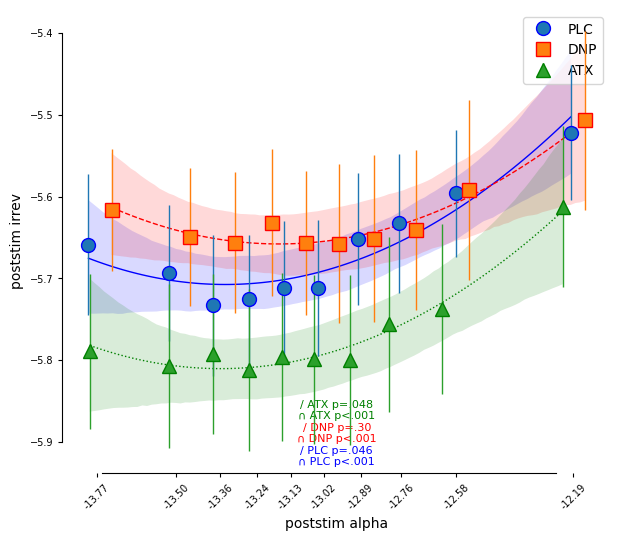

In [43]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df

def remove_top_percentile(dataframe, column, percentile=0.995):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe.loc[modified_dataframe[column] > threshold, column] = np.nan
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.995)

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior['irrev'] = np.log(behavior['poststim_mean_alpha'])
cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['log_poststim'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['log_poststim']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = True
plot_linear_dnp = False
plot_quadratic_dnp = True
plot_linear_atx = False
plot_quadratic_atx = True

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'log_poststim'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'log_poststim'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'log_poststim'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'log_poststim'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'log_poststim'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'log_poststim'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['log_poststim'] < 0.05 or betas_second_irreversibility_plc['log_poststim'] < 0.05:
    if betas_first_irreversibility_plc['log_poststim'] < betas_second_irreversibility_plc['log_poststim']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['log_poststim'] < betas_first_irreversibility_plc['log_poststim']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['log_poststim'] < 0.05 or betas_second_irreversibility_dnp['log_poststim'] < 0.05:
    if betas_first_irreversibility_dnp['log_poststim'] < betas_second_irreversibility_dnp['log_poststim']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['log_poststim'] < betas_first_irreversibility_dnp['log_poststim']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['log_poststim'] < 0.05 or betas_second_irreversibility_atx['log_poststim'] < 0.05:
    if betas_first_irreversibility_atx['log_poststim'] < betas_second_irreversibility_atx['log_poststim']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['log_poststim'] < betas_first_irreversibility_atx['log_poststim']:
        plot_quadratic_atx = True



# Plotting results for log_poststim'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['log_poststim']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['log_poststim']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['log_poststim']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['log_poststim']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['log_poststim']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['log_poststim']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="log_poststim", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['log_poststim']),
                                               p_val_string(betas_second_irreversibility_plc['log_poststim'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['log_poststim']),
                                               p_val_string(betas_second_irreversibility_dnp['log_poststim'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['log_poststim']),
                                               p_val_string(betas_second_irreversibility_atx['log_poststim'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('poststim irrev')
ax.set_xlabel('poststim alpha')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



## irrev / alpha

C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1148012034.py:39: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1148012034.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0   -6.579795
1   -6.228232
2   -6.046663
3   -5.888681
4   -5.752114
5   -5.613337
6   -5.467556
7   -5.314468
8   -5.105779
9   -4.697530
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1148012034.py:39: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1148012034.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0   -6.527227
1   -6.164931
2   -5.982910
3   -5.835987
4   -5.710426
5   -5.582346
6   -5.442915
7   -5.283628
8   -5.089975
9   -4.678571
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1148012034.py:39: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1148012034.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0   -6.681879
1   -6.323535
2   -6.151856
3   -6.006158
4   -5.875111
5   -5.743120
6   -5.602910
7   -5.457228
8   -5.254939
9   -4.833146
Name: irrev, dtype: float64


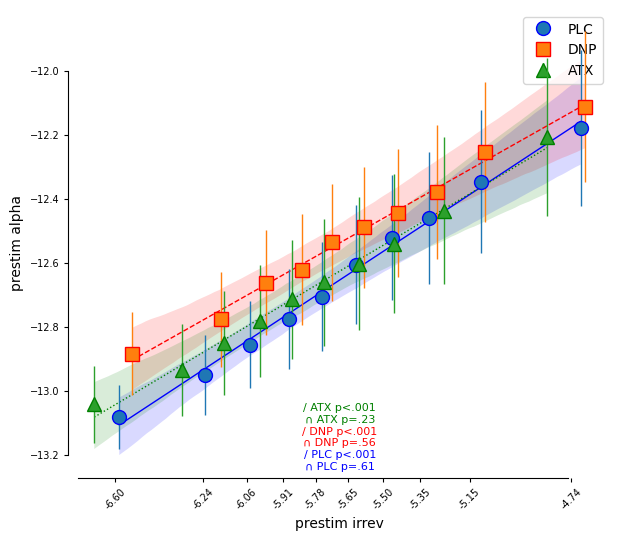

In [32]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df

def remove_top_percentile(dataframe, column, percentile=0.995):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe.loc[modified_dataframe[column] > threshold, column] = np.nan
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.995)

behavior['prestim_mean_alpha'] = np.log(behavior['prestim_mean_alpha'])
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior['irrev'] = behavior['log_prestim']
cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['prestim_mean_alpha'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['prestim_mean_alpha']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_mean_alpha'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_mean_alpha'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_mean_alpha'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_mean_alpha'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_mean_alpha'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_mean_alpha'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['prestim_mean_alpha'] < 0.05 or betas_second_irreversibility_plc['prestim_mean_alpha'] < 0.05:
    if betas_first_irreversibility_plc['prestim_mean_alpha'] < betas_second_irreversibility_plc['prestim_mean_alpha']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['prestim_mean_alpha'] < betas_first_irreversibility_plc['prestim_mean_alpha']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['prestim_mean_alpha'] < 0.05 or betas_second_irreversibility_dnp['prestim_mean_alpha'] < 0.05:
    if betas_first_irreversibility_dnp['prestim_mean_alpha'] < betas_second_irreversibility_dnp['prestim_mean_alpha']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['prestim_mean_alpha'] < betas_first_irreversibility_dnp['prestim_mean_alpha']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['prestim_mean_alpha'] < 0.05 or betas_second_irreversibility_atx['prestim_mean_alpha'] < 0.05:
    if betas_first_irreversibility_atx['prestim_mean_alpha'] < betas_second_irreversibility_atx['prestim_mean_alpha']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['prestim_mean_alpha'] < betas_first_irreversibility_atx['prestim_mean_alpha']:
        plot_quadratic_atx = True

# Plotting results for prestim_mean_alpha'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['prestim_mean_alpha']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['prestim_mean_alpha']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['prestim_mean_alpha']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['prestim_mean_alpha']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['prestim_mean_alpha']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['prestim_mean_alpha']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="prestim_mean_alpha", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['prestim_mean_alpha']),
                                               p_val_string(betas_second_irreversibility_plc['prestim_mean_alpha'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['prestim_mean_alpha']),
                                               p_val_string(betas_second_irreversibility_dnp['prestim_mean_alpha'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['prestim_mean_alpha']),
                                               p_val_string(betas_second_irreversibility_atx['prestim_mean_alpha'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('prestim alpha')
ax.set_xlabel('prestim irrev')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



Poststim

C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\607636723.py:39: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\607636723.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: PLC
Bin means: irreversibility_bin
0   -6.488275
1   -6.161321
2   -5.994346
3   -5.852227
4   -5.730950
5   -5.614854
6   -5.489452
7   -5.356032
8   -5.166470
9   -4.793641
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\607636723.py:39: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\607636723.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: DNP
Bin means: irreversibility_bin
0   -6.450394
1   -6.115238
2   -5.947231
3   -5.815072
4   -5.694688
5   -5.579347
6   -5.456151
7   -5.311884
8   -5.139497
9   -4.775819
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\607636723.py:39: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\607636723.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: ATX
Bin means: irreversibility_bin
0   -6.579400
1   -6.259958
2   -6.095884
3   -5.962755
4   -5.843537
5   -5.730284
6   -5.607372
7   -5.472609
8   -5.292268
9   -4.923920
Name: irrev, dtype: float64


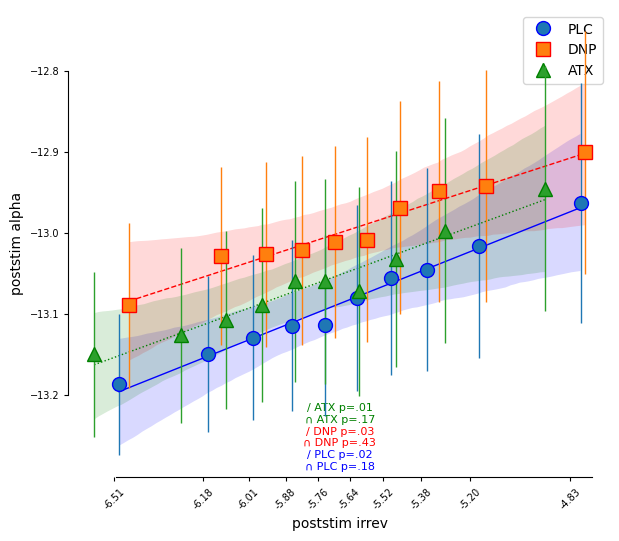

In [34]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df

def remove_top_percentile(dataframe, column, percentile=0.995):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe.loc[modified_dataframe[column] > threshold, column] = np.nan
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.995)

behavior['poststim_mean_alpha'] = np.log(behavior['poststim_mean_alpha'])
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior['irrev'] = behavior['log_poststim']
cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['poststim_mean_alpha'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['poststim_mean_alpha']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['poststim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'poststim_mean_alpha'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['poststim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'poststim_mean_alpha'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['poststim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'poststim_mean_alpha'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['poststim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'poststim_mean_alpha'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['poststim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'poststim_mean_alpha'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['poststim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'poststim_mean_alpha'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['poststim_mean_alpha'] < 0.05 or betas_second_irreversibility_plc['poststim_mean_alpha'] < 0.05:
    if betas_first_irreversibility_plc['poststim_mean_alpha'] < betas_second_irreversibility_plc['poststim_mean_alpha']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['poststim_mean_alpha'] < betas_first_irreversibility_plc['poststim_mean_alpha']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['poststim_mean_alpha'] < 0.05 or betas_second_irreversibility_dnp['poststim_mean_alpha'] < 0.05:
    if betas_first_irreversibility_dnp['poststim_mean_alpha'] < betas_second_irreversibility_dnp['poststim_mean_alpha']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['poststim_mean_alpha'] < betas_first_irreversibility_dnp['poststim_mean_alpha']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['poststim_mean_alpha'] < 0.05 or betas_second_irreversibility_atx['poststim_mean_alpha'] < 0.05:
    if betas_first_irreversibility_atx['poststim_mean_alpha'] < betas_second_irreversibility_atx['poststim_mean_alpha']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['poststim_mean_alpha'] < betas_first_irreversibility_atx['poststim_mean_alpha']:
        plot_quadratic_atx = True

# Plotting results for poststim_mean_alpha'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['poststim_mean_alpha']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['poststim_mean_alpha']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['poststim_mean_alpha']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['poststim_mean_alpha']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['poststim_mean_alpha']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['poststim_mean_alpha']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="poststim_mean_alpha", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['poststim_mean_alpha']),
                                               p_val_string(betas_second_irreversibility_plc['poststim_mean_alpha'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['poststim_mean_alpha']),
                                               p_val_string(betas_second_irreversibility_dnp['poststim_mean_alpha'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['poststim_mean_alpha']),
                                               p_val_string(betas_second_irreversibility_atx['poststim_mean_alpha'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('poststim alpha')
ax.set_xlabel('poststim irrev')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1185096522.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1185096522.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0.0   -13.793894
1.0   -13.529568
2.0   -13.382834
3.0   -13.262609
4.0   -13.147249
5.0   -13.035941
6.0   -12.903367
7.0   -12.769873
8.0   -12.579620
9.0   -12.200801
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1185096522.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1185096522.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0.0   -13.717328
1.0   -13.457913
2.0   -13.311338
3.0   -13.186776
4.0   -13.076972
5.0   -12.966040
6.0   -12.851372
7.0   -12.713249
8.0   -12.537069
9.0   -12.154446
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1185096522.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1185096522.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0.0   -13.789381
1.0   -13.527334
2.0   -13.383897
3.0   -13.263773
4.0   -13.155627
5.0   -13.047942
6.0   -12.930094
7.0   -12.800468
8.0   -12.625210
9.0   -12.228082
Name: irrev, dtype: float64


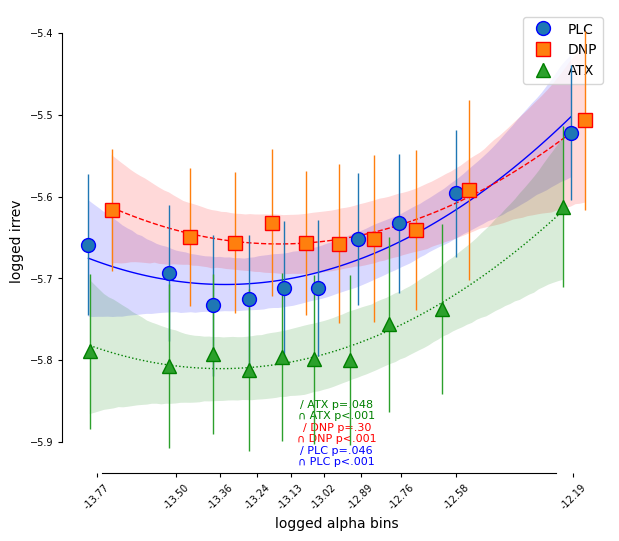

In [26]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df

def remove_top_percentile(dataframe, column, percentile=0.995):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe.loc[modified_dataframe[column] > threshold, column] = np.nan
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(df, 'poststim_mean_alpha', 0.995)

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior['irrev'] = np.log(behavior['poststim_mean_alpha'])
cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['log_poststim'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['log_poststim']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'log_poststim'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'log_poststim'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'log_poststim'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'log_poststim'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'log_poststim'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['log_poststim'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'log_poststim'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['log_poststim'] < 0.05 or betas_second_irreversibility_plc['log_poststim'] < 0.05:
    if betas_first_irreversibility_plc['log_poststim'] < betas_second_irreversibility_plc['log_poststim']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['log_poststim'] < betas_first_irreversibility_plc['log_poststim']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['log_poststim'] < 0.05 or betas_second_irreversibility_dnp['log_poststim'] < 0.05:
    if betas_first_irreversibility_dnp['log_poststim'] < betas_second_irreversibility_dnp['log_poststim']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['log_poststim'] < betas_first_irreversibility_dnp['log_poststim']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['log_poststim'] < 0.05 or betas_second_irreversibility_atx['log_poststim'] < 0.05:
    if betas_first_irreversibility_atx['log_poststim'] < betas_second_irreversibility_atx['log_poststim']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['log_poststim'] < betas_first_irreversibility_atx['log_poststim']:
        plot_quadratic_atx = True

# Plotting results for log_poststim'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['log_poststim']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['log_poststim']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['log_poststim']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['log_poststim']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['log_poststim']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['log_poststim']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="log_poststim", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['log_poststim']),
                                               p_val_string(betas_second_irreversibility_plc['log_poststim'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['log_poststim']),
                                               p_val_string(betas_second_irreversibility_dnp['log_poststim'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['log_poststim']),
                                               p_val_string(betas_second_irreversibility_atx['log_poststim'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('logged irrev')
ax.set_xlabel('logged alpha bins')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



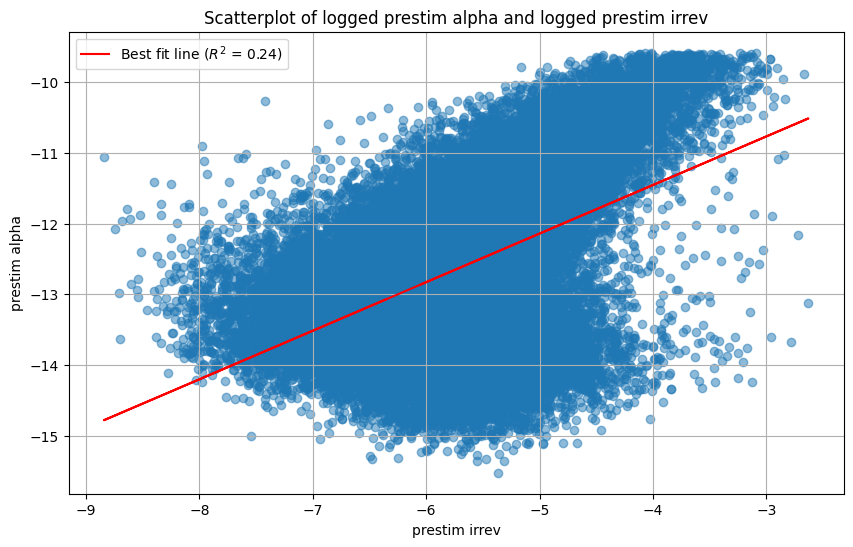

In [45]:
from scipy.stats import linregress
behavior = df 

def remove_top_percentile(dataframe, column, percentile=0.995):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[(modified_dataframe[column] < threshold)]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(df, 'prestim_mean_alpha', 0.995)
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
plt.figure(figsize=(10, 6))

x = behavior['log_prestim']
y = np.log(behavior['prestim_mean_alpha'])


plt.scatter(x, y, alpha = 0.5)

# Perform linear regression
slope, intercept, r_value, p_value, std_err = linregress(x, y)

# Calculate line of best fit
line = slope * x + intercept

# Plot line of best fit
plt.plot(x, line, color='red', label=f'Best fit line ($R^2$ = {r_value**2:.2f})')

# Display the plot
plt.xlabel('prestim irrev')
plt.ylabel('prestim alpha')
plt.title('Scatterplot of logged prestim alpha and logged prestim irrev')
plt.legend()
plt.grid(True)
plt.show()
# we can do a 

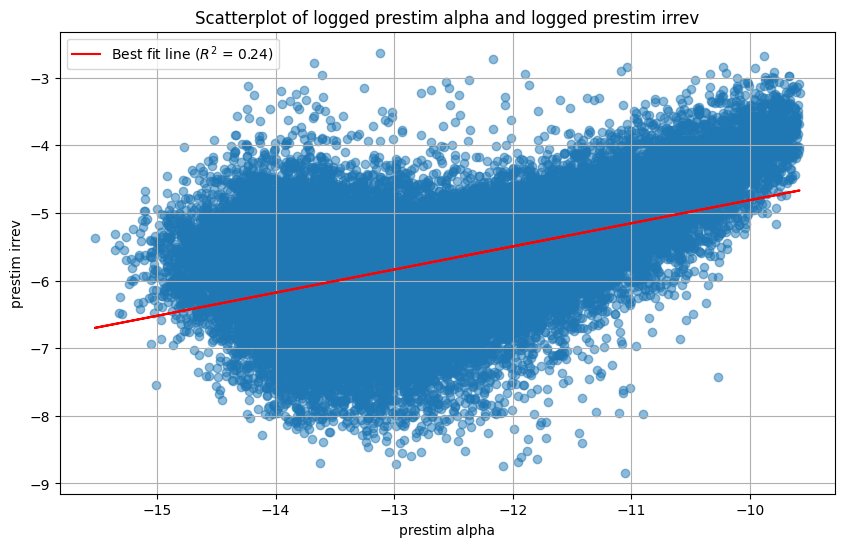

In [46]:
from scipy.stats import linregress
behavior = df 

def remove_top_percentile(dataframe, column, percentile=0.995):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[(modified_dataframe[column] < threshold)]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(df, 'prestim_mean_alpha', 0.995)
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
plt.figure(figsize=(10, 6))

x = np.log(behavior['prestim_mean_alpha'])
y = behavior['log_prestim']



plt.scatter(x, y, alpha = 0.5)

# Perform linear regression
slope, intercept, r_value, p_value, std_err = linregress(x, y)

# Calculate line of best fit
line = slope * x + intercept

# Plot line of best fit
plt.plot(x, line, color='red', label=f'Best fit line ($R^2$ = {r_value**2:.2f})')

# Display the plot
plt.ylabel('prestim irrev')
plt.xlabel('prestim alpha')
plt.title('Scatterplot of logged prestim alpha and logged prestim irrev')
plt.legend()
plt.grid(True)
plt.show()
# we can do a 

Poststim

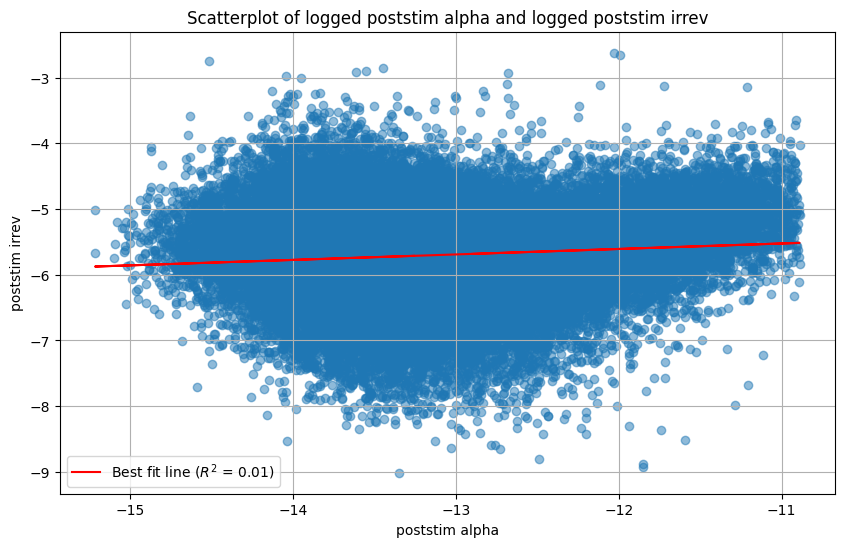

In [50]:
from scipy.stats import linregress
behavior = df 

def remove_top_percentile(dataframe, column, percentile=0.995):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[(modified_dataframe[column] < threshold)]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.995)
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
plt.figure(figsize=(10, 6))

x = np.log(behavior['poststim_mean_alpha'])
y = behavior['log_poststim']



plt.scatter(x, y, alpha = 0.5)

# Perform linear regression
slope, intercept, r_value, p_value, std_err = linregress(x, y)

# Calculate line of best fit
line = slope * x + intercept

# Plot line of best fit
plt.plot(x, line, color='red', label=f'Best fit line ($R^2$ = {r_value**2:.2f})')

# Display the plot
plt.ylabel('poststim irrev')
plt.xlabel('poststim alpha')
plt.title('Scatterplot of logged poststim alpha and logged poststim irrev')
plt.legend()
plt.grid(True)
plt.show()
# we can do a 

## alpha / d'

C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1586727503.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1586727503.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0   -13.506526
1   -12.989044
2   -12.638121
3   -12.284576
4   -11.712699
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1586727503.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1586727503.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0   -13.367142
1   -12.867938
2   -12.554538
3   -12.216117
4   -11.671026
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1586727503.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1586727503.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0   -13.533184
1   -13.057922
2   -12.739283
3   -12.407771
4   -11.851689
Name: irrev, dtype: float64


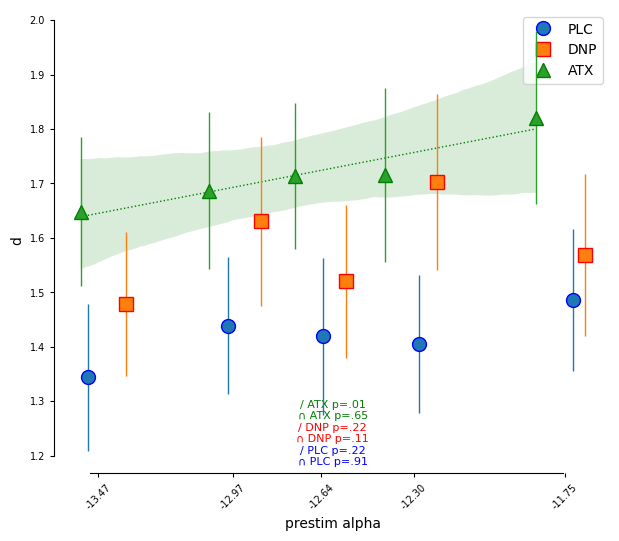

In [51]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.995)

behavior = behavior[(behavior['poststim_irrev'] < 0.08) & (behavior['prestim_irrev'] < 0.08)]
behavior['irrev'] = np.log(behavior['prestim_mean_alpha'])
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    #df_sdt_irreversibility['prestim_mean_alpha'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['prestim_mean_alpha']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('d')
ax.set_xlabel('prestim alpha')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2450286831.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2450286831.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0   -13.663078
1   -13.322680
2   -13.091997
3   -12.836206
4   -12.387947
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2450286831.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2450286831.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0   -13.588660
1   -13.248846
2   -13.021862
3   -12.782217
4   -12.344026
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2450286831.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2450286831.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0   -13.659691
1   -13.323636
2   -13.101946
3   -12.865152
4   -12.424485
Name: irrev, dtype: float64


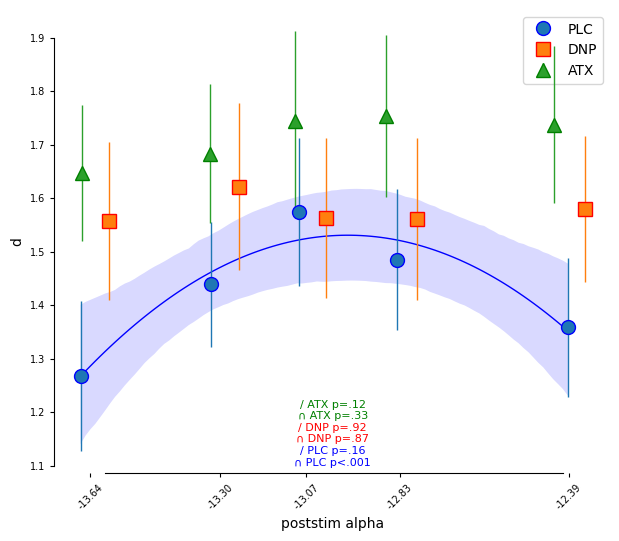

In [52]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.995)

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior['irrev'] = np.log(behavior['poststim_mean_alpha'])
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    #df_sdt_irreversibility['prestim_mean_alpha'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['prestim_mean_alpha']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('d')
ax.set_xlabel('poststim alpha')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



### ROI

44790
['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']
[63, 62, 61, 26, 25, 24]


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1490220038.py:74: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1490220038.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0   -13.792818
1   -13.381687
2   -13.152378
3   -12.982316
4   -12.820282
5   -12.670012
6   -12.497055
7   -12.329603
8   -12.111921
9   -11.694295
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1490220038.py:74: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1490220038.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0   -13.706558
1   -13.289064
2   -13.066262
3   -12.895006
4   -12.748739
5   -12.594401
6   -12.437853
7   -12.270290
8   -12.064606
9   -11.653004
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1490220038.py:74: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\1490220038.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0   -13.807253
1   -13.376190
2   -13.155925
3   -12.979665
4   -12.823042
5   -12.678306
6   -12.519150
7   -12.355892
8   -12.149031
9   -11.737715
Name: irrev, dtype: float64


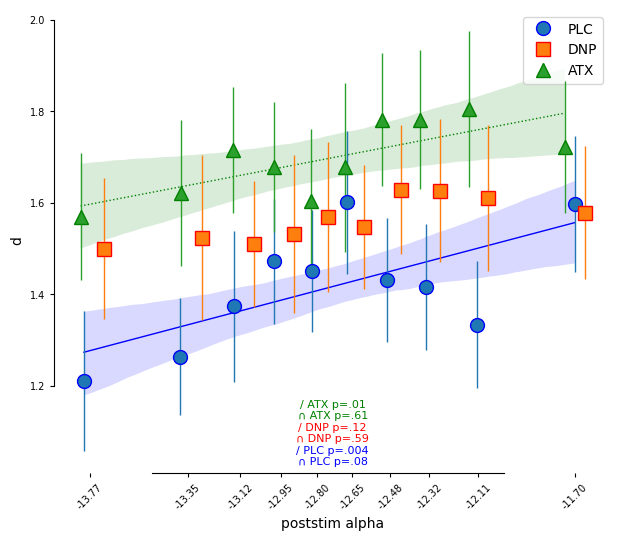

In [71]:
# ALL DRUGS





import pandas as pd
import numpy as np
from scipy.stats import rankdata
from statsmodels.formula.api import ols
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore

behavior = df
print(len(behavior))

behavior['poststim_channel_alpha'] = [poststim_channel_alpha[i] for i in range(poststim_channel_alpha.shape[0])]

alpha_ROI = ['O2', 'PO4', 'PO8', 'O1', 'PO3', 'PO7'] #right hemisphere processing for left cue

montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

alpha_ROI_indices = [channels.index(elec) for elec in alpha_ROI if elec in channels]
print(alpha_ROI_indices)

alpha_power_bytrial = []

for matrix in behavior['poststim_channel_alpha']:
    alpha = np.mean(matrix[alpha_ROI_indices])
    alpha_power_bytrial.append(alpha)
behavior['ROI_alpha'] = alpha_power_bytrial # RIGHT HEMISPHERE



def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp




def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)

behavior = behavior[(behavior['poststim_irrev'] < 0.08) & (behavior['poststim_irrev'] < 0.08)]
behavior['irrev'] = np.log(behavior['ROI_alpha'])
cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    #df_sdt_irreversibility['poststim_mean_alpha'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['poststim_mean_alpha']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('d')
ax.set_xlabel('poststim alpha')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()




## pupil / alpha

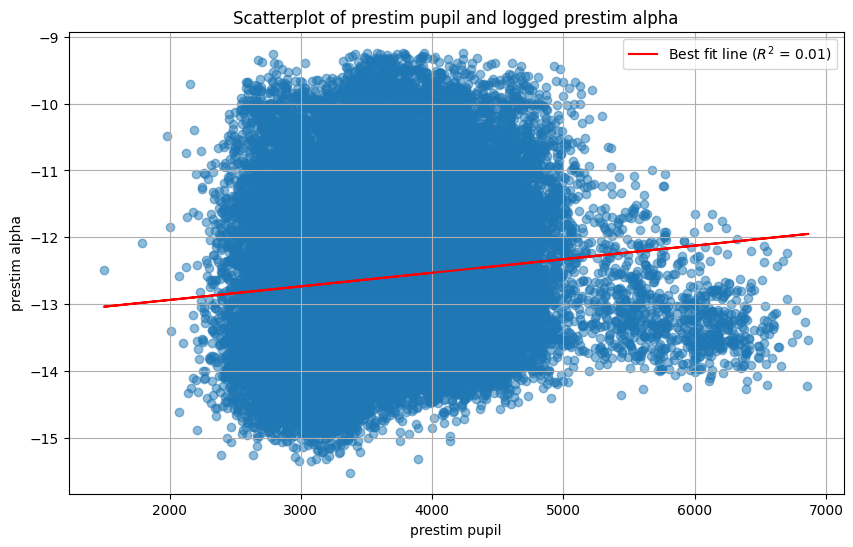

In [54]:
from scipy.stats import linregress
behavior = df 

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
plt.figure(figsize=(10, 6))

x = behavior['bl_pupil']
y = np.log(behavior['prestim_mean_alpha'])

plt.scatter(x, y, alpha = 0.5)

# Perform linear regression
slope, intercept, r_value, p_value, std_err = linregress(x, y)

# Calculate line of best fit
line = slope * x + intercept

# Plot line of best fit
plt.plot(x, line, color='red', label=f'Best fit line ($R^2$ = {r_value**2:.2f})')

# Display the plot
plt.xlabel('prestim pupil')
plt.ylabel('prestim alpha')
plt.title('Scatterplot of prestim pupil and logged prestim alpha')
plt.legend()
plt.grid(True)
plt.show()
# we can do a 

C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\4248156494.py:41: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\4248156494.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0    3246.464206
1    3421.145938
2    3520.987275
3    3621.159480
4    3807.202063
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\4248156494.py:41: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\4248156494.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0    3220.378481
1    3392.442477
2    3489.803407
3    3587.066511
4    3758.517895
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\4248156494.py:45: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_sdt_irreversibility['prestim_mean_alpha'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['prestim_mean_alpha']
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\4248156494.py:50: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']


Drug: ATX
Bin means: irreversibility_bin
0    3449.330145
1    3641.260470
2    3751.254698
3    3863.720946
4    4064.413581
Name: irrev, dtype: float64


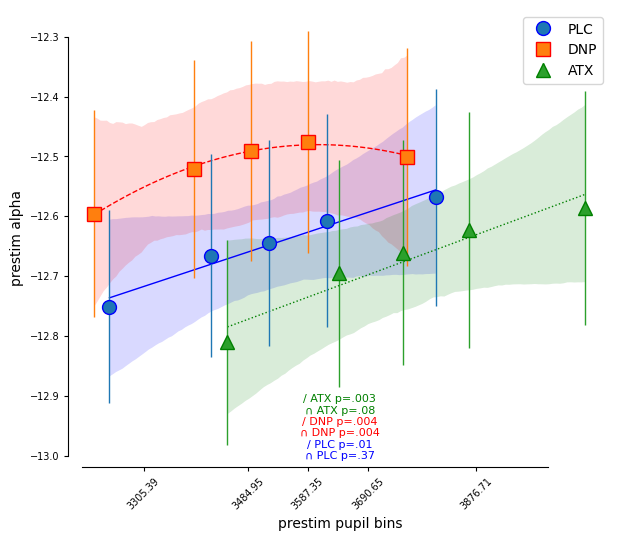

In [20]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(df, 'prestim_mean_alpha', 0.999)
behavior['prestim_mean_alpha'] = np.log(behavior['prestim_mean_alpha'])

behavior = behavior[(behavior['poststim_irrev'] < 0.05) & (behavior['prestim_irrev'] < 0.05)]

#behavior['prestim_mean_alpha'] = np.log(behavior['prestim_mean_alpha'])
behavior['irrev'] = behavior['bl_pupil']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['prestim_mean_alpha'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['prestim_mean_alpha']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_mean_alpha'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_mean_alpha'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_mean_alpha'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_mean_alpha'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_mean_alpha'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['prestim_mean_alpha'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_mean_alpha'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['prestim_mean_alpha'] < 0.05 or betas_second_irreversibility_plc['prestim_mean_alpha'] < 0.05:
    if betas_first_irreversibility_plc['prestim_mean_alpha'] < betas_second_irreversibility_plc['prestim_mean_alpha']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['prestim_mean_alpha'] < betas_first_irreversibility_plc['prestim_mean_alpha']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['prestim_mean_alpha'] < 0.05 or betas_second_irreversibility_dnp['prestim_mean_alpha'] < 0.05:
    if betas_first_irreversibility_dnp['prestim_mean_alpha'] < betas_second_irreversibility_dnp['prestim_mean_alpha']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['prestim_mean_alpha'] < betas_first_irreversibility_dnp['prestim_mean_alpha']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['prestim_mean_alpha'] < 0.05 or betas_second_irreversibility_atx['prestim_mean_alpha'] < 0.05:
    if betas_first_irreversibility_atx['prestim_mean_alpha'] < betas_second_irreversibility_atx['prestim_mean_alpha']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['prestim_mean_alpha'] < betas_first_irreversibility_atx['prestim_mean_alpha']:
        plot_quadratic_atx = True

# Plotting results for prestim_mean_alpha'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['prestim_mean_alpha']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['prestim_mean_alpha']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['prestim_mean_alpha']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['prestim_mean_alpha']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['prestim_mean_alpha']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['prestim_mean_alpha']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="prestim_mean_alpha", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['prestim_mean_alpha']),
                                               p_val_string(betas_second_irreversibility_plc['prestim_mean_alpha'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['prestim_mean_alpha']),
                                               p_val_string(betas_second_irreversibility_dnp['prestim_mean_alpha'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['prestim_mean_alpha']),
                                               p_val_string(betas_second_irreversibility_atx['prestim_mean_alpha'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('prestim alpha')
ax.set_xlabel('prestim pupil bins')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



## alpha by drug

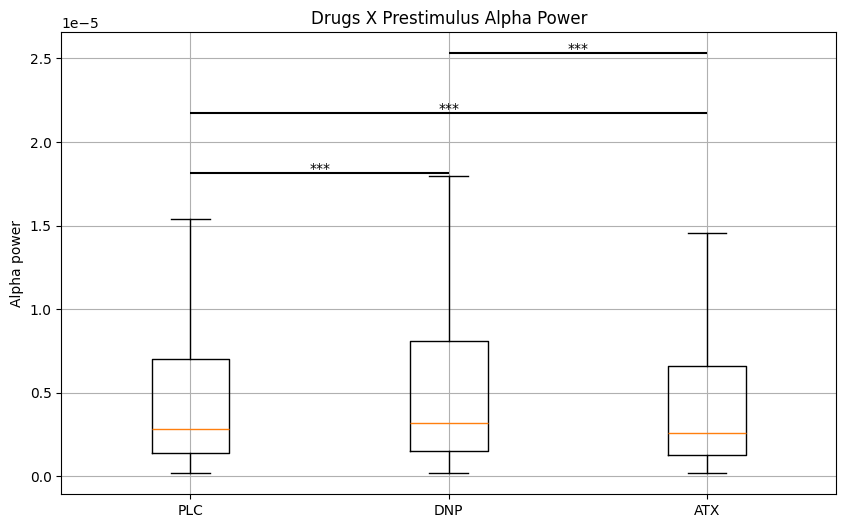

The std dev of PLC 1.0132155505328602e-05
The std dev of DNP 1.0288068763846944e-05
The std dev of ATX 1.1320303854924317e-05
The mean of PLC 6.581914349720718e-06
The mean of DNP 7.158342305296574e-06
The mean of ATX 6.6258057269387335e-06


In [21]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)

behavior = behavior[(behavior['poststim_irrev'] < 0.08) & (behavior['prestim_irrev'] < 0.08)]
irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(behavior[behavior['drug'] == drug]['prestim_mean_alpha'])

# Creating the boxplot with improved clarity
plt.figure(figsize=(10, 6))
box = plt.boxplot(irrev_sub_plc, positions=np.arange(len(drugs)), showfliers=False)
plt.xticks(np.arange(len(drugs)), drugs)
plt.ylabel('Alpha power')
plt.title('Drugs X Prestimulus Alpha Power')
plt.grid(True)


# Mann-Whitney U tests across drugs with corrections

p_values = []
comparisons = []

for i in range(len(irrev_sub_plc)):
    for j in range(i + 1, len(irrev_sub_plc)):
        stat, p = stats.mannwhitneyu(irrev_sub_plc[i], irrev_sub_plc[j], alternative='two-sided')
        p_values.append(p)
        comparisons.append((drugs[i], drugs[j]))

corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]

# Annotating significant differences
max_y = max([item.get_data()[1].max() for item in box['caps']])  # Find the maximum y-value of the whiskers
y_offset = max_y * 0.1  # Slightly above the highest whisker
for i, (comp, corrected_p_val) in enumerate(zip(comparisons, corrected_p_values)):
    x1, x2 = drugs.index(comp[0]), drugs.index(comp[1])
    # Decide number of asterisks based on significance level
    if corrected_p_val < 0.001:
        num_asterisks = '***'
    elif corrected_p_val < 0.01:
        num_asterisks = '**'
    elif corrected_p_val < 0.05:
        num_asterisks = '*'
    else:
        num_asterisks = ''

    if num_asterisks:  # Only draw if there's a significant result
        plt.hlines((max_y+max_y*0.01) + y_offset * i * 2, x1, x2, color="black")
        plt.text((x1 + x2) / 2, max_y + y_offset * (i * 2), num_asterisks, ha='center', va='bottom', color='black')

plt.show()

print("The std dev of PLC "+str(np.std(irrev_sub_plc[0])))
print("The std dev of DNP "+str(np.std(irrev_sub_plc[1])))
print("The std dev of ATX "+str(np.std(irrev_sub_plc[2])))

print("The mean of PLC "+str(np.mean(irrev_sub_plc[0])))
print("The mean of DNP "+str(np.mean(irrev_sub_plc[1])))
print("The mean of ATX "+str(np.mean(irrev_sub_plc[2])))

## alpha correctness

14505


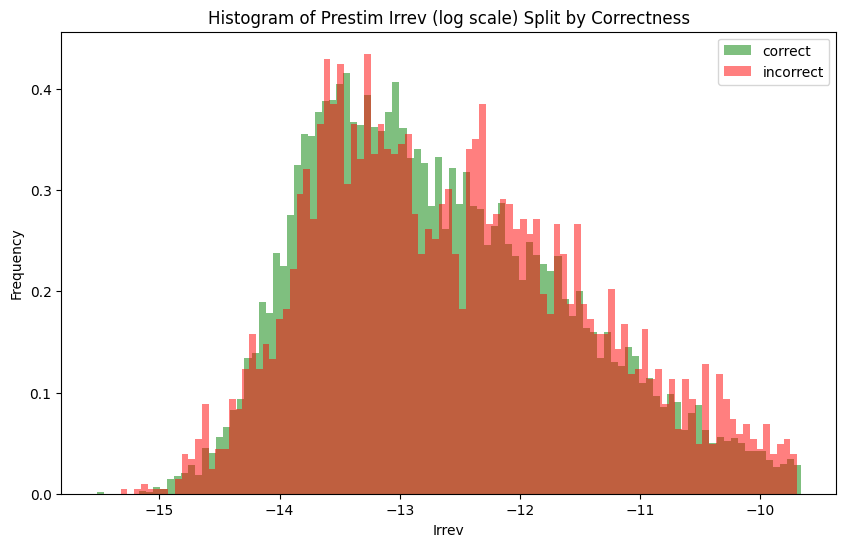

18464366.0
1.284636316333825e-07
Mean corr: 5.955929514730634e-06
Mean incorr: 6.878148026909863e-06
The std dev of the correct values in the pretty histogram (logged irrev values): 1.0707707434580707
The std dev of the incorrect values in the pretty histogram (logged irrev values): 1.121255764368241
The std dev of the correct values of raw: 8.63451851577092e-06
The std dev of the incorrect values of raw: 9.655487837663249e-06


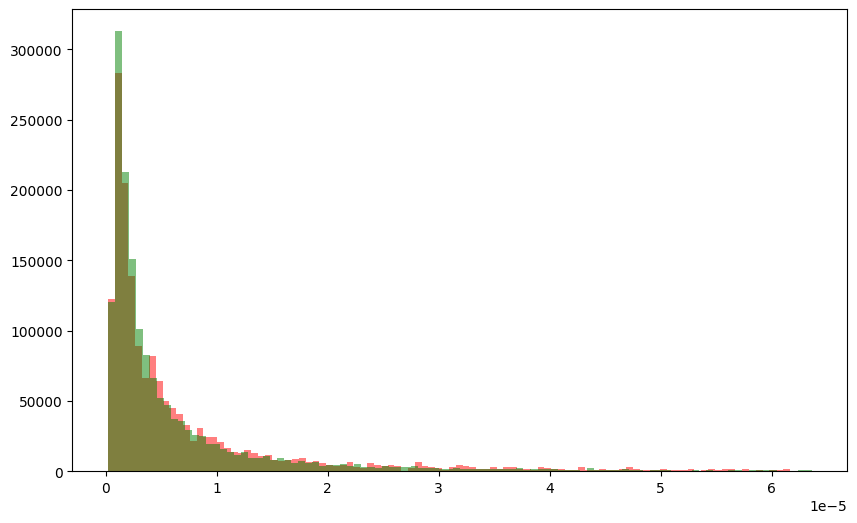

F test-- F-statistic: 1.250700051857226, p-value: 0.9999999999999999
F test-- F-statistic: 0.7995522175881026, p-value: 0.9999999999999999
Levene's test statistic in raw: 25.637026466307052, p-value: 4.1710863746719054e-07
Brown-Forsythe test statistic in raw: 25.637026466307052, p-value: 4.1710863746719054e-07
Levene's test statistic in logged: 19.130949717470195, p-value: 1.2290084823009987e-05
Brown-Forsythe test statistic in logged: 19.130949717470195, p-value: 1.2290084823009987e-05


In [22]:

behavior = df
behavior = behavior[behavior['drug']=='PLC']

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.995)
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.995)

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

print(len(behavior))

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['correct']==1]['prestim_mean_alpha']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='correct', color='green', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['correct']==0]['prestim_mean_alpha']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='incorrect', color='red', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestim Irrev (log scale) Split by Correctness')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean corr: "+str(np.mean(correct_irrev)))
print("Mean incorr: "+str(np.mean(incorrect_irrev)))
print("The std dev of the correct values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the incorrect values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the correct values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the incorrect values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = behavior[behavior['correct']==0]['prestim_mean_alpha']
group2 = behavior[behavior['correct']==1]['prestim_mean_alpha']

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='incorrect', color='red', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='correct', color='green', density = True)

plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")





# Complexity

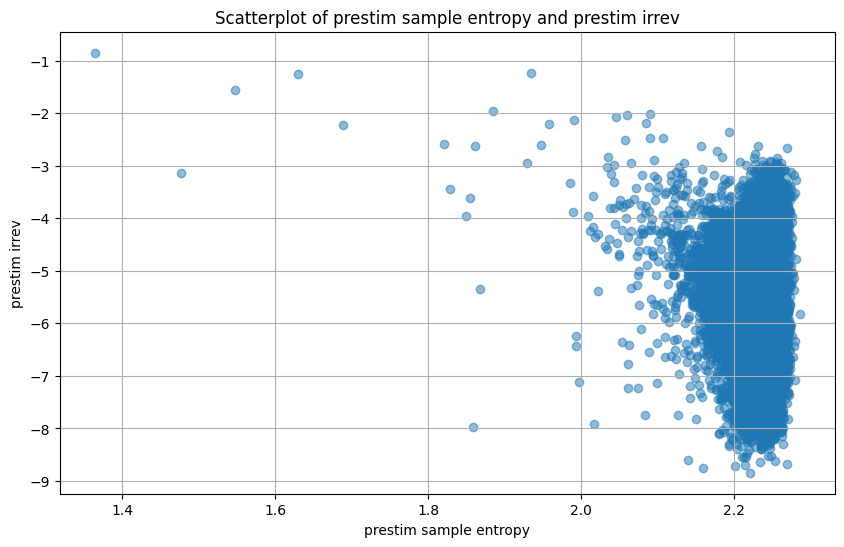

In [86]:
behavior = df 
#behavior = behavior[(behavior['poststim_irrev'] < 0.05) & (behavior['prestim_irrev'] < 0.05)]
plt.figure(figsize=(10, 6))
plt.scatter(behavior['prestim_sampen_mean'], behavior['log_prestim'], alpha=0.5)

plt.xlabel('prestim sample entropy')
plt.ylabel('prestim irrev')
plt.title('Scatterplot of prestim sample entropy and prestim irrev')
plt.grid(True)
plt.show()

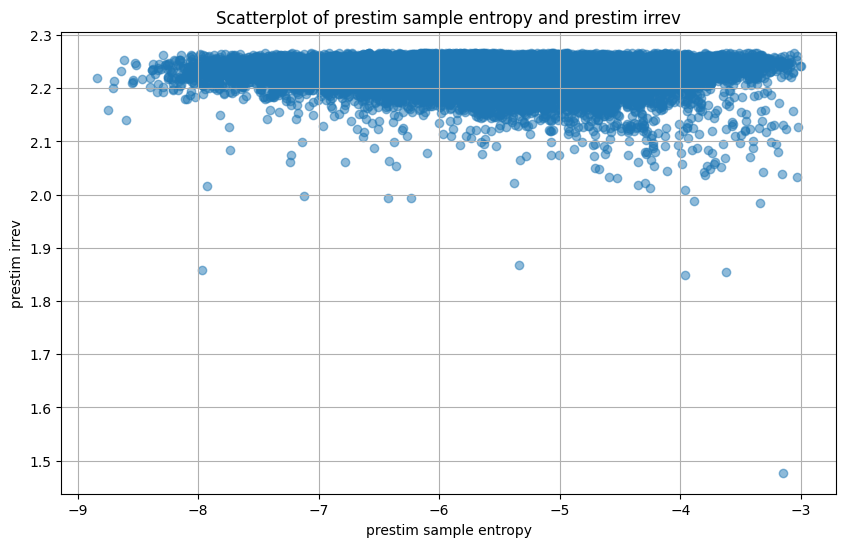

In [139]:
behavior = df 

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

behavior = remove_top_percentile(behavior, 'prestim_sampen_mean', 0.995)

behavior = behavior[(behavior['poststim_irrev'] < 0.05) & (behavior['prestim_irrev'] < 0.05)]
plt.figure(figsize=(10, 6))
plt.scatter(behavior['log_prestim'], behavior['prestim_sampen_mean'], alpha=0.5)

plt.xlabel('prestim sample entropy')
plt.ylabel('prestim irrev')
plt.title('Scatterplot of prestim sample entropy and prestim irrev')
plt.grid(True)
plt.show()

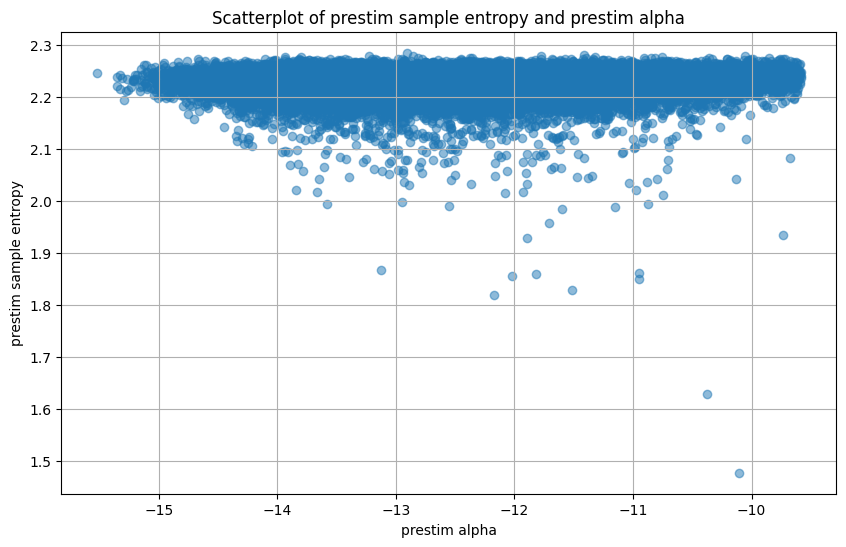

In [23]:
behavior = df 
def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.995)
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.995)
plt.figure(figsize=(10, 6))
plt.scatter(np.log(behavior['prestim_mean_alpha']), behavior['prestim_sampen_mean'], alpha=0.5)

plt.xlabel('prestim alpha')
plt.ylabel('prestim sample entropy')
plt.title('Scatterplot of prestim sample entropy and prestim alpha')
plt.grid(True)
plt.show()

In [87]:
behavior = df

print(behavior['prestim_sampen_mean'])

0        2.250741
1        2.234575
2        2.247247
3        2.233114
4        2.226729
           ...   
44785    2.225576
44786    2.246509
44787    2.215758
44788    2.225484
44789    2.215337
Name: prestim_sampen_mean, Length: 44790, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\3975111566.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irrev'] = df['log_prestim']
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\3975111566.py:24: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], lab

Drug: PLC
Bin means: irreversibility_bin
0   -6.580321
1   -6.230526
2   -6.048561
3   -5.891776
4   -5.755876
5   -5.616907
6   -5.472266
7   -5.318438
8   -5.112738
9   -4.712953
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\3975111566.py:28: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_sdt_irreversibility['prestim_sampen_mean'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['prestim_sampen_mean']
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\3975111566.py:33: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']


Drug: DNP
Bin means: irreversibility_bin
0   -6.528586
1   -6.167399
2   -5.984766
3   -5.839351
4   -5.714516
5   -5.585143
6   -5.448148
7   -5.288045
8   -5.097485
9   -4.699389
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\3975111566.py:24: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\3975111566.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0   -6.684073
1   -6.325489
2   -6.154591
3   -6.009957
4   -5.879772
5   -5.746808
6   -5.608719
7   -5.461401
8   -5.261264
9   -4.850586
Name: irrev, dtype: float64


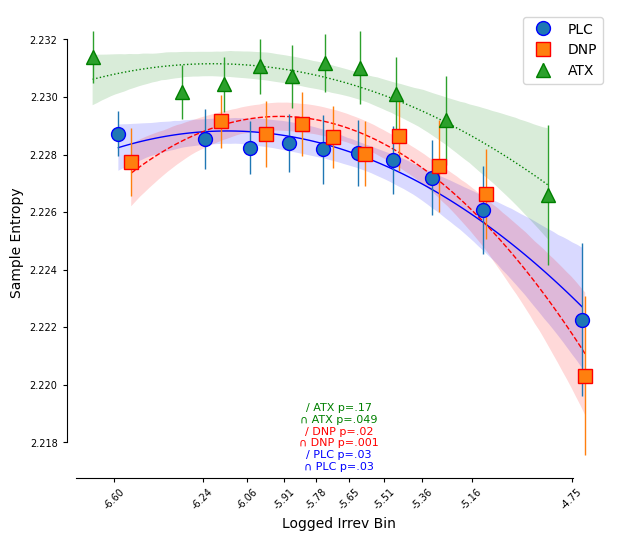

In [88]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
behavior['irrev'] = df['log_prestim']
cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['prestim_sampen_mean'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['prestim_sampen_mean']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['prestim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_sampen_mean'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['prestim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_sampen_mean'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['prestim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_sampen_mean'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['prestim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_sampen_mean'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['prestim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_sampen_mean'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['prestim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_sampen_mean'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['prestim_sampen_mean'] < 0.05 or betas_second_irreversibility_plc['prestim_sampen_mean'] < 0.05:
    if betas_first_irreversibility_plc['prestim_sampen_mean'] < betas_second_irreversibility_plc['prestim_sampen_mean']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['prestim_sampen_mean'] < betas_first_irreversibility_plc['prestim_sampen_mean']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['prestim_sampen_mean'] < 0.05 or betas_second_irreversibility_dnp['prestim_sampen_mean'] < 0.05:
    if betas_first_irreversibility_dnp['prestim_sampen_mean'] < betas_second_irreversibility_dnp['prestim_sampen_mean']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['prestim_sampen_mean'] < betas_first_irreversibility_dnp['prestim_sampen_mean']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['prestim_sampen_mean'] < 0.05 or betas_second_irreversibility_atx['prestim_sampen_mean'] < 0.05:
    if betas_first_irreversibility_atx['prestim_sampen_mean'] < betas_second_irreversibility_atx['prestim_sampen_mean']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['prestim_sampen_mean'] < betas_first_irreversibility_atx['prestim_sampen_mean']:
        plot_quadratic_atx = True

# Plotting results for prestim_sampen_mean'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['prestim_sampen_mean']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['prestim_sampen_mean']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['prestim_sampen_mean']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['prestim_sampen_mean']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['prestim_sampen_mean']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['prestim_sampen_mean']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="prestim_sampen_mean", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['prestim_sampen_mean']),
                                               p_val_string(betas_second_irreversibility_plc['prestim_sampen_mean'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['prestim_sampen_mean']),
                                               p_val_string(betas_second_irreversibility_dnp['prestim_sampen_mean'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['prestim_sampen_mean']),
                                               p_val_string(betas_second_irreversibility_atx['prestim_sampen_mean'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Sample Entropy')
ax.set_xlabel('Logged Irrev Bin')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\1361412222.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irrev'] = df['log_poststim']
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\1361412222.py:24: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], la

Drug: PLC
Bin means: irreversibility_bin
0   -6.488440
1   -6.162694
2   -5.994873
3   -5.853250
4   -5.732629
5   -5.616592
6   -5.491428
7   -5.358987
8   -5.171283
9   -4.804368
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\1361412222.py:24: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\1361412222.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0   -6.451629
1   -6.116147
2   -5.947417
3   -5.817647
4   -5.697193
5   -5.579614
6   -5.459616
7   -5.313389
8   -5.143363
9   -4.791278
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\1361412222.py:24: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\1361412222.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0   -6.580998
1   -6.261166
2   -6.097196
3   -5.964472
4   -5.846215
5   -5.731960
6   -5.610665
7   -5.474030
8   -5.295380
9   -4.929785
Name: irrev, dtype: float64


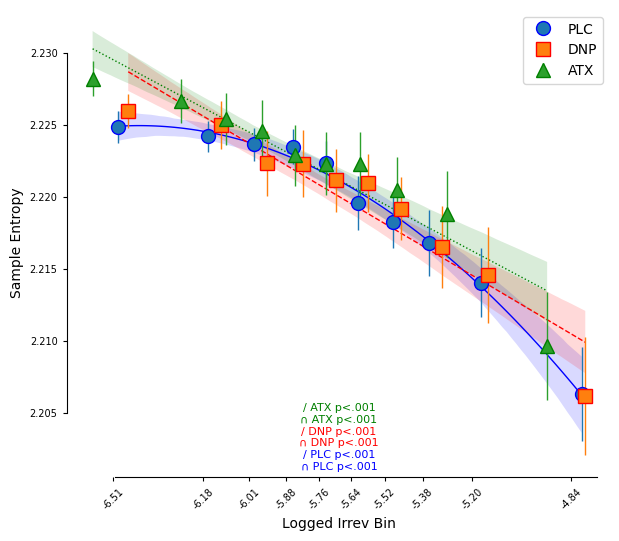

In [89]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
behavior['irrev'] = df['log_poststim']
cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['poststim_sampen_mean'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['poststim_sampen_mean']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['poststim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'poststim_sampen_mean'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['poststim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'poststim_sampen_mean'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['poststim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'poststim_sampen_mean'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['poststim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'poststim_sampen_mean'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['poststim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'poststim_sampen_mean'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['poststim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'poststim_sampen_mean'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['poststim_sampen_mean'] < 0.05 or betas_second_irreversibility_plc['poststim_sampen_mean'] < 0.05:
    if betas_first_irreversibility_plc['poststim_sampen_mean'] < betas_second_irreversibility_plc['poststim_sampen_mean']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['poststim_sampen_mean'] < betas_first_irreversibility_plc['poststim_sampen_mean']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['poststim_sampen_mean'] < 0.05 or betas_second_irreversibility_dnp['poststim_sampen_mean'] < 0.05:
    if betas_first_irreversibility_dnp['poststim_sampen_mean'] < betas_second_irreversibility_dnp['poststim_sampen_mean']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['poststim_sampen_mean'] < betas_first_irreversibility_dnp['poststim_sampen_mean']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['poststim_sampen_mean'] < 0.05 or betas_second_irreversibility_atx['poststim_sampen_mean'] < 0.05:
    if betas_first_irreversibility_atx['poststim_sampen_mean'] < betas_second_irreversibility_atx['poststim_sampen_mean']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['poststim_sampen_mean'] < betas_first_irreversibility_atx['poststim_sampen_mean']:
        plot_quadratic_atx = True

# Plotting results for poststim_sampen_mean'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['poststim_sampen_mean']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['poststim_sampen_mean']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['poststim_sampen_mean']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['poststim_sampen_mean']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['poststim_sampen_mean']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['poststim_sampen_mean']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="poststim_sampen_mean", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['poststim_sampen_mean']),
                                               p_val_string(betas_second_irreversibility_plc['poststim_sampen_mean'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['poststim_sampen_mean']),
                                               p_val_string(betas_second_irreversibility_dnp['poststim_sampen_mean'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['poststim_sampen_mean']),
                                               p_val_string(betas_second_irreversibility_atx['poststim_sampen_mean'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Sample Entropy')
ax.set_xlabel('Logged Irrev Bin')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2493976823.py:36: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2493976823.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0    7.697499e-07
1    9.720470e-07
2    1.097825e-06
3    1.230179e-06
4    1.364499e-06
5    1.519119e-06
6    1.704873e-06
7    1.952551e-06
8    2.335585e-06
9    3.502018e-06
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2493976823.py:36: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2493976823.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0    8.751581e-07
1    1.107384e-06
2    1.261708e-06
3    1.411269e-06
4    1.568883e-06
5    1.732546e-06
6    1.938976e-06
7    2.208308e-06
8    2.626239e-06
9    3.892629e-06
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2493976823.py:36: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2493976823.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0    7.604303e-07
1    9.474416e-07
2    1.074903e-06
3    1.189109e-06
4    1.310144e-06
5    1.446508e-06
6    1.615160e-06
7    1.823936e-06
8    2.178603e-06
9    3.278689e-06
Name: irrev, dtype: float64


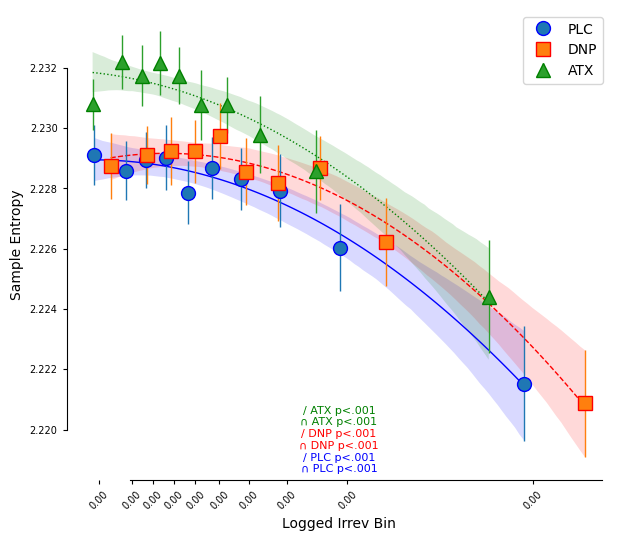

In [90]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp

behavior = df 
def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.995)
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.995)
# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
behavior['irrev'] = np.log(behavior['prestim_mean_alpha'])
cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['prestim_sampen_mean'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['prestim_sampen_mean']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['prestim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_sampen_mean'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['prestim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_sampen_mean'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['prestim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_sampen_mean'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['prestim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_sampen_mean'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['prestim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_sampen_mean'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['prestim_sampen_mean'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_sampen_mean'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['prestim_sampen_mean'] < 0.05 or betas_second_irreversibility_plc['prestim_sampen_mean'] < 0.05:
    if betas_first_irreversibility_plc['prestim_sampen_mean'] < betas_second_irreversibility_plc['prestim_sampen_mean']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['prestim_sampen_mean'] < betas_first_irreversibility_plc['prestim_sampen_mean']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['prestim_sampen_mean'] < 0.05 or betas_second_irreversibility_dnp['prestim_sampen_mean'] < 0.05:
    if betas_first_irreversibility_dnp['prestim_sampen_mean'] < betas_second_irreversibility_dnp['prestim_sampen_mean']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['prestim_sampen_mean'] < betas_first_irreversibility_dnp['prestim_sampen_mean']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['prestim_sampen_mean'] < 0.05 or betas_second_irreversibility_atx['prestim_sampen_mean'] < 0.05:
    if betas_first_irreversibility_atx['prestim_sampen_mean'] < betas_second_irreversibility_atx['prestim_sampen_mean']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['prestim_sampen_mean'] < betas_first_irreversibility_atx['prestim_sampen_mean']:
        plot_quadratic_atx = True

# Plotting results for prestim_sampen_mean'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['prestim_sampen_mean']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['prestim_sampen_mean']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['prestim_sampen_mean']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['prestim_sampen_mean']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['prestim_sampen_mean']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['prestim_sampen_mean']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="prestim_sampen_mean", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['prestim_sampen_mean']),
                                               p_val_string(betas_second_irreversibility_plc['prestim_sampen_mean'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['prestim_sampen_mean']),
                                               p_val_string(betas_second_irreversibility_dnp['prestim_sampen_mean'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['prestim_sampen_mean']),
                                               p_val_string(betas_second_irreversibility_atx['prestim_sampen_mean'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Sample Entropy')
ax.set_xlabel('Logged Irrev Bin')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



## sampen x d'

C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\1039505870.py:36: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\1039505870.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0    2.190930
1    2.211196
2    2.218234
3    2.223299
4    2.227603
5    2.231629
6    2.235628
7    2.239961
8    2.244958
9    2.254036
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\1039505870.py:36: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\1039505870.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0    2.190251
1    2.211043
2    2.218393
3    2.223784
4    2.227990
5    2.231864
6    2.235777
7    2.240072
8    2.245131
9    2.254417
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\1039505870.py:36: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\1039505870.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0    2.195363
1    2.214223
2    2.221256
3    2.226226
4    2.230432
5    2.234159
6    2.237858
7    2.241862
8    2.246705
9    2.255655
Name: irrev, dtype: float64


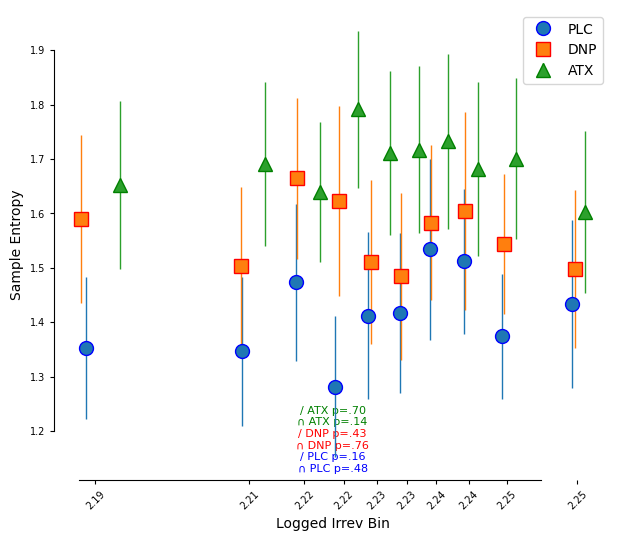

In [161]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp

behavior = df 
def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.995)
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.995)
# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
behavior['irrev'] = behavior['prestim_sampen_mean']
cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['prestim_sampen_mean'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['prestim_sampen_mean']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('d')
ax.set_xlabel('sample entropy')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



# 6/3 heirarchy

Statistic: 19570367.0, P-value: 0.11910962692940648
mean of correct: 0.004231356207098442
mean of incorrect: 0.0043125285776867365
median of correct: 0.0034863678328664813
median of incorrect: 0.0035489140845771103
The std dev of the correct values in the pretty histogram (logged irrev values): 0.6517057429697231
The std dev of the incorrect values in the pretty histogram (logged irrev values): 0.6588744827324369
The std dev of the correct values of raw: 0.0030023174890403
The std dev of the incorrect values of raw: 0.0029949761898398013


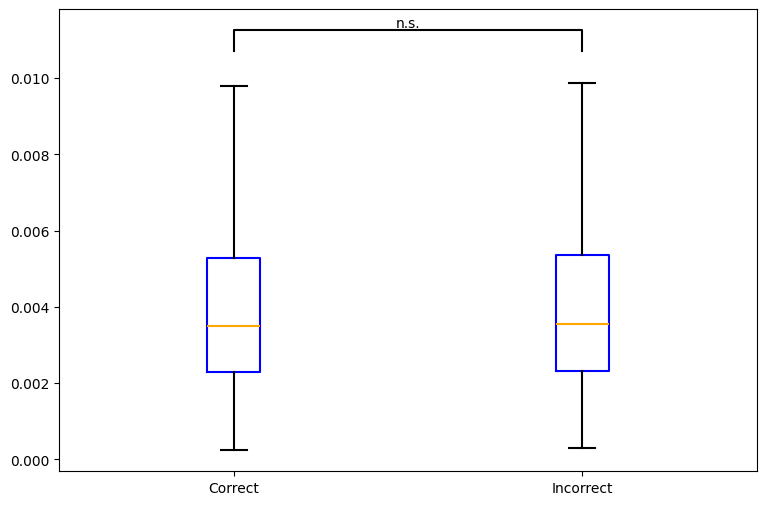

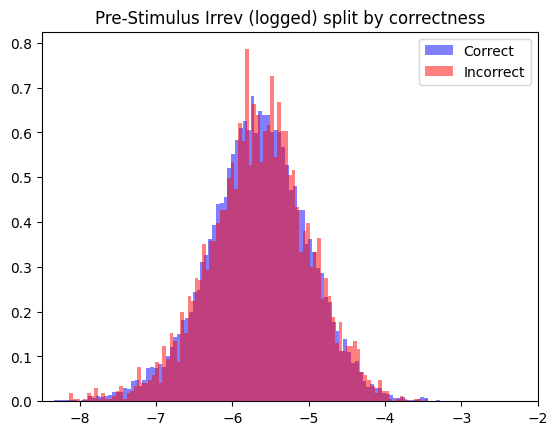

In [61]:
behavior = df

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


#behavior = behavior[behavior['drug'] == drug]
behavior = behavior[behavior['drug']=='PLC']
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]

correct_irrev = behavior[behavior['correct'] == 1]['poststim_irrev']
incorrect_irrev = behavior[behavior['correct'] == 0]['poststim_irrev']


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[correct_irrev, incorrect_irrev], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['Correct', 'Incorrect'])
#ax.set_title('ATX')


# Perform the Mann-Whitney U test
stat, p_value = mannwhitneyu(correct_irrev, incorrect_irrev, alternative = 'two-sided')
print(f'Statistic: {stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(correct_irrev, 75)
Q3_group2 = np.percentile(incorrect_irrev, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of correct: " + str(np.mean(correct_irrev)))
print("mean of incorrect: " + str(np.mean(incorrect_irrev)))
print("median of correct: " + str(np.median(correct_irrev)))
print("median of incorrect: " + str(np.median(incorrect_irrev)))
print("The std dev of the correct values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the incorrect values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the correct values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the incorrect values of raw: "+str(np.std(incorrect_irrev)))

plt.show()

plt.hist(np.log(correct_irrev), bins=100, color='blue', alpha=0.5, label='Correct', density = True)
plt.hist(np.log(incorrect_irrev), bins=100, color='red', alpha=0.5, label='Incorrect', density = True)
plt.xlim(-8.5,-2)
plt.legend()
plt.title('Pre-Stimulus Irrev (logged) split by correctness')
plt.show()

#Well shit.

## Heirarchy bins

### prestim

C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\3900322479.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irrev'] = behavior['prestim_heirarchy']


C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\3900322479.py:25: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\3900322479.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0    0.005135
1    0.007994
2    0.010842
3    0.014824
4    0.024620
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\3900322479.py:25: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\3900322479.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0    0.005813
1    0.008815
2    0.011357
3    0.014875
4    0.023901
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\3900322479.py:25: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\3900322479.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0    0.005048
1    0.007887
2    0.010521
3    0.013989
4    0.022459
Name: irrev, dtype: float64


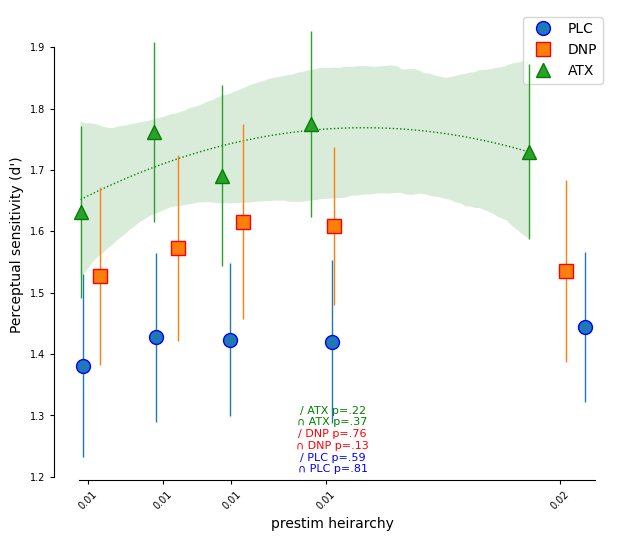

In [55]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp



# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
behavior['irrev'] = behavior['prestim_heirarchy']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = True

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('prestim heirarchy')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



### poststim

C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\920676715.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irrev'] = behavior['poststim_heirarchy']
C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\920676715.py:25: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_

Drug: PLC
Bin means: irreversibility_bin
0    0.005357
1    0.007726
2    0.009797
3    0.012453
4    0.019826
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\920676715.py:25: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\920676715.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: DNP
Bin means: irreversibility_bin
0    0.005703
1    0.008131
2    0.010183
3    0.012870
4    0.019458
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\920676715.py:25: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_16500\920676715.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  be

Drug: ATX
Bin means: irreversibility_bin
0    0.005132
1    0.007398
2    0.009315
3    0.011813
4    0.018186
Name: irrev, dtype: float64


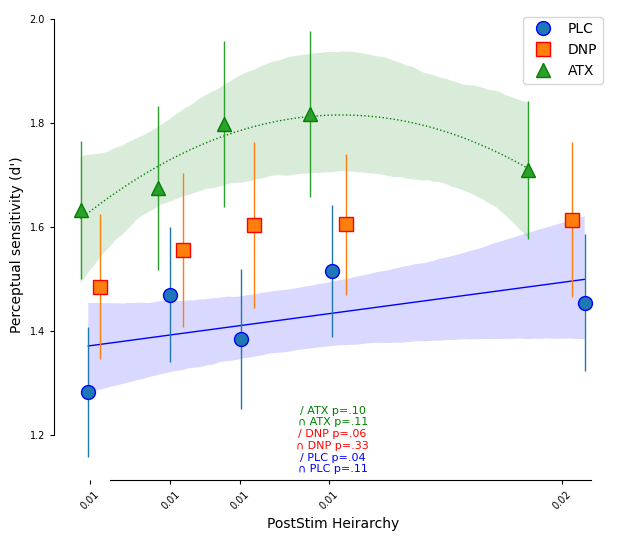

In [56]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp



# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]
behavior['irrev'] = behavior['poststim_heirarchy']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = True

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('PostStim Heirarchy')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



# 6/6 drug effects

## prestim

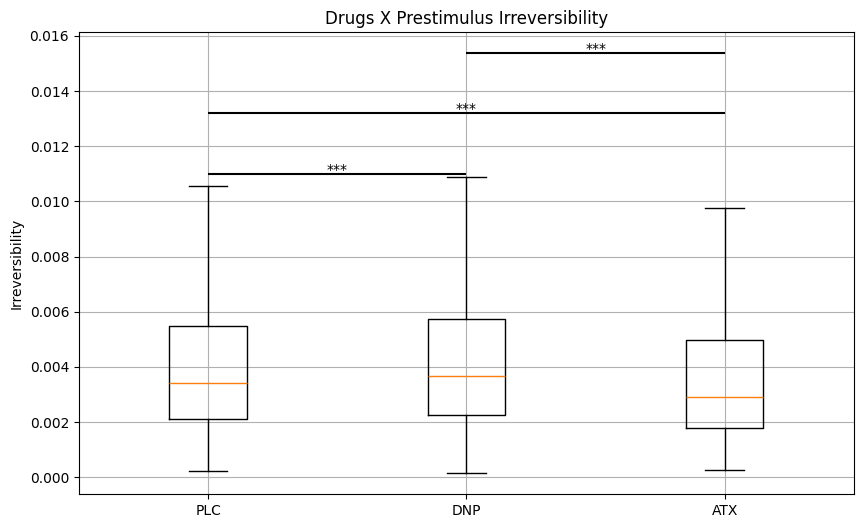

The std dev of PLC 0.004549810691216624
The std dev of DNP 0.00473958957412938
The std dev of ATX 0.00514125145599281


In [8]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)

behavior = behavior[(behavior['poststim_irrev'] < 0.08) & (behavior['prestim_irrev'] < 0.08)]
irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(behavior[behavior['drug'] == drug]['prestim_irrev'])

# Creating the boxplot with improved clarity
plt.figure(figsize=(10, 6))
box = plt.boxplot(irrev_sub_plc, positions=np.arange(len(drugs)), showfliers=False)
plt.xticks(np.arange(len(drugs)), drugs)
plt.ylabel('Irreversibility')
plt.title('Drugs X Prestimulus Irreversibility')
plt.grid(True)


# Mann-Whitney U tests across drugs with corrections

p_values = []
comparisons = []

for i in range(len(irrev_sub_plc)):
    for j in range(i + 1, len(irrev_sub_plc)):
        stat, p = stats.mannwhitneyu(irrev_sub_plc[i], irrev_sub_plc[j], alternative='two-sided')
        p_values.append(p)
        comparisons.append((drugs[i], drugs[j]))

corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]

# Annotating significant differences
max_y = max([item.get_data()[1].max() for item in box['caps']])  # Find the maximum y-value of the whiskers
y_offset = max_y * 0.1  # Slightly above the highest whisker
for i, (comp, corrected_p_val) in enumerate(zip(comparisons, corrected_p_values)):
    x1, x2 = drugs.index(comp[0]), drugs.index(comp[1])
    # Decide number of asterisks based on significance level
    if corrected_p_val < 0.001:
        num_asterisks = '***'
    elif corrected_p_val < 0.01:
        num_asterisks = '**'
    elif corrected_p_val < 0.05:
        num_asterisks = '*'
    else:
        num_asterisks = ''

    if num_asterisks:  # Only draw if there's a significant result
        plt.hlines((max_y+max_y*0.01) + y_offset * i * 2, x1, x2, color="black")
        plt.text((x1 + x2) / 2, max_y + y_offset * (i * 2), num_asterisks, ha='center', va='bottom', color='black')

plt.show()

print("The std dev of PLC "+str(np.std(irrev_sub_plc[0])))
print("The std dev of DNP "+str(np.std(irrev_sub_plc[1])))
print("The std dev of ATX "+str(np.std(irrev_sub_plc[2])))

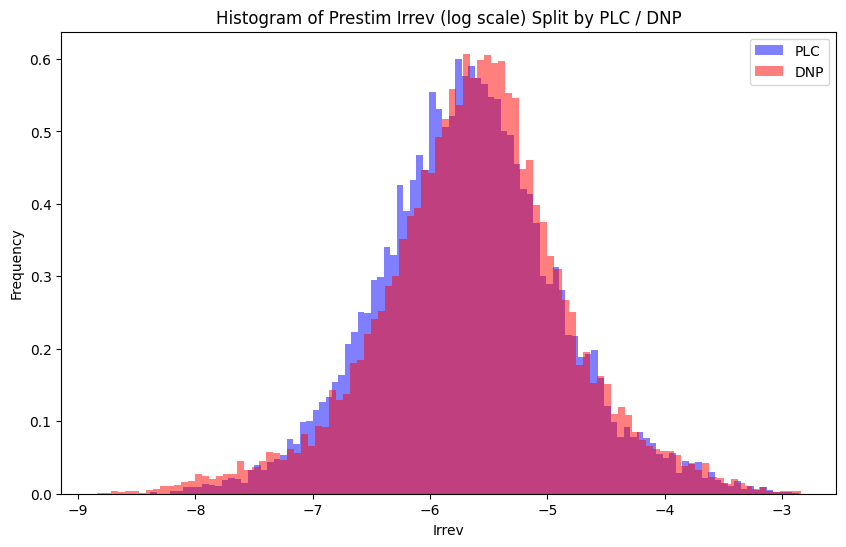

104539712.0
3.2991346471079917e-11
Mean PLC pre: 0.004674283057428326
Mean DNP pre: 0.004900484884659333
The std dev of the PLC Pre values in the pretty histogram (logged irrev values): 0.766255751441029
The std dev of the DNP Pre values in the pretty histogram (logged irrev values): 0.7957671762722793
The std dev of the PLC values of raw: 0.004549810691216624
The std dev of the DNP values of raw: 0.00473958957412938


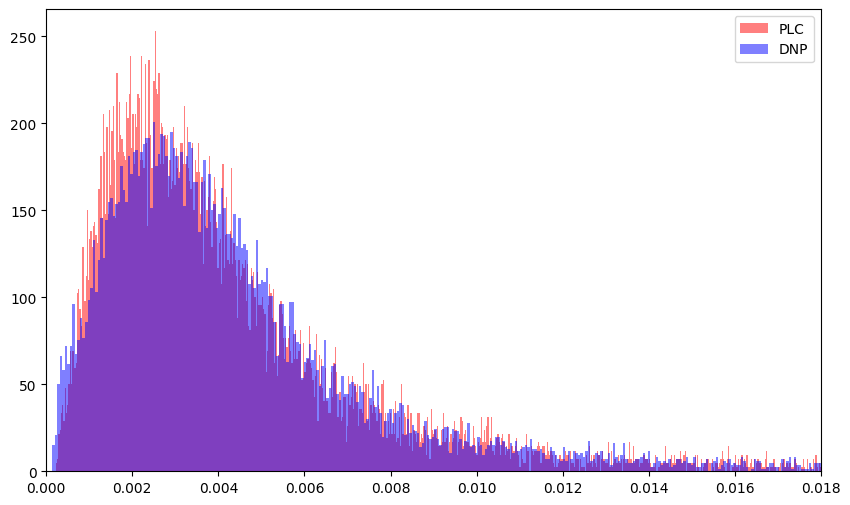

F test-- F-statistic: 0.9215222042219887, p-value: 0.9999996622148296
F test-- F-statistic: 1.0851610470355053, p-value: 0.9999996622148296
Levene's test statistic in raw: 4.844848824719685, p-value: 0.02773651757367125
Brown-Forsythe test statistic in raw: 4.844848824719685, p-value: 0.02773651757367125
Levene's test statistic in logged: 1.8698732246373417, p-value: 0.1714999880470911
Brown-Forsythe test statistic in logged: 1.8698732246373417, p-value: 0.1714999880470911


In [10]:

import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['drug']=='PLC']['prestim_irrev']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='PLC', color='blue', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['drug']=='DNP']['prestim_irrev']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='DNP', color='red', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestim Irrev (log scale) Split by PLC / DNP')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean PLC pre: "+str(np.mean(correct_irrev)))
print("Mean DNP pre: "+str(np.mean(incorrect_irrev)))
print("The std dev of the PLC Pre values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the DNP Pre values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the PLC values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the DNP values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = correct_irrev
group2 = incorrect_irrev

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=2000, alpha=0.5, label='PLC', color='red', density = True)
plt.hist(group2, bins=1000, alpha=0.5, label='DNP', color='blue', density = True)
plt.legend()
plt.xlim(0,0.018)
plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")


ALPHA

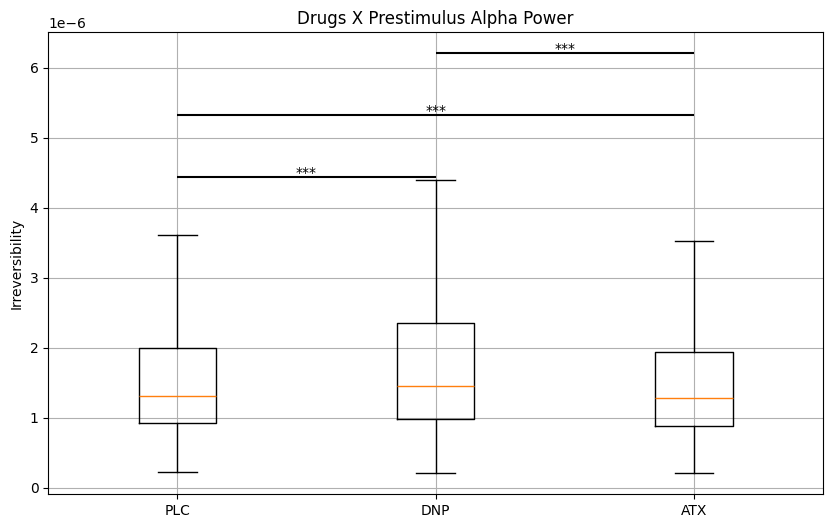

The std dev of PLC 1.4855846115047488e-06
The std dev of DNP 2.1289184431655616e-06
The std dev of ATX 1.3932460133941714e-06


In [16]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)

behavior = behavior[(behavior['poststim_irrev'] < 0.08) & (behavior['prestim_irrev'] < 0.08)]
irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(behavior[behavior['drug'] == drug]['prestim_mean_alpha'])

# Creating the boxplot with improved clarity
plt.figure(figsize=(10, 6))
box = plt.boxplot(irrev_sub_plc, positions=np.arange(len(drugs)), showfliers=False)
plt.xticks(np.arange(len(drugs)), drugs)
plt.ylabel('Irreversibility')
plt.title('Drugs X Prestimulus Alpha Power')
plt.grid(True)


# Mann-Whitney U tests across drugs with corrections

p_values = []
comparisons = []

for i in range(len(irrev_sub_plc)):
    for j in range(i + 1, len(irrev_sub_plc)):
        stat, p = stats.mannwhitneyu(irrev_sub_plc[i], irrev_sub_plc[j], alternative='two-sided')
        p_values.append(p)
        comparisons.append((drugs[i], drugs[j]))

corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]

# Annotating significant differences
max_y = max([item.get_data()[1].max() for item in box['caps']])  # Find the maximum y-value of the whiskers
y_offset = max_y * 0.1  # Slightly above the highest whisker
for i, (comp, corrected_p_val) in enumerate(zip(comparisons, corrected_p_values)):
    x1, x2 = drugs.index(comp[0]), drugs.index(comp[1])
    # Decide number of asterisks based on significance level
    if corrected_p_val < 0.001:
        num_asterisks = '***'
    elif corrected_p_val < 0.01:
        num_asterisks = '**'
    elif corrected_p_val < 0.05:
        num_asterisks = '*'
    else:
        num_asterisks = ''

    if num_asterisks:  # Only draw if there's a significant result
        plt.hlines((max_y+max_y*0.01) + y_offset * i * 2, x1, x2, color="black")
        plt.text((x1 + x2) / 2, max_y + y_offset * (i * 2), num_asterisks, ha='center', va='bottom', color='black')

plt.show()

print("The std dev of PLC "+str(np.std(irrev_sub_plc[0])))
print("The std dev of DNP "+str(np.std(irrev_sub_plc[1])))
print("The std dev of ATX "+str(np.std(irrev_sub_plc[2])))

## poststim

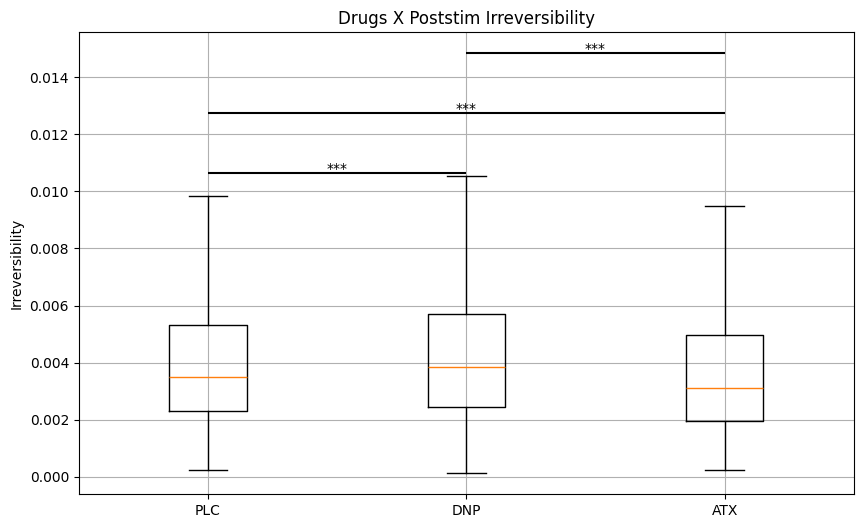

The std dev of PLC 0.0030874596009861604
The std dev of DNP 0.00308828568717314
The std dev of ATX 0.0032747302931189167


In [12]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)

behavior = behavior[(behavior['poststim_irrev'] < 0.08) & (behavior['prestim_irrev'] < 0.08)]
irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(behavior[behavior['drug'] == drug]['poststim_irrev'])

# Creating the boxplot with improved clarity
plt.figure(figsize=(10, 6))
box = plt.boxplot(irrev_sub_plc, positions=np.arange(len(drugs)), showfliers=False)
plt.xticks(np.arange(len(drugs)), drugs)
plt.ylabel('Irreversibility')
plt.title('Drugs X Poststim Irreversibility')
plt.grid(True)


# Mann-Whitney U tests across drugs with corrections

p_values = []
comparisons = []

for i in range(len(irrev_sub_plc)):
    for j in range(i + 1, len(irrev_sub_plc)):
        stat, p = stats.mannwhitneyu(irrev_sub_plc[i], irrev_sub_plc[j], alternative='two-sided')
        p_values.append(p)
        comparisons.append((drugs[i], drugs[j]))

corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]

# Annotating significant differences
max_y = max([item.get_data()[1].max() for item in box['caps']])  # Find the maximum y-value of the whiskers
y_offset = max_y * 0.1  # Slightly above the highest whisker
for i, (comp, corrected_p_val) in enumerate(zip(comparisons, corrected_p_values)):
    x1, x2 = drugs.index(comp[0]), drugs.index(comp[1])
    # Decide number of asterisks based on significance level
    if corrected_p_val < 0.001:
        num_asterisks = '***'
    elif corrected_p_val < 0.01:
        num_asterisks = '**'
    elif corrected_p_val < 0.05:
        num_asterisks = '*'
    else:
        num_asterisks = ''

    if num_asterisks:  # Only draw if there's a significant result
        plt.hlines((max_y+max_y*0.01) + y_offset * i * 2, x1, x2, color="black")
        plt.text((x1 + x2) / 2, max_y + y_offset * (i * 2), num_asterisks, ha='center', va='bottom', color='black')

plt.show()

print("The std dev of PLC "+str(np.std(irrev_sub_plc[0])))
print("The std dev of DNP "+str(np.std(irrev_sub_plc[1])))
print("The std dev of ATX "+str(np.std(irrev_sub_plc[2])))

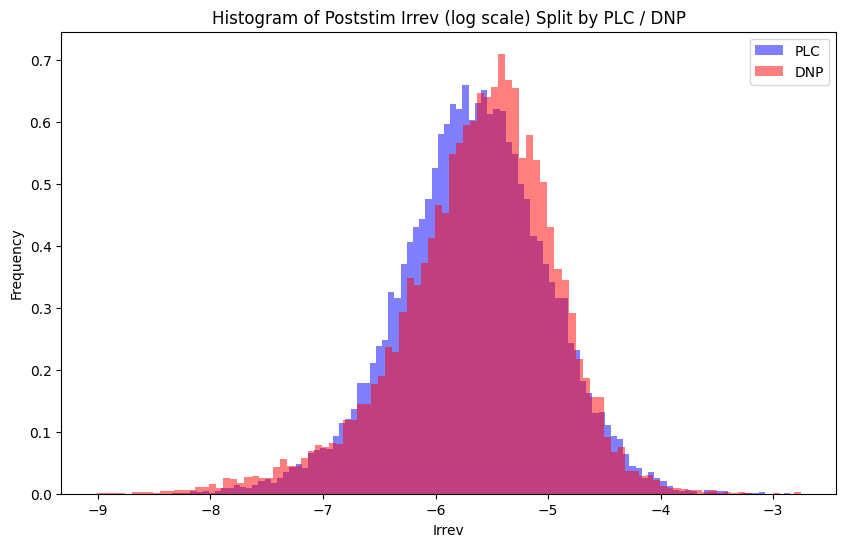

103131401.0
1.2326262695944323e-17
Mean PLC Post: 0.004265642393125833
Mean DNP Post: 0.004440098146474229
The std dev of the PLC Post values in the pretty histogram (logged irrev values): 0.6549803406300687
The std dev of the DNP Post values in the pretty histogram (logged irrev values): 0.6893669246578559
The std dev of the PLC values of raw: 0.0030874596009861604
The std dev of the DNP values of raw: 0.00308828568717314


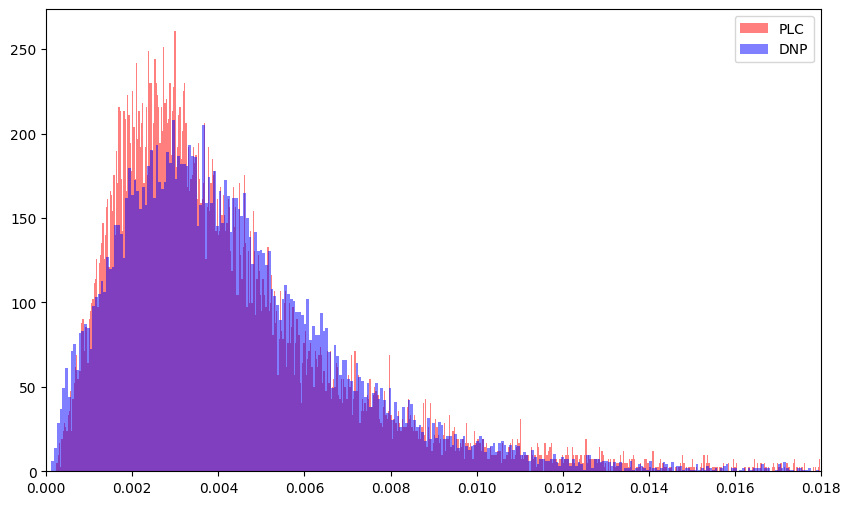

F test-- F-statistic: 0.9994665208424065, p-value: 0.512919606466617
F test-- F-statistic: 1.0005337639095142, p-value: 0.512919606466617
Levene's test statistic in raw: 2.377579041704561, p-value: 0.12309886374468185
Brown-Forsythe test statistic in raw: 2.377579041704561, p-value: 0.12309886374468185
Levene's test statistic in logged: 5.700663777400324, p-value: 0.016964736149220113
Brown-Forsythe test statistic in logged: 5.700663777400324, p-value: 0.016964736149220113


In [14]:

import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['drug']=='PLC']['poststim_irrev']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='PLC', color='blue', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['drug']=='DNP']['poststim_irrev']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='DNP', color='red', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Poststim Irrev (log scale) Split by PLC / DNP')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean PLC Post: "+str(np.mean(correct_irrev)))
print("Mean DNP Post: "+str(np.mean(incorrect_irrev)))
print("The std dev of the PLC Post values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the DNP Post values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the PLC values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the DNP values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = correct_irrev
group2 = incorrect_irrev

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=2000, alpha=0.5, label='PLC', color='red', density = True)
plt.hist(group2, bins=1000, alpha=0.5, label='DNP', color='blue', density = True)
plt.legend()
plt.xlim(0,0.018)
plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")


ALPHA

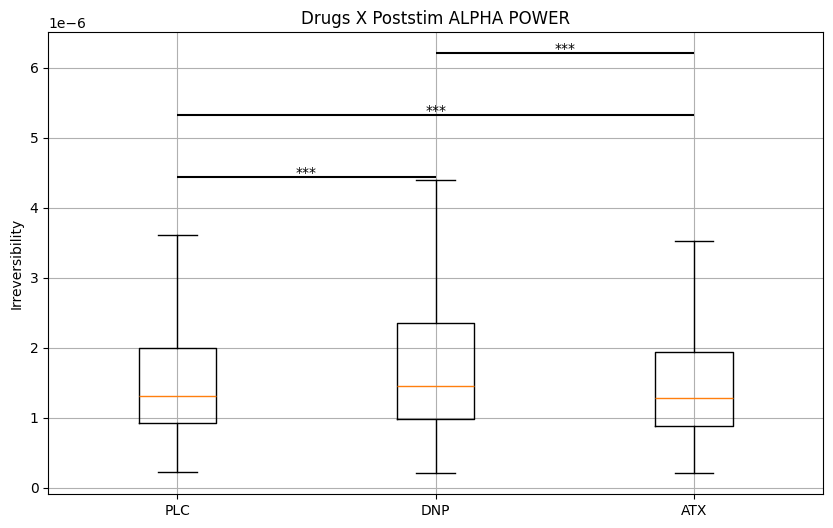

The std dev of PLC 1.4855846115047488e-06
The std dev of DNP 2.1289184431655616e-06
The std dev of ATX 1.3932460133941714e-06


In [19]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)

behavior = behavior[(behavior['poststim_irrev'] < 0.08) & (behavior['prestim_irrev'] < 0.08)]
irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(behavior[behavior['drug'] == drug]['poststim_mean_alpha'])

# Creating the boxplot with improved clarity
plt.figure(figsize=(10, 6))
box = plt.boxplot(irrev_sub_plc, positions=np.arange(len(drugs)), showfliers=False)
plt.xticks(np.arange(len(drugs)), drugs)
plt.ylabel('Irreversibility')
plt.title('Drugs X Poststim ALPHA POWER')
plt.grid(True)


# Mann-Whitney U tests across drugs with corrections

p_values = []
comparisons = []

for i in range(len(irrev_sub_plc)):
    for j in range(i + 1, len(irrev_sub_plc)):
        stat, p = stats.mannwhitneyu(irrev_sub_plc[i], irrev_sub_plc[j], alternative='two-sided')
        p_values.append(p)
        comparisons.append((drugs[i], drugs[j]))

corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]

# Annotating significant differences
max_y = max([item.get_data()[1].max() for item in box['caps']])  # Find the maximum y-value of the whiskers
y_offset = max_y * 0.1  # Slightly above the highest whisker
for i, (comp, corrected_p_val) in enumerate(zip(comparisons, corrected_p_values)):
    x1, x2 = drugs.index(comp[0]), drugs.index(comp[1])
    # Decide number of asterisks based on significance level
    if corrected_p_val < 0.001:
        num_asterisks = '***'
    elif corrected_p_val < 0.01:
        num_asterisks = '**'
    elif corrected_p_val < 0.05:
        num_asterisks = '*'
    else:
        num_asterisks = ''

    if num_asterisks:  # Only draw if there's a significant result
        plt.hlines((max_y+max_y*0.01) + y_offset * i * 2, x1, x2, color="black")
        plt.text((x1 + x2) / 2, max_y + y_offset * (i * 2), num_asterisks, ha='center', va='bottom', color='black')

plt.show()

print("The std dev of PLC "+str(np.std(irrev_sub_plc[0])))
print("The std dev of DNP "+str(np.std(irrev_sub_plc[1])))
print("The std dev of ATX "+str(np.std(irrev_sub_plc[2])))

# 6/7- Within the subject drug session block, is the variability of the post-pre diff related to performance?

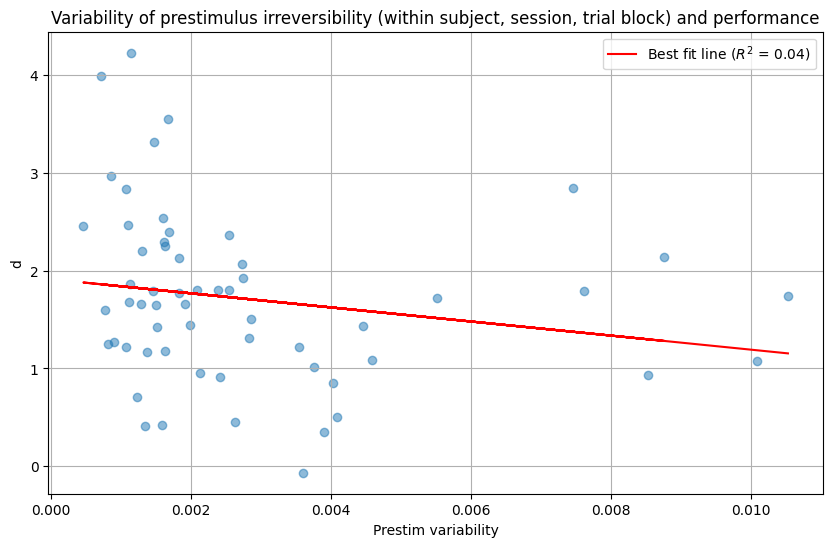

Number of groups analyzed: 58


In [66]:
import pandas as pd
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt
from scipy.stats import linregress

behavior = df 

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[(modified_dataframe[column] < threshold)]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(df, 'prestim_mean_alpha', 0.995)
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

behavior = behavior[behavior['drug'] == 'ATX']

# Define or ensure the sdt function and behavior DataFrame are available here
def sdt1(df, correct_counts):
    # counts:
    n_hit = ((df['stimulus']==1)&(df['response']==1)).sum()
    n_miss = ((df['stimulus']==1)&(df['response']==0)).sum()
    n_fa = ((df['stimulus']==0)&(df['response']==1)).sum()
    n_cr = ((df['stimulus']==0)&(df['response']==0)).sum()

    # correct counts?
    if correct_counts:
        n_hit += .5
        n_miss += .5
        n_fa += .5
        n_cr += .5

    # rates:
    hit_rate = n_hit / (n_hit + n_miss)
    fa_rate = n_fa / (n_fa + n_cr)

    # z-score:
    hit_rate_z = norm.isf(1-hit_rate)
    fa_rate_z = norm.isf(1-fa_rate)

    # measures:
    d = hit_rate_z - fa_rate_z
    c = -(hit_rate_z + fa_rate_z) / 2

    return d
# Function to sample 100 observations from each group that has more than 100 samples
def sample_100(x):
    if len(x) > 100:
        return x.sample(n=100)
    else:
        return x  # Just return the dataframe as is if less than 100, though this should not happen due to prior filter

# Filter groups to include only those that have more than 100 samples
filtered_behavior = behavior.groupby(['subject', 'drug', 'session', 'block']).filter(lambda x: len(x) > 100)

# Apply sampling to each group to standardize group size to 100
standardized_behavior = filtered_behavior.groupby(['subject', 'drug', 'session', 'block']).apply(sample_100).reset_index(drop=True)

# Re-check to make sure all groups have exactly 100 samples
assert standardized_behavior.groupby(['subject', 'drug', 'session', 'block']).size().eq(100).all(), "Not all groups have 100 samples"

# Calculate the standard deviation of 'prestim_irrev' for each group
df_sdt_irreversibility = standardized_behavior.groupby(['subject', 'drug', 'session', 'block'])['prestim_irrev'].std()

# Calculate the SDT measures for each group using the standardized dataset
df_sdt_irreversibility1 = standardized_behavior.groupby(['subject', 'drug', 'session', 'block']).apply(lambda x: sdt1(x, True))  # Assuming correct_counts is intended to be True

# Convert results to arrays
x = df_sdt_irreversibility.values
y = df_sdt_irreversibility1.values

# Check if x and y are the same size
if len(x) == len(y):
    plt.figure(figsize=(10, 6))
    plt.scatter(x, y, alpha=0.5)

    # Perform linear regression
    slope, intercept, r_value, p_value, std_err = linregress(x, y)

    # Calculate line of best fit
    line = slope * x + intercept

    # Plot line of best fit
    plt.plot(x, line, color='red', label=f'Best fit line ($R^2$ = {r_value**2:.2f})')
    plt.xlabel('Prestim variability')
    plt.ylabel('d')
    plt.title('Variability of prestimulus irreversibility (within subject, session, trial block) and performance')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Print the number of groups analyzed
    print("Number of groups analyzed:", len(df_sdt_irreversibility))
else:
    print("Error: The x and y arrays do not have the same length. x has length {}, y has length {}".format(len(x), len(y)))


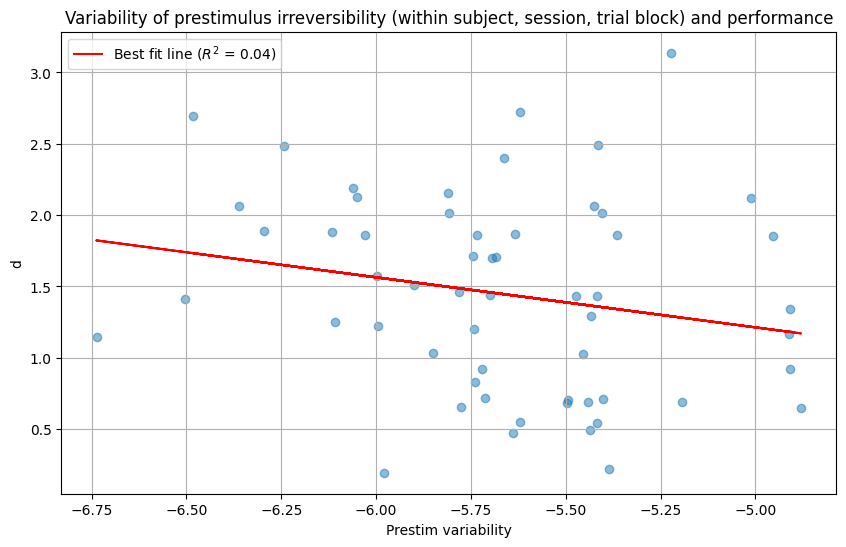

Number of groups analyzed: 57


In [157]:
import pandas as pd
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt
from scipy.stats import linregress

behavior = df 

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[(modified_dataframe[column] < threshold)]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(df, 'prestim_mean_alpha', 0.999)
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

behavior = behavior[behavior['drug'] == 'PLC']

# Define or ensure the sdt function and behavior DataFrame are available here
def sdt1(df, correct_counts):
    # counts:
    n_hit = ((df['stimulus']==1)&(df['response']==1)).sum()
    n_miss = ((df['stimulus']==1)&(df['response']==0)).sum()
    n_fa = ((df['stimulus']==0)&(df['response']==1)).sum()
    n_cr = ((df['stimulus']==0)&(df['response']==0)).sum()

    # correct counts?
    if correct_counts:
        n_hit += .5
        n_miss += .5
        n_fa += .5
        n_cr += .5

    # rates:
    hit_rate = n_hit / (n_hit + n_miss)
    fa_rate = n_fa / (n_fa + n_cr)

    # z-score:
    hit_rate_z = norm.isf(1-hit_rate)
    fa_rate_z = norm.isf(1-fa_rate)

    # measures:
    d = hit_rate_z - fa_rate_z
    c = -(hit_rate_z + fa_rate_z) / 2

    return d
# Function to sample 100 observations from each group that has more than 100 samples
def sample_100(x):
    if len(x) > 100:
        return x.sample(n=100)
    else:
        return x  # Just return the dataframe as is if less than 100, though this should not happen due to prior filter

# Filter groups to include only those that have more than 100 samples
filtered_behavior = behavior.groupby(['subject', 'drug', 'session', 'block']).filter(lambda x: len(x) > 100)

# Apply sampling to each group to standardize group size to 100
standardized_behavior = filtered_behavior.groupby(['subject', 'drug', 'session', 'block']).apply(sample_100).reset_index(drop=True)

# Re-check to make sure all groups have exactly 100 samples
assert standardized_behavior.groupby(['subject', 'drug', 'session', 'block']).size().eq(100).all(), "Not all groups have 100 samples"

# Calculate the standard deviation of 'prestim_irrev' for each group
df_sdt_irreversibility = standardized_behavior.groupby(['subject', 'drug', 'session', 'block'])['log_poststim'].mean()

# Calculate the SDT measures for each group using the standardized dataset
df_sdt_irreversibility1 = standardized_behavior.groupby(['subject', 'drug', 'session', 'block']).apply(lambda x: sdt1(x, True))  # Assuming correct_counts is intended to be True

# Convert results to arrays
x = df_sdt_irreversibility.values
y = df_sdt_irreversibility1.values

# Check if x and y are the same size
if len(x) == len(y):
    plt.figure(figsize=(10, 6))
    plt.scatter(x, y, alpha=0.5)

    # Perform linear regression
    slope, intercept, r_value, p_value, std_err = linregress(x, y)

    # Calculate line of best fit
    line = slope * x + intercept

    # Plot line of best fit
    plt.plot(x, line, color='red', label=f'Best fit line ($R^2$ = {r_value**2:.2f})')
    plt.xlabel('Prestim variability')
    plt.ylabel('d')
    plt.title('Variability of prestimulus irreversibility (within subject, session, trial block) and performance')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Print the number of groups analyzed
    print("Number of groups analyzed:", len(df_sdt_irreversibility))
else:
    print("Error: The x and y arrays do not have the same length. x has length {}, y has length {}".format(len(x), len(y)))


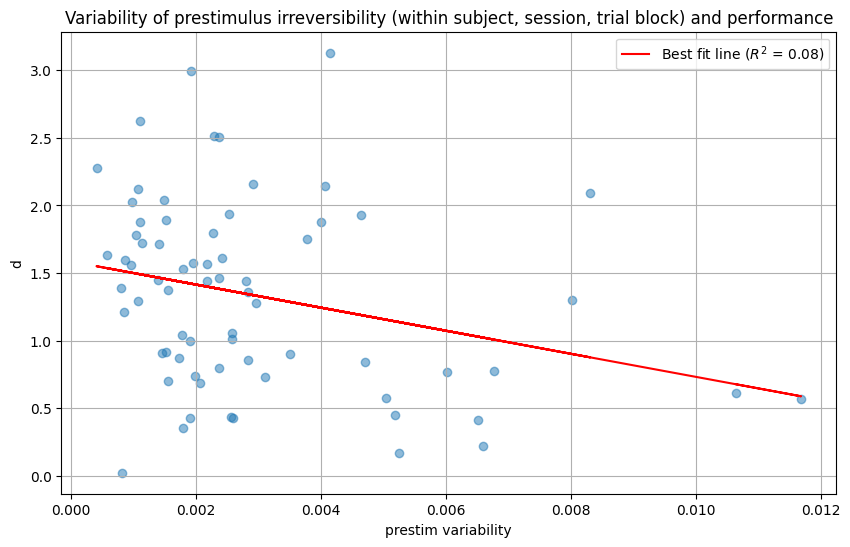

69


In [30]:

def sdt1(df, correct_counts):
    # counts:
    n_hit = ((df['stimulus']==1)&(df['response']==1)).sum()
    n_miss = ((df['stimulus']==1)&(df['response']==0)).sum()
    n_fa = ((df['stimulus']==0)&(df['response']==1)).sum()
    n_cr = ((df['stimulus']==0)&(df['response']==0)).sum()

    # correct counts?
    if correct_counts:
        n_hit += .5
        n_miss += .5
        n_fa += .5
        n_cr += .5

    # rates:
    hit_rate = n_hit / (n_hit + n_miss)
    fa_rate = n_fa / (n_fa + n_cr)

    # z-score:
    hit_rate_z = norm.isf(1-hit_rate)
    fa_rate_z = norm.isf(1-fa_rate)

    # measures:
    d = hit_rate_z - fa_rate_z
    c = -(hit_rate_z + fa_rate_z) / 2

    return d


behavior = df 

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[(modified_dataframe[column] < threshold)]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(df, 'prestim_mean_alpha', 0.999)
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

behavior = behavior[behavior['drug'] == 'PLC']

df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'session', 'block'])['prestim_irrev'].std()

df_sdt_irreversibility1 = behavior.groupby(['subject', 'drug', 'session', 'block']).apply(lambda x: sdt1(x, correct_counts))


from scipy.stats import linregress

plt.figure(figsize=(10, 6))

x = df_sdt_irreversibility.values
y = df_sdt_irreversibility1.values


plt.scatter(x, y, alpha = 0.5)

# Perform linear regression
slope, intercept, r_value, p_value, std_err = linregress(x, y)

# Calculate line of best fit
line = slope * x + intercept

# Plot line of best fit
plt.plot(x, line, color='red', label=f'Best fit line ($R^2$ = {r_value**2:.2f})')

# Display the plot
plt.xlabel('prestim variability')
plt.ylabel('d')
plt.title('Variability of prestimulus irreversibility (within subject, session, trial block) and performance')
plt.legend()
plt.grid(True)
plt.show()
# we can do a 
print(len(df_sdt_irreversibility1.values))


#

## alpha variability 

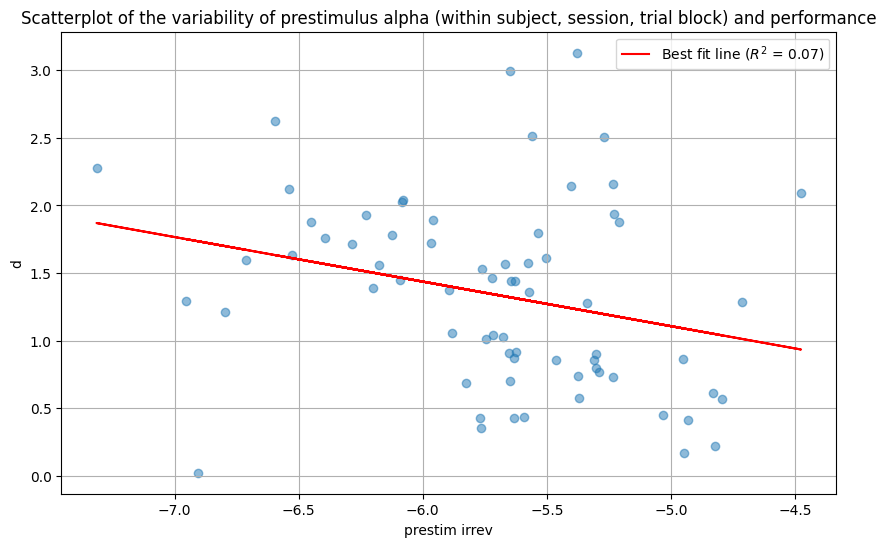

69


In [5]:

def sdt1(df, correct_counts):
    # counts:
    n_hit = ((df['stimulus']==1)&(df['response']==1)).sum()
    n_miss = ((df['stimulus']==1)&(df['response']==0)).sum()
    n_fa = ((df['stimulus']==0)&(df['response']==1)).sum()
    n_cr = ((df['stimulus']==0)&(df['response']==0)).sum()

    # correct counts?
    if correct_counts:
        n_hit += .5
        n_miss += .5
        n_fa += .5
        n_cr += .5

    # rates:
    hit_rate = n_hit / (n_hit + n_miss)
    fa_rate = n_fa / (n_fa + n_cr)

    # z-score:
    hit_rate_z = norm.isf(1-hit_rate)
    fa_rate_z = norm.isf(1-fa_rate)

    # measures:
    d = hit_rate_z - fa_rate_z
    c = -(hit_rate_z + fa_rate_z) / 2

    return d


behavior = df 

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[(modified_dataframe[column] < threshold)]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(df, 'prestim_mean_alpha', 0.999)
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

behavior = behavior[behavior['drug'] == 'PLC']

df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'session', 'block'])['log_prestim'].mean()

df_sdt_irreversibility1 = behavior.groupby(['subject', 'drug', 'session', 'block']).apply(lambda x: sdt1(x, correct_counts))


from scipy.stats import linregress

plt.figure(figsize=(10, 6))

x = df_sdt_irreversibility.values
y = df_sdt_irreversibility1.values


plt.scatter(x, y, alpha = 0.5)

# Perform linear regression
slope, intercept, r_value, p_value, std_err = linregress(x, y)

# Calculate line of best fit
line = slope * x + intercept

# Plot line of best fit
plt.plot(x, line, color='red', label=f'Best fit line ($R^2$ = {r_value**2:.2f})')

# Display the plot
plt.xlabel('prestim irrev')
plt.ylabel('d')
plt.title('Scatterplot of the variability of prestimulus alpha (within subject, session, trial block) and performance')
plt.legend()
plt.grid(True)
plt.show()
# we can do a 
print(len(df_sdt_irreversibility1.values))


#

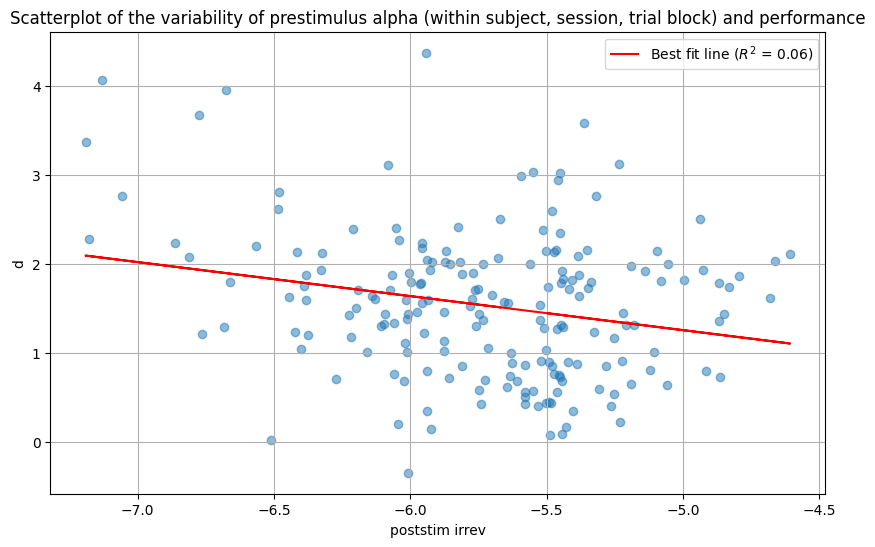

192


In [11]:

def sdt1(df, correct_counts):
    # counts:
    n_hit = ((df['stimulus']==1)&(df['response']==1)).sum()
    n_miss = ((df['stimulus']==1)&(df['response']==0)).sum()
    n_fa = ((df['stimulus']==0)&(df['response']==1)).sum()
    n_cr = ((df['stimulus']==0)&(df['response']==0)).sum()

    # correct counts?
    if correct_counts:
        n_hit += .5
        n_miss += .5
        n_fa += .5
        n_cr += .5

    # rates:
    hit_rate = n_hit / (n_hit + n_miss)
    fa_rate = n_fa / (n_fa + n_cr)

    # z-score:
    hit_rate_z = norm.isf(1-hit_rate)
    fa_rate_z = norm.isf(1-fa_rate)

    # measures:
    d = hit_rate_z - fa_rate_z
    c = -(hit_rate_z + fa_rate_z) / 2

    return d


behavior = df 

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[(modified_dataframe[column] < threshold)]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(df, 'prestim_mean_alpha', 0.999)
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

#behavior = behavior[behavior['drug'] == 'PLC']

df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'session', 'block'])['log_poststim'].median()

df_sdt_irreversibility1 = behavior.groupby(['subject', 'drug', 'session', 'block']).apply(lambda x: sdt1(x, correct_counts))


from scipy.stats import linregress

plt.figure(figsize=(10, 6))

x = df_sdt_irreversibility.values
y = df_sdt_irreversibility1.values


plt.scatter(x, y, alpha = 0.5)

# Perform linear regression
slope, intercept, r_value, p_value, std_err = linregress(x, y)

# Calculate line of best fit
line = slope * x + intercept

# Plot line of best fit
plt.plot(x, line, color='red', label=f'Best fit line ($R^2$ = {r_value**2:.2f})')

# Display the plot
plt.xlabel('poststim irrev')
plt.ylabel('d')
plt.title('Scatterplot of the variability of prestimulus alpha (within subject, session, trial block) and performance')
plt.legend()
plt.grid(True)
plt.show()
# we can do a 
print(len(df_sdt_irreversibility1.values))


#

## diff variability

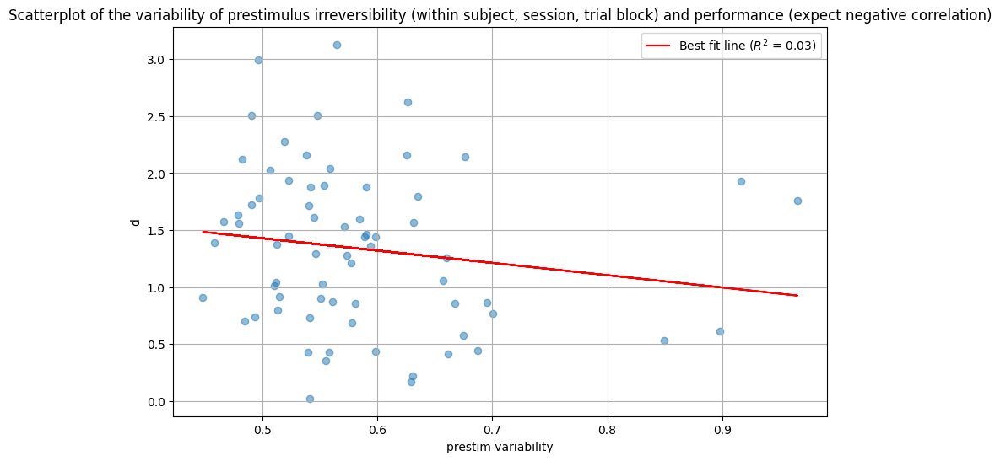

69


In [81]:

def sdt1(df, correct_counts):
    # counts:
    n_hit = ((df['stimulus']==1)&(df['response']==1)).sum()
    n_miss = ((df['stimulus']==1)&(df['response']==0)).sum()
    n_fa = ((df['stimulus']==0)&(df['response']==1)).sum()
    n_cr = ((df['stimulus']==0)&(df['response']==0)).sum()

    # correct counts?
    if correct_counts:
        n_hit += .5
        n_miss += .5
        n_fa += .5
        n_cr += .5

    # rates:
    hit_rate = n_hit / (n_hit + n_miss)
    fa_rate = n_fa / (n_fa + n_cr)

    # z-score:
    hit_rate_z = norm.isf(1-hit_rate)
    fa_rate_z = norm.isf(1-fa_rate)

    # measures:
    d = hit_rate_z - fa_rate_z
    c = -(hit_rate_z + fa_rate_z) / 2

    return d


behavior = df 
behavior['log_diff'] = behavior['log_poststim'] - behavior['log_prestim']
def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[(modified_dataframe[column] < threshold)]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(df, 'prestim_mean_alpha', 0.995)
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

behavior = behavior[behavior['drug'] == 'PLC']



df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'session', 'block'])['log_diff'].std()

df_sdt_irreversibility1 = behavior.groupby(['subject', 'drug', 'session', 'block']).apply(lambda x: sdt1(x, correct_counts))


from scipy.stats import linregress

plt.figure(figsize=(10, 6))

x = df_sdt_irreversibility.values
y = df_sdt_irreversibility1.values


plt.scatter(x, y, alpha = 0.5)

# Perform linear regression
slope, intercept, r_value, p_value, std_err = linregress(x, y)

# Calculate line of best fit
line = slope * x + intercept

# Plot line of best fit
plt.plot(x, line, color='red', label=f'Best fit line ($R^2$ = {r_value**2:.2f})')

# Display the plot
plt.xlabel('diff (pre-post) variability')
plt.ylabel('d')
plt.title('Scatterplot of the variability of prestimulus irreversibility (within subject, session, trial block) and performance (expect negative correlation)')
plt.legend()
plt.grid(True)
plt.show()
# we can do a 
print(len(df_sdt_irreversibility1.values))


#

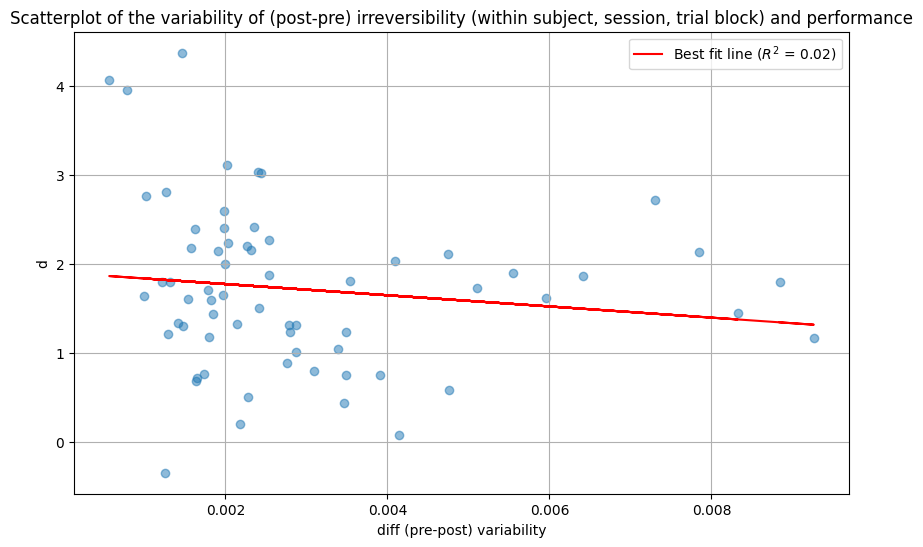

65


In [85]:

def sdt1(df, correct_counts):
    # counts:
    n_hit = ((df['stimulus']==1)&(df['response']==1)).sum()
    n_miss = ((df['stimulus']==1)&(df['response']==0)).sum()
    n_fa = ((df['stimulus']==0)&(df['response']==1)).sum()
    n_cr = ((df['stimulus']==0)&(df['response']==0)).sum()

    # correct counts?
    if correct_counts:
        n_hit += .5
        n_miss += .5
        n_fa += .5
        n_cr += .5

    # rates:
    hit_rate = n_hit / (n_hit + n_miss)
    fa_rate = n_fa / (n_fa + n_cr)

    # z-score:
    hit_rate_z = norm.isf(1-hit_rate)
    fa_rate_z = norm.isf(1-fa_rate)

    # measures:
    d = hit_rate_z - fa_rate_z
    c = -(hit_rate_z + fa_rate_z) / 2

    return d


behavior = df 
behavior['log_diff'] = behavior['log_poststim'] - behavior['log_prestim']
def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[(modified_dataframe[column] < threshold)]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(df, 'prestim_mean_alpha', 0.995)
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

behavior = behavior[behavior['drug'] == 'ATX']



df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'session', 'block'])['stim_diff'].std()

df_sdt_irreversibility1 = behavior.groupby(['subject', 'drug', 'session', 'block']).apply(lambda x: sdt1(x, correct_counts))


from scipy.stats import linregress

plt.figure(figsize=(10, 6))

x = df_sdt_irreversibility.values
y = df_sdt_irreversibility1.values


plt.scatter(x, y, alpha = 0.5)

# Perform linear regression
slope, intercept, r_value, p_value, std_err = linregress(x, y)

# Calculate line of best fit
line = slope * x + intercept

# Plot line of best fit
plt.plot(x, line, color='red', label=f'Best fit line ($R^2$ = {r_value**2:.2f})')

# Display the plot
plt.xlabel('diff (pre-post) variability')
plt.ylabel('d')
plt.title('Scatterplot of the variability of (post-pre) irreversibility (within subject, session, trial block) and performance')
plt.legend()
plt.grid(True)
plt.show()
# we can do a 
print(len(df_sdt_irreversibility1.values))


#

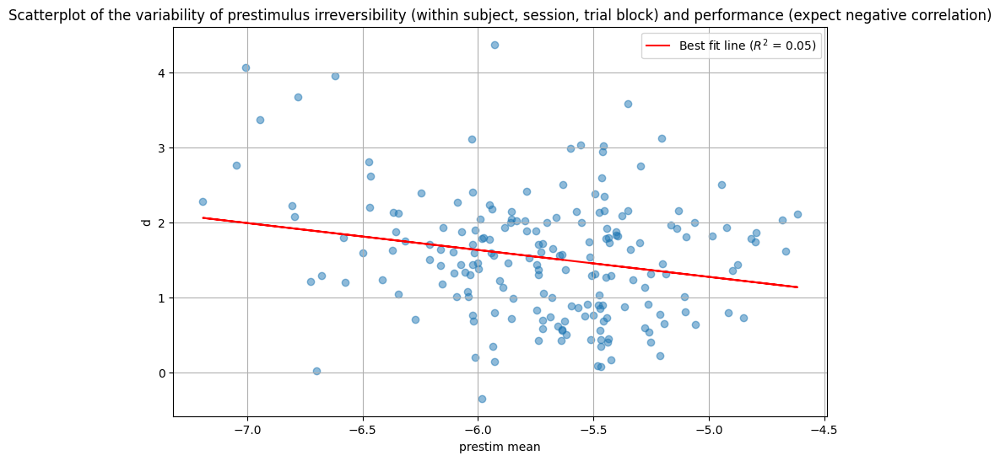

192


In [160]:

def sdt1(df, correct_counts):
    # counts:
    n_hit = ((df['stimulus']==1)&(df['response']==1)).sum()
    n_miss = ((df['stimulus']==1)&(df['response']==0)).sum()
    n_fa = ((df['stimulus']==0)&(df['response']==1)).sum()
    n_cr = ((df['stimulus']==0)&(df['response']==0)).sum()

    # correct counts?
    if correct_counts:
        n_hit += .5
        n_miss += .5
        n_fa += .5
        n_cr += .5

    # rates:
    hit_rate = n_hit / (n_hit + n_miss)
    fa_rate = n_fa / (n_fa + n_cr)

    # z-score:
    hit_rate_z = norm.isf(1-hit_rate)
    fa_rate_z = norm.isf(1-fa_rate)

    # measures:
    d = hit_rate_z - fa_rate_z
    c = -(hit_rate_z + fa_rate_z) / 2

    return d


behavior = df 
behavior['log_diff'] = behavior['log_poststim'] - behavior['log_prestim']
def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[(modified_dataframe[column] < threshold)]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(df, 'prestim_mean_alpha', 0.999)
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

#behavior = behavior[behavior['drug'] == 'PLC']



df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'session', 'block'])['log_poststim'].mean()

df_sdt_irreversibility1 = behavior.groupby(['subject', 'drug', 'session', 'block']).apply(lambda x: sdt1(x, correct_counts))


from scipy.stats import linregress

plt.figure(figsize=(10, 6))

x = df_sdt_irreversibility.values
y = df_sdt_irreversibility1.values


plt.scatter(x, y, alpha = 0.5)

# Perform linear regression
slope, intercept, r_value, p_value, std_err = linregress(x, y)

# Calculate line of best fit
line = slope * x + intercept

# Plot line of best fit
plt.plot(x, line, color='red', label=f'Best fit line ($R^2$ = {r_value**2:.2f})')

# Display the plot
plt.xlabel('prestim mean')
plt.ylabel('d')
plt.title('Scatterplot of the variability of prestimulus irreversibility (within subject, session, trial block) and performance (expect negative correlation)')
plt.legend()
plt.grid(True)
plt.show()
# we can do a 
print(len(df_sdt_irreversibility1.values))


#

# 6/8 testing 

In [29]:
behavior = df
montage = mne.channels.make_standard_montage('biosemi64')

channel_names = montage.ch_names

# Get the positions of the electrodes
pos = montage.get_positions()['ch_pos']  # This returns a dictionary mapping channel names to 3D positions

positions = np.array(list(pos.values()))

# Calculate the distance matrix
from scipy.spatial import distance_matrix
dist_matrix = distance_matrix(positions, positions)

print(dist_matrix.shape)

print(dist_matrix)
print(behavior['prestim_ref_mat'][0])

print(channel_names[0])
print(channel_names[1])
print(behavior['prestim_ref_mat'][0][0,1])
print(behavior['prestim_ref_mat'][0][1,0])

(64, 64)
[[0.         0.02970444 0.03182265 ... 0.18754647 0.18824077 0.18988426]
 [0.02970444 0.         0.03467014 ... 0.18988426 0.18773718 0.18754647]
 [0.03182265 0.03467014 0.         ... 0.18773718 0.18263972 0.18824077]
 ...
 [0.18754647 0.18988426 0.18773718 ... 0.         0.03467014 0.02970444]
 [0.18824077 0.18773718 0.18263972 ... 0.03467014 0.         0.03182265]
 [0.18988426 0.18754647 0.18824077 ... 0.02970444 0.03182265 0.        ]]
[[0.00000000e+00 6.87388137e-04 1.62137358e-04 ... 1.68235232e-04
  1.96932085e-05 8.64165236e-07]
 [6.87388137e-04 0.00000000e+00 1.48513383e-06 ... 2.89881014e-04
  4.94598178e-04 5.02351062e-04]
 [1.62137358e-04 1.48513383e-06 0.00000000e+00 ... 9.18453677e-06
  1.46860097e-08 3.05189097e-06]
 ...
 [1.68235232e-04 2.89881014e-04 9.18453677e-06 ... 0.00000000e+00
  2.08189574e-07 5.44421027e-05]
 [1.96932085e-05 4.94598178e-04 1.46860097e-08 ... 2.08189574e-07
  0.00000000e+00 8.73671300e-05]
 [8.64165236e-07 5.02351062e-04 3.05189097e-06 

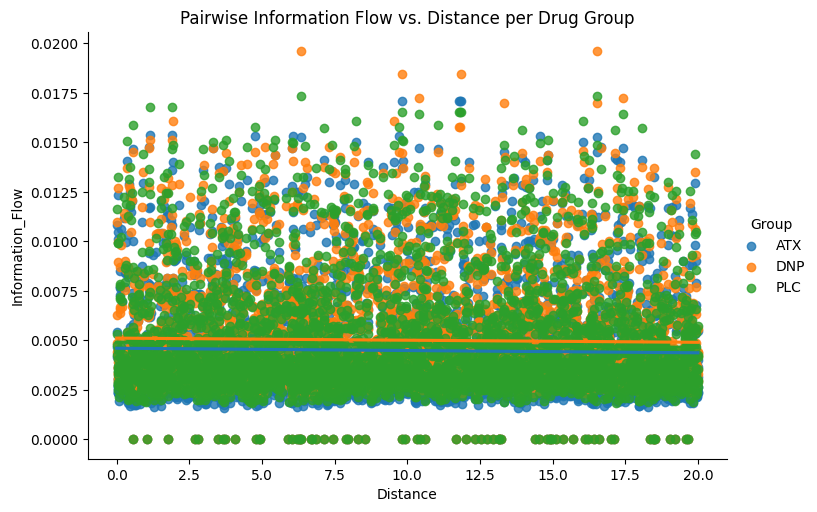

Group: ATX, Correlation: -0.02385288746266965, P-value: 0.12692620695240606
Group: DNP, Correlation: -0.023138026690116227, P-value: 0.13871854706997225
Group: PLC, Correlation: -0.02703277408092383, P-value: 0.08365071753751428
Group: ATX, Slope: -1.1507684072341628e-05, Intercept: 0.004602114325710062, R-squared: 0.0005689602403067832, P-value: 0.12692620695240484
Group: DNP, Slope: -1.0551503817773172e-05, Intercept: 0.005113158494495242, R-squared: 0.0005353682791125308, P-value: 0.13871854706998882
Group: PLC, Slope: -1.3123411676843561e-05, Intercept: 0.004906604018713806, R-squared: 0.000730770874510267, P-value: 0.0836507175375132
                            OLS Regression Results                            
Dep. Variable:       Information_Flow   R-squared:                       0.007
Model:                            OLS   Adj. R-squared:                  0.006
Method:                 Least Squares   F-statistic:                     16.55
Date:                Sun, 09 Jun 2024

In [36]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import pearsonr, linregress
import pandas as pd
import statsmodels.api as sm
import statsmodels.formula.api as smf

# Assuming df is your DataFrame
behavior = df

def mean_matrix(matrices):
    return np.mean(matrices, axis=0)

# Group by 'drug' and calculate the mean matrix for each group
mean_ref_mats = behavior.groupby('drug')['prestim_ref_mat'].apply(lambda x: mean_matrix(np.stack(x)))

# Convert the result to a dictionary for easier access
mean_ref_mats_dict = mean_ref_mats.to_dict()

# Assuming dist_matrix is your distance matrix
# Example distance matrix (replace with actual distance matrix)
dist_matrix = np.random.rand(64, 64) * 20  # distances in cm

# Flatten the matrices and create a DataFrame for easier manipulation
flattened_data = []
for drug, mean_mat in mean_ref_mats_dict.items():
    distance_flat = dist_matrix.flatten()
    info_flow_flat = mean_mat.flatten()
    for dist, flow in zip(distance_flat, info_flow_flat):
        flattened_data.append({'Distance': dist, 'Information_Flow': flow, 'Group': drug})

df_flat = pd.DataFrame(flattened_data)

# Plot the data with regression lines for each group
sns.lmplot(x='Distance', y='Information_Flow', hue='Group', data=df_flat, aspect=1.5)
plt.title('Pairwise Information Flow vs. Distance per Drug Group')
plt.show()

# Calculate correlation coefficients per group
for group in df_flat['Group'].unique():
    subset = df_flat[df_flat['Group'] == group]
    corr, p_value = pearsonr(subset['Distance'], subset['Information_Flow'])
    print(f"Group: {group}, Correlation: {corr}, P-value: {p_value}")

# Linear regression analysis per group
for group in df_flat['Group'].unique():
    subset = df_flat[df_flat['Group'] == group]
    slope, intercept, r_value, p_value, std_err = linregress(subset['Distance'], subset['Information_Flow'])
    print(f"Group: {group}, Slope: {slope}, Intercept: {intercept}, R-squared: {r_value**2}, P-value: {p_value}")

# Comparing slopes across groups using interaction term
# Convert Group to categorical type for regression analysis
df_flat['Group'] = df_flat['Group'].astype('category')

# Fit an interaction model
model = smf.ols('Information_Flow ~ Distance * Group', data=df_flat).fit()
print(model.summary())


# 6/9 -- lets get to the bottom of this -- is atx more or less variable?

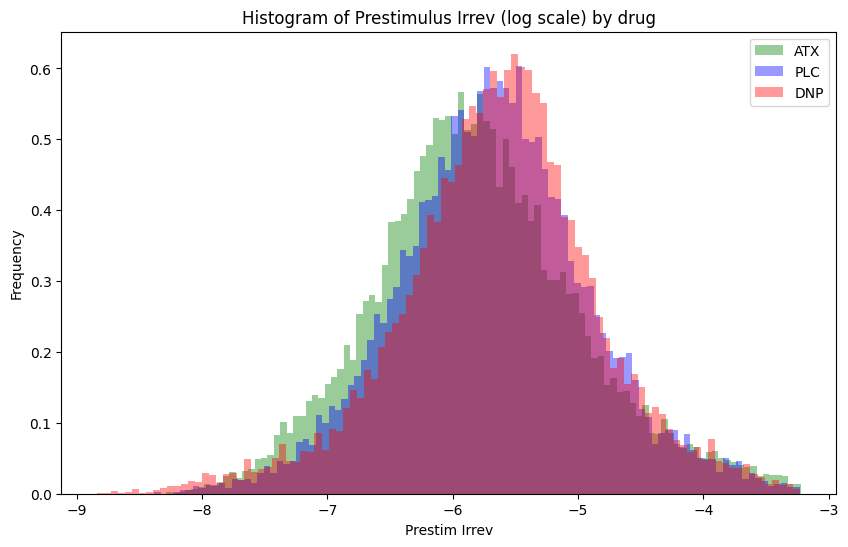

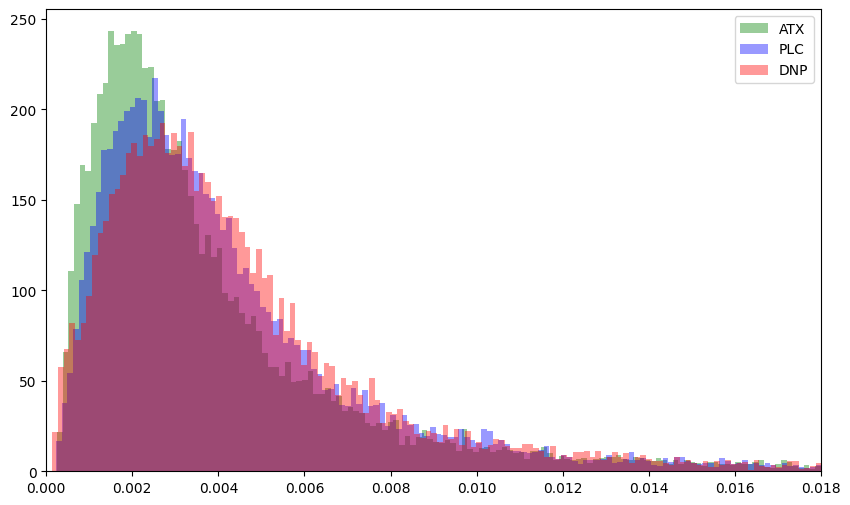

PLC - The std dev of the pre values in the pretty histogram (logged irrev values): 0.7617845444438743
DNP - The std dev of the pre values in the pretty histogram (logged irrev values): 0.7898417143606173
ATX - The std dev of the pre values in the pretty histogram (logged irrev values): 0.8253027519750696
PLC - The std dev of the pre values in the raw: 0.004311435877165735
DNP - The std dev of the pre values in the raw: 0.004413938053211925
ATX - The std dev of the pre values in the raw: 0.004785451609578805
PLC - The MAD of the pre values in the raw: 0.0015346942030567642
DNP - The MAD of the pre values in the raw: 0.001605607355710948
ATX - The MAD of the pre values in the raw: 0.0013742372117432318
PLC - The MAD of the pre values in the pretty histogram (logged irrev values): 0.47769448341799015
DNP - The MAD of the pre values in the pretty histogram (logged irrev values): 0.46091839114307964
ATX - The MAD of the pre values in the pretty histogram (logged irrev values): 0.51356724451

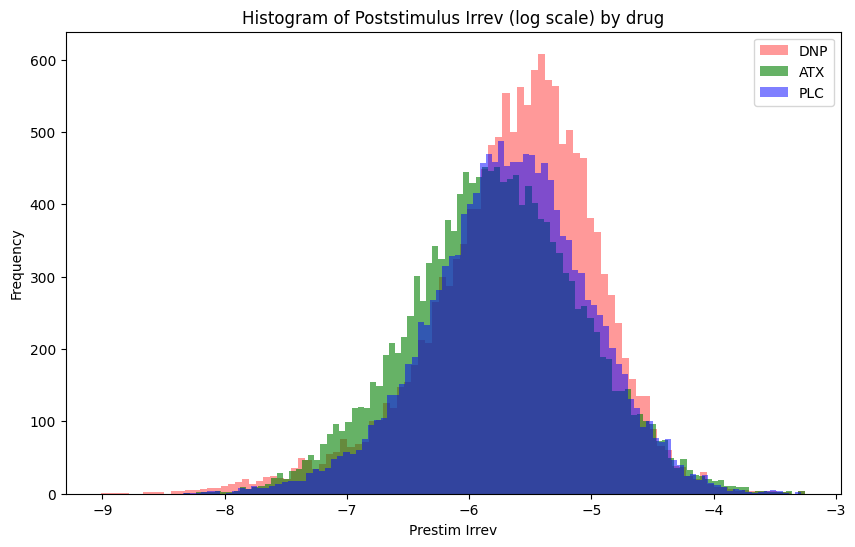

PLC - The std dev of the post values in the pretty histogram (logged irrev values): 0.6535320848249753
DNP - The std dev of the post values in the pretty histogram (logged irrev values): 0.6874908400007261
ATX - The std dev of the post values in the pretty histogram (logged irrev values): 0.7084924418567752


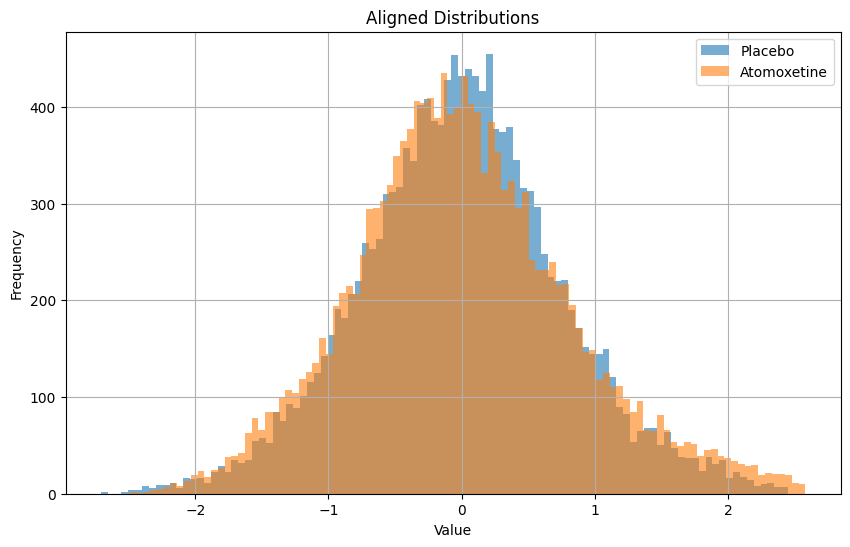

In [111]:

behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.04) & (behavior['prestim_irrev'] < 0.04)]

df_plc = behavior[behavior['drug'] == 'PLC']
df_dnp = behavior[behavior['drug'] == 'DNP']
df_atx = behavior[behavior['drug'] == 'ATX']

# Setting up the figure and axes
plt.figure(figsize=(10, 6))


plt.hist(np.log(df_atx['prestim_irrev']), bins=100, alpha=0.4, label='ATX', color='green', density = True)
plt.hist(np.log(df_plc['prestim_irrev']), bins=100, alpha=0.4, label='PLC', color='blue', density = True)
plt.hist(np.log(df_dnp['prestim_irrev']), bins=100, alpha=0.4, label='DNP', color='red', density = True)

# Adding labels and title
plt.xlabel('Prestim Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestimulus Irrev (log scale) by drug')
plt.legend()

plt.show()




plt.figure(figsize=(10, 6))
plt.hist(df_atx['prestim_irrev'], bins=300, alpha=0.4, label='ATX', color='green', density = True)
plt.hist(df_plc['prestim_irrev'], bins=300, alpha=0.4, label='PLC', color='blue', density = True)
plt.hist(df_dnp['prestim_irrev'], bins=300, alpha=0.4, label='DNP', color='red', density = True)

plt.xlim(0,0.018)
plt.legend()
plt.show()


plc_pre = np.std(np.log(df_plc['prestim_irrev']))
dnp_pre = np.std(np.log(df_dnp['prestim_irrev']))
atx_pre = np.std(np.log(df_atx['prestim_irrev']))

print("PLC - The std dev of the pre values in the pretty histogram (logged irrev values): " + str(
    plc_pre))
print("DNP - The std dev of the pre values in the pretty histogram (logged irrev values): " + str(
    dnp_pre))
print("ATX - The std dev of the pre values in the pretty histogram (logged irrev values): " + str(
    atx_pre))

plc_pre = np.std(df_plc['prestim_irrev'])
dnp_pre = np.std(df_dnp['prestim_irrev'])
atx_pre = np.std(df_atx['prestim_irrev'])
print("PLC - The std dev of the pre values in the raw: " + str(
    plc_pre))
print("DNP - The std dev of the pre values in the raw: " + str(
    dnp_pre))
print("ATX - The std dev of the pre values in the raw: " + str(
    atx_pre))

MAD1 = np.median(np.abs(df_plc['prestim_irrev'] - np.median(df_plc['prestim_irrev'])))
MAD2 = np.median(np.abs(df_dnp['prestim_irrev'] - np.median(df_dnp['prestim_irrev'])))
MAD3 = np.median(np.abs(df_atx['prestim_irrev'] - np.median(df_atx['prestim_irrev'])))


print("PLC - The MAD of the pre values in the raw: " + str(
    MAD1))
print("DNP - The MAD of the pre values in the raw: " + str(
    MAD2))
print("ATX - The MAD of the pre values in the raw: " + str(
    MAD3))

MAD1 = np.median(np.abs(np.log(df_plc['prestim_irrev'])- np.median(np.log(df_plc['prestim_irrev']))))
MAD2 = np.median(np.abs(np.log(df_dnp['prestim_irrev']) - np.median(np.log(df_dnp['prestim_irrev']))))
MAD3 = np.median(np.abs(np.log(df_atx['prestim_irrev']) - np.median(np.log(df_atx['prestim_irrev']))))

print("PLC - The MAD of the pre values in the pretty histogram (logged irrev values): " + str(
    MAD1))
print("DNP - The MAD of the pre values in the pretty histogram (logged irrev values): " + str(
    MAD2))
print("ATX - The MAD of the pre values in the pretty histogram (logged irrev values): " + str(
    MAD3))

#############POST###################

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

plt.hist(np.log(df_dnp['poststim_irrev']), bins=100, alpha=0.4, label='DNP', color='red', density = False)
plt.hist(np.log(df_atx['poststim_irrev']), bins=100, alpha=0.6, label='ATX', color='green', density = False)
plt.hist(np.log(df_plc['poststim_irrev']), bins=100, alpha=0.5, label='PLC', color='blue', density = False)


# Adding labels and title
plt.xlabel('Prestim Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Poststimulus Irrev (log scale) by drug')
plt.legend()

# Show the plot
plt.show()
plc_post = np.std(np.log(df_plc['poststim_irrev']))
dnp_post = np.std(np.log(df_dnp['poststim_irrev']))
atx_post = np.std(np.log(df_atx['poststim_irrev']))


print("PLC - The std dev of the post values in the pretty histogram (logged irrev values): " + str(
    plc_post))
print("DNP - The std dev of the post values in the pretty histogram (logged irrev values): " + str(
    dnp_post))
print("ATX - The std dev of the post values in the pretty histogram (logged irrev values): " + str(
    atx_post))


#print("PLC - diff of the std devs: " + str(plc_post-plc_pre))
#print("DNP - diff of the std devs: " + str(dnp_post-dnp_pre))
#print("ATX - diff of the std devs: " + str(atx_post-atx_pre))


data1 = np.log(df_plc['prestim_irrev'])
data2 = np.log(df_atx['prestim_irrev'])
mean1 = np.mean(data1)
mean2 = np.mean(data2)

# Shift data to align their means
data1_shifted = data1 - mean1
data2_shifted = data2 - mean2

# Plotting
plt.figure(figsize=(10, 6))
plt.hist(data1_shifted, bins=100, alpha=0.6, label='Placebo')
plt.hist(data2_shifted, bins=100, alpha=0.6, label='Atomoxetine')
plt.title('Aligned Distributions')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.legend()
plt.grid(True)
plt.show()





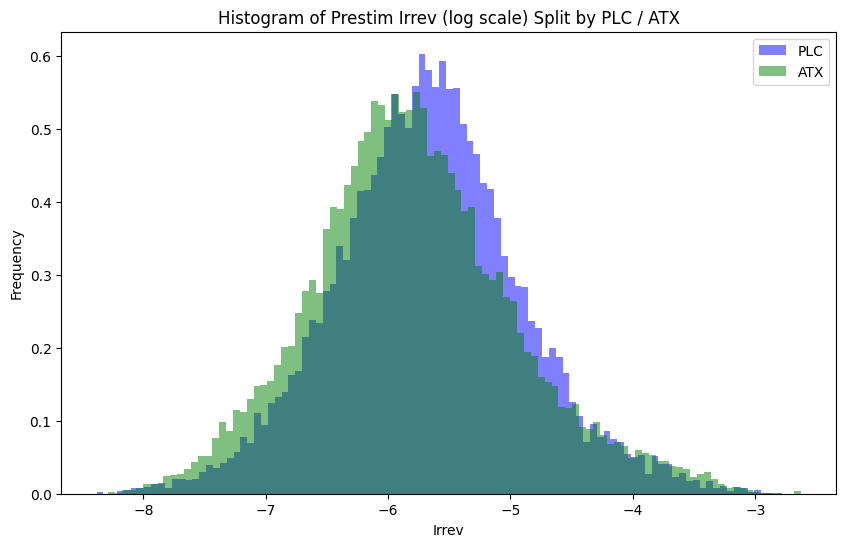

122691469.0
7.977236371488519e-56
Mean PLC pre: 0.004699890827096417
Mean ATX pre: 0.004463435040630532
The std dev of the PLC Pre values in the pretty histogram (logged irrev values): 0.7687599456748739
The std dev of the ATX Pre values in the pretty histogram (logged irrev values): 0.8330942280962594
The std dev of the PLC values of raw: 0.004650035780204647
The std dev of the ATX values of raw: 0.005146544015326295


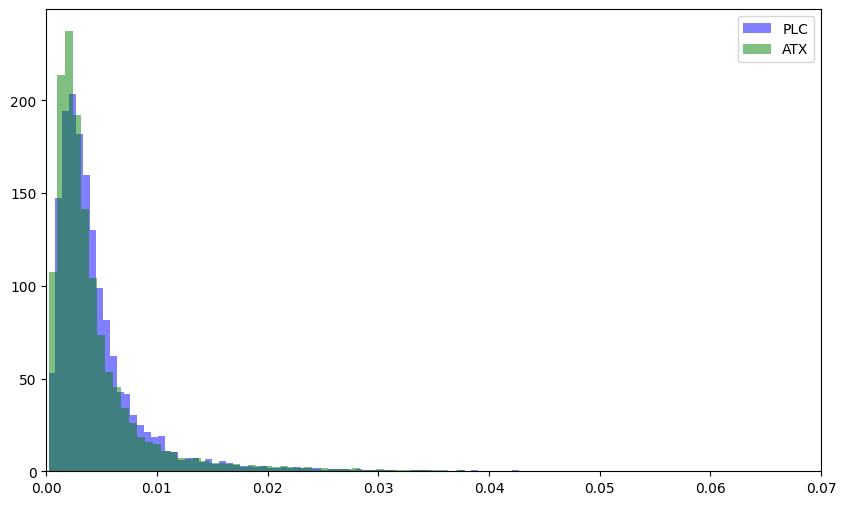

F test-- F-statistic: 0.8163608937685377, p-value: 0.9999999999999999
F test-- F-statistic: 1.2249484359591696, p-value: 0.9999999999999999
Levene's test statistic in raw: 3.693425995840395, p-value: 0.054636825394574456
Brown-Forsythe test statistic in raw: 3.693425995840395, p-value: 0.054636825394574456
Levene's test statistic in logged: 73.32001533991807, p-value: 1.1546205551507818e-17
Brown-Forsythe test statistic in logged: 73.32001533991807, p-value: 1.1546205551507818e-17


In [96]:

behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['drug']=='PLC']['prestim_irrev']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='PLC', color='blue', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['drug']=='ATX']['prestim_irrev']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='ATX', color='green', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestim Irrev (log scale) Split by PLC / ATX')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean PLC pre: "+str(np.mean(correct_irrev)))
print("Mean ATX pre: "+str(np.mean(incorrect_irrev)))
print("The std dev of the PLC Pre values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the ATX Pre values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the PLC values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the ATX values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = correct_irrev
group2 = incorrect_irrev

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='PLC', color='blue', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='ATX', color='green', density = True)
plt.legend()
plt.xlim(0,0.07)
plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")




## stim diff variability

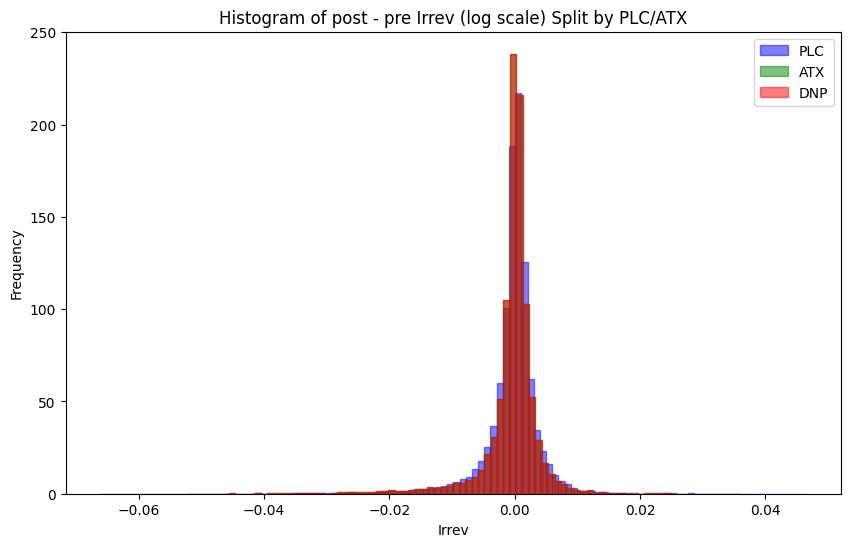

122691469.0
7.977236371488519e-56
Mean PLC: 0.004699890827096417
Mean ATX: 0.004463435040630532
The std dev of the PLC diff values in the pretty histogram (logged irrev values): 0.7687599456748739
The std dev of the ATX diff values in the pretty histogram (logged irrev values): 0.8330942280962594
The std dev of the PLC diff values of raw: 0.004650035780204647
The std dev of the ATX diff values of raw: 0.005146544015326295


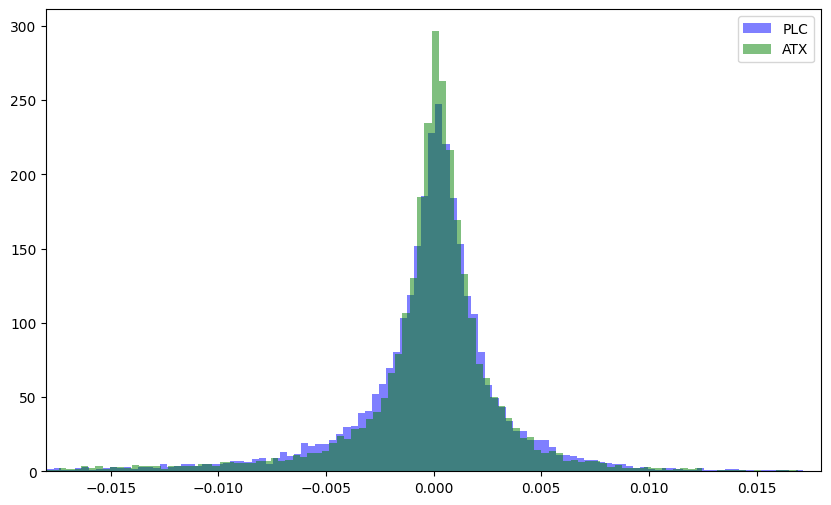

F test-- F-statistic: 0.936752020003905, p-value: 0.9999664010835061
F test-- F-statistic: 1.0675183812209248, p-value: 0.9999664010835061
Levene's test statistic in raw: 4.968857516327018, p-value: 0.025815114039799532
Brown-Forsythe test statistic in raw: 4.968857516327018, p-value: 0.025815114039799532
Levene's test statistic in logged: nan, p-value: nan
Brown-Forsythe test statistic in logged: nan, p-value: nan


c:\Users\jaket\anaconda3\envs\deco1\lib\site-packages\pandas\core\arraylike.py:402: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [57]:
behavior = df

#behavior['stim_diff'] = behavior['log_poststim'] - behavior['log_prestim']

#behavior[behavior['drug'] == 'PLC']['stim_diff']
#behavior[behavior['drug'] == 'ATX']['stim_diff']


behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
plc_diff = behavior[behavior['drug'] == 'PLC']['stim_diff']

plt.hist(plc_diff, bins=100, alpha=0.5, label='PLC', color='blue', edgecolor='blue', density = True)

# Histogram for RT when correct is 1
atx_diff = behavior[behavior['drug'] == 'ATX']['stim_diff']
plt.hist(atx_diff, bins=100, alpha=0.5, label='ATX', color='green', edgecolor='green', density = True)

dnp_diff = behavior[behavior['drug'] == 'ATX']['stim_diff']
plt.hist(dnp_diff, bins=100, alpha=0.5, label='DNP', color='red', edgecolor='red', density = True)
# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of post - pre Irrev (log scale) Split by PLC/ATX')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean PLC: "+str(np.mean(correct_irrev)))
print("Mean ATX: "+str(np.mean(incorrect_irrev)))
print("The std dev of the PLC diff values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the ATX diff values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the PLC diff values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the ATX diff values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = behavior[behavior['drug'] == 'PLC']['stim_diff']
group2 = behavior[behavior['drug'] == 'ATX']['stim_diff']

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=300, alpha=0.5, label='PLC', color='blue', density = True)
plt.hist(group2, bins=300, alpha=0.5, label='ATX', color='green', density = True)
plt.xlim(-0.018, 0.018)
plt.legend()
plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")





# 6/9 - 1/f slope

In [68]:
prestim_1overf = np.load(r'C:\Users\jaket\COGS280\DataDeco\prestim_1overf_slopes.npy')
df['prestim_1overf'] = prestim_1overf

poststim_1overf = np.load(r'C:\Users\jaket\COGS280\DataDeco\poststim_1overf_slopes.npy')
df['poststim_1overf'] = poststim_1overf

C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2203404575.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2203404575.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: PLC
Bin means: irreversibility_bin
0   -6.490394
1   -6.163639
2   -5.997235
3   -5.856168
4   -5.735617
5   -5.617031
6   -5.495414
7   -5.360583
8   -5.173419
9   -4.808056
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2203404575.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2203404575.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0   -6.451175
1   -6.118582
2   -5.951044
3   -5.817217
4   -5.697443
5   -5.583025
6   -5.458187
7   -5.315664
8   -5.142977
9   -4.783875
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2203404575.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2203404575.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0   -6.584058
1   -6.262943
2   -6.098782
3   -5.967344
4   -5.846561
5   -5.733015
6   -5.613196
7   -5.475540
8   -5.296071
9   -4.929662
Name: irrev, dtype: float64


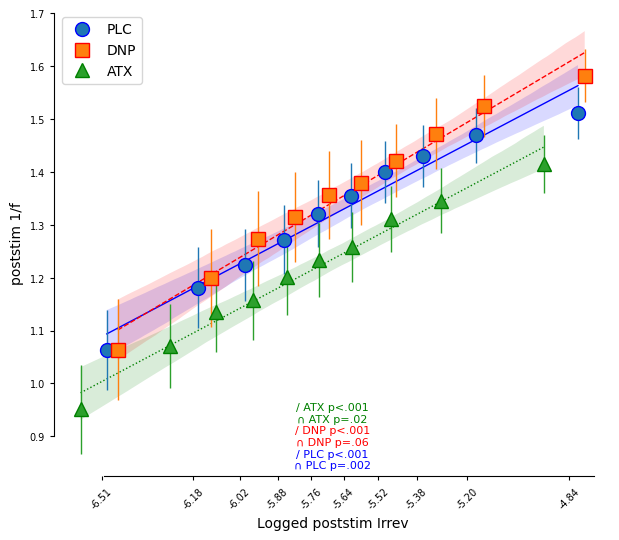

In [69]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(df, 'poststim_1overf', 0.995)

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['poststim_irrev'] < 0.075)]
behavior['irrev'] = behavior['log_poststim']
cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['poststim_1overf'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['poststim_1overf']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['poststim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'poststim_1overf'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['poststim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'poststim_1overf'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['poststim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'poststim_1overf'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['poststim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'poststim_1overf'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['poststim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'poststim_1overf'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['poststim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'poststim_1overf'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['poststim_1overf'] < 0.05 or betas_second_irreversibility_plc['poststim_1overf'] < 0.05:
    if betas_first_irreversibility_plc['poststim_1overf'] < betas_second_irreversibility_plc['poststim_1overf']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['poststim_1overf'] < betas_first_irreversibility_plc['poststim_1overf']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['poststim_1overf'] < 0.05 or betas_second_irreversibility_dnp['poststim_1overf'] < 0.05:
    if betas_first_irreversibility_dnp['poststim_1overf'] < betas_second_irreversibility_dnp['poststim_1overf']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['poststim_1overf'] < betas_first_irreversibility_dnp['poststim_1overf']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['poststim_1overf'] < 0.05 or betas_second_irreversibility_atx['poststim_1overf'] < 0.05:
    if betas_first_irreversibility_atx['poststim_1overf'] < betas_second_irreversibility_atx['poststim_1overf']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['poststim_1overf'] < betas_first_irreversibility_atx['poststim_1overf']:
        plot_quadratic_atx = True

# Plotting results for poststim_1overf'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['poststim_1overf']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['poststim_1overf']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['poststim_1overf']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['poststim_1overf']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['poststim_1overf']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['poststim_1overf']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="poststim_1overf", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['poststim_1overf']),
                                               p_val_string(betas_second_irreversibility_plc['poststim_1overf'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['poststim_1overf']),
                                               p_val_string(betas_second_irreversibility_dnp['poststim_1overf'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['poststim_1overf']),
                                               p_val_string(betas_second_irreversibility_atx['poststim_1overf'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('poststim 1/f')
ax.set_xlabel('Logged poststim Irrev')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\3570352843.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irrev'] = behavior['prestim_1overf']
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\3570352843.py:27: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bi

Drug: PLC
Bin means: irreversibility_bin
0    0.763766
1    1.039399
2    1.202529
3    1.359773
4    1.621987
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\3570352843.py:27: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\3570352843.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0    0.792023
1    1.092538
2    1.256074
3    1.424367
4    1.694786
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\3570352843.py:27: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\3570352843.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0    0.659844
1    0.926300
2    1.081535
3    1.234649
4    1.495008
Name: irrev, dtype: float64


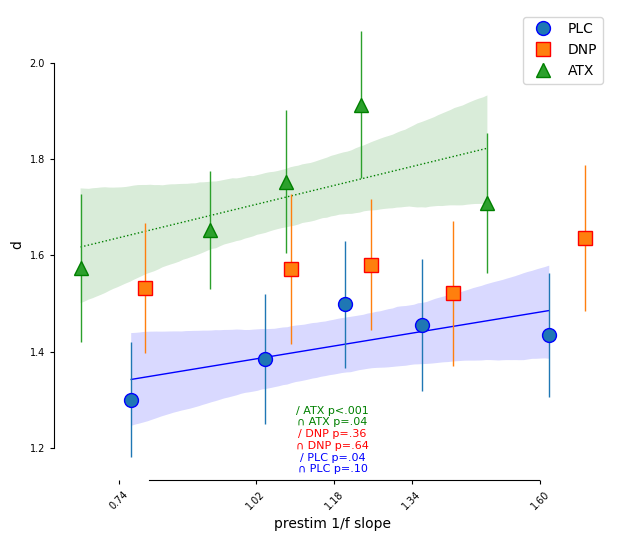

In [61]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df



behavior = behavior[(behavior['poststim_irrev'] < 0.08) & (behavior['prestim_irrev'] < 0.08)]
behavior['irrev'] = behavior['prestim_1overf']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    #df_sdt_irreversibility['prestim_mean_alpha'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['prestim_mean_alpha']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('d')
ax.set_xlabel('prestim 1/f slope')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2018426680.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irrev'] = behavior['bl_pupil']
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2018426680.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], 

Drug: PLC
Bin means: irreversibility_bin
0    3173.127775
1    3321.903518
2    3393.917494
3    3448.763816
4    3497.946860
5    3544.933208
6    3594.797807
7    3647.705310
8    3726.635905
9    3886.365663
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2018426680.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2018426680.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: DNP
Bin means: irreversibility_bin
0    3147.361523
1    3294.477330
2    3365.692276
3    3418.731228
4    3465.317002
5    3515.039515
6    3559.157866
7    3614.461966
8    3682.131088
9    3833.794343
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2018426680.py:38: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
C:\Users\jaket\AppData\Local\Temp\ipykernel_10684\2018426680.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

Drug: ATX
Bin means: irreversibility_bin
0    3371.133543
1    3529.563098
2    3608.716926
3    3673.586721
4    3727.407360
5    3775.033537
6    3835.925824
7    3890.847005
8    3975.761284
9    4151.350267
Name: irrev, dtype: float64


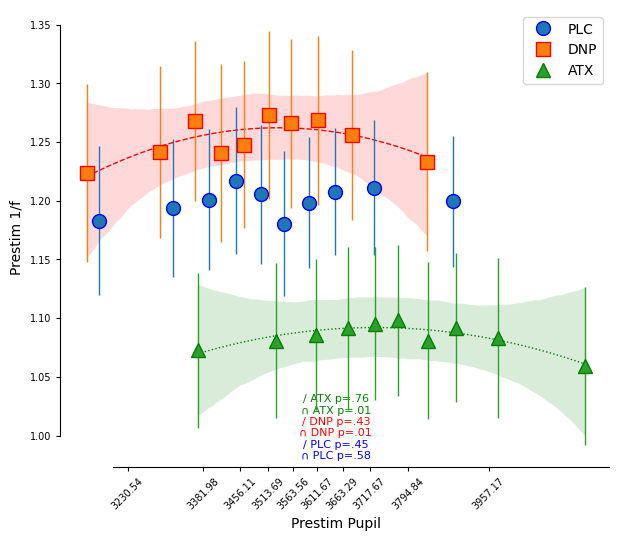

In [141]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp


# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
#behavior = remove_top_percentile(df, 'prestim_1overf', 0.999)

behavior = behavior[(behavior['poststim_irrev'] < 0.05) & (behavior['prestim_irrev'] < 0.05)]
behavior['irrev'] = behavior['bl_pupil']
cfg = {'n_bins': 10}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    df_sdt_irreversibility['prestim_1overf'] = behavior.groupby(['subject','drug','irreversibility_bin']).mean()['prestim_1overf']
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['prestim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_1overf'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['prestim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_1overf'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['prestim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_1overf'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['prestim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_1overf'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['prestim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'prestim_1overf'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['prestim_1overf'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'prestim_1overf'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['prestim_1overf'] < 0.05 or betas_second_irreversibility_plc['prestim_1overf'] < 0.05:
    if betas_first_irreversibility_plc['prestim_1overf'] < betas_second_irreversibility_plc['prestim_1overf']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['prestim_1overf'] < betas_first_irreversibility_plc['prestim_1overf']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['prestim_1overf'] < 0.05 or betas_second_irreversibility_dnp['prestim_1overf'] < 0.05:
    if betas_first_irreversibility_dnp['prestim_1overf'] < betas_second_irreversibility_dnp['prestim_1overf']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['prestim_1overf'] < betas_first_irreversibility_dnp['prestim_1overf']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['prestim_1overf'] < 0.05 or betas_second_irreversibility_atx['prestim_1overf'] < 0.05:
    if betas_first_irreversibility_atx['prestim_1overf'] < betas_second_irreversibility_atx['prestim_1overf']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['prestim_1overf'] < betas_first_irreversibility_atx['prestim_1overf']:
        plot_quadratic_atx = True

# Plotting results for prestim_1overf'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['prestim_1overf']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['prestim_1overf']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['prestim_1overf']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['prestim_1overf']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['prestim_1overf']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['prestim_1overf']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="prestim_1overf", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['prestim_1overf']),
                                               p_val_string(betas_second_irreversibility_plc['prestim_1overf'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['prestim_1overf']),
                                               p_val_string(betas_second_irreversibility_dnp['prestim_1overf'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['prestim_1overf']),
                                               p_val_string(betas_second_irreversibility_atx['prestim_1overf'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Prestim 1/f')
ax.set_xlabel('Prestim Pupil')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



## scatter

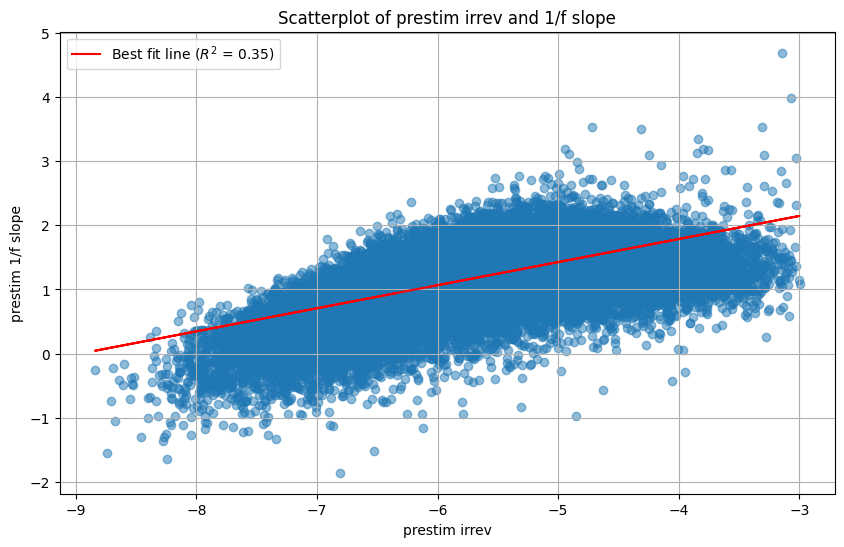

In [136]:
from scipy.stats import linregress
behavior = df 

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)
behavior = behavior[(behavior['poststim_irrev'] < 0.05) & (behavior['prestim_irrev'] < 0.05)]
plt.figure(figsize=(10, 6))

x = behavior['log_prestim']
y = behavior['prestim_1overf']

plt.scatter(x, y, alpha = 0.5)

# Perform linear regression
slope, intercept, r_value, p_value, std_err = linregress(x, y)

# Calculate line of best fit
line = slope * x + intercept

# Plot line of best fit
plt.plot(x, line, color='red', label=f'Best fit line ($R^2$ = {r_value**2:.2f})')

# Display the plot
plt.xlabel('prestim irrev')
plt.ylabel('prestim 1/f slope')
plt.title('Scatterplot of prestim irrev and 1/f slope')
plt.legend()
plt.grid(True)
plt.show()
# we can do a 

# 6/11 - atx vs plc in the diff -- showing variability

Statistic: 110108427.0, P-value: 0.22829287761512496
0.0013389485646997745
0.0012189012374998198
mean of plc in diff (post-pre): -0.0004201185107137011
mean of atx in diff (post-pre): -0.00047620410621906234
median of plc in diff (post-pre): 0.0001050210959663468
median of atx in diff (post-pre): 0.00013147807587559604
std dev of plc in diff (post-pre): 0.004618038979153819
std dev of atx in diff (post-pre): 0.004771399362297593


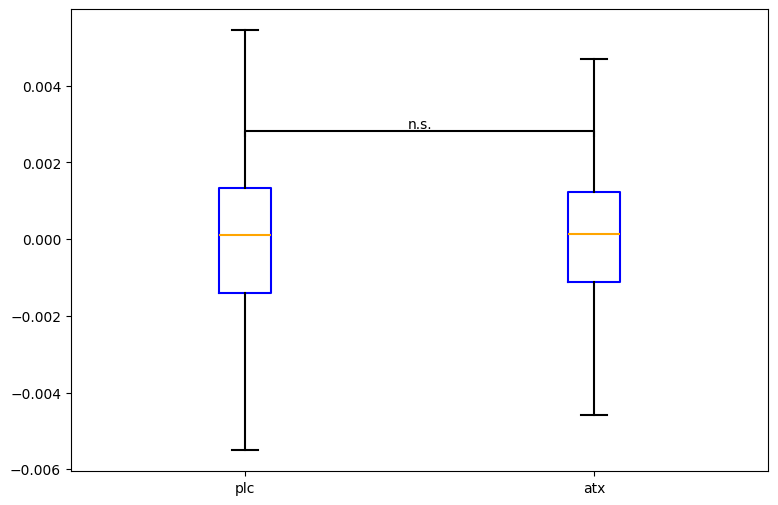

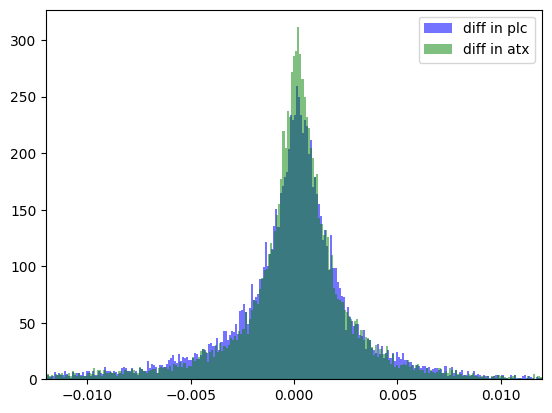

0.0013652759385470855
0.0011563091295509625
F test-- F-statistic: 0.936752020003905, p-value: 0.9999664010835061
F test-- F-statistic: 1.0675183812209248, p-value: 0.9999664010835061
Levene's test statistic in raw: 4.968857516327018, p-value: 0.025815114039799532
Brown-Forsythe test statistic in raw: 4.968857516327018, p-value: 0.025815114039799532
Levene's test statistic in logged: nan, p-value: nan
Brown-Forsythe test statistic in logged: nan, p-value: nan


c:\Users\jaket\anaconda3\envs\deco1\lib\site-packages\pandas\core\arraylike.py:402: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [112]:

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu


behavior = df
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

plc = behavior[behavior['drug'] == 'PLC']['stim_diff']
atx = behavior[behavior['drug'] == 'ATX']['stim_diff']

# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[plc, atx], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['plc', 'atx'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(plc, atx)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(plc, 75)

print(Q3_group1)
Q3_group2 = np.percentile(atx, 75)
print(Q3_group2)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of plc in diff (post-pre): " + str(np.mean(plc)))
print("mean of atx in diff (post-pre): " + str(np.mean(atx)))
print("median of plc in diff (post-pre): " + str(np.median(plc)))
print("median of atx in diff (post-pre): " + str(np.median(atx)))
print("std dev of plc in diff (post-pre): " + str(np.std(plc)))
print("std dev of atx in diff (post-pre): " + str(np.std(atx)))

plt.show()

plt.hist(plc, bins=1000, color='blue', alpha=0.55, label='diff in plc', density = True)
plt.hist(atx, bins=1000, color='green', alpha=0.5, label='diff in atx', density = True)
plt.xlim(-0.012, 0.012)  # Focus x-axis from 20 to 80
plt.legend()
plt.show()



###### significance testing
group1 = plc
group2 = atx


MAD1 = np.median(np.abs(group1 - np.median(group1)))

print(MAD1)

MAD2 = np.median(np.abs(group2 - np.median(group2)))

print(MAD2)

import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")



# 6/14

## trials

In [92]:
print(len(df))
print(len(df[df['drug']=='PLC']))
print(len(df[df['drug']=='DNP']))
print(len(df[df['drug']=='ATX']))

behavior = df

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)

print(len(behavior))
print(len(behavior[behavior['drug']=='PLC']))
print(len(behavior[behavior['drug']=='DNP']))
print(len(behavior[behavior['drug']=='ATX']))


44790
14658
14974
15158
44676
14623
14939
15114


## BIC 

In [101]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp
import statsmodels.api as sm
from sklearn.preprocessing import PolynomialFeatures

# Assuming df is loaded and contains the relevant data
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    threshold = dataframe[column].quantile(percentile)
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    return modified_dataframe

behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior['irrev'] = behavior['poststim_irrev']
cfg = {'n_bins': 5}  # Number of pupil bins

def run_model_bic(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1, 1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg], model.bic

def run_model_aic(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1, 1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg], model.aic


def process_behavior(behavior, drug):
    behavior = behavior[behavior['drug'] == drug]
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(
        lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()
    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means


df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

# Function to fit models and print BICs
def fit_and_print_bic(df, drug):
    bic_values = {}
    for deg in [1, 2]:  # Linear and Quadratic
        bic = df.groupby(['subject']).apply(lambda x: run_model_bic(x, deg, 'd')[1]).mean()
        bic_values[f'{deg}-degree'] = bic
        print(f"BIC for {deg}-degree model for {drug}: {bic}")
    return bic_values


def fit_and_print_aic(df, drug):
    aic_values = {}
    for deg in [1, 2]:  # Linear and Quadratic
        aic = df.groupby(['subject']).apply(lambda x: run_model_aic(x, deg, 'd')[1]).mean()
        aic_values[f'{deg}-degree'] = aic
        print(f"aic for {deg}-degree model for {drug}: {aic}")
    return aic_values

# Calculate BICs for each drug and model degree
bic_plc = fit_and_print_bic(df_subject_irreversibility_plc, 'PLC')
bic_dnp = fit_and_print_bic(df_subject_irreversibility_dnp, 'DNP')
bic_atx = fit_and_print_bic(df_subject_irreversibility_atx, 'ATX')


aic_plc = fit_and_print_aic(df_subject_irreversibility_plc, 'PLC')
aic_dnp = fit_and_print_aic(df_subject_irreversibility_dnp, 'DNP')
aic_atx = fit_and_print_aic(df_subject_irreversibility_atx, 'ATX')

C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2763913897.py:40: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2763913897.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'b

Drug: PLC
Bin means: irreversibility_bin
0    0.002047
1    0.002967
2    0.003767
3    0.004811
4    0.007770
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2763913897.py:40: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2763913897.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'b

Drug: DNP
Bin means: irreversibility_bin
0    0.002186
1    0.003153
2    0.003972
3    0.005033
4    0.007912
Name: irrev, dtype: float64


C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2763913897.py:40: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(
C:\Users\jaket\AppData\Local\Temp\ipykernel_12516\2763913897.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'b

Drug: ATX
Bin means: irreversibility_bin
0    0.001937
1    0.002792
2    0.003538
3    0.004502
4    0.007108
Name: irrev, dtype: float64
BIC for 1-degree model for PLC: -0.9110068442058529
BIC for 2-degree model for PLC: -4.384745724306577
BIC for 1-degree model for DNP: 1.314033805053916
BIC for 2-degree model for DNP: 0.18016600651935713
BIC for 1-degree model for ATX: 1.9934390805707427
BIC for 2-degree model for ATX: -0.17093820320307726
aic for 1-degree model for PLC: -0.1298826690740537
aic for 2-degree model for PLC: -3.2130594616088777
aic for 1-degree model for DNP: 2.095157980185715
aic for 2-degree model for DNP: 1.3518522692170563
aic for 1-degree model for ATX: 2.774563255702542
aic for 2-degree model for ATX: 1.0007480594946225


In [ ]:
def run_model_irrevbin(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1,1))
    model = sm.OLS(x[var], xp).fit()
    return model.params[deg]

def run_model_bic(x, deg, var):
    poly_feat = PolynomialFeatures(degree=deg)
    xp = poly_feat.fit_transform(x['irreversibility_bin'].to_numpy().reshape(-1, 1))
    model = sm.OLS(x[var], xp).fit()
    return model.bic

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe



# Placeholder functions for sdt and run_model_irrevbi
# Assuming df is already loaded and contains the relevant data
behavior = df
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]

behavior['irrev'] = df['log_poststim']
cfg = {'n_bins': 5}  # Number of pupil bins

def process_behavior(behavior, drug):
    behavior = behavior[(behavior['drug'] == drug)]
    
    behavior['irreversibility_bin'] = behavior.groupby(['subject', 'session', 'block'])['irrev'].apply(lambda x: pd.qcut(x, cfg['n_bins'], labels=range(cfg['n_bins']))).to_numpy()

    correct_counts = True
    df_sdt_irreversibility = behavior.groupby(['subject', 'drug', 'irreversibility_bin']).apply(lambda x: sdt(x, correct_counts))
    
    df_subject_irreversibility = df_sdt_irreversibility.groupby(['subject', 'irreversibility_bin']).mean()
    df_subject_irreversibility.reset_index(inplace=True)
    
    # Calculate the mean of each bin for x-axis labels
    bin_means = behavior.groupby('irreversibility_bin').mean()['irrev']
    print("Drug: " + drug)
    print("Bin means: " + str(bin_means))
    
    return df_subject_irreversibility, bin_means

# Process data for PLC
df_subject_irreversibility_plc, bin_means_plc = process_behavior(behavior, 'PLC')

# Process data for DNP
df_subject_irreversibility_dnp, bin_means_dnp = process_behavior(behavior, 'DNP')

# Process data for ATX
df_subject_irreversibility_atx, bin_means_atx = process_behavior(behavior, 'ATX')

total_bin_means = (bin_means_plc + bin_means_dnp + bin_means_atx) / 3

# Combine all data
df_combined = pd.concat([
    df_subject_irreversibility_plc.assign(drug='PLC', bin_mean=bin_means_plc[df_subject_irreversibility_plc['irreversibility_bin']].values),
    df_subject_irreversibility_dnp.assign(drug='DNP', bin_mean=bin_means_dnp[df_subject_irreversibility_dnp['irreversibility_bin']].values),
    df_subject_irreversibility_atx.assign(drug='ATX', bin_mean=bin_means_atx[df_subject_irreversibility_atx['irreversibility_bin']].values)
])

# Initialize variables to decide which model to plot
plot_linear_plc = False
plot_quadratic_plc = False
plot_linear_dnp = False
plot_quadratic_dnp = False
plot_linear_atx = False
plot_quadratic_atx = False

# Calculate betas for PLC
betas_first_irreversibility_plc = dict()
_, betas_first_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_plc = dict()
_, betas_second_irreversibility_plc['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_plc.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for DNP
betas_first_irreversibility_dnp = dict()
_, betas_first_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_dnp = dict()
_, betas_second_irreversibility_dnp['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_dnp.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Calculate betas for ATX
betas_first_irreversibility_atx = dict()
_, betas_first_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 1, 'd'), 0)

betas_second_irreversibility_atx = dict()
_, betas_second_irreversibility_atx['d'] = sp.stats.ttest_1samp(df_subject_irreversibility_atx.groupby(['subject']).apply(run_model_irrevbin, 2, 'd'), 0)

# Determine which model to plot for PLC based on the significance and smaller p-value
if betas_first_irreversibility_plc['d'] < 0.05 or betas_second_irreversibility_plc['d'] < 0.05:
    if betas_first_irreversibility_plc['d'] < betas_second_irreversibility_plc['d']:
        plot_linear_plc = True
    elif betas_second_irreversibility_plc['d'] < betas_first_irreversibility_plc['d']:
        plot_quadratic_plc = True

# Determine which model to plot for DNP based on the significance and smaller p-value
if betas_first_irreversibility_dnp['d'] < 0.05 or betas_second_irreversibility_dnp['d'] < 0.05:
    if betas_first_irreversibility_dnp['d'] < betas_second_irreversibility_dnp['d']:
        plot_linear_dnp = True
    elif betas_second_irreversibility_dnp['d'] < betas_first_irreversibility_dnp['d']:
        plot_quadratic_dnp = True

# Determine which model to plot for ATX based on the significance and smaller p-value
if betas_first_irreversibility_atx['d'] < 0.05 or betas_second_irreversibility_atx['d'] < 0.05:
    if betas_first_irreversibility_atx['d'] < betas_second_irreversibility_atx['d']:
        plot_linear_atx = True
    elif betas_second_irreversibility_atx['d'] < betas_first_irreversibility_atx['d']:
        plot_quadratic_atx = True

# Plotting results for d'
cm = 1 / 2.54  # Conversion factor to cm
fig, ax = plt.subplots(figsize=(16*cm, 14*cm))

# PLC data
ym_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').mean()['d']
yerr_plc = df_subject_irreversibility_plc.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_plc, ym_plc, yerr=yerr_plc, capsize=0, ls='None', marker='o', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='b', label='PLC')

# DNP data
ym_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').mean()['d']
yerr_dnp = df_subject_irreversibility_dnp.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_dnp, ym_dnp, yerr=yerr_dnp, capsize=0, ls='None', marker='s', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='r', label='DNP')

# ATX data
ym_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').mean()['d']
yerr_atx = df_subject_irreversibility_atx.groupby('irreversibility_bin').sem()['d']
ax.errorbar(bin_means_atx, ym_atx, yerr=yerr_atx, capsize=0, ls='None', marker='^', alpha=1, zorder=1000, ms=10, mew=1, elinewidth=1, markeredgecolor='g', label='ATX')

# Plot linear/quadratic fit for each drug
def plot_fit(ax, df, color, linestyle, order):
    sns.regplot(ax=ax, data=df, x="bin_mean", y="d", scatter=False, color=color,
                line_kws={'linestyle': linestyle, 'lw': 1}, order=order, ci=68)

# Optionally add model fits if linear/quadratic fit was significant for PLC
if plot_linear_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 1)
if plot_quadratic_plc:
    plot_fit(ax, df_combined[df_combined['drug'] == 'PLC'], 'b', '-', 2)

# Optionally add model fits if linear/quadratic fit was significant for DNP
if plot_linear_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 1)
if plot_quadratic_dnp:
    plot_fit(ax, df_combined[df_combined['drug'] == 'DNP'], 'r', '--', 2)

# Optionally add model fits if linear/quadratic fit was significant for ATX
if plot_linear_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 1)
if plot_quadratic_atx:
    plot_fit(ax, df_combined[df_combined['drug'] == 'ATX'], 'g', ':', 2)

# Plot p-values for the polynomial regression significance
ax.text(0.5, 0.01, '/ PLC {}\n∩ PLC {}'.format(p_val_string(betas_first_irreversibility_plc['d']),
                                               p_val_string(betas_second_irreversibility_plc['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='b')

ax.text(0.5, 0.06, '/ DNP {}\n∩ DNP {}'.format(p_val_string(betas_first_irreversibility_dnp['d']),
                                               p_val_string(betas_second_irreversibility_dnp['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='r')

ax.text(0.5, 0.11, '/ ATX {}\n∩ ATX {}'.format(p_val_string(betas_first_irreversibility_atx['d']),
                                               p_val_string(betas_second_irreversibility_atx['d'])), ha='center', va='bottom', transform=ax.transAxes, size=8, color='g')

sns.despine(ax=ax, offset=1, trim=True)

# Setting labels and titles
ax.set_ylabel('Perceptual sensitivity (d\')')
ax.set_xlabel('Logged Poststim Irrev')

labels = []
for i in range(cfg['n_bins']):
    labels.append(f"{total_bin_means[i]:.2f}")

ax.set_xticks(total_bin_means)
ax.set_xticklabels(labels, rotation=45)
ax.tick_params(axis='both', which='major', labelsize=7, length=3)

ax.legend()
fig.tight_layout()
plt.show()



## prestim to poststim variability

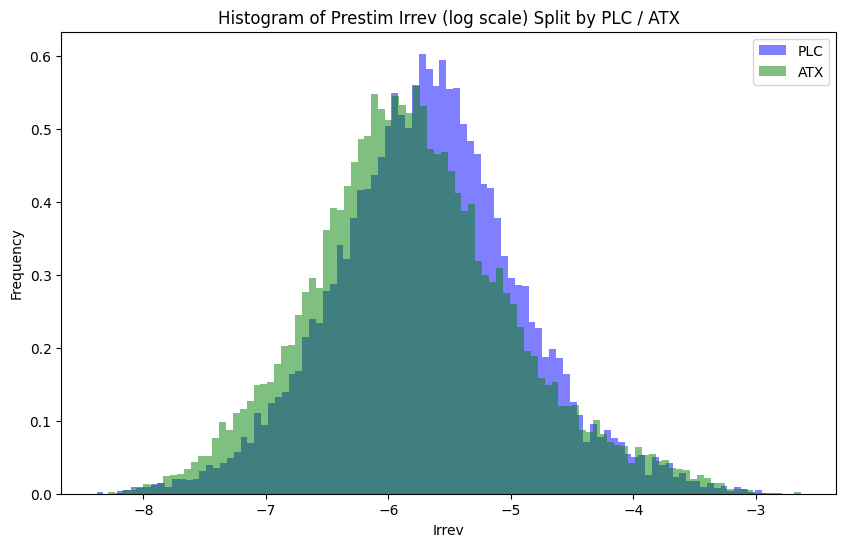

122350361.0
1.1915327563189325e-57
Mean PLC pre: 0.0046845156254632404
Mean ATX pre: 0.004396297931074815
The std dev of the PLC Pre values in the pretty histogram (logged irrev values): 0.767477885699712
The std dev of the ATX Pre values in the pretty histogram (logged irrev values): 0.8262215254752776
The std dev of the PLC values of raw: 0.004612988128301725
The std dev of the ATX values of raw: 0.0049424834994251


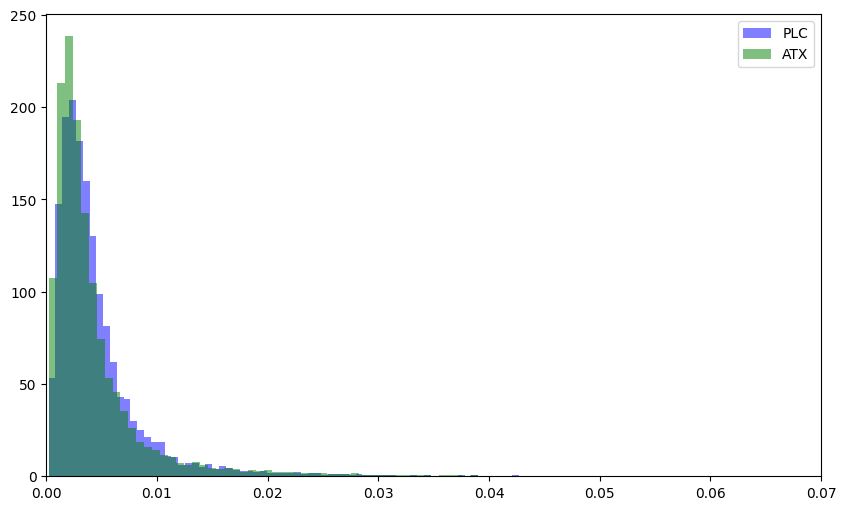

F test-- F-statistic: 0.8711143792703153, p-value: 0.9999999999999999
F test-- F-statistic: 1.147954876875807, p-value: 0.9999999999999999
Levene's test statistic in raw: 0.8912515780448718, p-value: 0.34514603790217413
Brown-Forsythe test statistic in raw: 0.8912515780448718, p-value: 0.34514603790217413
Levene's test statistic in logged: 64.4994650787225, p-value: 1.0009825229068269e-15
Brown-Forsythe test statistic in logged: 64.4994650787225, p-value: 1.0009825229068269e-15


In [103]:

behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior[behavior['drug']=='PLC']['prestim_irrev']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='PLC', color='blue', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior[behavior['drug']=='ATX']['prestim_irrev']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='ATX', color='green', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestim Irrev (log scale) Split by PLC / ATX')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean PLC pre: "+str(np.mean(correct_irrev)))
print("Mean ATX pre: "+str(np.mean(incorrect_irrev)))
print("The std dev of the PLC Pre values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the ATX Pre values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the PLC values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the ATX values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = correct_irrev
group2 = incorrect_irrev

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='PLC', color='blue', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='ATX', color='green', density = True)
plt.legend()
plt.xlim(0,0.07)
plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")




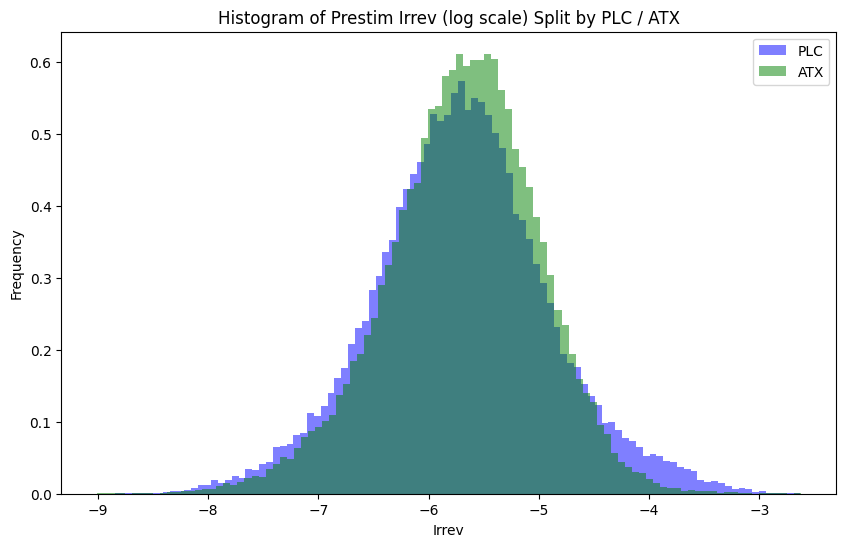

974507605.0
1.1527921586675097e-09
Mean PLC pre: 0.00466224965733712
Mean ATX pre: 0.004231674096485145
The std dev of the PLC Pre values in the pretty histogram (logged irrev values): 0.8007345264286434
The std dev of the ATX Pre values in the pretty histogram (logged irrev values): 0.6890311072982035
The std dev of the PLC values of raw: 0.004784591283637563
The std dev of the ATX values of raw: 0.0032084029633615307


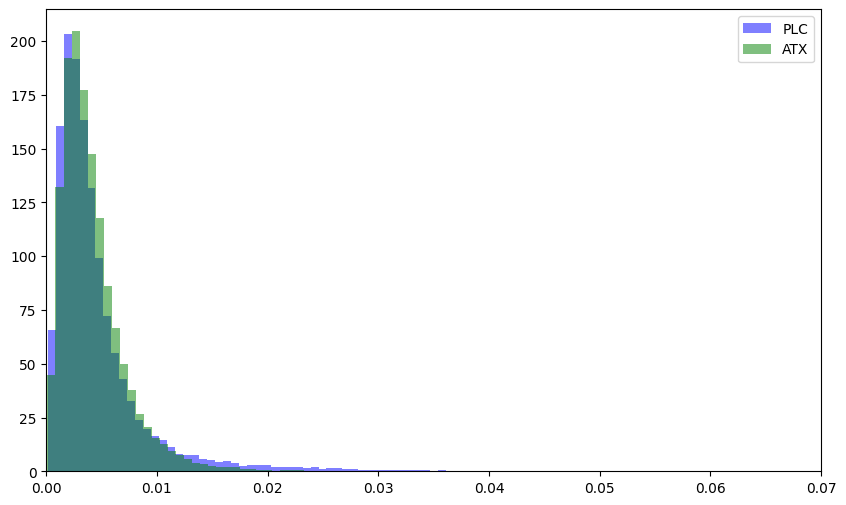

F test-- F-statistic: 2.2238826771254514, p-value: 0.9999999999999999
F test-- F-statistic: 0.4496640089362003, p-value: 0.9999999999999999
Levene's test statistic in raw: 656.6132522232642, p-value: 2.715233140027097e-144
Brown-Forsythe test statistic in raw: 656.6132522232642, p-value: 2.715233140027097e-144
Levene's test statistic in logged: 666.5192081030372, p-value: 1.9740041078989597e-146
Brown-Forsythe test statistic in logged: 666.5192081030372, p-value: 1.9740041078989597e-146


In [104]:

behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)

# Setting up the figure and axes
plt.figure(figsize=(10, 6))

# Histogram for RT when correct is 0
correct_irrev = behavior['prestim_irrev']
plt.hist(np.log(correct_irrev), bins=100, alpha=0.5, label='PLC', color='blue', density = True)

# Histogram for RT when correct is 1
incorrect_irrev = behavior['poststim_irrev']
plt.hist(np.log(incorrect_irrev), bins=100, alpha=0.5, label='ATX', color='green', density = True)

# Adding labels and title
plt.xlabel('Irrev')
plt.ylabel('Frequency')
plt.title('Histogram of Prestim Irrev (log scale) Split by PLC / ATX')
plt.legend()

# Show the plot
plt.show()

from scipy import stats

t_stat, p_value = stats.mannwhitneyu(correct_irrev, incorrect_irrev)

print(t_stat)
print(p_value)

print("Mean PLC pre: "+str(np.mean(correct_irrev)))
print("Mean ATX pre: "+str(np.mean(incorrect_irrev)))
print("The std dev of the PLC Pre values in the pretty histogram (logged irrev values): "+str(np.std(np.log(correct_irrev))))
print("The std dev of the ATX Pre values in the pretty histogram (logged irrev values): "+str(np.std(np.log(incorrect_irrev))))
print("The std dev of the PLC values of raw: "+str(np.std(correct_irrev)))
print("The std dev of the ATX values of raw: "+str(np.std(incorrect_irrev)))



###### significance testing
group1 = correct_irrev
group2 = incorrect_irrev

plt.figure(figsize=(10, 6))

plt.hist(group1, bins=100, alpha=0.5, label='PLC', color='blue', density = True)
plt.hist(group2, bins=100, alpha=0.5, label='ATX', color='green', density = True)
plt.legend()
plt.xlim(0,0.07)
plt.show()


import scipy.stats as stats
##############
# F test, if the p-value is small, this suggests that the two groups have significantly different variances.
# Calculate variances
var1 = np.var(group1, ddof=1)
var2 = np.var(group2, ddof=1)

F = var1 / var2
df1 = len(group1) - 1
df2 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

var2 = np.var(group1, ddof=1)
var1 = np.var(group2, ddof=1)

F = var1 / var2
df2 = len(group1) - 1
df1 = len(group2) - 1
p_value = stats.f.cdf(F, df1, df2) if var1 >= var2 else stats.f.cdf(1/F, df2, df1)

print(f"F test-- F-statistic: {F}, p-value: {p_value}")

##############
# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(group1, group2)

print(f"Levene's test statistic in raw: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(group1, group2, center='median')

print(f"Brown-Forsythe test statistic in raw: {stat}, p-value: {p_value}")

# Levine's test-- More robust to non-normal distributions. It tests the null hypothesis that the variances are equal across groups.
stat, p_value = stats.levene(np.log(group1), np.log(group2))

print(f"Levene's test statistic in logged: {stat}, p-value: {p_value}")

# Brown-Forsythe Test -- variation of Levene's test that is more robust against deviations from normality. It uses the medians instead of the means.
stat, p_value = stats.levene(np.log(group1), np.log(group2), center='median')

print(f"Brown-Forsythe test statistic in logged: {stat}, p-value: {p_value}")




## boxplot drugs for results section

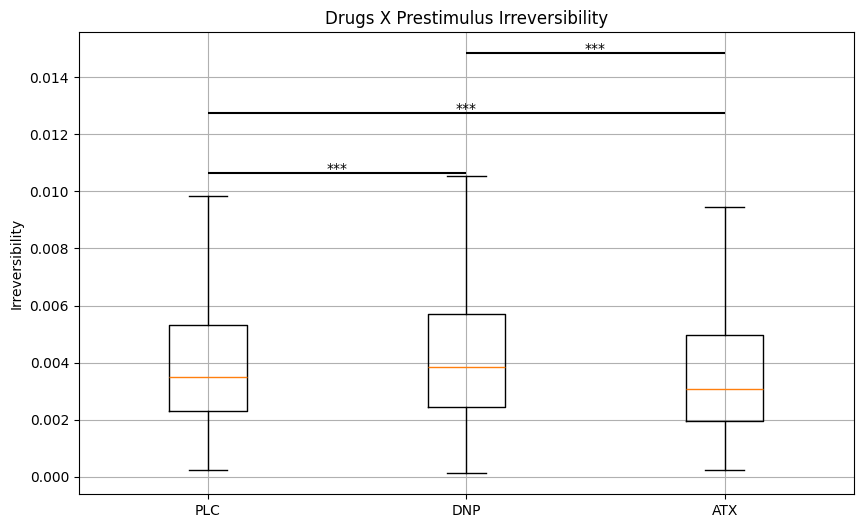

The std dev of PLC 0.003130632770668866
The std dev of DNP 0.0032094304538556784
The std dev of ATX 0.003263203894319235
The mean dev of PLC 0.004272075073922203
The mean dev of DNP 0.0044519243343410664
The mean dev of ATX 0.0039747568555572755


In [110]:

import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Use the function


behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)

irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(behavior[behavior['drug'] == drug]['poststim_irrev'])

# Creating the boxplot with improved clarity
plt.figure(figsize=(10, 6))
box = plt.boxplot(irrev_sub_plc, positions=np.arange(len(drugs)), showfliers=False)
plt.xticks(np.arange(len(drugs)), drugs)
plt.ylabel('Irreversibility')
plt.title('Drugs X Prestimulus Irreversibility')
plt.grid(True)


# Mann-Whitney U tests across drugs with corrections

p_values = []
comparisons = []

for i in range(len(irrev_sub_plc)):
    for j in range(i + 1, len(irrev_sub_plc)):
        stat, p = stats.mannwhitneyu(irrev_sub_plc[i], irrev_sub_plc[j], alternative='two-sided')
        p_values.append(p)
        comparisons.append((drugs[i], drugs[j]))

corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]

# Annotating significant differences
max_y = max([item.get_data()[1].max() for item in box['caps']])  # Find the maximum y-value of the whiskers
y_offset = max_y * 0.1  # Slightly above the highest whisker
for i, (comp, corrected_p_val) in enumerate(zip(comparisons, corrected_p_values)):
    x1, x2 = drugs.index(comp[0]), drugs.index(comp[1])
    # Decide number of asterisks based on significance level
    if corrected_p_val < 0.0001:
        num_asterisks = '***'
    elif corrected_p_val < 0.01:
        num_asterisks = '**'
    elif corrected_p_val < 0.05:
        num_asterisks = '*'
    else:
        num_asterisks = ''

    if num_asterisks:  # Only draw if there's a significant result
        plt.hlines((max_y+max_y*0.01) + y_offset * i * 2, x1, x2, color="black")
        plt.text((x1 + x2) / 2, max_y + y_offset * (i * 2), num_asterisks, ha='center', va='bottom', color='black')

plt.show()

print("The std dev of PLC "+str(np.std(irrev_sub_plc[0])))
print("The std dev of DNP "+str(np.std(irrev_sub_plc[1])))
print("The std dev of ATX "+str(np.std(irrev_sub_plc[2])))
print("The mean dev of PLC "+str(np.mean(irrev_sub_plc[0])))
print("The mean dev of DNP "+str(np.mean(irrev_sub_plc[1])))
print("The mean dev of ATX "+str(np.mean(irrev_sub_plc[2])))


Comparison PLC vs DNP: Rank-biserial correlation r = 0.058
Comparison PLC vs ATX: Rank-biserial correlation r = 0.100
Comparison DNP vs ATX: Rank-biserial correlation r = 0.151


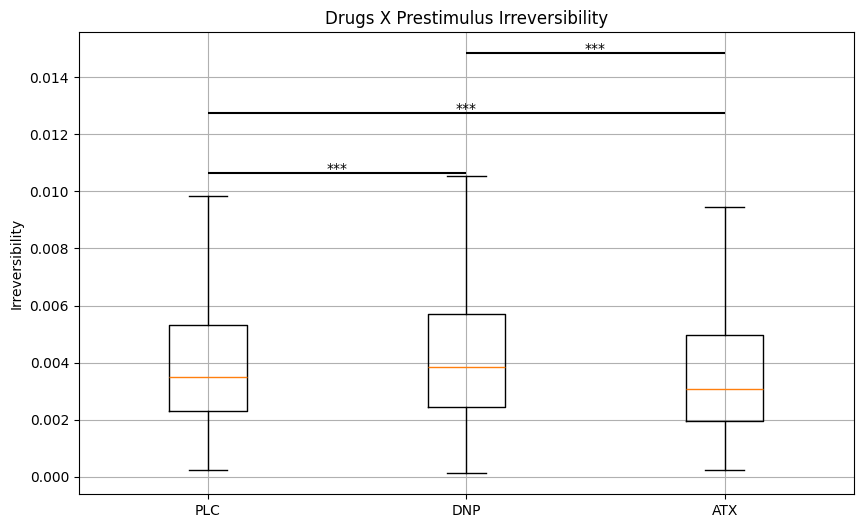

The std dev of PLC 0.003130632770668866
The std dev of DNP 0.0032094304538556784
The std dev of ATX 0.003263203894319235
The mean dev of PLC 0.004272075073922203
The mean dev of DNP 0.0044519243343410664
The mean dev of ATX 0.0039747568555572755


In [4]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined in your environment.
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Pre-processing steps
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)

irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(behavior[behavior['drug'] == drug]['poststim_irrev'])

# Creating the boxplot
plt.figure(figsize=(10, 6))
box = plt.boxplot(irrev_sub_plc, positions=np.arange(len(drugs)), showfliers=False)
plt.xticks(np.arange(len(drugs)), drugs)
plt.ylabel('Irreversibility')
plt.title('Drugs X Prestimulus Irreversibility')
plt.grid(True)

# Mann-Whitney U tests and effect size calculations
p_values = []
comparisons = []
effect_sizes = []

for i in range(len(irrev_sub_plc)):
    for j in range(i + 1, len(irrev_sub_plc)):
        stat, p = stats.mannwhitneyu(irrev_sub_plc[i], irrev_sub_plc[j], alternative='two-sided')
        p_values.append(p)
        comparisons.append((drugs[i], drugs[j]))
        # Calculate the effect size
        n1, n2 = len(irrev_sub_plc[i]), len(irrev_sub_plc[j])
        U = min(stat, n1*n2 - stat)
        r = 1 - (2 * U) / (n1 * n2)
        effect_sizes.append(r)

corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]

# Annotating significant differences
max_y = max([item.get_data()[1].max() for item in box['caps']])  # Find the maximum y-value of the whiskers
y_offset = max_y * 0.1  # Slightly above the highest whisker
for i, ((comp, corrected_p_val), r) in enumerate(zip(zip(comparisons, corrected_p_values), effect_sizes)):
    x1, x2 = drugs.index(comp[0]), drugs.index(comp[1])
    # Decide number of asterisks based on significance level
    if corrected_p_val < 0.0001:
        num_asterisks = '***'
    elif corrected_p_val < 0.01:
        num_asterisks = '**'
    elif corrected_p_val < 0.05:
        num_asterisks = '*'
    else:
        num_asterisks = ''

    if num_asterisks:  # Only draw if there's a significant result
        plt.hlines((max_y+max_y*0.01) + y_offset * i * 2, x1, x2, color="black")
        plt.text((x1 + x2) / 2, max_y + y_offset * (i * 2), num_asterisks, ha='center', va='bottom', color='black')

    print(f"Comparison {comp[0]} vs {comp[1]}: Rank-biserial correlation r = {r:.3f}")

plt.show()

print("The std dev of PLC "+str(np.std(irrev_sub_plc[0])))
print("The std dev of DNP "+str(np.std(irrev_sub_plc[1])))
print("The std dev of ATX "+str(np.std(irrev_sub_plc[2])))
print("The mean dev of PLC "+str(np.mean(irrev_sub_plc[0])))
print("The mean dev of DNP "+str(np.mean(irrev_sub_plc[1])))
print("The mean dev of ATX "+str(np.mean(irrev_sub_plc[2])))


Comparison PLC vs DNP: Cohen's d = -0.057
Comparison PLC vs ATX: Cohen's d = 0.093
Comparison DNP vs ATX: Cohen's d = 0.147


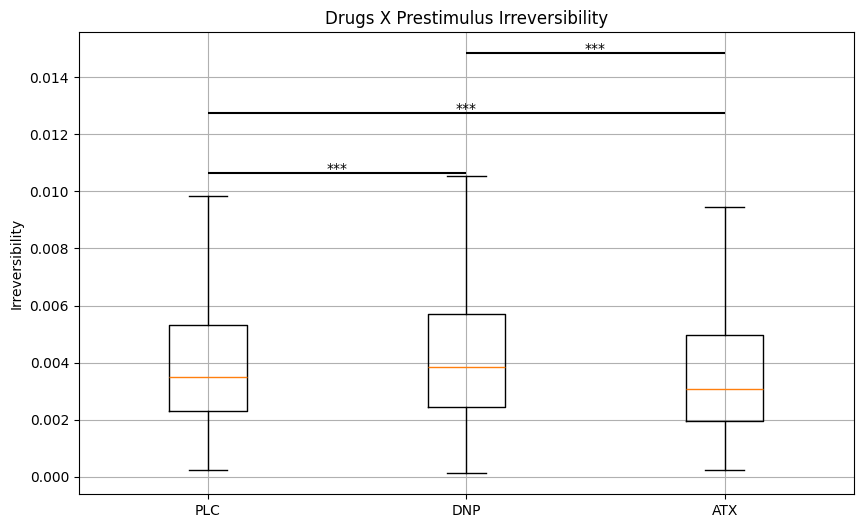

The std dev of PLC 0.003130632770668866
The std dev of DNP 0.0032094304538556784
The std dev of ATX 0.003263203894319235
The mean dev of PLC 0.004272075073922203
The mean dev of DNP 0.0044519243343410664
The mean dev of ATX 0.0039747568555572755


In [5]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Pre-processing steps
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)

irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(np,log(behavior[behavior['drug'] == drug]['poststim_irrev']))

# Creating the boxplot
plt.figure(figsize=(10, 6))
box = plt.boxplot(irrev_sub_plc, positions=np.arange(len(drugs)), showfliers=False)
plt.xticks(np.arange(len(drugs)), drugs)
plt.ylabel('Irreversibility')
plt.title('Drugs X Poststimulus Irreversibility')
plt.grid(True)

# Mann-Whitney U tests, Cohen's d calculations
p_values = []
comparisons = []
effect_sizes = []

def pooled_std(n1, s1, n2, s2):
    return np.sqrt(((n1 - 1) * s1**2 + (n2 - 1) * s2**2) / (n1 + n2 - 2))

for i in range(len(irrev_sub_plc)):
    for j in range(i + 1, len(irrev_sub_plc)):
        stat, p = stats.mannwhitneyu(irrev_sub_plc[i], irrev_sub_plc[j], alternative='two-sided')
        p_values.append(p)
        comparisons.append((drugs[i], drugs[j]))
        # Calculate Cohen's d
        mean1, mean2 = np.mean(irrev_sub_plc[i]), np.mean(irrev_sub_plc[j])
        s1, s2 = np.std(irrev_sub_plc[i], ddof=1), np.std(irrev_sub_plc[j], ddof=1)
        n1, n2 = len(irrev_sub_plc[i]), len(irrev_sub_plc[j])
        pooled_sd = pooled_std(n1, s1, n2, s2)
        d = (mean1 - mean2) / pooled_sd
        effect_sizes.append(d)

corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]

# Annotating significant differences
max_y = max([item.get_data()[1].max() for item in box['caps']])
y_offset = max_y * 0.1
for i, ((comp, corrected_p_val), d) in enumerate(zip(zip(comparisons, corrected_p_values), effect_sizes)):
    x1, x2 = drugs.index(comp[0]), drugs.index(comp[1])
    # Significance level annotation
    if corrected_p_val < 0.0001:
        num_asterisks = '***'
    elif corrected_p_val < 0.01:
        num_asterisks = '**'
    elif corrected_p_val < 0.05:
        num_asterisks = '*'
    else:
        num_asterisks = ''

    if num_asterisks:  # Only draw if significant
        plt.hlines((max_y+max_y*0.01) + y_offset * i * 2, x1, x2, color="black")
        plt.text((x1 + x2) / 2, max_y + y_offset * (i * 2), num_asterisks, ha='center', va='bottom', color='black')

    print(f"Comparison {comp[0]} vs {comp[1]}: Cohen's d = {d:.3f}")

plt.show()

print("The std dev of PLC "+str(np.std(irrev_sub_plc[0])))
print("The std dev of DNP "+str(np.std(irrev_sub_plc[1])))
print("The std dev of ATX "+str(np.std(irrev_sub_plc[2])))
print("The mean dev of PLC "+str(np.mean(irrev_sub_plc[0])))
print("The mean dev of DNP "+str(np.mean(irrev_sub_plc[1])))
print("The mean dev of ATX "+str(np.mean(irrev_sub_plc[2])))


Comparison PLC vs DNP: Cohen's d = -0.055
Comparison PLC vs ATX: Cohen's d = 0.166
Comparison DNP vs ATX: Cohen's d = 0.215


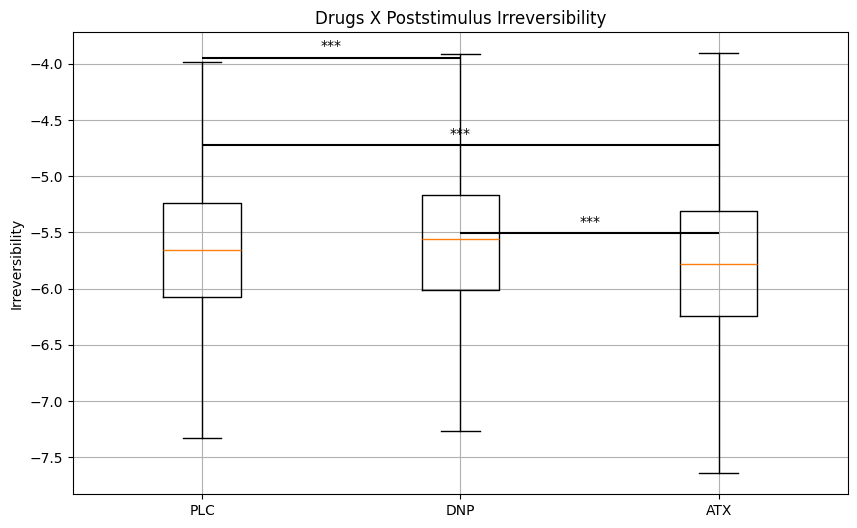

The std dev of PLC 0.6560779188680866
The std dev of DNP 0.6905253562026498
The std dev of ATX 0.709514082013842
The mean dev of PLC -5.666476271164493
The mean dev of DNP -5.629610659068547
The mean dev of ATX -5.779800572447096


In [12]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Pre-processing steps
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)

irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(np.log(behavior[behavior['drug'] == drug]['poststim_irrev']))

# Creating the boxplot
plt.figure(figsize=(10, 6))
box = plt.boxplot(irrev_sub_plc, positions=np.arange(len(drugs)), showfliers=False)
plt.xticks(np.arange(len(drugs)), drugs)
plt.ylabel('Irreversibility')
plt.title('Drugs X Poststimulus Irreversibility')
plt.grid(True)

# Mann-Whitney U tests, Cohen's d calculations
p_values = []
comparisons = []
effect_sizes = []

def pooled_std(n1, s1, n2, s2):
    return np.sqrt(((n1 - 1) * s1**2 + (n2 - 1) * s2**2) / (n1 + n2 - 2))

for i in range(len(irrev_sub_plc)):
    for j in range(i + 1, len(irrev_sub_plc)):
        stat, p = stats.mannwhitneyu(irrev_sub_plc[i], irrev_sub_plc[j], alternative='two-sided')
        p_values.append(p)
        comparisons.append((drugs[i], drugs[j]))
        # Calculate Cohen's d
        mean1, mean2 = np.mean(irrev_sub_plc[i]), np.mean(irrev_sub_plc[j])
        s1, s2 = np.std(irrev_sub_plc[i], ddof=1), np.std(irrev_sub_plc[j], ddof=1)
        n1, n2 = len(irrev_sub_plc[i]), len(irrev_sub_plc[j])
        pooled_sd = pooled_std(n1, s1, n2, s2)
        d = (mean1 - mean2) / pooled_sd
        effect_sizes.append(d)

corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]

# Annotating significant differences
max_y = max([item.get_data()[1].max() for item in box['caps']])
y_offset = max_y * 0.1
for i, ((comp, corrected_p_val), d) in enumerate(zip(zip(comparisons, corrected_p_values), effect_sizes)):
    x1, x2 = drugs.index(comp[0]), drugs.index(comp[1])
    # Significance level annotation
    if corrected_p_val < 0.0001:
        num_asterisks = '***'
    elif corrected_p_val < 0.01:
        num_asterisks = '**'
    elif corrected_p_val < 0.05:
        num_asterisks = '*'
    else:
        num_asterisks = ''

    if num_asterisks:  # Only draw if significant
        plt.hlines((max_y+max_y*0.01) + y_offset * i * 2, x1, x2, color="black")
        plt.text((x1 + x2) / 2, max_y + y_offset * (i * 2), num_asterisks, ha='center', va='bottom', color='black')

    print(f"Comparison {comp[0]} vs {comp[1]}: Cohen's d = {d:.3f}")

plt.show()

print("The std dev of PLC "+str(np.std(irrev_sub_plc[0])))
print("The std dev of DNP "+str(np.std(irrev_sub_plc[1])))
print("The std dev of ATX "+str(np.std(irrev_sub_plc[2])))
print("The mean dev of PLC "+str(np.mean(irrev_sub_plc[0])))
print("The mean dev of DNP "+str(np.mean(irrev_sub_plc[1])))
print("The mean dev of ATX "+str(np.mean(irrev_sub_plc[2])))


Comparison PLC vs DNP: Cohen's d = -0.048
Comparison PLC vs ATX: Cohen's d = 0.061
Comparison DNP vs ATX: Cohen's d = 0.106


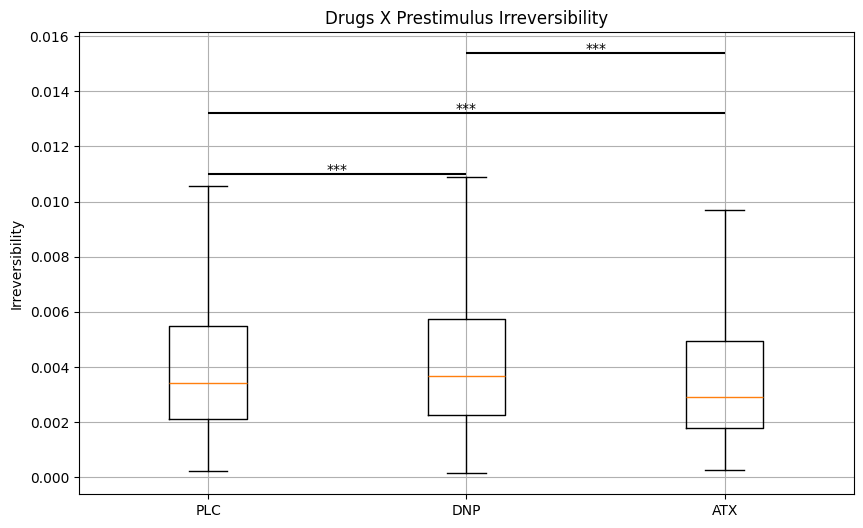

The std dev of PLC 0.004612988128301725
The std dev of DNP 0.0047730833312391715
The std dev of ATX 0.004938858035503934
The mean dev of PLC 0.0046845156254632404
The mean dev of DNP 0.004909532544174033
The mean dev of ATX 0.004394724010077953


In [11]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from statsmodels.stats.multitest import multipletests

# Assuming 'behavior' and 'prestimulus_rawdata_irrev_array' are defined as in your environment.
behavior = df

def remove_top_percentile(dataframe, column, percentile):
    # Calculate the threshold for the specified top percentile
    threshold = dataframe[column].quantile(percentile)
    
    # Set values above the threshold to NaN
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    
    return modified_dataframe

# Pre-processing steps
behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)

irrev_sub_plc = []
drugs = ['PLC', 'DNP', 'ATX']

for drug in drugs:
    irrev_sub_plc.append(behavior[behavior['drug'] == drug]['prestim_irrev'])

# Creating the boxplot
plt.figure(figsize=(10, 6))
box = plt.boxplot(irrev_sub_plc, positions=np.arange(len(drugs)), showfliers=False)
plt.xticks(np.arange(len(drugs)), drugs)
plt.ylabel('Irreversibility')
plt.title('Drugs X Prestimulus Irreversibility')
plt.grid(True)

# Mann-Whitney U tests, Cohen's d calculations
p_values = []
comparisons = []
effect_sizes = []

def pooled_std(n1, s1, n2, s2):
    return np.sqrt(((n1 - 1) * s1**2 + (n2 - 1) * s2**2) / (n1 + n2 - 2))

for i in range(len(irrev_sub_plc)):
    for j in range(i + 1, len(irrev_sub_plc)):
        stat, p = stats.mannwhitneyu(irrev_sub_plc[i], irrev_sub_plc[j], alternative='two-sided')
        p_values.append(p)
        comparisons.append((drugs[i], drugs[j]))
        # Calculate Cohen's d
        mean1, mean2 = np.mean(irrev_sub_plc[i]), np.mean(irrev_sub_plc[j])
        s1, s2 = np.std(irrev_sub_plc[i], ddof=1), np.std(irrev_sub_plc[j], ddof=1)
        n1, n2 = len(irrev_sub_plc[i]), len(irrev_sub_plc[j])
        pooled_sd = pooled_std(n1, s1, n2, s2)
        d = (mean1 - mean2) / pooled_sd
        effect_sizes.append(d)

corrected_p_values = multipletests(p_values, alpha=0.05, method='bonferroni')[1]

# Annotating significant differences
max_y = max([item.get_data()[1].max() for item in box['caps']])
y_offset = max_y * 0.1
for i, ((comp, corrected_p_val), d) in enumerate(zip(zip(comparisons, corrected_p_values), effect_sizes)):
    x1, x2 = drugs.index(comp[0]), drugs.index(comp[1])
    # Significance level annotation
    if corrected_p_val < 0.0001:
        num_asterisks = '***'
    elif corrected_p_val < 0.01:
        num_asterisks = '**'
    elif corrected_p_val < 0.05:
        num_asterisks = '*'
    else:
        num_asterisks = ''

    if num_asterisks:  # Only draw if significant
        plt.hlines((max_y+max_y*0.01) + y_offset * i * 2, x1, x2, color="black")
        plt.text((x1 + x2) / 2, max_y + y_offset * (i * 2), num_asterisks, ha='center', va='bottom', color='black')

    print(f"Comparison {comp[0]} vs {comp[1]}: Cohen's d = {d:.3f}")

plt.show()

print("The std dev of PLC "+str(np.std(irrev_sub_plc[0])))
print("The std dev of DNP "+str(np.std(irrev_sub_plc[1])))
print("The std dev of ATX "+str(np.std(irrev_sub_plc[2])))
print("The mean dev of PLC "+str(np.mean(irrev_sub_plc[0])))
print("The mean dev of DNP "+str(np.mean(irrev_sub_plc[1])))
print("The mean dev of ATX "+str(np.mean(irrev_sub_plc[2])))


# 6/18

## alpha in cued and uncued

44681
['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']
left cue associated alpha during left cue (expect higher): 2.351991021778398e-05
other hemisphere alpha in same (expect lower): 1.6359480690230378e-05
right cue associated alpha during right cue (expect higher): 1.6123052839126857e-05
other hemisphere alpha in same (expect lower): 2.546496490404697e-05
Statistic: 975355191.0, P-value: 3.1464655505574114e-09
mean of CUED: 1.984093343736507e-05
mean of UNCUED: 2.088827762144602e-05
median of CUED: 4.20207999070529e-06
median of UNCUED: 4.532822293803184e-06
Cohen's d: -0.020
Cohen's d (logged): -0.038


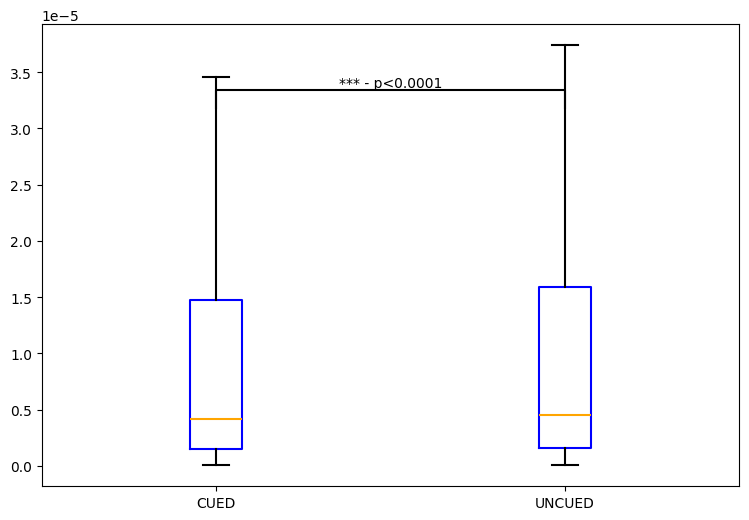

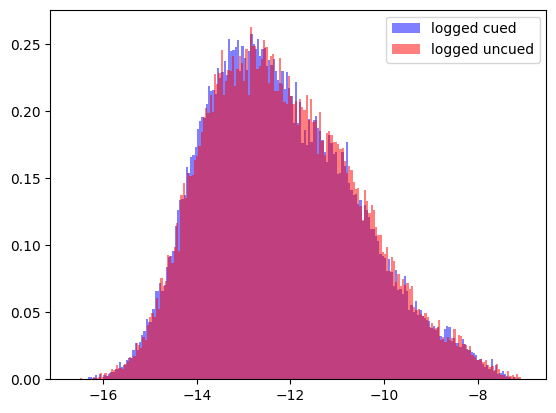

In [19]:


import pandas as pd
import numpy as np
from scipy.stats import rankdata
from statsmodels.formula.api import ols
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore

behavior = df
behavior['prestim_channel_alpha'] = [prestim_channel_alpha[i] for i in range(prestim_channel_alpha.shape[0])]

def remove_top_percentile(dataframe, column, percentile):
    threshold = dataframe[column].quantile(percentile)
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    return modified_dataframe

behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
print(len(behavior))


left_cue_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left cue
right_cue_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right cue
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_cue_indices = [channels.index(elec) for elec in left_cue_ROI if elec in channels]
right_cue_indices = [channels.index(elec) for elec in right_cue_ROI if elec in channels]

left_cue_alpha = []
contribution_arr = []
for matrix in behavior['prestim_channel_alpha']:
    left_cue_trial = np.mean(matrix[left_cue_indices])
    left_cue_alpha.append(left_cue_trial)
behavior['left_cue_alpha'] = left_cue_alpha # RIGHT HEMISPHERE

right_cue_alpha = []
for matrix in behavior['prestim_channel_alpha']:
    right_cue_trial = np.mean(matrix[right_cue_indices])
    right_cue_alpha.append(right_cue_trial)
behavior['right_cue_alpha'] = right_cue_alpha  # LEFT HEMISPHERE

print("left cue associated alpha during left cue (expect higher): " + str(np.mean(behavior[behavior['cue'] == 0]['left_cue_alpha'])))
print("other hemisphere alpha in same (expect lower): " + str(np.mean(behavior[behavior['cue'] == 0]['right_cue_alpha'])))
print("right cue associated alpha during right cue (expect higher): " + str(np.mean(behavior[behavior['cue'] == 1]['right_cue_alpha'])))
print("other hemisphere alpha in same (expect lower): " + str(np.mean(behavior[behavior['cue'] == 1]['left_cue_alpha'])))




import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu

#drug = 'ATX'
#drug_df = behavior[behavior['drug'] == drug]
#behavior = behavior[behavior['drug'] == 'PLC']

cued_right = behavior[behavior['cue'] == 1]['right_cue_alpha']
cued_left = behavior[behavior['cue'] == 0]['left_cue_alpha']
pre = post = np.concatenate((cued_right, cued_left))#CUED

uncued_right = behavior[behavior['cue'] == 0]['right_cue_alpha']
uncued_left = behavior[behavior['cue'] == 1]['left_cue_alpha']
post = np.concatenate((uncued_right, uncued_left)) #UNCUED


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['CUED', 'UNCUED'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(pre, post)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of CUED: " + str(np.mean(pre)))
print("mean of UNCUED: " + str(np.mean(post)))
print("median of CUED: " + str(np.median(pre)))
print("median of UNCUED: " + str(np.median(post)))

def cohens_d(group1, group2):
    # Calculate means and standard deviations
    mean1, mean2 = np.mean(group1), np.mean(group2)
    std1, std2 = np.std(group1, ddof=1), np.std(group2, ddof=1)
    # Calculate pooled standard deviation
    n1, n2 = len(group1), len(group2)
    pooled_std = np.sqrt(((n1 - 1) * std1 ** 2 + (n2 - 1) * std2 ** 2) / (n1 + n2 - 2))
    # Calculate Cohen's d
    d = (mean1 - mean2) / pooled_std
    return d

d_value = cohens_d(pre, post)
print(f"Cohen's d: {d_value:.3f}")

d_value1 = cohens_d(np.log(pre), np.log(post))
print(f"Cohen's d (logged): {d_value1:.3f}")

plt.show()

plt.hist(np.log(pre), bins=200, color='blue', alpha=0.5, label='logged cued', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.5, label='logged uncued', density = True)
plt.legend()
plt.show()
#Well shit.

### irrev cued / uncued

44681
['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1', 'Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'Fp2', 'AF8', 'AF4', 'AFz', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'FCz', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']
left cue associated irrev during left cue (expect higher): 0.013983329334369224
other hemisphere irrev in same (expect lower): 0.013204503262858274
Statistic: 992948397.0, P-value: 0.1735317302798447
mean of CUED: 0.013485737512166605
mean of UNCUED: 0.013660808784619269
median of CUED: 0.006634512421995339
median of UNCUED: 0.006681516270862634


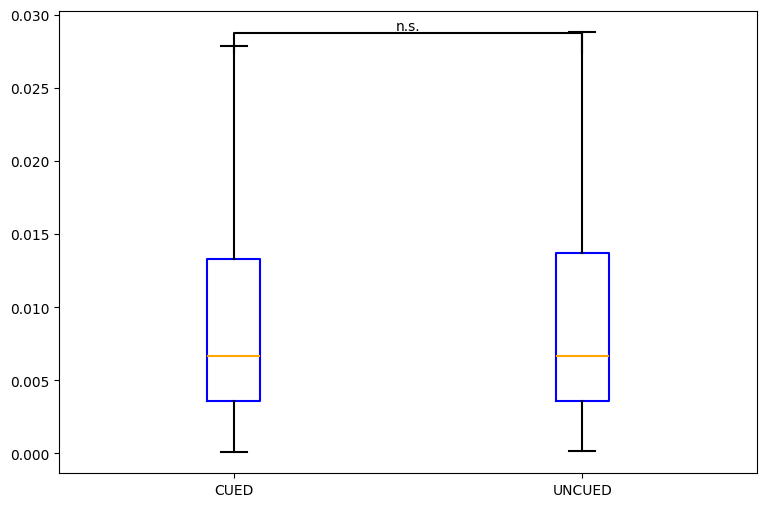

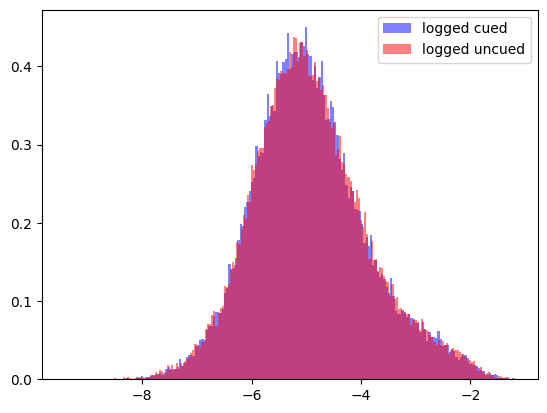

Cohen's d: -0.008
Cohen's d (logged): -0.008


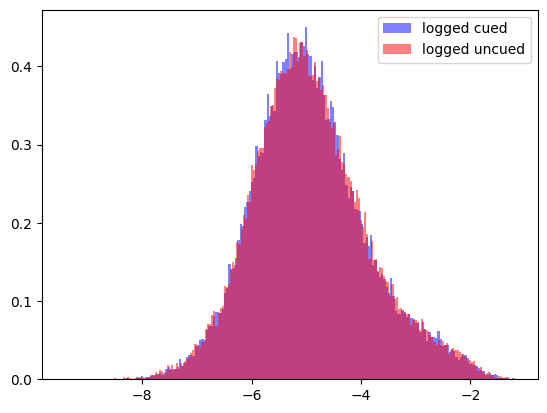

In [18]:


import pandas as pd
import numpy as np
from scipy.stats import rankdata
from statsmodels.formula.api import ols
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore

behavior = df

def remove_top_percentile(dataframe, column, percentile):
    threshold = dataframe[column].quantile(percentile)
    modified_dataframe = dataframe.copy()
    modified_dataframe = modified_dataframe[modified_dataframe[column] < threshold]
    return modified_dataframe

behavior = remove_top_percentile(behavior, 'prestim_mean_alpha', 0.999)
behavior = remove_top_percentile(behavior, 'poststim_mean_alpha', 0.999)

behavior = behavior[(behavior['poststim_irrev'] < 0.075) & (behavior['prestim_irrev'] < 0.075)]
print(len(behavior))

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu



left_cue_ROI = ['O2', 'PO4', 'PO8'] #right hemisphere processing for left cue
right_cue_ROI = ['O1', 'PO3', 'PO7'] #left hemisphere processing for right cue
montage = mne.channels.make_standard_montage('biosemi64')
channels = montage.ch_names
print(channels)

left_cue_indices = [channels.index(elec) for elec in left_cue_ROI if elec in channels]
right_cue_indices = [channels.index(elec) for elec in right_cue_ROI if elec in channels]

left_cue_irrev = []
contribution_arr = []
for matrix in behavior['prestim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    contribution_arr.append(contribution)
    left_cue_trial = np.mean(contribution[left_cue_indices])
    left_cue_irrev.append(left_cue_trial)
behavior['left_cue_irrev'] = left_cue_irrev # RIGHT HEMISPHERE
behavior['contributions'] = contribution_arr

right_cue_irrev = []
for matrix in behavior['prestim_ref_mat']:
    row = np.mean(matrix, axis=1)
    col = np.mean(matrix, axis=0)
    contribution = row + col
    right_cue_trial = np.mean(contribution[right_cue_indices])
    right_cue_irrev.append(right_cue_trial)
behavior['right_cue_irrev'] = right_cue_irrev  # LEFT HEMISPHERE

print("left cue associated irrev during left cue (expect higher): " + str(np.mean(behavior[behavior['cue'] == 0]['left_cue_irrev'])))
print("other hemisphere irrev in same (expect lower): " + str(np.mean(behavior[behavior['cue'] == 0]['right_cue_irrev'])))

cued_right = behavior[behavior['cue'] == 1]['right_cue_irrev'] 
cued_left = behavior[behavior['cue'] == 0]['left_cue_irrev'] 
pre = np.concatenate((cued_right, cued_left)) #CUED

uncued_right = behavior[behavior['cue'] == 0]['right_cue_irrev']
uncued_left = behavior[behavior['cue'] == 1]['left_cue_irrev']
post = np.concatenate((uncued_right, uncued_left)) #UNCUED


# Creating the boxplot
fig, ax = plt.subplots(figsize=(9, 6))
boxprops = dict(color='blue', linewidth=1.5)
whiskerprops = dict(linestyle='-', linewidth=1.5, color='black')
capprops = dict(linewidth=1.5, color='black')
medianprops = dict(linestyle='-', linewidth=1.5, color='orange')

ax.boxplot(x=[pre, post], positions=[1, 2], showfliers=False, showcaps=True, showbox=True,
           boxprops=boxprops, whiskerprops=whiskerprops, capprops=capprops, medianprops=medianprops)
ax.set_xticks([1, 2])
ax.set_xticklabels(['CUED', 'UNCUED'])
#ax.set_title('ATX')


# t test
from scipy import stats

t_stat, p_value = mannwhitneyu(pre, post)
print(f'Statistic: {t_stat}, P-value: {p_value}')

# Significance annotation
Q3_group1 = np.percentile(pre, 75)
Q3_group2 = np.percentile(post, 75)
max_Q3 = max(Q3_group1, Q3_group2)
y, h, col = max_Q3, max_Q3, 'k'  # y: start height, h: height of the line, col: color

# Draw significance line and text
ax.plot([1, 1, 2, 2], [y+h, y+h+(0.1*h), y+h+(0.1*h), y+h], lw=1.5, c=col)

sig_text = 'n.s.'
if p_value < 0.0001:
    sig_text = '*** - p<0.0001'
elif p_value < 0.01:
    sig_text = '**'
elif p_value < 0.05:
    sig_text = '*  -  p<0.05'

ax.text(1.5, y+h+(0.1*h), sig_text, ha='center', va='bottom', color=col)

print("mean of CUED: " + str(np.mean(pre)))
print("mean of UNCUED: " + str(np.mean(post)))
print("median of CUED: " + str(np.median(pre)))
print("median of UNCUED: " + str(np.median(post)))

plt.show()

plt.hist(np.log(pre), bins=200, color='blue', alpha=0.5, label='logged cued', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.5, label='logged uncued', density = True)
plt.legend()
plt.show()
#Well shit.

def cohens_d(group1, group2):
    # Calculate means and standard deviations
    mean1, mean2 = np.mean(group1), np.mean(group2)
    std1, std2 = np.std(group1, ddof=1), np.std(group2, ddof=1)
    # Calculate pooled standard deviation
    n1, n2 = len(group1), len(group2)
    pooled_std = np.sqrt(((n1 - 1) * std1 ** 2 + (n2 - 1) * std2 ** 2) / (n1 + n2 - 2))
    # Calculate Cohen's d
    d = (mean1 - mean2) / pooled_std
    return d

d_value = cohens_d(pre, post)
print(f"Cohen's d: {d_value:.3f}")

d_value1 = cohens_d(np.log(pre), np.log(post))
print(f"Cohen's d (logged): {d_value1:.3f}")

plt.show()

plt.hist(np.log(pre), bins=200, color='blue', alpha=0.5, label='logged cued', density = True)
plt.hist(np.log(post), bins=200, color='red', alpha=0.5, label='logged uncued', density = True)
plt.legend()
plt.show()
#Well shit.